In [ ]:
%%writefile eda_helper.py

Writing eda_helper.py


In [4]:
!pip install fastparquet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 30.3 MB/s eta 0:00:00


In [5]:
! pip install missingno

In [6]:
!pip install pyampute pandas

In [7]:
!pip install category_encoders

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 3.6 MB/s eta 0:00:00


In [131]:
import pandas as pd
import numpy as np
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns
import importlib
# import eda_helper
# importlib.reload(eda_helper)
import statsmodels.api as sm
from scipy import stats
from IPython.display import display, HTML
from sklearn.preprocessing import PowerTransformer
import unicodedata
from pyampute.exploration.mcar_statistical_tests import MCARTest
from sklearn.pipeline import Pipeline,FeatureUnion
from sklearn.preprocessing import OrdinalEncoder,OneHotEncoder,StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
import category_encoders as ce
from category_encoders import BinaryEncoder
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor
from sklearn.metrics import classification_report
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import FunctionTransformer
import joblib

pd.set_option("display.max_columns", None)

In [132]:
df1 = pd.read_parquet('/content/POST_CLEANING_3_DATA_PART_1.parquet',engine='fastparquet')

In [133]:
df2 = pd.read_parquet('/content/POST_CLEANING_3_DATA_PART_2.parquet',engine='fastparquet')

In [134]:
df3 = pd.read_parquet('/content/POST_CLEANING_3_DATA_PART_3.parquet',engine='fastparquet')

In [135]:
df4 = pd.read_parquet('/content/POST_CLEANING_3_DATA_PART_4.parquet',engine='fastparquet')

In [136]:
df5 = pd.read_parquet('/content/POST_CLEANING_3_DATA_PART_5.parquet',engine='fastparquet')

In [137]:
df = pd.concat([df1,df2,df3,df4,df5]).reset_index(drop=True)

df.columns = df.columns.str.replace("_", " ").str.title().str.replace(" ", "_")

## HIGH LEVEL SUMMARY

In [ ]:
df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 271253 entries, 0 to 271252
Data columns (total 83 columns):
 #   Column                        Non-Null Count   Dtype   
---  ------                        --------------   -----   
 0   model_year                    271253 non-null  object  
 1   Brand_name                    271253 non-null  category
 2   model_name                    271253 non-null  object  
 3   image_list                    266679 non-null  object  
 4   new_used                      271253 non-null  category
 5   mileage                       267955 non-null  float64 
 6   price                         268358 non-null  float64 
 7   price_drop                    271253 non-null  int64   
 8   deal_type                     162751 non-null  category
 9   Exterior_color                266546 non-null  object  
 10  Interior_color                256396 non-null  object  
 11  Drivetrain                    267173 non-null  object  
 12  MPG                           

In [ ]:
df.describe(include='number').style.format("{:,.0f}")

,mileage,price,price_drop,MPG,level2_charging,dc_fast_charging,battery_capacity,excepted_range,seller_rating,people_count_seller_rating,car_rating,people_count_car_rating,mpge_city,mpge_hwy,postal_code
count,"267,955","268,358","271,253","271,253","3,970","3,357","1,677","4,426","271,253","267,238","219,174","219,174","3,592","3,592","269,161"
mean,"38,150","39,693",439,21,9,35,76,257,4,562,5,62,117,105,"50,542"
std,"50,201","35,931","1,020",417,2,9,23,51,2,"1,009",1,114,18,17,"27,801"
min,0,1,0,0,2,15,16,51,0,0,1,1,35,40,"1,001"
25%,10,"23,788",0,17,8,30,68,236,4,26,4,3,104,93,"30,060"
50%,"22,121","35,577",0,22,10,30,77,262,4,145,5,10,121,107,"47,714"
75%,"62,624","50,311",500,28,10,40,91,285,5,644,5,74,131,117,"76,053"
max,"9,999,999","11,986,400","100,000","217,024",19,60,131,389,5,"18,176",5,838,150,133,"99,701"


In [ ]:
df.query('new_used == "New"').describe(include='number').style.format("{:,.0f}")

,mileage,price,price_drop,MPG,level2_charging,dc_fast_charging,battery_capacity,excepted_range,seller_rating,people_count_seller_rating,car_rating,people_count_car_rating,mpge_city,mpge_hwy,postal_code
count,"99,506","101,018","102,786","102,786",233,232,232,0,"102,786","102,095","58,558","58,558",170,170,"102,786"
mean,154,"52,939",302,19,11,37,89,nan,4,728,5,3,92,79,"51,279"
std,"2,385","43,777",984,14,2,6,21,nan,1,"1,145",0,5,18,14,"27,922"
min,0,1,0,0,6,30,60,nan,0,0,1,1,73,60,"1,001"
25%,2,"39,450",0,0,10,32,73,nan,4,49,5,1,74,66,"30,422"
50%,5,"49,580",0,22,10,36,93,nan,5,254,5,3,92,81,"48,150"
75%,11,"61,414",0,28,11,45,93,nan,5,976,5,4,108,96,"77,040"
max,"240,257","11,986,400","21,173",56,14,60,131,nan,5,"16,882",5,710,127,108,"99,701"


In [ ]:
df.query('new_used == "Used"').describe(include='number').style.format("{:,.0f}")

,mileage,price,price_drop,MPG,level2_charging,dc_fast_charging,battery_capacity,excepted_range,seller_rating,people_count_seller_rating,car_rating,people_count_car_rating,mpge_city,mpge_hwy,postal_code
count,"148,688","147,631","148,705","148,705","3,438","2,847","1,150","4,106","148,705","145,692","142,524","142,524","3,132","3,132","146,613"
mean,"64,407","30,133",511,21,9,34,73,258,3,430,4,91,120,108,"50,459"
std,"52,876","25,379","1,009",11,2,10,24,53,2,871,1,130,17,16,"27,542"
min,0,1,0,0,2,15,16,51,0,0,1,1,35,40,"1,001"
25%,"29,427","17,995",0,18,8,30,65,237,1,19,4,8,110,98,"30,041"
50%,"54,962","25,750",200,22,10,30,77,262,4,90,5,31,124,110,"47,280"
75%,"91,398","36,174",700,28,10,36,91,287,5,439,5,125,131,117,"75,229"
max,"9,999,999","1,900,000","100,000",142,19,60,131,389,5,"18,176",5,838,150,133,"99,701"


In [ ]:
df.describe(include='category')

,Brand_name,new_used,deal_type,Fuel_Type,Transmission,one_owner_vehicle,Personal_use_only,Open_recall,battery_range_score_category,state
count,271253,271253,162751,266224,254658,269336,270277,130380,789,269161
unique,24,3,3,8,2,3,3,2,1,50
top,Ford,Used,Good,Gasoline,Automatic,not_owned_yet,yes,not_in_use_yet,Outstanding,FL
freq,59464,148705,91996,213560,254586,102786,109873,102786,789,24674


In [ ]:
df.describe(include='O').drop(columns=['image_list','seller_site'])

,model_year,model_name,Exterior_color,Interior_color,Drivetrain,seller_name,gear_spec,engine_size,cylinder_config,valves,battery_range_score_cleaned,street_address,city
count,271253,271253,266546,256396,267173,269203,95606,257585,253377,79877,789,269161,269161
unique,73,3191,14,13,5,15277,11,74,22,12,8,15322,3581
top,2025,F-150 XLT,white,black,4WD,gateway classic cars,10,3.5,I4,16,100,1237 Central Park Dr,Houston
freq,86821,4829,98133,175122,86831,386,35337,34604,103298,40680,246,386,2917


## OBSERVATIONS-

1. Our dataset is huge, with `270k+` rows and `80+` columns, with size of 1.3GB.
2. DataTypes of Columns seems good. number of column in each data types are ->
  - 2 bool
  - 41 boolean
  - 10 category
  - 14 float64
  - 1 int64
  - 15 object

(Difference between `bool` and `boolean` type is only that bool does not allow null values, if we do so, col automatically converted back to object data type [OCCUPY MORE MEMORY].
whereas in boolean type we can have null values [OCCUPY LESS MEMORY])

3. We have certain columns where the missing values exceed 50% of values of that column, These column need to be handled with care, if possible we will try to fill null values, else we will drop this columns as a last option.

4. Few of the column (i.e, mileage, price, price_drop) seems to have large potential outlier, which need to be treated before feeding to ml algo.

5. expected_range column hold no value if car is new.

6. In categorical columns too, we have high imbalance.

## Basic overview of missing values

<Axes: >

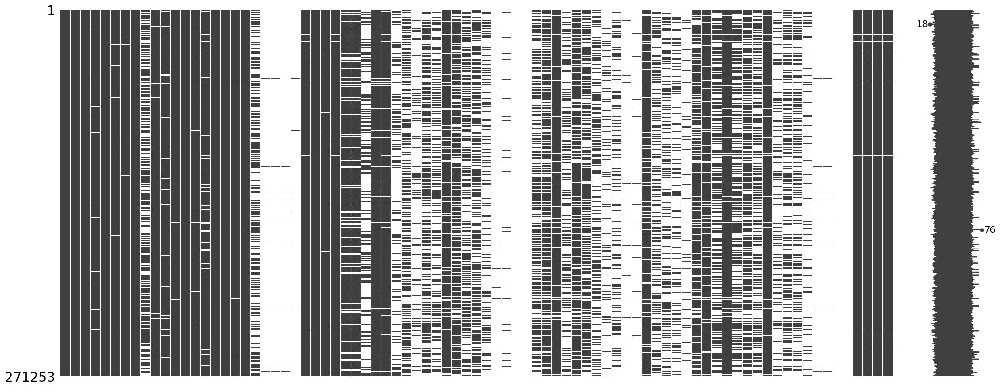

In [ ]:
msno.matrix(df)

In [ ]:
result = eda_helper.null_info(df)

eda_helper.show_full_df(result)

,Null_Values,Null_PCT
Columns,,
wheel_chair_accessible,271195,0.999786
autopilot,270758,0.998175
battery_range_score_cleaned,270464,0.997091
battery_range_score_category,270464,0.997091
battery_capacity,269576,0.993818
dc_fast_charging,267896,0.987624
mpge_city,267661,0.986758
mpge_hwy,267661,0.986758
level2_charging,267283,0.985364


/content/eda_helper.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


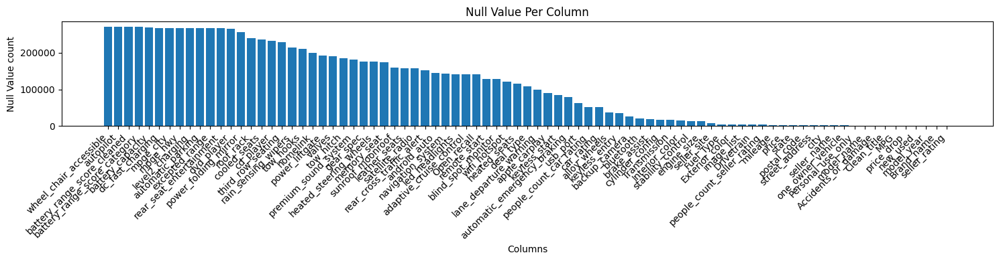

In [ ]:
eda_helper.plot_null_info(df,figsize=(20,10))

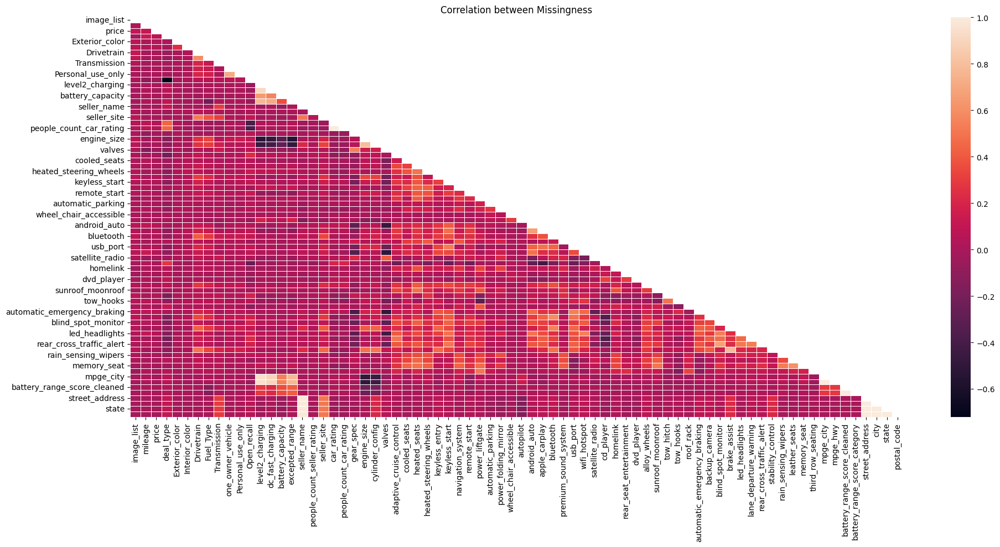

In [ ]:
eda_helper.missingness_corr_plot(df)

<Axes: >

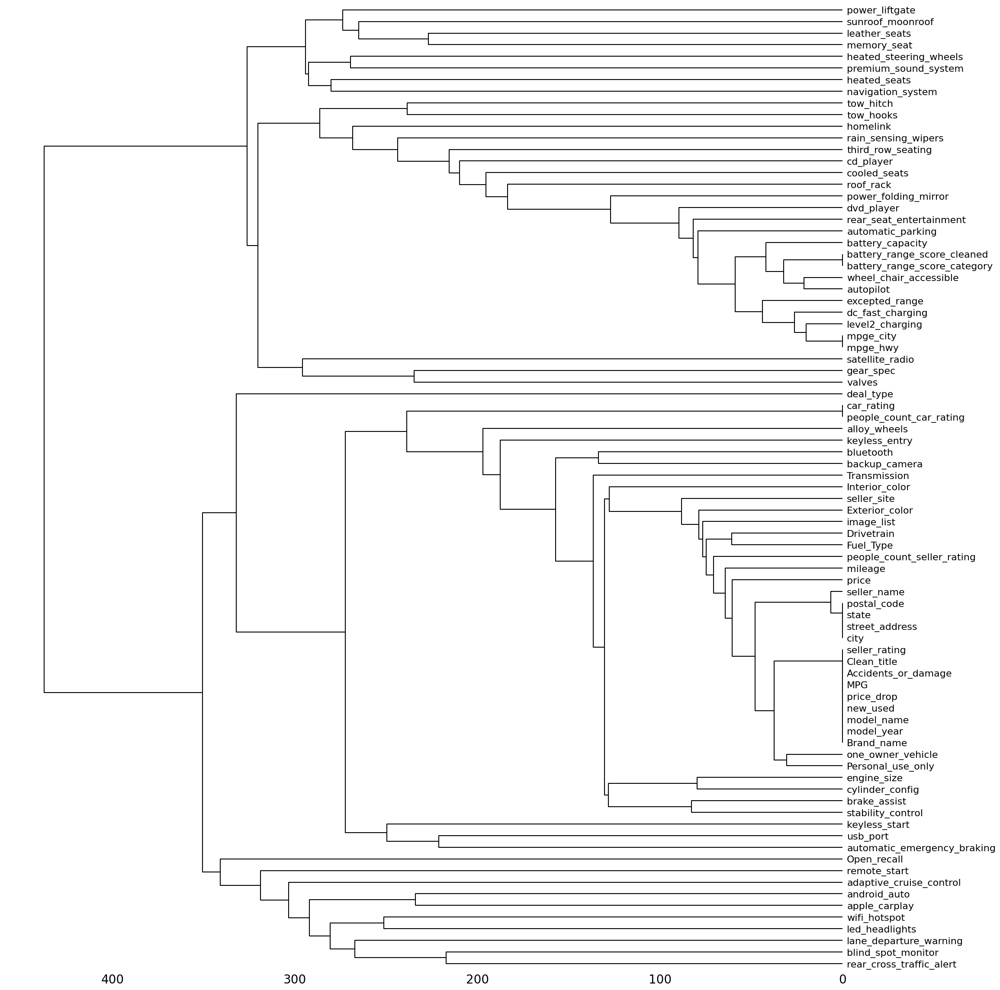

In [ ]:
msno.dendrogram(df)

## OBSERVATIONS

1. Other than Columns 'model_name', 'Accidents_or_damage', 'Clean_title', 'MPG', 'price_drop',
       'new_used', 'model_year', 'Brand_name', 'seller_rating', all other columns have missing value.

2. Row with least value avail have 18 values and Row with max value present is 76.
      
3. Null values in most of the boolean data type columns does not necessarily mean that value is not present, it mean that car may or may not have that specefic feature.
for example - bluetooth (boolen data type col), here nan value means either car do not have bluetooth or we don't have info related to that.
I have to handle this kind of column with care.

4. Missingness is few column does not make sense like mileage for new cars or battery and charging related info for non-electric cars.

5. Few columns are corelated in missingness e.g. ->
  - If a car have memory_seating than car will also have level2_charging,_dc_fast_charning values,
  - If car have engine engine_size and cylinder config related info, then it will not contain mpge info.



**I can't Directly proceed with EDA, because data is too much skewed, contains outliers & null values, need cleaning actions and transformations. I have to handle all this with EDA & Data Cleaning in `Non-Linear` Way.**



---


# **Model_Year**


In [ ]:
eda_helper.cat_summary(df['Model_Year'])

,Model_Year
0,2022
1,2025
2,2014
3,2023
4,2024
...,...
271248,2024
271249,2017
271250,2025
271251,2025


Data Type : object
No. of unique value : 73
Missing Rows : 0 (0.0 %)
Available Data : 271253 / 271253 rows


,Model_Year
count,271253
unique,73
top,2025
freq,86821


,count,proportion
Model_Year,,
2025,86821,32.007
2023,28314,10.438
2024,26248,9.677
2022,24319,8.965
2026,19005,7.006
2021,16531,6.094
2020,12082,4.454
2019,10689,3.941
2018,9235,3.405


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


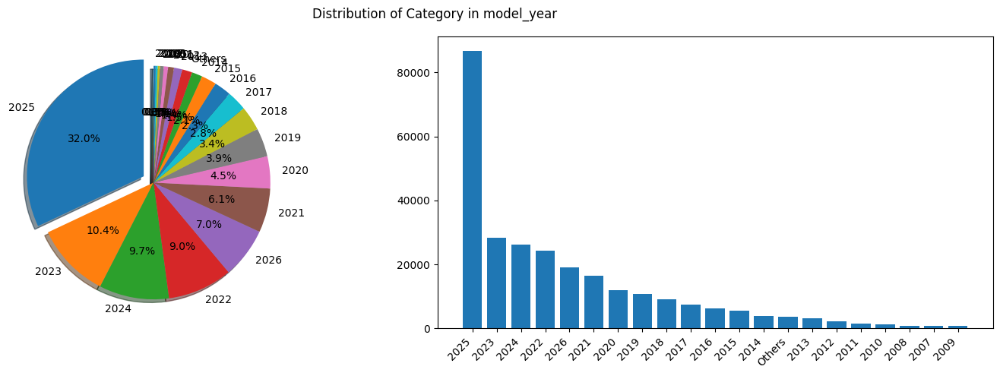

In [ ]:
eda_helper.categorical_univariate_plot(df['Model_Year'],wrdcld=False,k=20)

####  **Observations From `Model_Year` Column** -
---


1. Column have 73 Unique Values and no Null Values.
2. Cars which are Manufactured before year 2000, are very less in number and hence created unnecessary categories, here we can apply `Discretizaton` to reduce the categories.
3. Top 3 Categories are 2025 (32%), 2023 (10%) and 2024 (9%) cars, among this three, cars manufactured in 2025 are very large in number as compared to any other category.

`Action Required`:

- Need to correct Data type `Cleaning`.
- Will apply Domain Specific Discretization on rear categories.

---
# **Brand_Name**

In [ ]:
eda_helper.cat_summary(df['Brand_Name'])

,Brand_Name
0,Ford
1,Ford
2,Ford
3,Chevrolet
4,Audi
...,...
271248,Toyota
271249,Dodge
271250,BMW
271251,BMW


Data Type : category
No. of unique value : 24
Missing Rows : 0 (0.0 %)
Available Data : 271253 / 271253 rows


,Brand_Name
count,271253
unique,24
top,Ford
freq,59464


,count,proportion
Brand_Name,,
Ford,59464,21.922
Toyota,37900,13.972
Chevrolet,35409,13.054
Honda,31076,11.456
Jeep,20203,7.448
GMC,12907,4.758
Nissan,10219,3.767
BMW,9794,3.611
Mazda,6936,2.557


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


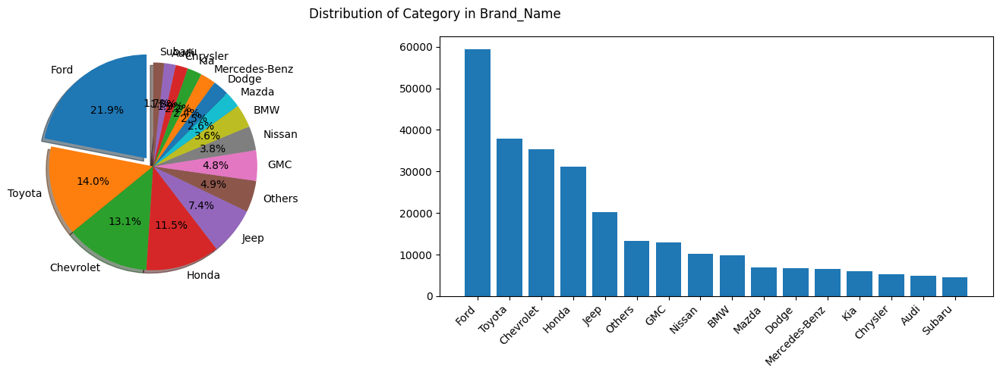

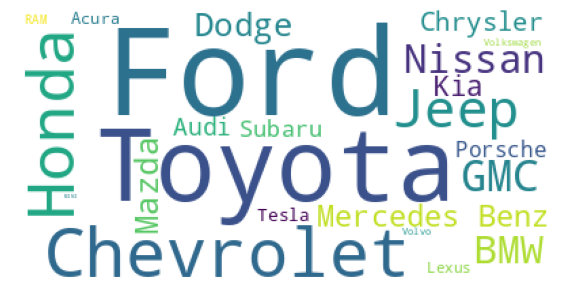

In [ ]:
eda_helper.categorical_univariate_plot(df['Brand_Name'],k=15)

####  **Observations From `Brand_Name` Column** -
---

1. `Brand_Name` have 24 Unique Categories with no missing values
2. Top 3 Brands are `Ford` (21.9%), `Toyota` (13.9%) and Chevrolet (13%).
3. Few Brands are contributing even less than 1 percent, creating additional categories.

`Action Required`:

- Few Brands have very few cars, will try to apply domain knowledge whether we can combine those cars into other category.

---
# **Model_Name**

In [ ]:
eda_helper.cat_summary(df['Model_Name'])

,Model_Name
0,F-150 Lightning Platinum
1,Maverick XLT
2,F-150 STX
3,Tahoe 4WD Z71
4,Q5 45 S line quattro Premium
...,...
271248,Tacoma TRD Off Road
271249,Challenger GT
271250,X5 xDrive40i
271251,X3 30 xDrive


Data Type : object
No. of unique value : 3191
Missing Rows : 0 (0.0 %)
Available Data : 271253 / 271253 rows


,Model_Name
count,271253
unique,3191
top,F-150 XLT
freq,4829


,count,proportion
Model_Name,,
F-150 XLT,4829,1.780
Transit-250 Base,3974,1.465
X5 xDrive40i,2595,0.957
Corolla LE,2593,0.956
Edge SEL,2578,0.950
Rogue SV,2553,0.941
Maverick XLT,2443,0.901
Explorer XLT,2394,0.883
Tundra SR5,2392,0.882


None

#### **Observation From `Model_Name`**
---

1. We have 3191 different kind of models with no missing values.
2. Top 3 Categories are `F-150 XLT` (1.7%), `Transit-250 Base` (1.4%) and `X5 xDrive40i` (0.9%)

`Action Requried`:
- Find the way to reduced the cardinality of data.
- If Reduced, change the data type of Category.

---
# **New_Used**

In [ ]:
eda_helper.cat_summary(df['New_Used'])

,New_Used
0,Used
1,New
2,Used
3,Used
4,Certified
...,...
271248,Used
271249,Used
271250,Certified
271251,Used


Data Type : category
No. of unique value : 3
Missing Rows : 0 (0.0 %)
Available Data : 271253 / 271253 rows


,New_Used
count,271253
unique,3
top,Used
freq,148705


,count,proportion
New_Used,,
Used,148705,54.822
New,102786,37.893
Certified,19762,7.285


None

#### **Observation From `New_Used`**
---

1. This column contains only 3 values with `Used` (54%), `New` (37%) and Certified (7.2%).
2. Contains no Null Values.

`Action Required`:
- Column name need to be changed `Cleaning`

---

# **Mileage**

In [ ]:
eda_helper.numerical_summary(df['Mileage'])

,Mileage
0,27565.0
1,3.0
2,117487.0
3,63052.0
4,9531.0
...,...
271248,12255.0
271249,18949.0
271250,6406.0
271251,17.0


Data Type : float64
Missing Data : 3298 (1.22 %)
Available Data : 267955 / 271253


,Mileage
0.01,0.00
0.05,0.00
0.10,2.00
0.25,10.00
0.50,22121.00
0.75,62624.00
0.90,104643.60
0.95,130008.60
0.99,185647.04
1.00,9999999.00


,value
Mean,38149.57
Trimmed Mean (5%),34532.36
Trimmed Mean (10%),31196.73
Median,22121.00


,value
Std,"50,201"
Varience,"2,520,120,506"
IQR,"62,614"


,value
Skewness,30
Kurtosis,"5,789"


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


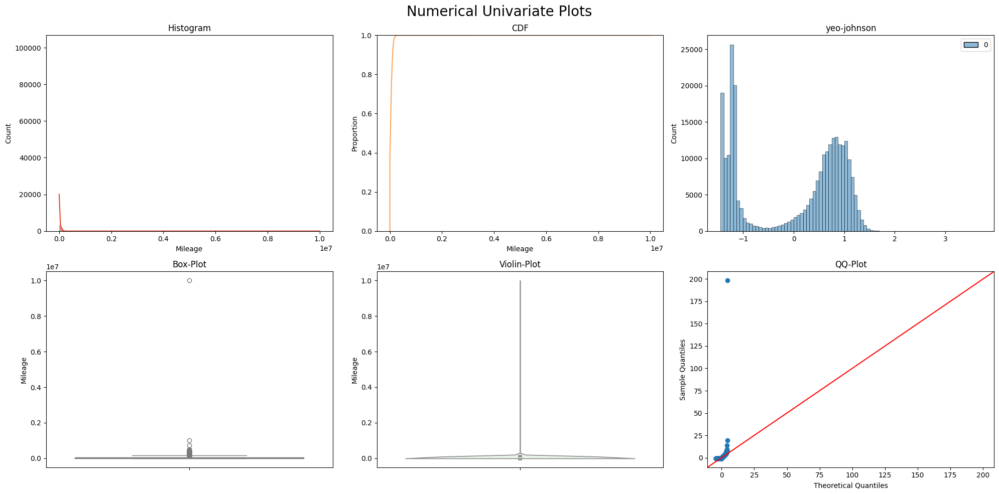

In [ ]:
eda_helper.numerical_univariate_plots(df['Mileage'].dropna())

#### **Observations From `Mileage`**
---

1. Mileage have 1.22% of values as missing
2. Column is highly Positively Skewed (Mean > Median), Skewness of 30, with heavy tails, Treatment of Potential Outlier and transformation is needed if we need to apply Linear Models.
3. Data is not normally distributed (QQ Plot), Even the Power transformation is not able to make this data symetric.

`Action Required` :
- Outlier Detection.
- Transformations.
- Missing Value Imputation

---
# **Price**

In [ ]:
eda_helper.numerical_summary(df["Price"])

,Price
0,48500.0
1,35285.0
2,16998.0
3,54495.0
4,40204.0
...,...
271248,41530.0
271249,24366.0
271250,70995.0
271251,56260.0


Data Type : float64
Missing Data : 2895 (1.07 %)
Available Data : 268358 / 271253


,Price
0.01,5997.00
0.05,10999.00
0.10,15641.70
0.25,23788.00
0.50,35577.00
0.75,50310.75
0.90,66994.30
0.95,80325.00
0.99,104048.29
1.00,11986400.00


,value
Mean,39693.23
Trimmed Mean (5%),38206.19
Trimmed Mean (10%),37367.73
Median,35577.00


,value
Std,"35,931"
Varience,"1,291,011,505"
IQR,"26,523"


,value
Skewness,147
Kurtosis,"46,480"


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


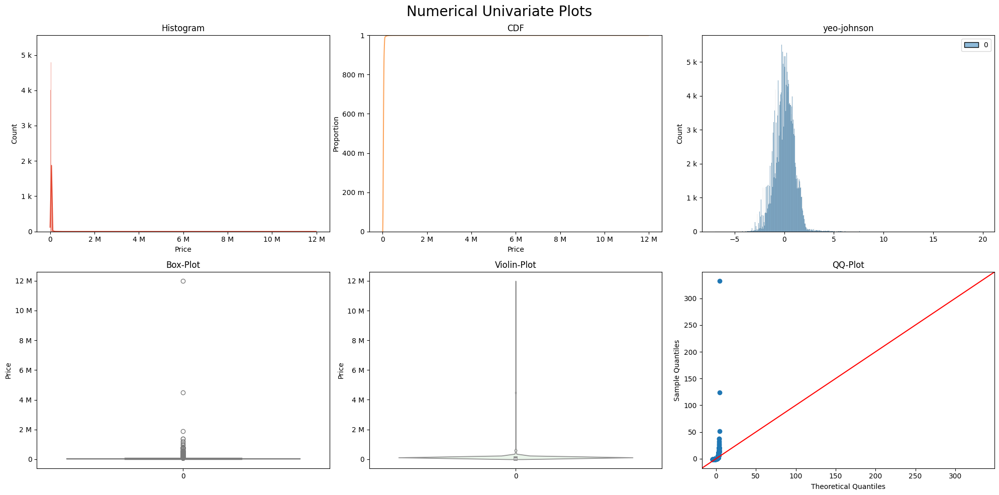

In [ ]:
eda_helper.numerical_univariate_plots(df['Price'])

#### **Observations From `Price`**
---

1. Data contains null values (1.07%)
2. Data is Highly positivly skewed with heavy tail (Leptokurtic)
3. Power Transformation is able to reduce the skewness.

`Action Required`:
- Outlier Detection
- Transformations
- Missing Value Imputation

------
# **Price_Drop**

In [ ]:
eda_helper.numerical_summary(df['Price_Drop'])

,Price_Drop
0,0
1,0
2,0
3,0
4,124
...,...
271248,459
271249,0
271250,500
271251,0


Data Type : int64
Missing Data : 0 (0.0 %)
Available Data : 271253 / 271253


,Price_Drop
0.01,0.0
0.05,0.0
0.10,0.0
0.25,0.0
0.50,0.0
0.75,500.0
0.90,1200.0
0.95,2000.0
0.99,4500.0
1.00,100000.0


,value
Mean,439.02
Trimmed Mean (5%),286.10
Trimmed Mean (10%),220.06
Median,0.00


,value
Std,"1,020"
Varience,"1,039,625"
IQR,500


,value
Skewness,11
Kurtosis,489


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


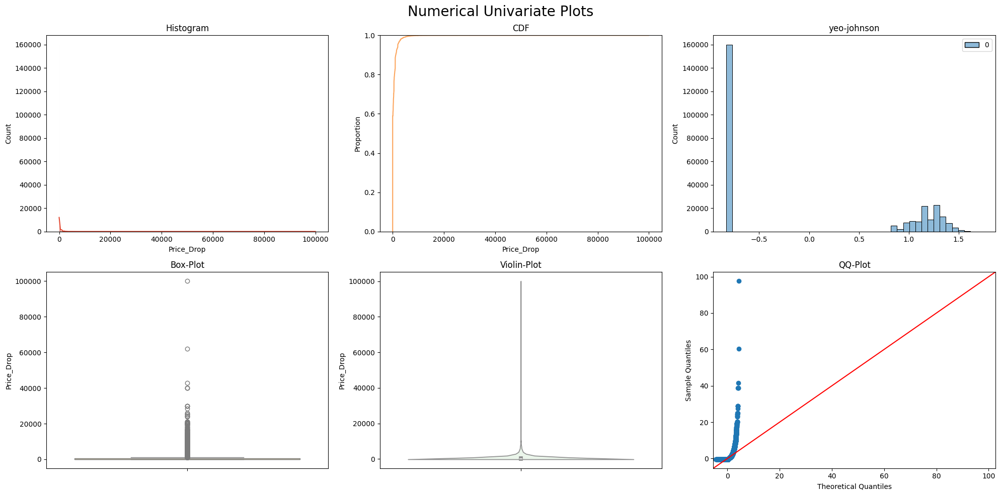

In [ ]:
eda_helper.numerical_univariate_plots(df['Price_Drop'])

#### **Observation From Price_Drop**
---

1. Column does not have any missing value.
2. Data is right skewed with excess kurtosis (Leptokurtic)
3. Data is not normally distributed (QQ plot) and even the power transformation is nota ble to handle this column.

`Actions Required`:
- Outlier Detection
- Transformations

---
# **Deal_Type**

In [ ]:
eda_helper.cat_summary(df['Deal_Type'])

,Deal_Type
0,Great
1,NaN
2,Good
3,Good
4,Good
...,...
271248,Good
271249,Good
271250,Fair
271251,Great


Data Type : category
No. of unique value : 3
Missing Rows : 108502 (40.0 %)
Available Data : 162751 / 271253 rows


,Deal_Type
count,162751
unique,3
top,Good
freq,91996


,count,proportion
Deal_Type,,
Good,91996,56.526
Fair,37090,22.789
Great,33665,20.685


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


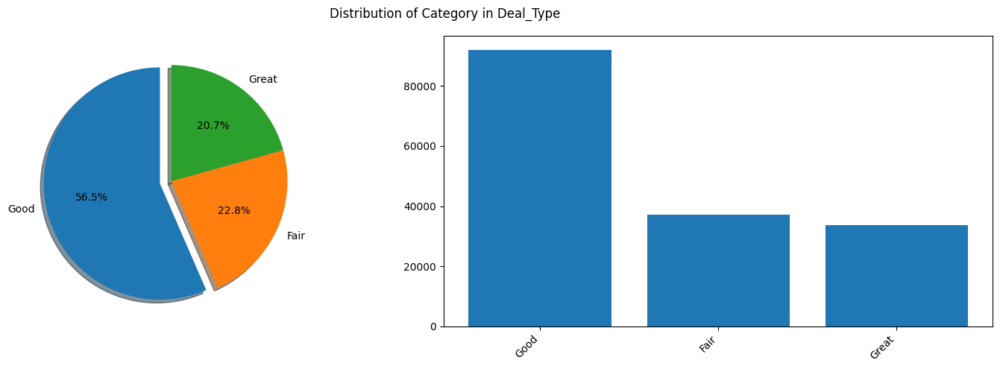

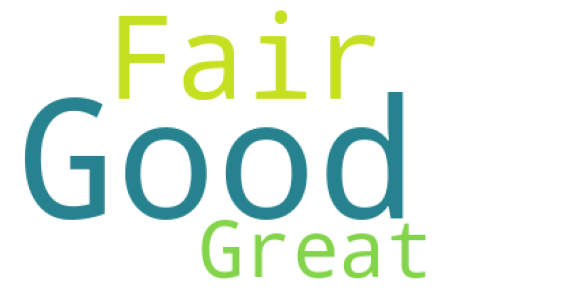

In [ ]:
eda_helper.categorical_univariate_plot(df['Deal_Type'])

#### **Observations From `Deal_Type`**
---
- Column have 40% of values which are missing.
- It contains only 3 Categories among which `Good` is leading (56.6%), followed by `Fair` (22.7%) and `Great` (20.6%) category.

`Actions Required`:
- Missing data can be filled, after studing if cars.com have given the info how they label cars, among this 3 categories, else it seems to be `MAR` kind of data, hence we can apply some algo based imputation technique.

---
# **Exterior_Color**

In [ ]:
eda_helper.cat_summary(df['Exterior_Color'])

,Exterior_Color
0,gray
1,gray
2,black
3,black
4,gray
...,...
271248,gray
271249,gray
271250,white
271251,black


Data Type : object
No. of unique value : 14
Missing Rows : 4707 (1.74 %)
Available Data : 266546 / 271253 rows


,Exterior_Color
count,266546
unique,14
top,white
freq,98133


,count,proportion
Exterior_Color,,
white,98133,36.817
gray,82943,31.118
black,48536,18.209
red,12064,4.526
blue,9846,3.694
silver,7835,2.939
green,3218,1.207
yellow,2036,0.764
orange,811,0.304


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


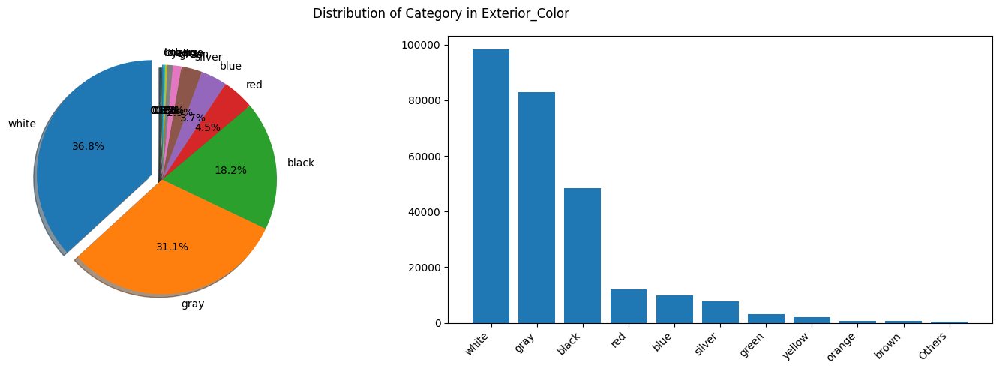

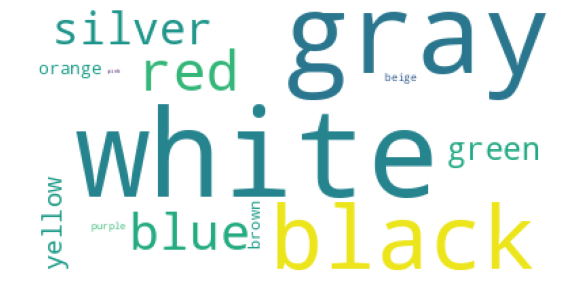

In [ ]:
eda_helper.categorical_univariate_plot(df['Exterior_Color'],k=10)

#### **Observation From `Exterior_Color`**
---

1. This column contains 1.74% values as missing with 14 unique category.
2. Top Three Exterior colors are `White` (36.8%), `Grey`(31.1%) & `Black` (18.2%).

`Action Requried`:
- If I am able to extract the image from image link column, I will use algo based method to detect the color and fill the value accordingly.
- Data Type should be changed to category `Cleaning`
- Try to adjust the `pink` & `Violet` category, or combine them to create a category `Others`

---
# **Interior_Color**



In [ ]:
eda_helper.cat_summary(df['Interior_Color'])

,Interior_Color
0,gray
1,gray
2,black
3,black
4,black
...,...
271248,black
271249,black
271250,silver
271251,black


Data Type : object
No. of unique value : 13
Missing Rows : 14857 (5.48 %)
Available Data : 256396 / 271253 rows


,Interior_Color
count,256396
unique,13
top,black
freq,175122


,count,proportion
Interior_Color,,
black,175122,68.301
gray,50688,19.769
brown,9160,3.573
beige,7639,2.979
yellow,4572,1.783
white,3683,1.436
red,2393,0.933
blue,2131,0.831
silver,710,0.277


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


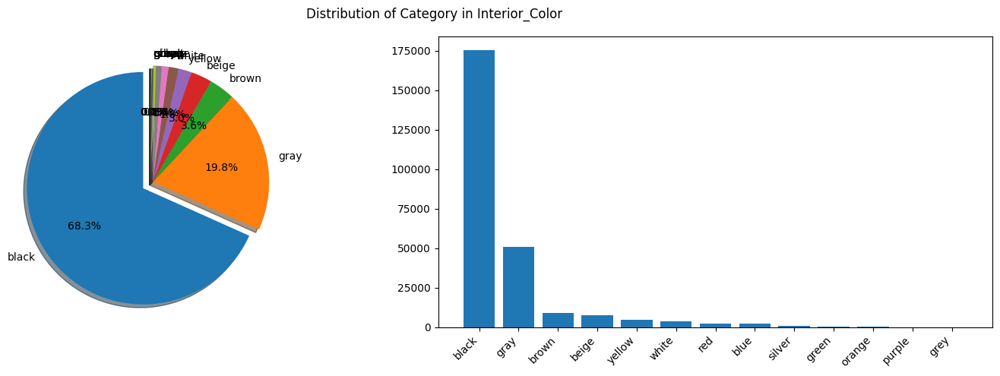

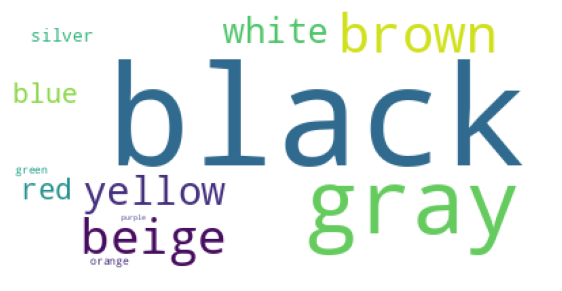

In [ ]:
eda_helper.categorical_univariate_plot(df['Interior_Color'])

#### **Observations From `Interior_Color`**
---
1. Column contains 5.48% of values as null.
2. Contains 12 unique category.
3. Top 3 Categories are `Black` (68.3%) , `Grey` (19.7) & `Brown` (3.5%)

`Action Required`:
- If I am able to extract the image from image link column, I will use algo based method to detect the color and fill the value accordingly.
- Combine the `Grey` and `Gray` to one. `Cleaning`.
- Need to change the data type to Category. `Cleaning`

---
# **Drivetrain**

In [ ]:
eda_helper.cat_summary(df['Drivetrain'])

,Drivetrain
0,AWD
1,AWD
2,4WD
3,4WD
4,AWD
...,...
271248,4WD
271249,AWD
271250,AWD
271251,AWD


Data Type : object
No. of unique value : 5
Missing Rows : 4080 (1.5 %)
Available Data : 267173 / 271253 rows


,Drivetrain
count,267173
unique,5
top,4WD
freq,86831


,count,proportion
Drivetrain,,
4WD,86831,32.500
AWD,70363,26.336
FWD,68951,25.808
RWD,41027,15.356
2WD,1,0.000


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


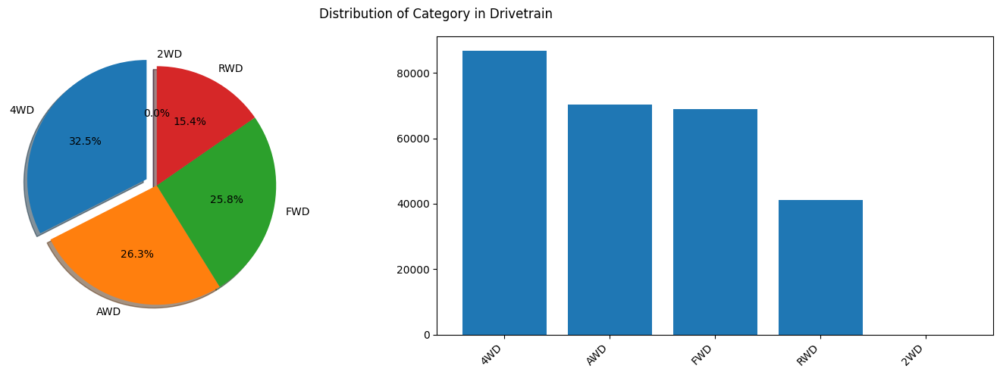

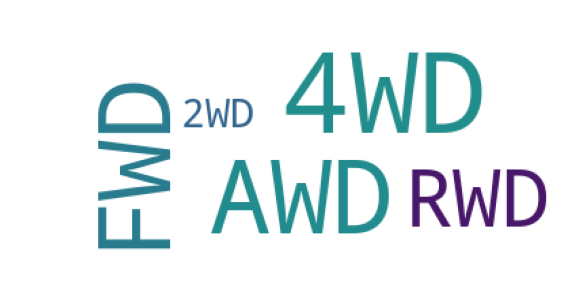

In [ ]:
eda_helper.categorical_univariate_plot(df['Drivetrain'])

In [ ]:
df[df['Drivetrain'] == '2WD']

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,...,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
176000,2022,Chevrolet,Malibu LT,['https://platform.cstatic-images.com/xlarge/i...,Used,50507.0,19998.0,0,Good,white,...,<NA>,<NA>,NaN,NaN,NaN,NaN,13100 Gulf Fwy,Houston,TX,77034.0


#### **Observation From `Drivetrain`**
---

1. Column Contains 4 unique category, with 1.5% of null values.
2. Top 3 Categories are 4WD (32.5%), AWD (26.3%) and FWD (25.8%).
3. You can get in depth knowledge about the Drivetrain from [Here.](https://www.youtube.com/watch?v=-cTJqNWwmf0)

`Actions Required`:

- Null value Imputation.
- Convert the data type to category `Cleaning`
- Convert the 2WD to FWD.



---
# **MPG**



In [ ]:
eda_helper.numerical_summary(df['Mpg'])

,Mpg
0,0.0
1,26.0
2,12.0
3,17.5
4,25.0
...,...
271248,21.0
271249,22.5
271250,25.0
271251,30.0


Data Type : float64
Missing Data : 0 (0.0 %)
Available Data : 271253 / 271253


,Mpg
0.01,0.0
0.05,0.0
0.10,0.0
0.25,17.0
0.50,22.0
0.75,28.5
0.90,34.5
0.95,39.5
0.99,47.5
1.00,217024.0


,value
Mean,21.09
Trimmed Mean (5%),20.10
Trimmed Mean (10%),20.33
Median,22.00


,value
Std,417
Varience,"173,761"
IQR,12


,value
Skewness,520
Kurtosis,"270,762"


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


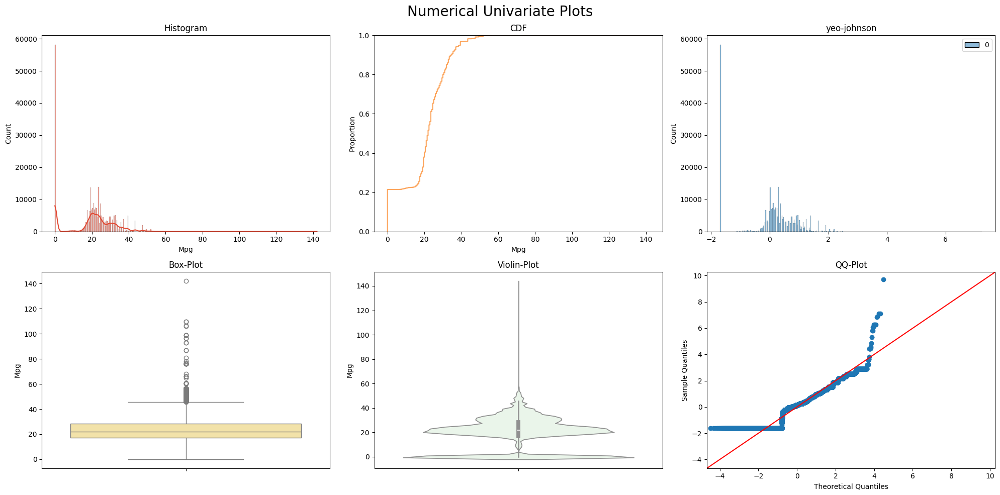

In [ ]:
col = df.drop(index=df[df['Mpg'] == 217024.0].index)['Mpg'] #removing this wrong data, which is impacting graphs alot
eda_helper.numerical_univariate_plots(col)

#### **Observation From `Mpg`**
---

1. MPG (Miles per Galon) do not have any missing value.
2. Some values in MPG is set to 0, which is not possible.
3. kurtosis is very high because of 0 values leading to Leptokurtis.
4. Just because of those 0 values, the skewness is also increasing alot, if this 0 are not there, data can achive normal distribution.
5. Just becong of one wrong data (Mpg = 217024.0), Whole distrubtion got changed.

`Actions Required`:
- MPG (as a Indian) is not intutive, I will try to convert this value into KM/L `Cleaning`.
- Descritization
- Converting 0 into np.nan then Missing value imputation.
- Column need to be renamed to MPG `Cleaning`

---
# **Fuel_Type**

In [ ]:
eda_helper.cat_summary(df['Fuel_Type'])

,Fuel_Type
0,Electric
1,Gasoline
2,Flex Fuel
3,Gasoline
4,Gasoline
...,...
271248,Gasoline
271249,Gasoline
271250,Gasoline
271251,Gasoline


Data Type : category
No. of unique value : 8
Missing Rows : 5029 (1.85 %)
Available Data : 266224 / 271253 rows


,Fuel_Type
count,266224
unique,8
top,Gasoline
freq,213560


,count,proportion
Fuel_Type,,
Gasoline,213560,80.218
Hybrid,25507,9.581
Diesel,18601,6.987
Flex Fuel,4368,1.641
Electric,3982,1.496
Plug-in Hybrid,90,0.034
Other,64,0.024
CNG/LPG,52,0.020


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


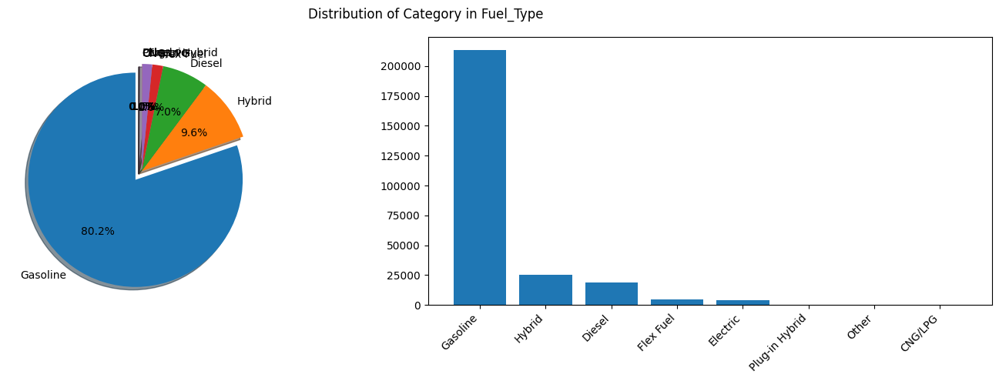

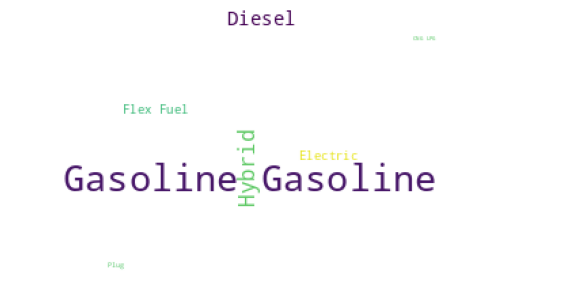

In [ ]:
eda_helper.categorical_univariate_plot(df['Fuel_Type'])

#### **Observations From `Fuel_Type`**
---

1. column have 8 unique categories with 1.85 % of values as missing.
2. Data is Heavily dominated by Gasoline cars (80.2%), followed by Hybrid (9.5%) and Diesel (6.9%).

`Actions Required`:
- Handle small number of categories to others.
- Missing Value Imputation


---
# **Transmission**

In [ ]:
eda_helper.cat_summary(df['Transmission'])

,Transmission
0,Automatic
1,Automatic
2,Automatic
3,Automatic
4,Automatic
...,...
271248,Automatic
271249,Automatic
271250,Automatic
271251,Automatic


Data Type : category
No. of unique value : 2
Missing Rows : 16595 (6.12 %)
Available Data : 254658 / 271253 rows


,Transmission
count,254658
unique,2
top,Automatic
freq,254586


,count,proportion
Transmission,,
Automatic,254586,99.972
Manual,72,0.028


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


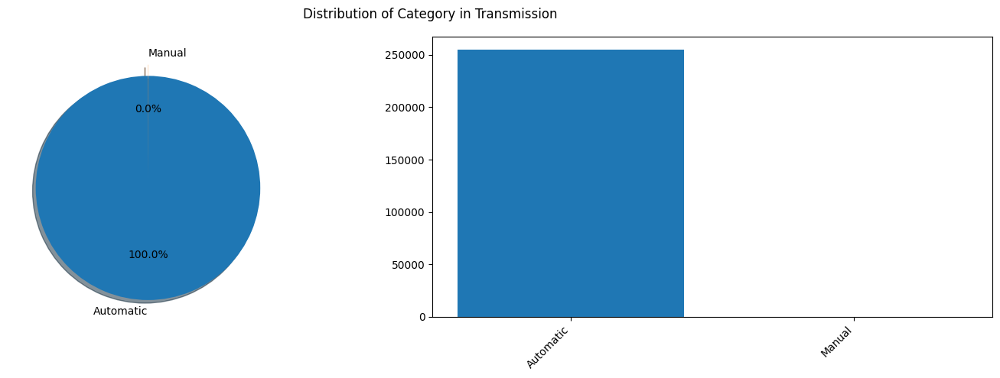

In [ ]:
eda_helper.categorical_univariate_plot(df['Transmission'],wrdcld=False)

#### **Observations From `Transmission`**
---

1. Column contains only two unique categories with 6.12% of values are null.
2. Data is heavily dominated by automatic cars, and Manual cars comprise of less than 0 percent of all values.

`Actions Required`:
- Missing Value Imputation
- As more than 99% cars are automatic, here variance is almost close to zero, if this column do not contribute much in Prediction, I can drop this column, to reduce model complexity.

---
# **Accidents_Or_Damage**

In [ ]:
eda_helper.cat_summary(df['Accidents_Or_Damage'])

,Accidents_Or_Damage
0,False
1,False
2,True
3,False
4,False
...,...
271248,False
271249,False
271250,False
271251,False


Data Type : bool
No. of unique value : 2
Missing Rows : 0 (0.0 %)
Available Data : 271253 / 271253 rows


,Accidents_Or_Damage
count,271253
unique,2
top,False
freq,221589


,count,proportion
Accidents_Or_Damage,,
False,221589,81.691
True,49664,18.309


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


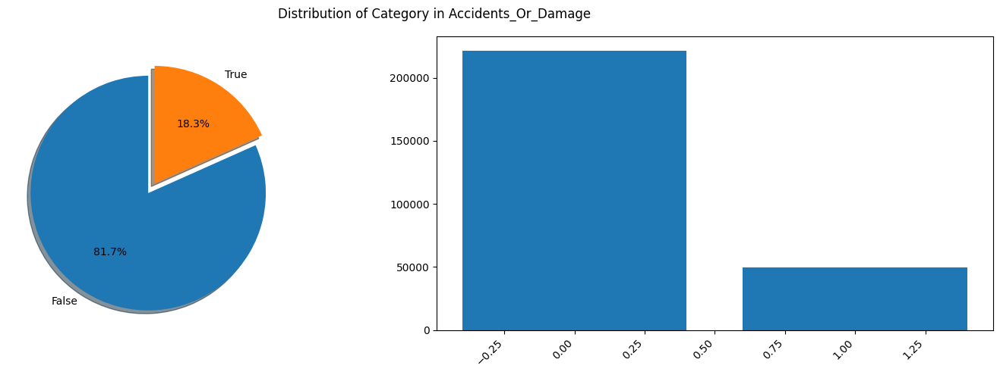

In [ ]:
eda_helper.categorical_univariate_plot(df['Accidents_Or_Damage'],wrdcld=False)

#### **Observation From `Accidents_Or_Damage`**
---

1. Column contains two unique categories with no missing values.
2. Proportion of Accidental to Non-Accidental cars is 81:18.

---
# **Clean_Title**

In [ ]:
eda_helper.cat_summary(df['Clean_Title'])

,Clean_Title
0,True
1,True
2,True
3,True
4,True
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : bool
No. of unique value : 2
Missing Rows : 0 (0.0 %)
Available Data : 271253 / 271253 rows


,Clean_Title
count,271253
unique,2
top,True
freq,270056


,count,proportion
Clean_Title,,
True,270056,99.559
False,1197,0.441


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


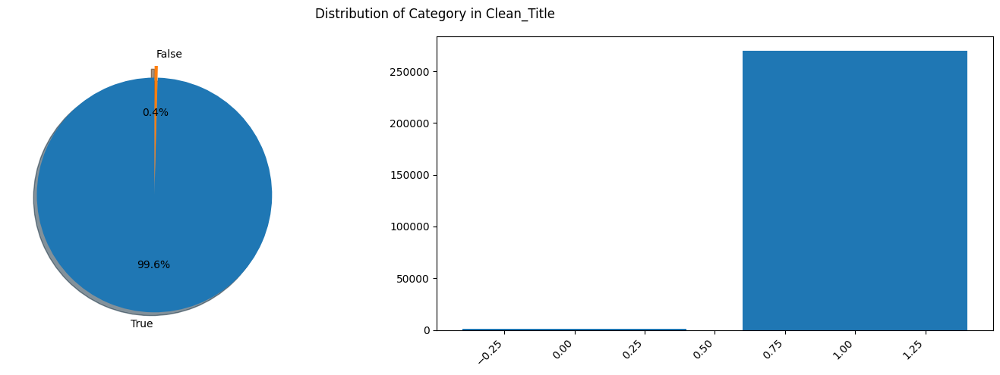

In [ ]:
eda_helper.categorical_univariate_plot(df['Clean_Title'],wrdcld=False)

#### **Observation From `Clean_Title`**
---

1. `Meaning` : A clean title in cars means the vehicle has never been declared a total loss, or rebuilt by insurance or authorities — showing it has no major accident, flood, or salvage history.

2. column contains no null values, have only two values (bool).

3. Values are heavily disproportional.

`Action Required`:

- Most of Values belong to True class, hence, if the column is not contributing much in pridiction, we can drop this column.
- even if the we found certain relation with output column, then I can still get `Clean_Title` column information from `Accident_or_Damage` column, if yes , then we will drop this column.

---
# **One_Owner_Vehicle**

In [ ]:
eda_helper.cat_summary(df['One_Owner_Vehicle'])

,One_Owner_Vehicle
0,one
1,not_owned_yet
2,more
3,one
4,more
...,...
271248,one
271249,one
271250,more
271251,NaN


Data Type : category
No. of unique value : 3
Missing Rows : 1917 (0.71 %)
Available Data : 269336 / 271253 rows


,One_Owner_Vehicle
count,269336
unique,3
top,not_owned_yet
freq,102786


,count,proportion
One_Owner_Vehicle,,
not_owned_yet,102786,38.163
one,93449,34.696
more,73101,27.141


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


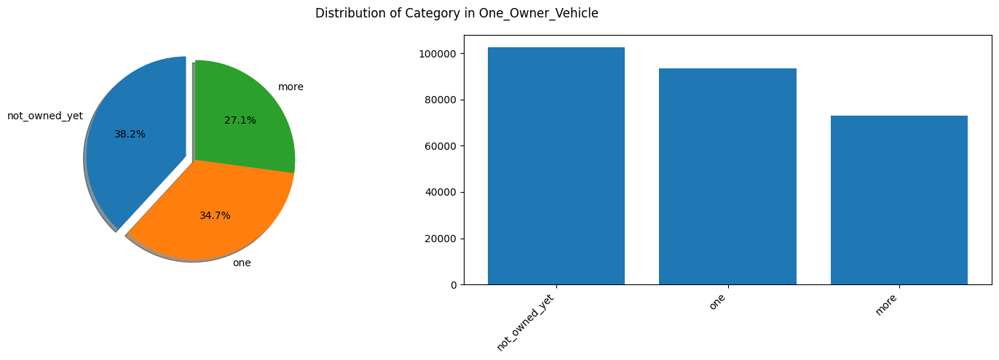

In [ ]:
eda_helper.categorical_univariate_plot(df['One_Owner_Vehicle'],wrdcld=False )

#### **Observation From `One_Owner_Vehicle`**
---

1. Column contains three category with only 0.71 % of values are missing.
2. cars which are new (Not_owned_yet) are 38.1%, followed by one owner (34.6%) and more (27.1%)

`Actions Reqired`:
- Missing Value Imputation

---
# **Personal_Use_Only**

In [ ]:
eda_helper.cat_summary(df['Personal_Use_Only'])

,Personal_Use_Only
0,no
1,not_in_use_yet
2,yes
3,yes
4,no
...,...
271248,yes
271249,yes
271250,no
271251,yes


Data Type : category
No. of unique value : 3
Missing Rows : 976 (0.36 %)
Available Data : 270277 / 271253 rows


,Personal_Use_Only
count,270277
unique,3
top,yes
freq,109873


,count,proportion
Personal_Use_Only,,
yes,109873,40.652
not_in_use_yet,102786,38.030
no,57618,21.318


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


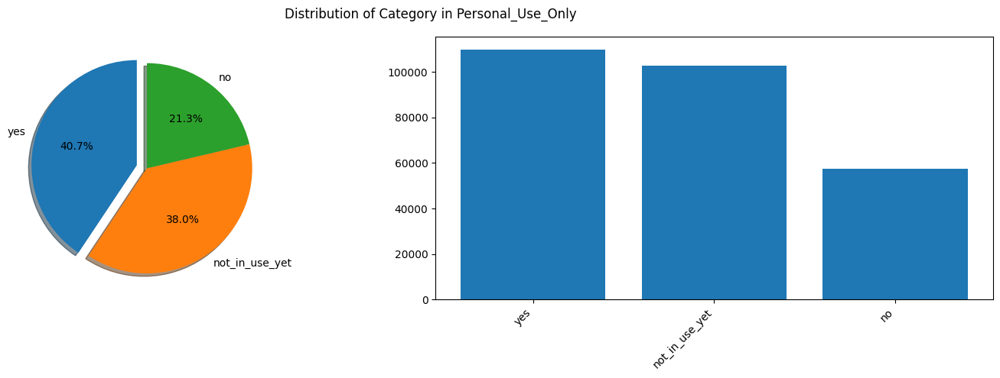

In [ ]:
eda_helper.categorical_univariate_plot(df['Personal_Use_Only'],wrdcld=False)

#### **Observation From `Personal_Use_Only`**
---

1. Column contains 3 values with only 0.36% of values are missing.
2. Column comprising of yes (40.6%), not_in_use_yet (38.0%) and no (21.3%).

`Actions Required`
- Missing value Imputation

---
# **Open_Recall**

In [ ]:
eda_helper.cat_summary(df['Open_Recall'])

,Open_Recall
0,NaN
1,not_in_use_yet
2,NaN
3,NaN
4,NaN
...,...
271248,NaN
271249,NaN
271250,NaN
271251,NaN


Data Type : category
No. of unique value : 2
Missing Rows : 140873 (51.93 %)
Available Data : 130380 / 271253 rows


,Open_Recall
count,130380
unique,2
top,not_in_use_yet
freq,102786


,count,proportion
Open_Recall,,
not_in_use_yet,102786,78.836
yes,27594,21.164


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


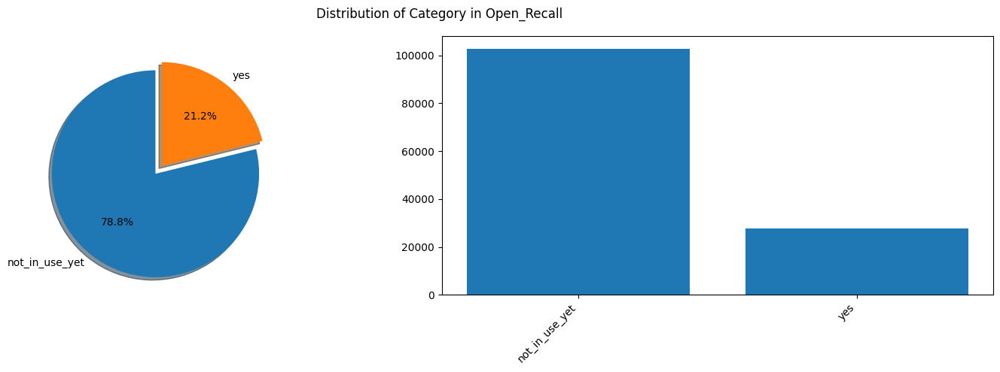

In [ ]:
eda_helper.categorical_univariate_plot(df['Open_Recall'],wrdcld=False)

#### **Observation From `Open_Recall`**
---

1. Column have only 2 unique catgories, with around 51% of data is missing.
2. Null values can either be -
  - Really don't know the value (Missingness) or means that,
  - car do not have any Open_Recall
3. Without missing imputation, column have not_in_use_yet to open_recall as 78 : 27.

`Actions Required`:
- Imputation requred to fill the missing value.


---
# **NOTE** -


```
FEW COLUMN IS DEFINED FOR ELECTRIC CARS ONLY, HENCE ANALYSIS WILL BE DONE TAKING ONLY ELECTRIC CARS INTO CONSIDERATION.
```



In [ ]:
electric_df = df.query('Fuel_Type == "Electric"').copy()

---
# **Level2_Charging**

In [ ]:
eda_helper.numerical_summary(electric_df['Level2_Charging'])

,Level2_Charging
0,19.0
260,8.0
322,10.0
339,10.0
341,8.0
...,...
270609,15.0
270623,10.0
270746,10.0
270898,10.0


Data Type : float64
Missing Data : 12 (0.3 %)
Available Data : 3970 / 3982


,Level2_Charging
0.01,4.00
0.05,6.00
0.10,7.00
0.25,8.00
0.50,10.00
0.75,10.00
0.90,12.00
0.95,12.55
0.99,15.00
1.00,19.00


,value
Mean,9.44
Trimmed Mean (5%),9.40
Trimmed Mean (10%),9.41
Median,10.00


,value
Std,2
Varience,5
IQR,2


,value
Skewness,0
Kurtosis,2


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


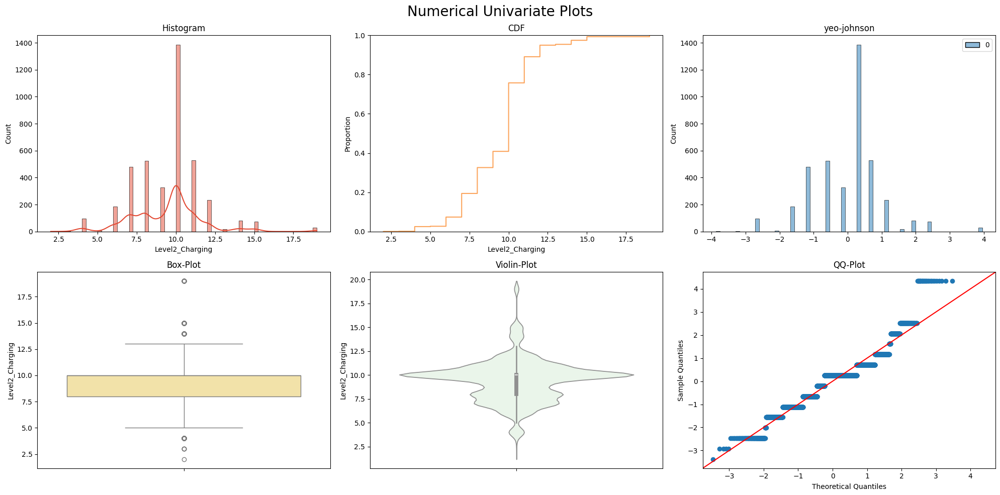

In [ ]:
eda_helper.numerical_univariate_plots(electric_df['Level2_Charging'])

#### **Observations From `Level2_Charging`**
---

1. Data seem to have almost 98% of values as missing, but hidden truth is that `Level2_Charging` is only defined for electric cars, so in real this column have only 12 rows as missing out of more than 3k cars.

2. Data is almost normally distrubuted with kurtosis of 2 only.

3. 80% of electric cars takes less than 11hrs for level2 charging.

4. All values are present in Hours unit.

`Actions Required`:
- Missing value imputation (taking only electric cars into consideration while imputing)
- This column can either be used as numeric or categorical while feeding to algorithm, it will be decided in experiment tracking phase.

---
# **Dc_Fast_Charging**

In [ ]:
eda_helper.numerical_summary(electric_df['Dc_Fast_Charging'])

,Dc_Fast_Charging
0,41.0
260,NaN
322,45.0
339,27.0
341,NaN
...,...
270609,NaN
270623,36.0
270746,30.0
270898,45.0


Data Type : float64
Missing Data : 625 (15.7 %)
Available Data : 3357 / 3982


,Dc_Fast_Charging
0.01,25.0
0.05,25.0
0.10,27.0
0.25,30.0
0.50,30.0
0.75,40.0
0.90,45.0
0.95,60.0
0.99,60.0
1.00,60.0


,value
Mean,34.61
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,30.00


,value
Std,9
Varience,89
IQR,10


,value
Skewness,2
Kurtosis,2


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


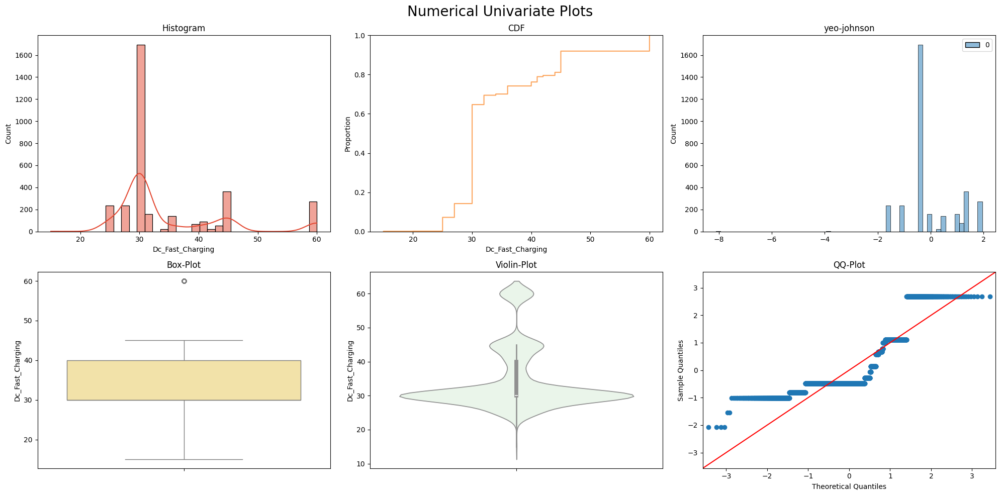

In [ ]:
eda_helper.numerical_univariate_plots(electric_df['Dc_Fast_Charging'])

#### **Observation From `Dc_Fast_Charging`**:

1. Column have 15% of null values with moderate skewness and contains multiple small peaks with std of just 9 mins.

2. 90% of cars take less than 50 minutes to charge the battery (CDF plot).

`Actions Required`:
- Null Value imputation
- Transformation Needed.
- column can act as Categorical as well as numerical column, (decided during experiment tracking.)

---
# **Battery_Capacity**

In [ ]:
eda_helper.numerical_summary(electric_df['Battery_Capacity'])

,Battery_Capacity
0,131.0
260,70.0
322,88.0
339,NaN
341,68.0
...,...
270609,100.0
270623,91.0
270746,NaN
270898,91.0


Data Type : float64
Missing Data : 2305 (57.89 %)
Available Data : 1677 / 3982


,Battery_Capacity
0.01,18.0
0.05,27.0
0.10,40.0
0.25,68.0
0.50,77.0
0.75,91.0
0.90,93.0
0.95,123.0
0.99,131.0
1.00,131.0


,value
Mean,76.24
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,77.00


,value
Std,23
Varience,526
IQR,23


,value
Skewness,-0
Kurtosis,1


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


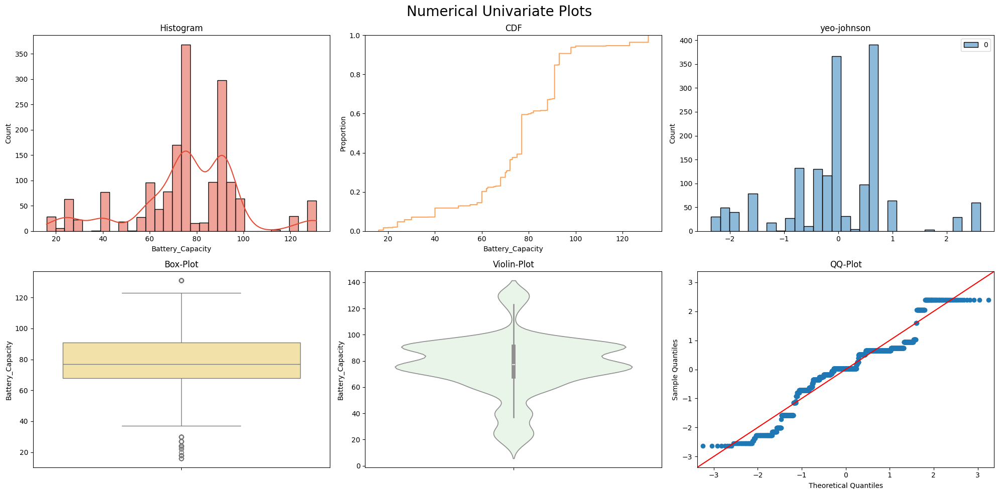

In [ ]:
eda_helper.numerical_univariate_plots(electric_df['Battery_Capacity'])

#### **Observation From `Battery_Capacity`**
---

1. Column contains 57.8% as null values with almost no skewness and no excess kurtosis, but contains two peaks.

2. Values are measured in kWh.

3. Understand detailed info about kWh and kW [here](https:www.youtube.com/watch?v=Ld_PbMP_9SI).

4. Most of Values fall below the capacity of 90kWh (CDF plot)

`Actions Required`:
- Missing Value Imputation, if not possible, I need to drop this column.
- Column can act as Categorical as well as numerical column, (decided during experiment tracking.)



---
# **Excepted_Range**

In [ ]:
eda_helper.numerical_summary(df['Excepted_Range'])

,Excepted_Range
0,290.0
1,NaN
2,NaN
3,NaN
4,NaN
...,...
271248,NaN
271249,NaN
271250,NaN
271251,NaN


Data Type : float64
Missing Data : 266827 (98.37 %)
Available Data : 4426 / 271253


,Excepted_Range
0.01,61.500
0.05,153.625
0.10,209.250
0.25,236.500
0.50,261.500
0.75,285.000
0.90,312.250
0.95,330.500
0.99,371.500
1.00,389.000


,value
Mean,256.72
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,261.50


,value
Std,51
Varience,"2,634"
IQR,48


,value
Skewness,-1
Kurtosis,3


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


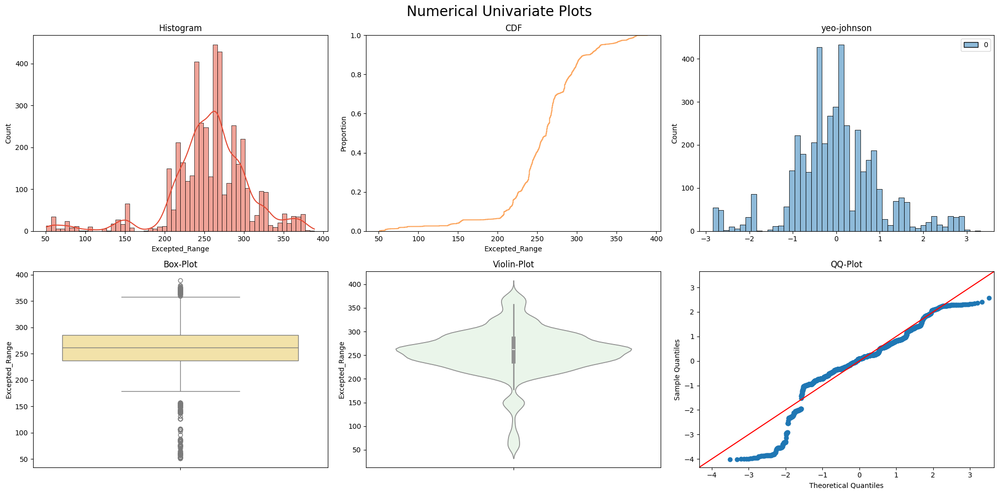

In [ ]:
eda_helper.numerical_univariate_plots(df['Excepted_Range'])

#### **Observations From `Expected_Range`**
---

1. Column when splitted based on electric or non-electric car, shows that electric cars have only 18% of this value as missing , where as other cars df have almost all value as null.

2. Data is negativly skewed and excess kurtosis as zero.

3. Cars which have expected range between 50-200 (in miles) are very less in number (less than 1 percent of entire dataset)

4. Data Can achive perfect normality if extreme value are detected as outliers.

`Actions Required`:
- Missing Value Imputation, it should be done seperatly for electric and non electric cars.
- Transformation
- Outlier Detection
- Convert unit from `Miles` to `KM`

---
# **Seller_Name**

In [ ]:
eda_helper.cat_summary(df['Seller_Name'])

#### Observations From `Seller_Name`
---

1. Column contains 15k+ unique categories with only 0.76% of values as missing
2. Most freq category is gateway classic cars with almost 400 cars listed.

`Actions Required`:
- No action is requried as this column will not be used during prediction.

---
# **Seller_Rating**

In [ ]:
eda_helper.numerical_summary(df['Seller_Rating'])

,Seller_Rating
0,5.0
1,5.0
2,0.0
3,4.1
4,4.9
...,...
271248,4.8
271249,5.0
271250,5.0
271251,4.5


Data Type : float64
Missing Data : 0 (0.0 %)
Available Data : 271253 / 271253


,Seller_Rating
0.01,0.0
0.05,0.0
0.10,0.0
0.25,3.5
0.50,4.5
0.75,4.9
0.90,5.0
0.95,5.0
0.99,5.0
1.00,5.0


,value
Mean,3.65
Trimmed Mean (5%),3.78
Trimmed Mean (10%),3.94
Median,4.50


,value
Std,2
Varience,3
IQR,1


,value
Skewness,-1
Kurtosis,0


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


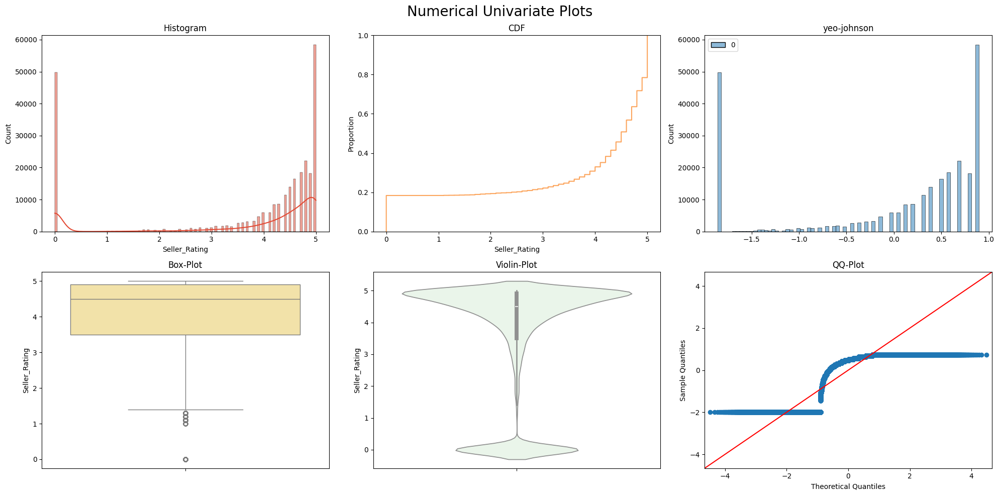

In [ ]:
eda_helper.numerical_univariate_plots(df['Seller_Rating'])

#### **Observations From `Seller_Rating`**

1. Column contains a lot of zero values, which is because no one has given any rating to those sellers.

2. Graph show Exponential nature (if I ignore zeros).

`Actions Requried`:
- No action is requried as this column will not be used during prediction.

---
# **People_Count_Seller_Rating**

In [ ]:
eda_helper.numerical_summary(df['People_Count_Seller_Rating'])

,People_Count_Seller_Rating
0,16.0
1,17.0
2,17.0
3,104.0
4,466.0
...,...
271248,21.0
271249,12.0
271250,50.0
271251,1873.0


Data Type : float64
Missing Data : 4015 (1.48 %)
Available Data : 267238 / 271253


,People_Count_Seller_Rating
0.01,0.0
0.05,4.0
0.10,8.0
0.25,26.0
0.50,145.0
0.75,644.0
0.90,1610.0
0.95,2429.0
0.99,4895.0
1.00,18176.0


,value
Mean,562.44
Trimmed Mean (5%),440.07
Trimmed Mean (10%),353.56
Median,145.00


,value
Std,"1,009"
Varience,"1,018,754"
IQR,618


,value
Skewness,4
Kurtosis,23


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


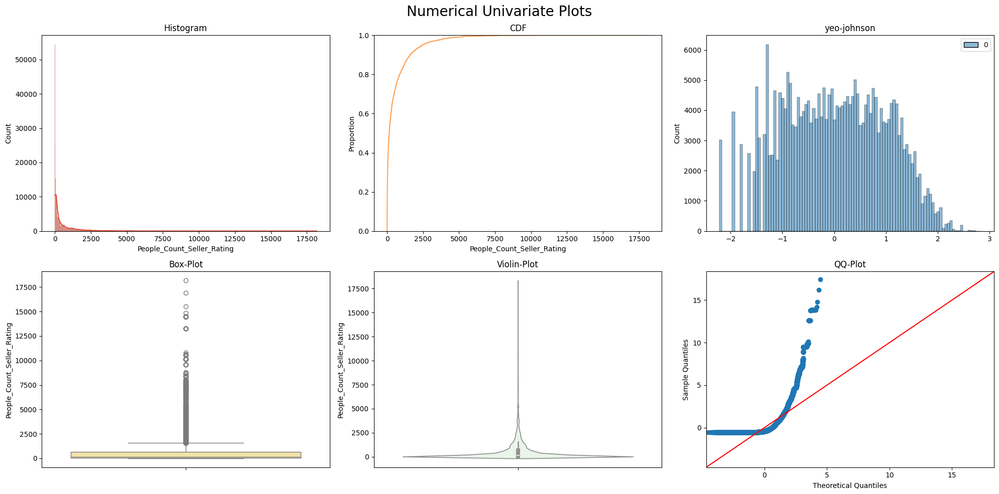

In [ ]:
eda_helper.numerical_univariate_plots(df['People_Count_Seller_Rating'])

#### **Observation From `People_Count_Seller_Rating`**
---

1. Data is right skewed, impact of outlier can be seen clearly.
2. Yeo-Johnson transformation is working fine on this column.
3. More than 90% of values are less than 2500 counts.
4. 1.4% of values are missing.

`Actions Required`:
- No action is requried as this column will not be used during prediction.

---
# **Car_Rating**

In [ ]:
eda_helper.numerical_summary(df['Car_Rating'])

,Car_Rating
0,4.2
1,4.7
2,4.7
3,3.8
4,3.5
...,...
271248,4.2
271249,4.8
271250,4.2
271251,4.0


Data Type : float64
Missing Data : 52079 (19.2 %)
Available Data : 219174 / 271253


,Car_Rating
0.01,2.6
0.05,3.7
0.10,3.9
0.25,4.3
0.50,4.7
0.75,4.9
0.90,5.0
0.95,5.0
0.99,5.0
1.00,5.0


,value
Mean,4.53
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,4.70


,value
Std,1
Varience,0
IQR,1


,value
Skewness,-2
Kurtosis,9


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


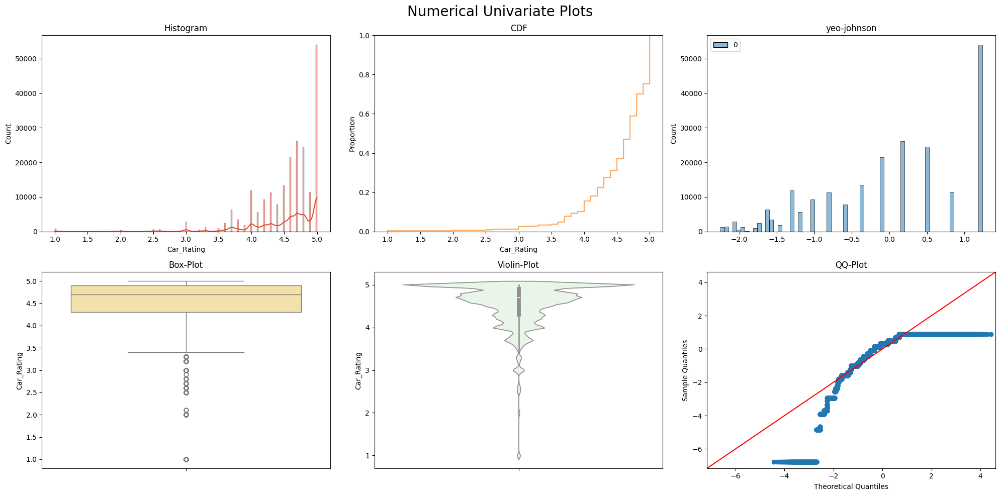

In [ ]:
eda_helper.numerical_univariate_plots(df['Car_Rating'])

#### **Observations From `Car_Rating`**
---

1. Column is negatively skewed with Leptokurses.
2. Data contains 19.2% missing values.
3. Most of cars are rated between 3 to 5

`Actions Required`:

- No action is requried as this column will not be used during prediction, as rating are not standarize, means same car can have different rating.

---
# **People_Count_Car_Rating**

In [ ]:
eda_helper.numerical_summary(df['People_Count_Car_Rating'])

,People_Count_Car_Rating
0,18.0
1,3.0
2,304.0
3,5.0
4,4.0
...,...
271248,8.0
271249,172.0
271250,5.0
271251,2.0


Data Type : float64
Missing Data : 52079 (19.2 %)
Available Data : 219174 / 271253


,People_Count_Car_Rating
0.01,1.0
0.05,1.0
0.10,1.0
0.25,3.0
0.50,10.0
0.75,74.0
0.90,204.0
0.95,291.0
0.99,553.0
1.00,838.0


,value
Mean,62.36
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,10.00


,value
Std,114
Varience,"12,924"
IQR,71


,value
Skewness,3
Kurtosis,12


#### **Observation From People_Count_Car_Rating**
---

1. Column is positively skewed with Leptokurtsis tails.
2. Contains 19.2% of missing values.

`Actions Required`:
- No action is requried as this column will not be used during prediction.

---
# **Gear_Spec**

In [ ]:
eda_helper.cat_summary(df['Gear_Spec'])

,Gear_Spec
0,NaN
1,NaN
2,6
3,10
4,7
...,...
271248,NaN
271249,8
271250,NaN
271251,NaN


Data Type : object
No. of unique value : 11
Missing Rows : 175647 (64.75 %)
Available Data : 95606 / 271253 rows


,Gear_Spec
count,95606
unique,11
top,10
freq,35337


,count,proportion
Gear_Spec,,
10,35337,36.961
8,31211,32.645
6,13427,14.044
9,5795,6.061
5,3677,3.846
7,3067,3.208
1,1973,2.064
4,967,1.011
2,89,0.093


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


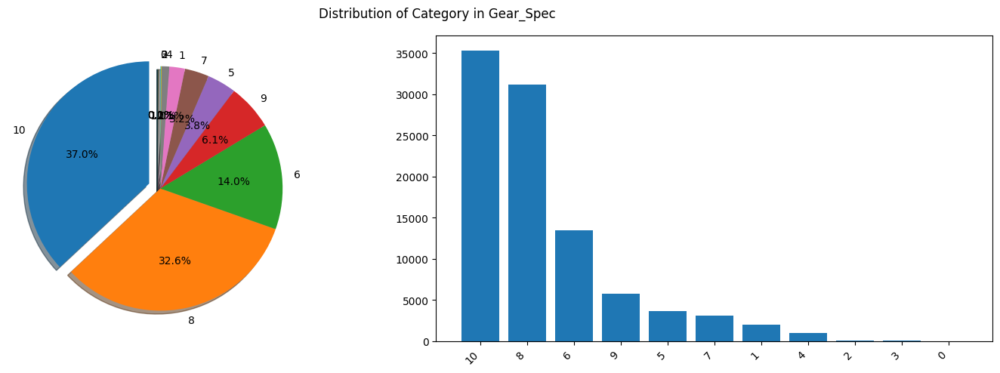

In [ ]:
eda_helper.categorical_univariate_plot(df['Gear_Spec'],wrdcld=False)

#### **Observation From `Gear_Spec`**
---

1. Column have 10 unique category with 64.7% of values are missing.
2. 10 Gears is leading at top with 36.9%, followed by 8 Gears car 32.6% and 6 Gear cars 14.0%.

`Actions Required`:
- Missing value Imputation.
- Convert data type to Category `Cleaning`.
- Gear_Spec with 0 value is not possible. `Cleaning`

---
# **Engine_Size**

In [ ]:
eda_helper.cat_summary(df['Engine_Size'])

,Engine_Size
0,NaN
1,2
2,5.0
3,6.2
4,2.0
...,...
271248,2.4
271249,3.6
271250,3
271251,2


Data Type : object
No. of unique value : 74
Missing Rows : 13668 (5.04 %)
Available Data : 257585 / 271253 rows


,Engine_Size
count,257585
unique,74
top,3.5
freq,34604


,count,proportion
Engine_Size,,
3.5,34604,13.434
2.5,33904,13.162
3.6,28240,10.963
2,27969,10.858
1.5,18990,7.372
6.6,16178,6.281
2.0,15602,6.057
5.3,8033,3.119
2.3,7088,2.752


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


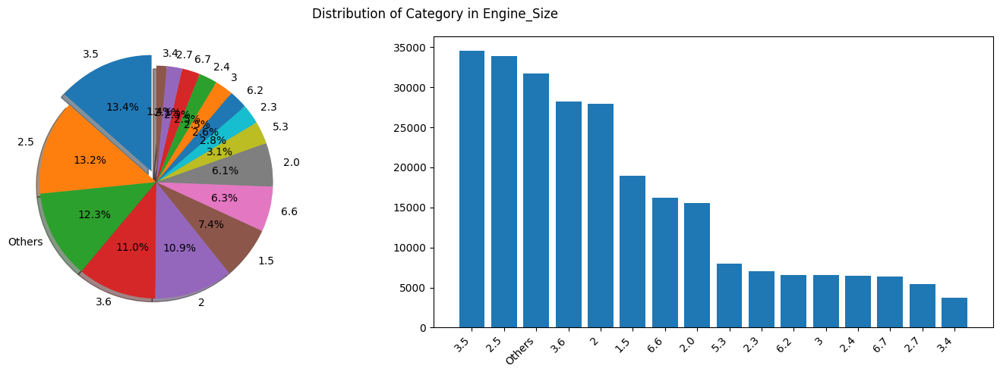

In [ ]:
eda_helper.categorical_univariate_plot(df['Engine_Size'],wrdcld=False,k=15)

#### **Observation From `Engine_Size`**

1. Column have 74 unique values with 5.0% of null values.
2. Most common category is 3.5 L (13.4%), followed by 2.5L (13.1%) and 3.6L engine (10.9%)

`Actions Required`:
- Few of Engine size looks wired - Outlier Detection required.
- Missing Value imputation.
- If rounding of the values to nearest value does not have significant impact, in that case I will round off the Engine size.

---
# **Cylinder_Config**

In [ ]:
eda_helper.cat_summary(df['Cylinder_Config'])

,Cylinder_Config
0,NaN
1,I4
2,V8
3,V8
4,I4
...,...
271248,I4
271249,V6
271250,I6
271251,I4


Data Type : object
No. of unique value : 22
Missing Rows : 17876 (6.59 %)
Available Data : 253377 / 271253 rows


,Cylinder_Config
count,253377
unique,22
top,I4
freq,103298


,count,proportion
Cylinder_Config,,
I4,103298,40.768
V6,80413,31.737
V8,49450,19.516
I6,7828,3.089
I3,5340,2.108
H4,4273,1.686
H6,1760,0.695
I5,773,0.305
V2,92,0.036


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


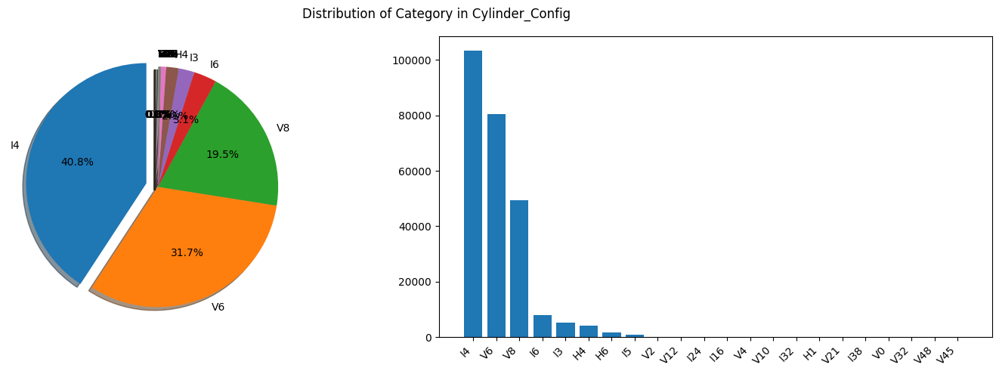

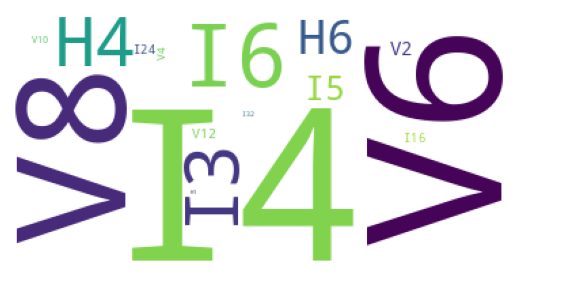

In [ ]:
eda_helper.categorical_univariate_plot(df['Cylinder_Config'])

#### **Observation From `Cylinder_Config`**
---
1. Data contains 22 unique values with 6.5% of null values.
2. Top Cylinder type is I4 (40%), followed by V6 and V8, 31.7% & 19.5% respectively.

`Actions Required`:
- Column have moderate cardinality, if possible we can consider merging of categories (after gathering some domain knowledge).
- If cardinality reduced, we can change data type to category.
- Missing Value Imputation.
- Category `V0` in this column seems strange `Cleaning`

---
# **Valves**

In [ ]:
eda_helper.cat_summary(df['Valves'])

,Valves
0,NaN
1,NaN
2,NaN
3,NaN
4,16
...,...
271248,NaN
271249,NaN
271250,NaN
271251,NaN


Data Type : object
No. of unique value : 12
Missing Rows : 191376 (70.55 %)
Available Data : 79877 / 271253 rows


,Valves
count,79877
unique,12
top,16
freq,40680


,count,proportion
Valves,,
16,40680,50.928
24,28860,36.131
32,7392,9.254
12,2894,3.623
20,12,0.015
18,11,0.014
36,8,0.010
4,8,0.010
2,6,0.008


None

#### **Observations From `Valves`**
---

1. Column contains 70.55% of values as null.
2. Have 12 unique values
3. top categories are 16 Valves, 24 and 32 valves with proportion of 50.9%, 36.1% and 9.2% respectively.


`Actions Required`:
- Few categories have less frequecy, hence they can be combined to form others category (after having domain knowledge).
- Missing Value Imputation

---
# **Boolean Columns**

In [ ]:
boolean_cols = ['Adaptive_Cruise_Control', 'Cooled_Seats',
       'Heated_Seats', 'Heated_Steering_Wheels', 'Keyless_Entry',
       'Keyless_Start', 'Navigation_System', 'Remote_Start', 'Power_Liftgate',
       'Automatic_Parking', 'Power_Folding_Mirror', 'Wheel_Chair_Accessible',
       'Autopilot', 'Android_Auto', 'Apple_Carplay', 'Bluetooth',
       'Premium_Sound_System', 'Usb_Port', 'Wifi_Hotspot', 'Satellite_Radio',
       'Cd_Player', 'Homelink', 'Rear_Seat_Entertainment', 'Dvd_Player',
       'Alloy_Wheels', 'Sunroof_Moonroof', 'Tow_Hitch', 'Tow_Hooks',
       'Roof_Rack', 'Automatic_Emergency_Braking', 'Backup_Camera',
       'Blind_Spot_Monitor', 'Brake_Assist', 'Led_Headlights',
       'Lane_Departure_Warning', 'Rear_Cross_Traffic_Alert',
       'Stability_Control', 'Rain_Sensing_Wipers', 'Leather_Seats',
       'Memory_Seat', 'Third_Row_Seating']

for col in boolean_cols:
  eda_helper.cat_summary(df[col])

,Adaptive_Cruise_Control
0,True
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,True
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 141536 (52.18 %)
Available Data : 129717 / 271253 rows


,Adaptive_Cruise_Control
count,129717
unique,1
top,True
freq,129717


,count,proportion
Adaptive_Cruise_Control,,
True,129717,100.0


None

,Cooled_Seats
0,True
1,<NA>
2,<NA>
3,<NA>
4,<NA>
...,...
271248,<NA>
271249,True
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 236216 (87.08 %)
Available Data : 35037 / 271253 rows


,Cooled_Seats
count,35037
unique,1
top,True
freq,35037


,count,proportion
Cooled_Seats,,
True,35037,100.0


None

,Heated_Seats
0,True
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,<NA>
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 116337 (42.89 %)
Available Data : 154916 / 271253 rows


,Heated_Seats
count,154916
unique,1
top,True
freq,154916


,count,proportion
Heated_Seats,,
True,154916,100.0


None

,Heated_Steering_Wheels
0,True
1,<NA>
2,<NA>
3,<NA>
4,True
...,...
271248,<NA>
271249,True
271250,<NA>
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 175369 (64.65 %)
Available Data : 95884 / 271253 rows


,Heated_Steering_Wheels
count,95884
unique,1
top,True
freq,95884


,count,proportion
Heated_Steering_Wheels,,
True,95884,100.0


None

,Keyless_Entry
0,True
1,True
2,True
3,True
4,True
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 34914 (12.87 %)
Available Data : 236339 / 271253 rows


,Keyless_Entry
count,236339
unique,1
top,True
freq,236339


,count,proportion
Keyless_Entry,,
True,236339,100.0


None

,Keyless_Start
0,True
1,True
2,<NA>
3,True
4,<NA>
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 85512 (31.52 %)
Available Data : 185741 / 271253 rows


,Keyless_Start
count,185741
unique,1
top,True
freq,185741


,count,proportion
Keyless_Start,,
True,185741,100.0


None

,Navigation_System
0,True
1,<NA>
2,<NA>
3,True
4,<NA>
...,...
271248,<NA>
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 143217 (52.8 %)
Available Data : 128036 / 271253 rows


,Navigation_System
count,128036
unique,1
top,True
freq,128036


,count,proportion
Navigation_System,,
True,128036,100.0


None

,Remote_Start
0,True
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,True
271249,True
271250,<NA>
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 127922 (47.16 %)
Available Data : 143331 / 271253 rows


,Remote_Start
count,143331
unique,1
top,True
freq,143331


,count,proportion
Remote_Start,,
True,143331,100.0


None

,Power_Liftgate
0,<NA>
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,<NA>
271249,<NA>
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 192065 (70.81 %)
Available Data : 79188 / 271253 rows


,Power_Liftgate
count,79188
unique,1
top,True
freq,79188


,count,proportion
Power_Liftgate,,
True,79188,100.0


None

,Automatic_Parking
0,<NA>
1,<NA>
2,<NA>
3,<NA>
4,<NA>
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 267025 (98.44 %)
Available Data : 4228 / 271253 rows


,Automatic_Parking
count,4228
unique,1
top,True
freq,4228


,count,proportion
Automatic_Parking,,
True,4228,100.0


None

,Power_Folding_Mirror
0,<NA>
1,<NA>
2,<NA>
3,<NA>
4,<NA>
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 257064 (94.77 %)
Available Data : 14189 / 271253 rows


,Power_Folding_Mirror
count,14189
unique,1
top,True
freq,14189


,count,proportion
Power_Folding_Mirror,,
True,14189,100.0


None

,Wheel_Chair_Accessible
0,<NA>
1,<NA>
2,<NA>
3,<NA>
4,<NA>
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 271195 (99.98 %)
Available Data : 58 / 271253 rows


,Wheel_Chair_Accessible
count,58
unique,1
top,True
freq,58


,count,proportion
Wheel_Chair_Accessible,,
True,58,100.0


None

,Autopilot
0,<NA>
1,<NA>
2,<NA>
3,<NA>
4,<NA>
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 270758 (99.82 %)
Available Data : 495 / 271253 rows


,Autopilot
count,495
unique,1
top,True
freq,495


,count,proportion
Autopilot,,
True,495,100.0


None

,Android_Auto
0,True
1,True
2,<NA>
3,True
4,<NA>
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 144353 (53.22 %)
Available Data : 126900 / 271253 rows


,Android_Auto
count,126900
unique,1
top,True
freq,126900


,count,proportion
Android_Auto,,
True,126900,100.0


None

,Apple_Carplay
0,True
1,True
2,<NA>
3,True
4,<NA>
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 90149 (33.23 %)
Available Data : 181104 / 271253 rows


,Apple_Carplay
count,181104
unique,1
top,True
freq,181104


,count,proportion
Apple_Carplay,,
True,181104,100.0


None

,Bluetooth
0,True
1,True
2,<NA>
3,True
4,True
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 20640 (7.61 %)
Available Data : 250613 / 271253 rows


,Bluetooth
count,250613
unique,1
top,True
freq,250613


,count,proportion
Bluetooth,,
True,250613,100.0


None

,Premium_Sound_System
0,True
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,<NA>
271249,<NA>
271250,True
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 181819 (67.03 %)
Available Data : 89434 / 271253 rows


,Premium_Sound_System
count,89434
unique,1
top,True
freq,89434


,count,proportion
Premium_Sound_System,,
True,89434,100.0


None

,Usb_Port
0,True
1,True
2,<NA>
3,True
4,<NA>
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 62756 (23.14 %)
Available Data : 208497 / 271253 rows


,Usb_Port
count,208497
unique,1
top,True
freq,208497


,count,proportion
Usb_Port,,
True,208497,100.0


None

,Wifi_Hotspot
0,True
1,True
2,<NA>
3,True
4,<NA>
...,...
271248,True
271249,<NA>
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 120752 (44.52 %)
Available Data : 150501 / 271253 rows


,Wifi_Hotspot
count,150501
unique,1
top,True
freq,150501


,count,proportion
Wifi_Hotspot,,
True,150501,100.0


None

,Satellite_Radio
0,<NA>
1,True
2,<NA>
3,<NA>
4,<NA>
...,...
271248,<NA>
271249,True
271250,<NA>
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 157342 (58.01 %)
Available Data : 113911 / 271253 rows


,Satellite_Radio
count,113911
unique,1
top,True
freq,113911


,count,proportion
Satellite_Radio,,
True,113911,100.0


None

,Cd_Player
0,<NA>
1,<NA>
2,True
3,<NA>
4,<NA>
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 231748 (85.44 %)
Available Data : 39505 / 271253 rows


,Cd_Player
count,39505
unique,1
top,True
freq,39505


,count,proportion
Cd_Player,,
True,39505,100.0


None

,Homelink
0,<NA>
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,<NA>
271249,True
271250,<NA>
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 200334 (73.86 %)
Available Data : 70919 / 271253 rows


,Homelink
count,70919
unique,1
top,True
freq,70919


,count,proportion
Homelink,,
True,70919,100.0


None

,Rear_Seat_Entertainment
0,<NA>
1,<NA>
2,<NA>
3,True
4,<NA>
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 266722 (98.33 %)
Available Data : 4531 / 271253 rows


,Rear_Seat_Entertainment
count,4531
unique,1
top,True
freq,4531


,count,proportion
Rear_Seat_Entertainment,,
True,4531,100.0


None

,Dvd_Player
0,<NA>
1,<NA>
2,<NA>
3,<NA>
4,<NA>
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 265347 (97.82 %)
Available Data : 5906 / 271253 rows


,Dvd_Player
count,5906
unique,1
top,True
freq,5906


,count,proportion
Dvd_Player,,
True,5906,100.0


None

,Alloy_Wheels
0,True
1,True
2,True
3,True
4,True
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 37563 (13.85 %)
Available Data : 233690 / 271253 rows


,Alloy_Wheels
count,233690
unique,1
top,True
freq,233690


,count,proportion
Alloy_Wheels,,
True,233690,100.0


None

,Sunroof_Moonroof
0,True
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,<NA>
271249,<NA>
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 159246 (58.71 %)
Available Data : 112007 / 271253 rows


,Sunroof_Moonroof
count,112007
unique,1
top,True
freq,112007


,count,proportion
Sunroof_Moonroof,,
True,112007,100.0


None

,Tow_Hitch
0,True
1,True
2,True
3,True
4,<NA>
...,...
271248,True
271249,<NA>
271250,<NA>
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 184679 (68.08 %)
Available Data : 86574 / 271253 rows


,Tow_Hitch
count,86574
unique,1
top,True
freq,86574


,count,proportion
Tow_Hitch,,
True,86574,100.0


None

,Tow_Hooks
0,True
1,<NA>
2,True
3,True
4,<NA>
...,...
271248,True
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 209870 (77.37 %)
Available Data : 61383 / 271253 rows


,Tow_Hooks
count,61383
unique,1
top,True
freq,61383


,count,proportion
Tow_Hooks,,
True,61383,100.0


None

,Roof_Rack
0,<NA>
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 240112 (88.52 %)
Available Data : 31141 / 271253 rows


,Roof_Rack
count,31141
unique,1
top,True
freq,31141


,count,proportion
Roof_Rack,,
True,31141,100.0


None

,Automatic_Emergency_Braking
0,True
1,True
2,<NA>
3,True
4,<NA>
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 78867 (29.08 %)
Available Data : 192386 / 271253 rows


,Automatic_Emergency_Braking
count,192386
unique,1
top,True
freq,192386


,count,proportion
Automatic_Emergency_Braking,,
True,192386,100.0


None

,Backup_Camera
0,True
1,True
2,<NA>
3,True
4,True
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 26597 (9.81 %)
Available Data : 244656 / 271253 rows


,Backup_Camera
count,244656
unique,1
top,True
freq,244656


,count,proportion
Backup_Camera,,
True,244656,100.0


None

,Blind_Spot_Monitor
0,True
1,<NA>
2,<NA>
3,True
4,<NA>
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 127855 (47.13 %)
Available Data : 143398 / 271253 rows


,Blind_Spot_Monitor
count,143398
unique,1
top,True
freq,143398


,count,proportion
Blind_Spot_Monitor,,
True,143398,100.0


None

,Brake_Assist
0,True
1,True
2,True
3,True
4,True
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 18971 (6.99 %)
Available Data : 252282 / 271253 rows


,Brake_Assist
count,252282
unique,1
top,True
freq,252282


,count,proportion
Brake_Assist,,
True,252282,100.0


None

,Led_Headlights
0,True
1,True
2,<NA>
3,True
4,<NA>
...,...
271248,True
271249,<NA>
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 142143 (52.4 %)
Available Data : 129110 / 271253 rows


,Led_Headlights
count,129110
unique,1
top,True
freq,129110


,count,proportion
Led_Headlights,,
True,129110,100.0


None

,Lane_Departure_Warning
0,True
1,True
2,<NA>
3,True
4,<NA>
...,...
271248,True
271249,<NA>
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 99389 (36.64 %)
Available Data : 171864 / 271253 rows


,Lane_Departure_Warning
count,171864
unique,1
top,True
freq,171864


,count,proportion
Lane_Departure_Warning,,
True,171864,100.0


None

,Rear_Cross_Traffic_Alert
0,True
1,<NA>
2,<NA>
3,<NA>
4,<NA>
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 151942 (56.01 %)
Available Data : 119311 / 271253 rows


,Rear_Cross_Traffic_Alert
count,119311
unique,1
top,True
freq,119311


,count,proportion
Rear_Cross_Traffic_Alert,,
True,119311,100.0


None

,Stability_Control
0,True
1,True
2,True
3,True
4,True
...,...
271248,True
271249,True
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 14121 (5.21 %)
Available Data : 257132 / 271253 rows


,Stability_Control
count,257132
unique,1
top,True
freq,257132


,count,proportion
Stability_Control,,
True,257132,100.0


None

,Rain_Sensing_Wipers
0,<NA>
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 214071 (78.92 %)
Available Data : 57182 / 271253 rows


,Rain_Sensing_Wipers
count,57182
unique,1
top,True
freq,57182


,count,proportion
Rain_Sensing_Wipers,,
True,57182,100.0


None

,Leather_Seats
0,True
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,<NA>
271249,True
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 158217 (58.33 %)
Available Data : 113036 / 271253 rows


,Leather_Seats
count,113036
unique,1
top,True
freq,113036


,count,proportion
Leather_Seats,,
True,113036,100.0


None

,Memory_Seat
0,True
1,<NA>
2,<NA>
3,True
4,True
...,...
271248,<NA>
271249,<NA>
271250,True
271251,True


Data Type : boolean
No. of unique value : 1
Missing Rows : 174983 (64.51 %)
Available Data : 96270 / 271253 rows


,Memory_Seat
count,96270
unique,1
top,True
freq,96270


,count,proportion
Memory_Seat,,
True,96270,100.0


None

,Third_Row_Seating
0,<NA>
1,<NA>
2,<NA>
3,True
4,<NA>
...,...
271248,<NA>
271249,<NA>
271250,<NA>
271251,<NA>


Data Type : boolean
No. of unique value : 1
Missing Rows : 228920 (84.39 %)
Available Data : 42333 / 271253 rows


,Third_Row_Seating
count,42333
unique,1
top,True
freq,42333


,count,proportion
Third_Row_Seating,,
True,42333,100.0


None

#### **Observation From `boolean columns`**
---

1. All this column have null values which ranges between 10% to even 99% of data.
2. Null values can be interpreted as either that car does not have a perticular aminety (False) or it is really a nan(may be True or False).
3. Null values can have different interpretation too, during scraping phase if a perticular aminety is not present in car, in that case I have stored nan in those column, (just because I want to cross verify that's why I stored it as nan).

`Actions Required`:
- Investigate from source website whether they are sure that if perticular amenity is not listed , car don't have that amenity.
- Missing value imputation (Algo based & Domain Based)
- Remove Columns

---
# **Mpge_City & Mpge_Hwy**

In [ ]:
eda_helper.numerical_summary(electric_df['Mpge_City'])

,Mpge_City
0,73.0
260,110.0
322,90.0
339,141.0
341,105.0
...,...
270609,NaN
270623,95.0
270746,120.0
270898,NaN


Data Type : float64
Missing Data : 390 (9.79 %)
Available Data : 3592 / 3982


,Mpge_City
0.01,74.0
0.05,88.0
0.10,92.0
0.25,104.0
0.50,121.0
0.75,131.0
0.90,138.0
0.95,141.0
0.99,150.0
1.00,150.0


,value
Mean,117.29
Trimmed Mean (5%),NaN
Trimmed Mean (10%),121.51
Median,121.00


,value
Std,18
Varience,338
IQR,27


,value
Skewness,-1
Kurtosis,0


In [ ]:
eda_helper.numerical_summary(electric_df['Mpge_Hwy'])

,Mpge_Hwy
0,60.0
260,96.0
322,77.0
339,127.0
341,93.0
...,...
270609,NaN
270623,85.0
270746,112.0
270898,NaN


Data Type : float64
Missing Data : 390 (9.79 %)
Available Data : 3592 / 3982


,Mpge_Hwy
0.01,61.0
0.05,75.0
0.10,85.0
0.25,93.0
0.50,107.0
0.75,117.0
0.90,126.0
0.95,127.0
0.99,133.0
1.00,133.0


,value
Mean,104.80
Trimmed Mean (5%),NaN
Trimmed Mean (10%),108.83
Median,107.00


,value
Std,17
Varience,289
IQR,24


,value
Skewness,-1
Kurtosis,0


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


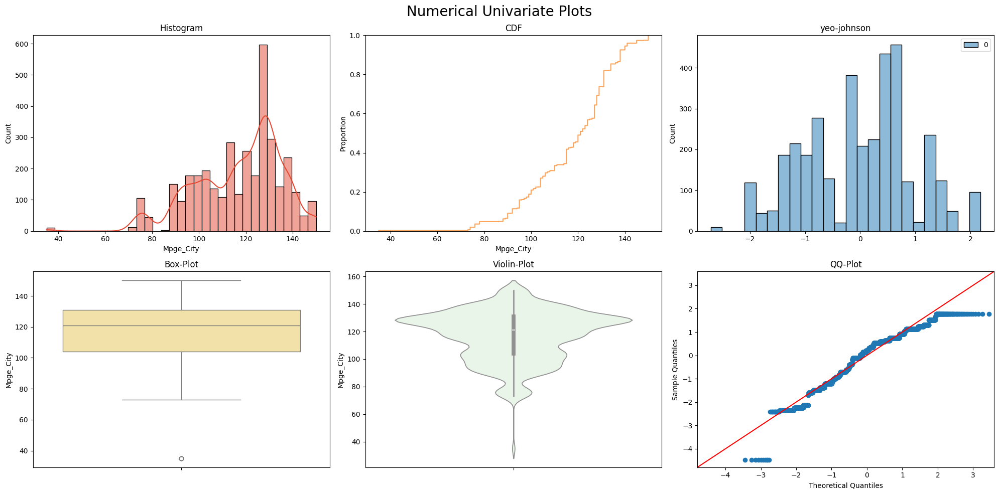

In [ ]:
eda_helper.numerical_univariate_plots(electric_df['Mpge_City'])

/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


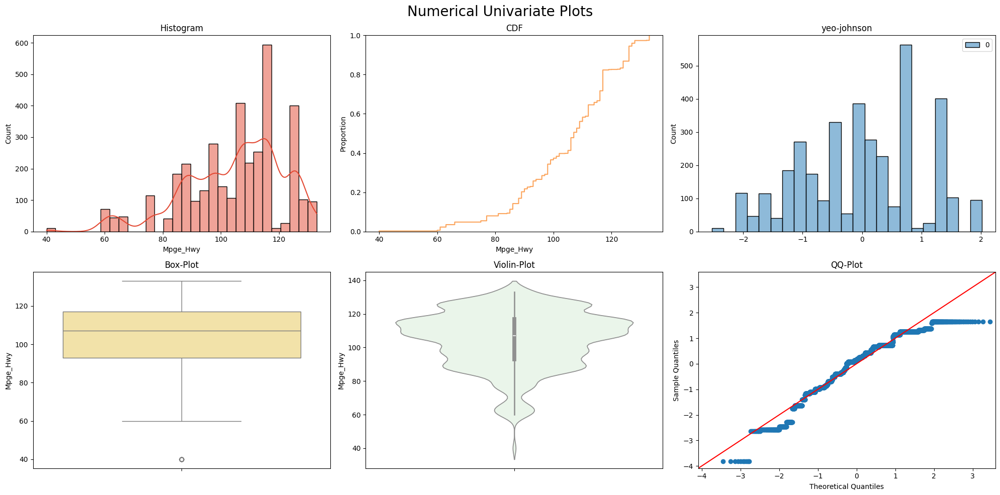

In [ ]:
eda_helper.numerical_univariate_plots(df[ 'Mpge_Hwy'])

#### **Observation From `Mpge_City` & `Mpge_Hwy`**
---

1. Both Columns are negatively skewed with Mesokurtis.
2. Contains 9.7% of missing values in both columns.
3. Most of value lies above 80 Mpge.

`Actions Required`
- Will check through domain knowledge whether we can combine Mpge_City and Mpge_hwy columns.
- If possible I will try to convert this columns into Km/L, as it is more intutive for me.
- Outlier Detection and removal
- Transformation (if needed)

---
# **Battery_Range_Score_Cleaned**

In [ ]:
eda_helper.cat_summary(electric_df['Battery_Range_Score_Cleaned'].astype('category'))

,Battery_Range_Score_Cleaned
0,NaN
260,100
322,104
339,NaN
341,100
...,...
270609,NaN
270623,NaN
270746,NaN
270898,NaN


Data Type : category
No. of unique value : 7
Missing Rows : 3470 (87.14 %)
Available Data : 512 / 3982 rows


,Battery_Range_Score_Cleaned
count,512
unique,7
top,100
freq,157


,count,proportion
Battery_Range_Score_Cleaned,,
100,157,30.664
104,114,22.266
101,93,18.164
103,59,11.523
105,49,9.570
102,39,7.617
115,1,0.195


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


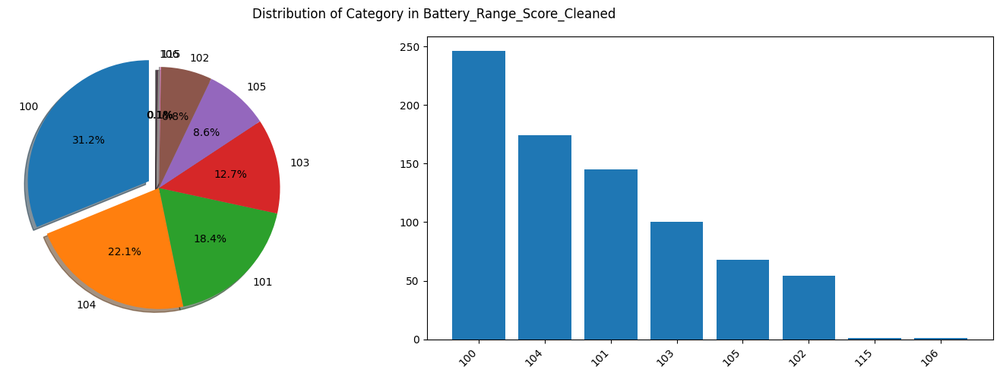

In [ ]:
eda_helper.categorical_univariate_plot(df['Battery_Range_Score_Cleaned'],wrdcld=False)

#### **Observations From `Battery_Range_Score_Cleaned`**
---

1. 87.1% of values are missing.
2. Data is positively skewed with no excess kurtosis.

`Actions Required`:
- Most likely I will drop this column.
- Change the column name.

---
# **Battery_Range_Score_Category**

In [ ]:
eda_helper.cat_summary(df['Battery_Range_Score_Category'])

,Battery_Range_Score_Category
0,NaN
1,NaN
2,NaN
3,NaN
4,NaN
...,...
271248,NaN
271249,NaN
271250,NaN
271251,NaN


Data Type : category
No. of unique value : 1
Missing Rows : 270464 (99.71 %)
Available Data : 789 / 271253 rows


,Battery_Range_Score_Category
count,789
unique,1
top,Outstanding
freq,789


,count,proportion
Battery_Range_Score_Category,,
Outstanding,789,100.0


None

#### **Observations From `Battery_Range_Score_Category`**
---

1. This column have 99.7% values as missing.
2. Also there is no varience is category.

`Actions Required`:
- Change the column name `Cleaning`
- After crosschecking on source website, whether they have any other category and criteria, if not I am drop this column

---
# **Street_Address**

In [ ]:
eda_helper.cat_summary(df['Street_Address'])

#### **Observations From `Street_Address`**
---

1. Contains around 0.7% of missing values
2. have 15k unique category

`Actions Required`:
- No actions required as this column will not be used during prediction.

---
# **City**

In [ ]:
eda_helper.cat_summary(df['City'])

,City
0,Gower
1,Perryville
2,Cortland
3,Granbury
4,Knoxville
...,...
271248,Muskogee
271249,Austin
271250,Darien
271251,Fremont


Data Type : object
No. of unique value : 3581
Missing Rows : 2092 (0.77 %)
Available Data : 269161 / 271253 rows


,City
count,269161
unique,3581
top,Houston
freq,2917


,count,proportion
City,,
Houston,2917,1.084
Miami,2213,0.822
Jacksonville,1716,0.638
Tampa,1692,0.629
Columbus,1585,0.589
Orlando,1396,0.519
San Antonio,1299,0.483
Austin,1276,0.474
Dallas,1272,0.473


None

#### **Observations From `City`**
---

1. Column contains 3500 Unique values.
2. contains 0.77 % as null

`Actions Required`:
- Misising Value imputation.
- Cardinality reduction by region if possible.
- Create infreq category to others.

---
# **State**

In [ ]:
eda_helper.cat_summary(df['State'])

,State
0,MO
1,MO
2,OH
3,TX
4,TN
...,...
271248,OK
271249,TX
271250,CT
271251,CA


Data Type : category
No. of unique value : 50
Missing Rows : 2092 (0.77 %)
Available Data : 269161 / 271253 rows


,State
count,269161
unique,50
top,FL
freq,24674


,count,proportion
State,,
FL,24674,9.167
TX,23688,8.801
CA,21336,7.927
IL,13479,5.008
OH,13310,4.945
NY,10097,3.751
GA,9104,3.382
VA,8727,3.242
MI,8607,3.198


None

/content/eda_helper.py:35: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


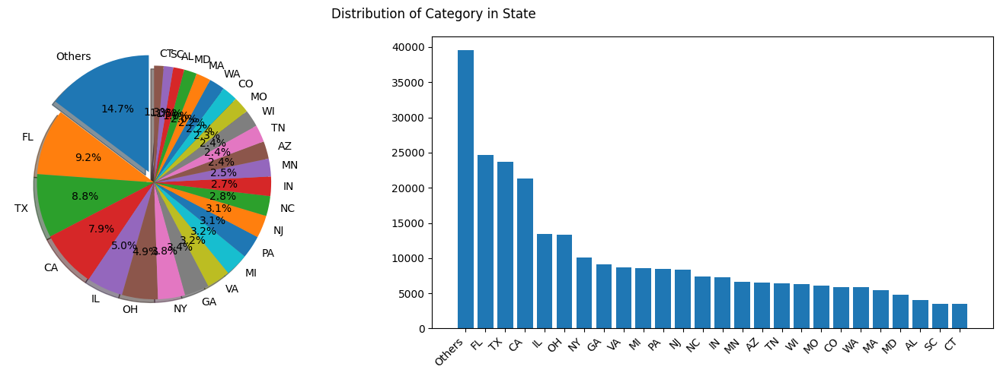

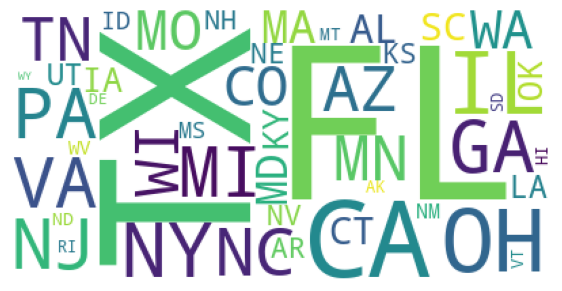

In [ ]:
eda_helper.categorical_univariate_plot(df['State'],k=25)

#### **Observation From `State`**
---

1. Column contains 0.77% of values as missing.
2. We have info about all 50 states of USA.
3. Most cars come from Florida, Taxes or California which contribute to 9.1%, 8.8% and 7.9% of total value respectively.


`Actions Required`:
- Missing value Imputation.

---
# **Postal Code**

In [ ]:
eda_helper.cat_summary(df['Postal_Code'])

,Postal_Code
0,64454.0
1,63775.0
2,44410.0
3,76049.0
4,37922.0
...,...
271248,74401.0
271249,78738.0
271250,6820.0
271251,94538.0


Data Type : float64
No. of unique value : 5587
Missing Rows : 2092 (0.77 %)
Available Data : 269161 / 271253 rows


,Postal_Code
count,269161.000000
mean,50542.043138
std,27801.362436
min,1001.000000
25%,30060.000000
50%,47714.000000
75%,76053.000000
max,99701.000000


,count,proportion
Postal_Code,,
30096.0,689,0.256
33619.0,644,0.239
29607.0,616,0.229
85260.0,599,0.223
76051.0,581,0.216
85297.0,563,0.209
43228.0,528,0.196
62269.0,522,0.194
33612.0,514,0.191


None

#### **Observations From `Postal Code`**
---

1. Contains 5500 of unique value and 0.7% of missing value

`Actions Required`:
- Change column name to ZIP codes `Cleaning`
- No action required as this column will not be used during prediction.

#  **Cleaning Actions I**
----
----

In [138]:
df = df.assign(
    Model_Year = lambda df_ : (
        df_
        .Model_Year
        .astype(int)
    ),
    Exterior_Color = lambda df_ : (
        df_
        .Exterior_Color
        .astype('category')
    ),
    Interior_Color = lambda df_ : (
        df_
        .Interior_Color
        .replace('grey','gray')
        .astype('category')
    ),
    Drivetrain = lambda df_ : (
        df_
        .Drivetrain
        .replace('2WD','FWD')
        .astype('category')
    ),
    Mpg = lambda df_ : (
        df_
        .Mpg
        .mul(0.425)
        .round()
        .replace(0,np.nan)
    ),

    Gear_Spec = lambda df_ : (
        df_
        .Gear_Spec
        .replace('0',np.nan)
        .astype('category')
    ),

    Cylinder_Config = lambda df_ : (
        df_
        .Cylinder_Config
        .replace('V0',np.nan)
        .astype('category')
    ),

    Mpge_City = lambda df_ : (
        df_
        .Mpge_City
        .mul(0.425)
        .round()
    ),

    Mpge_Hwy = lambda df_ : (
        df_.
        Mpge_Hwy
        .mul(0.425)
        .round()
    ),

    Engine_Size = lambda df_ : (
        df_
        .Engine_Size
        .astype(float)
    )

).rename(
    columns={
        'New_Used':'Stock_Type',
        'Mpg' : 'Km/L',
        'Postal_Code' : 'ZIP_Code',
        'Mpge_City'   :'Km/L_e_City',
        'Mpge_Hwy'    : 'Km/L_e_Hwy',
        'Excepted_Range'    : 'Expected_Range'
        })

# **Transformation Actions**
----
----

# **Model_Year: Custom Binning**

`Problem :`

- Pre-2000 Year have very less car, leading to unnecessary cardinality


`Solution :`
- Applying `Custom binning`, as pre-2000's data has `so many spikes` and have very less number of cars (less than 100 cars) in each year.

- Reducing the Categories by combining years to a decade for pre-2000 cars, this step will help reduce `unnecessary fluctuations` in data while preserving the relation with output column (General trend).

`Impact :`

- This step can be useful in Reducing the `Model Complexity`.
- Linear Models get Positively affected, because of reduce in `spikey nature (Fluctuations)` they can fit better.
- Tendency to Tree Based Algo to `overfit` by splitting each unique category is also reduced.
- Increased `Interpretability`, understand with example - people usually don't demand for a perticular 1967 Dodge model, they will ask by name of vintage cars, or by saying "I'm Interested in 1970's Dodge Model"

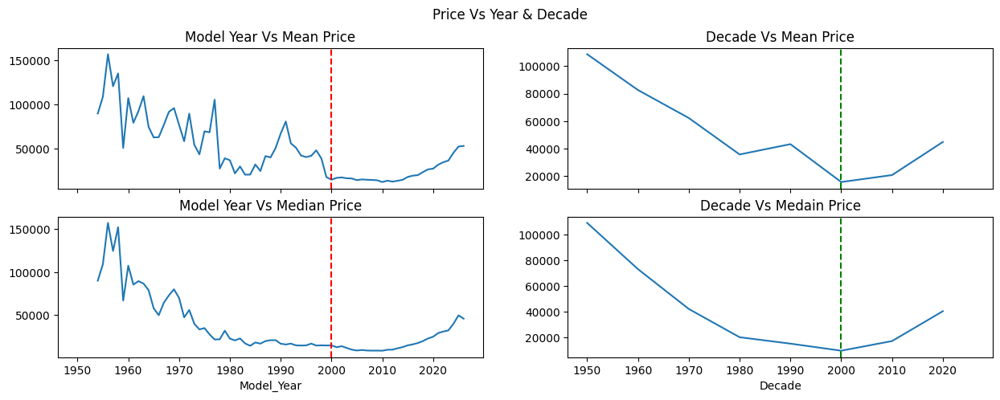

In [ ]:
fig,ax = plt.subplots(nrows=2,ncols=2,figsize=(15,5),sharex=True)

groupby_year = df.groupby("Model_Year")["Price"]
groupby_decade = df.assign(
    Decade=((
        df["Model_Year"]//10
        )*10).astype(int)
    ).groupby('Decade')['Price']

groupby_year.mean().plot(ax=ax[0][0])
ax[0][0].axvline(2000,color='red',linestyle='--')
ax[0][0].set_title('Model Year Vs Mean Price')

groupby_decade.mean().plot(ax=ax[0][1])
ax[0][1].axvline(2000,color='green',linestyle='--')
ax[0][1].set_title('Decade Vs Mean Price')

groupby_year.median().plot(ax=ax[1][0])
ax[1][0].axvline(2000,color='red',linestyle='--')
ax[1][0].set_title('Model Year Vs Median Price')

groupby_decade.median().plot(ax=ax[1][1])
ax[1][1].axvline(2000,color='green',linestyle='--')
ax[1][1].set_title('Decade Vs Medain Price')

fig.suptitle('Price Vs Year & Decade')
plt.show()

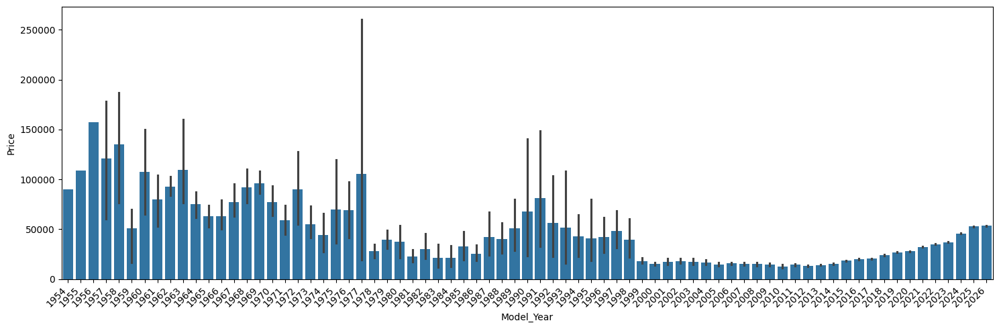

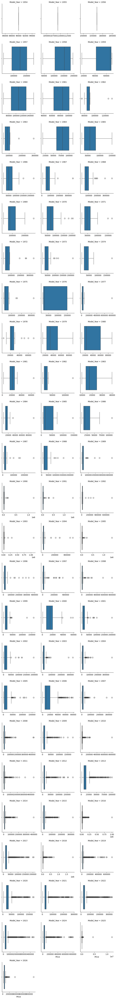

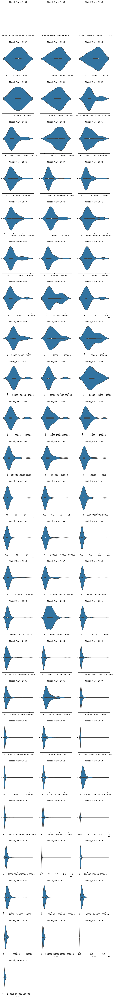

In [ ]:
eda_helper.num_cat_bivariate_plots(df,'Model_Year','Price')

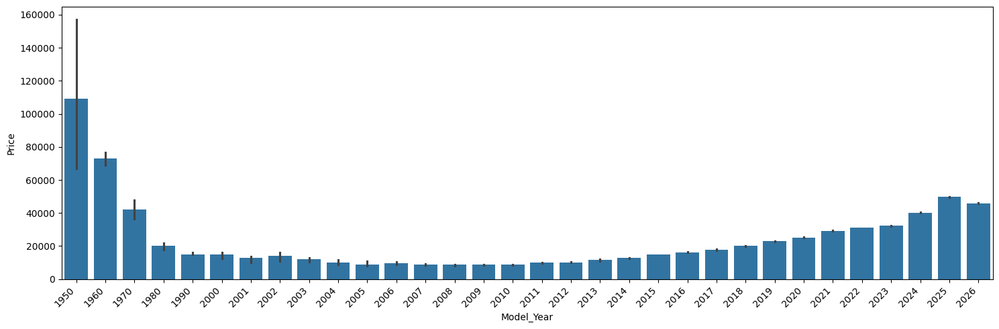

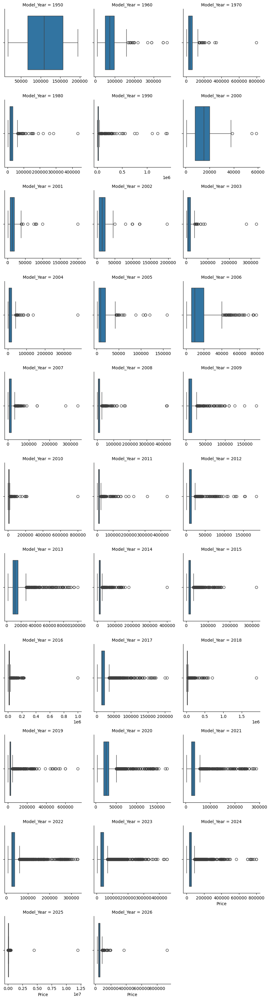

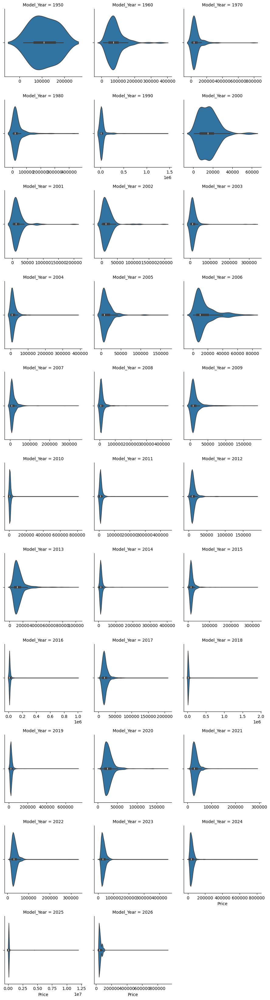

In [ ]:
eda_helper.num_cat_bivariate_plots(transformed_df,'Model_Year','Price',bar_estimator=np.median)

----
# **Brand_Name: Reducing Categories**

`Problem`
- Trying to assign `Others categories` to `Volkswagen`, `Volvo`, `MINI` & `Scion` Brands, as they are very less in numbers.

`Solution`
- We can't Assign others category to those categories, their relation with Price column is different.
- After applying the Hypotheses test, I varified that all this 3 categories are different from one other.

`Benefit`
- No Transformation is required.

## *Whether we can assign Others category to Least car categories*

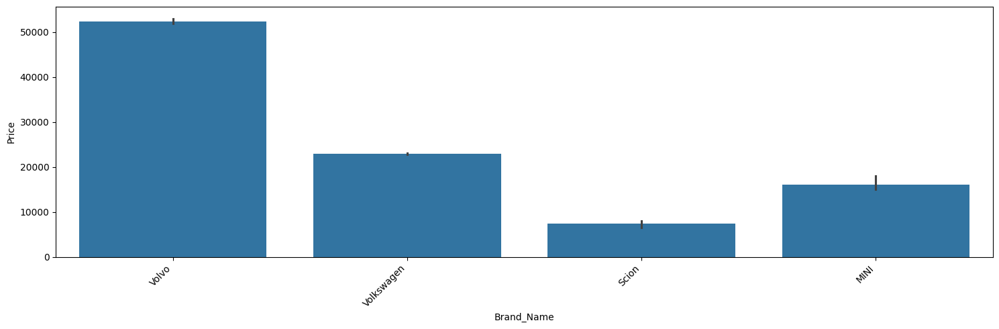

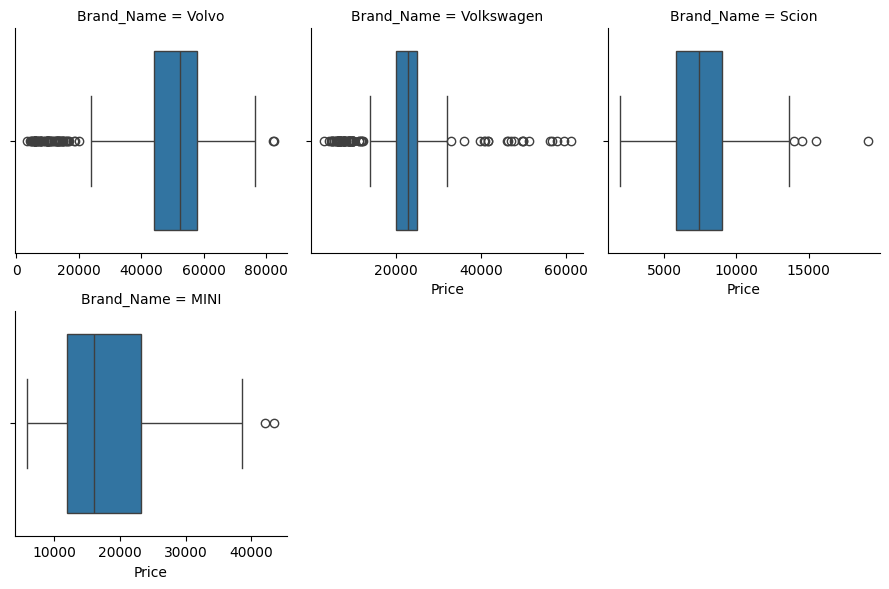

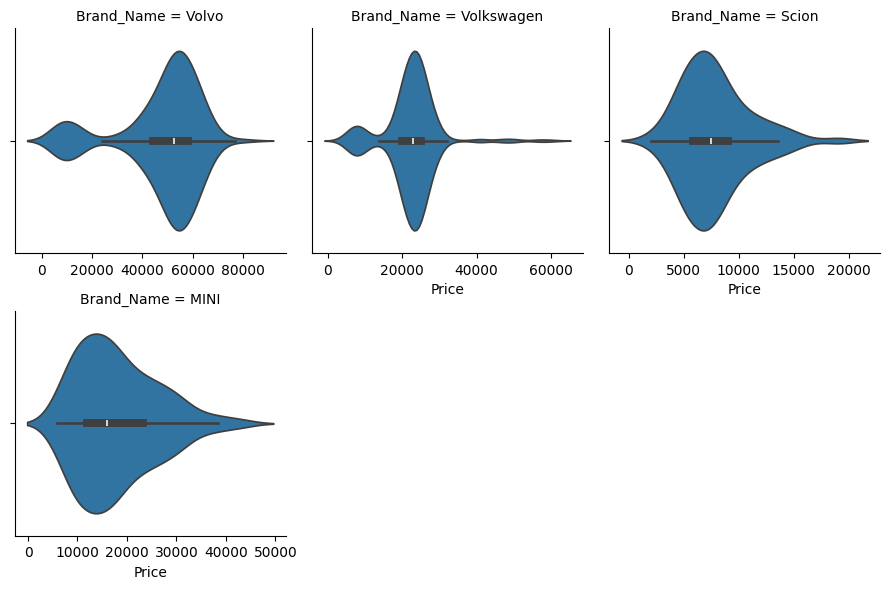

In [ ]:
temp = df[df['Brand_Name'].isin(['Volkswagen','Volvo','MINI','Scion'])].assign(Brand_Name = df['Brand_Name'].astype('object'))

eda_helper.num_cat_bivariate_plots(temp,'Brand_Name','Price',bar_estimator=np.median)

----------------
Significance level : 5.0 %
Null Hypothesis : All Groups have equal variances.
Alternate Hypothesis : At least one group has different variance.
Test Statistic : 58.73727159313874
Pvalue : 9.428388717499235e-36
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Variances between groups are not equal.


---------------------
Significance level : 5.0%
Null Hypothesis : All Group means are equal.
Alternate Hypothesis : One or more Group mean is different
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Atleast one group mean is different


--------------------------------------

         Multiple Comparison of Means - Tukey HSD, FWER=0.05          
  group1     group2     meandiff  p-adj     lower      upper    reject
----------------------------------------------------------------------
      MINI      Scion -10234.1298    0.0 -14690.2986 -5777.9609   True
      MINI Volkswagen   4393.3032 0.0005   1526.8494  7259.7569   True
      MINI      Volvo  29561.2274    0.0  26678.6044 32443.8505   True
     Scion Volkswagen  14627.4329    0.0  10783.7198  18471.146   True
     Scion      Volvo  39795.3572    0.0  35939.5708 43651.1436   True
Volkswagen      Volvo  25167.9243    0.0  23371.7601 26964.0884   True
----------------------------------------------------------------------




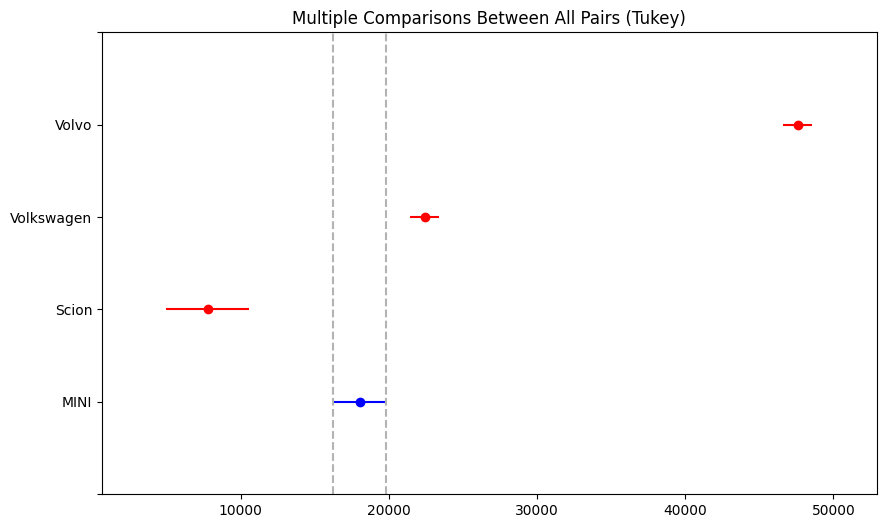

In [ ]:
eda_helper.numerical_vs_categorical_hypothesis_test(temp,'Price','Brand_Name',comparison_name='MINI')

----
# **Mileage: Outlier Detection, Transformation and Capping**

`Problem`
- Few values are very large which result is very high kurtosis and skewness, because of those values we can't rely on any `Descriptive stats` and even `Hypotheses testing`
- We will seperate cars based on `Stock_Type` column, and will do analysis accordingly.

`Solution`
> **CLEANING**
- Significant amount of cars which belongs to `New category` have a lot of mileage (even in thousands), which is wired, I go through the data online, then I came to know that the cars can be `loaner cars`, `demo Vehicles` or can be Posted as new by Dealers because car is in `new like condition, or modified`, to attract the customer, hence I decided to consider all cars that are **New but run above 1000 miles will be consider as Used.** Decision is also backed by differences in price of two groups (above and below 1000 mileage) by `mean`, `median` and `Hypotheses tests`.

> **CLEANING**
- Dropping all cars from `elite auto auctions` seller, because it is selling only the distorted cars, which is not good for our analysis.

- For `Used` & `Certified` cars, I have `capped` the data to `4M Miles` as the upper limit to remove the impact of `outlier` and `wrong entry values`, after that I found few `Used cars` which are years old have 0 mileage, which is not possible, I need to write a if else block (For `Used` cars only) -
  - **Used Car?**
  - **Yes**
    - **Model_Year between 2023–2026?**
      - **Yes** → Keep mileage as is
      - **No**
        - **Mileage < 10?**
          - **Yes** → Convert mileage to `np.nan`
          - **No** → Keep mileage as is
  - **No** → Keep mileage as is


- I applied `SquareRoot Transformation` to transform data from right skewed to normal like structure, this tranformation has significantly reduced the `skewness and kurtosis` and distribution become more `symmetric`.

- To cross check, I have `plot the visuals` as well as `Mileage to price Hypotheses test` of before and after transformation, which shows that relationship of data with price column remain intact.

`Impact`
- By capping and transformation, we got normal-like distribution, which can increase performance of `Linear Models`, transformation might not have any impact on `Tree-based Models` as they don't take any assumption about normality but capping can help reduce the overfitting (avoid unnecessary splits).

- `Interpretability` get affected (Because of transformation), but is not a major issue, because inverse transformation of SquareRoot is possible.

In [ ]:
# creating new df(s) for each stock type category, to check identify any data quality issues

new_cars_df = df.query("Stock_Type == 'New'").copy()
certified_cars_df = df.query("Stock_Type == 'Certified'").copy()
used_car_df = df.query("Stock_Type == 'Used'").copy()

### *New Cars*

In [ ]:
eda_helper.numerical_summary(new_cars_df['Mileage'])

,Mileage
1,3.0
6,0.0
11,10.0
12,4.0
15,17.0
...,...
271233,10.0
271235,15.0
271238,28.0
271246,20.0


Data Type : float64
Missing Data : 3280 (3.19 %)
Available Data : 99506 / 102786


,Mileage
0.01,0.00
0.05,0.00
0.10,0.00
0.25,2.00
0.50,5.00
0.75,11.00
0.90,27.00
0.95,87.00
0.99,2911.95
1.00,240257.00


,value
Mean,153.96
Trimmed Mean (5%),17.86
Trimmed Mean (10%),7.72
Median,5.00


,value
Std,"2,385"
Varience,"5,689,602"
IQR,9


,value
Skewness,39
Kurtosis,"2,316"


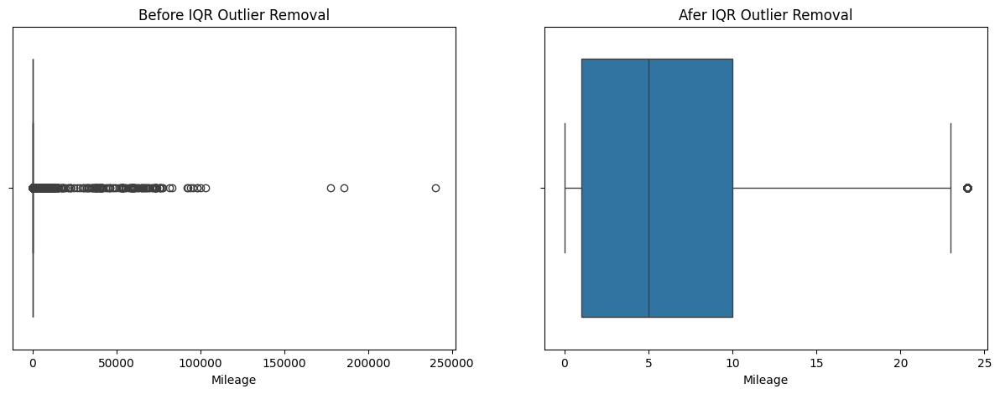

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
64,2025,Ford,F-250 XL,['https://platform.cstatic-images.com/xlarge/i...,New,113.0,65196.0,0,NaN,white,gray,4WD,NaN,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,"golden circle ford, inc.",3.9,257.0,https://www.goldencircleford.com/?utm_source=c...,5.0,1.0,NaN,6.7,V8,NaN,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,True,True,True,True,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1432 US-45 BYP,Jackson,TN,38305.0
95,2024,BMW,X5 sDrive40i,['https://platform.cstatic-images.com/xlarge/i...,New,9237.0,71855.0,0,NaN,gray,silver,RWD,11.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,arrowhead bmw,3.3,165.0,https://www.arrowheadbmw.com/?utm_source=cars....,3.8,9.0,8,3,I6,NaN,<NA>,<NA>,True,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,True,True,True,True,True,<NA>,True,<NA>,NaN,NaN,NaN,NaN,19250 N. Loop 101,Glendale,AZ,85308.0
110,2025,Ford,F-350 XL,['https://platform.cstatic-images.com/xlarge/i...,New,94.0,67545.0,0,NaN,white,gray,4WD,NaN,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,ken garff st. george ford,4.2,80.0,https://www.kengarffstgeorgeford.com/?utm_sour...,NaN,NaN,10,6.7,V8,32,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,145 W. Hilton Dr.,St. George,UT,84770.0
114,2025,Ford,Bronco Badlands,['https://platform.cstatic-images.com/xlarge/i...,New,59.0,64445.0,0,NaN,gray,black,4WD,7.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,tasca ford of seekonk,5.0,37.0,https://www.tascafordma.com/?utm_source=cars.c...,5.0,1.0,10,2.7,V6,24,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,200 Fall River Ave,Seekonk,MA,2771.0
121,2025,Ford,F-150 Lariat,['https://platform.cstatic-images.com/xlarge/i...,New,45.0,73762.0,0,NaN,white,black,4WD,10.0,Hybrid,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,monaco ford of niantic,4.8,33.0,https://www.monacofordofniantic.com?utm_source...,NaN,NaN,10,3.5,V6,NaN,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,True,True,True,True,True,True,True,True,True,<NA>,True,<

In [ ]:
eda_helper.boxplot_outlier(new_cars_df,'Mileage')

**New cars can't have mileage in thousands, thus dividing the data with threshold of 1000 kms**


In [ ]:
# below 1000 mileage new cars descriptive stats

eda_helper.numerical_summary(new_cars_df.query('Mileage < 1000 & Price < 200000')['Price'])

,Price
1,35285.0
6,59918.0
11,50944.0
12,71498.0
15,29495.0
...,...
271233,36104.0
271235,40445.0
271238,56118.0
271246,47255.0


Data Type : float64
Missing Data : 0 (0.0 %)
Available Data : 96187 / 96187


,Price
0.01,27811.0
0.05,31300.0
0.10,33700.0
0.25,39619.5
0.50,49660.0
0.75,61445.5
0.90,79739.0
0.95,87213.2
0.99,99430.0
1.00,196385.0


,value
Mean,52873.24
Trimmed Mean (5%),51848.51
Trimmed Mean (10%),51099.43
Median,49660.00


,value
Std,"17,330"
Varience,"300,326,865"
IQR,"21,826"


,value
Skewness,1
Kurtosis,1


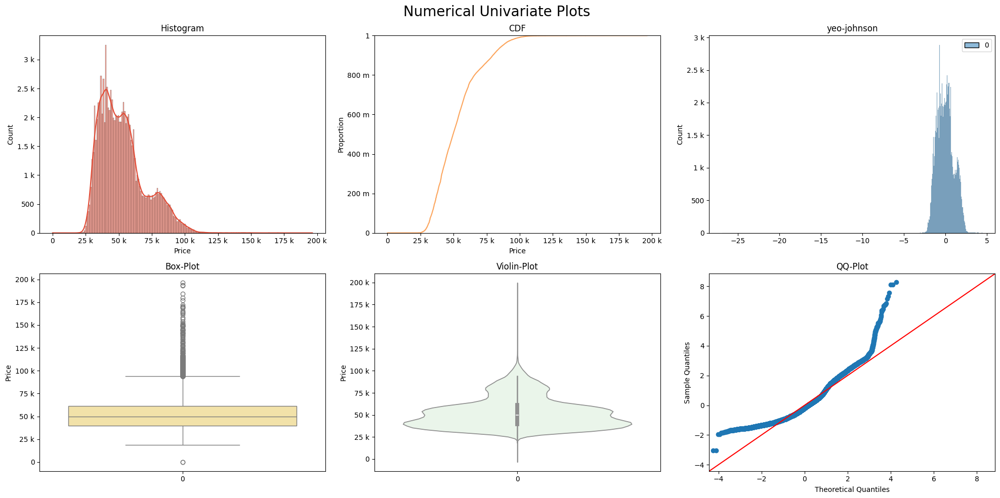

In [ ]:
# below 1000 mileage visualizations

eda_helper.numerical_univariate_plots(new_cars_df.query('Mileage < 1000 & Price < 200000')['Price'])

In [ ]:
# above 1000 mileage descriptive stats

eda_helper.numerical_summary(new_cars_df.query('Mileage > 1000 & Price < 200000')['Price'])

,Price
95,71855.0
450,27131.0
594,26156.0
622,70633.0
626,54883.0
...,...
270900,27099.0
270958,71705.0
271005,53982.0
271046,69365.0


Data Type : float64
Missing Data : 0 (0.0 %)
Available Data : 1900 / 1900


,Price
0.01,23484.29
0.05,26407.95
0.10,28497.10
0.25,32900.00
0.50,44438.00
0.75,57593.25
0.90,70430.50
0.95,76910.20
0.99,92544.36
1.00,133730.00


,value
Mean,47219.48
Trimmed Mean (5%),46307.58
Trimmed Mean (10%),45769.77
Median,44438.00


,value
Std,"16,578"
Varience,"274,838,373"
IQR,"24,693"


,value
Skewness,1
Kurtosis,0


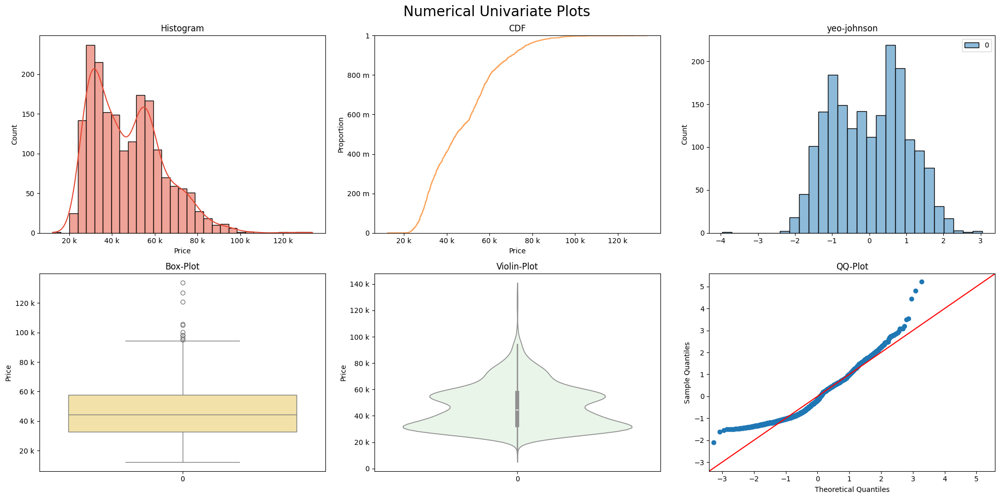

In [ ]:
# above 1000 mileage plots

eda_helper.numerical_univariate_plots(new_cars_df.query('Mileage > 1000 & Price < 200000')['Price'])

In [ ]:
# check if this two groups (new cars above and below 1000 kms) have significant difference in price

statistic,pvalue = stats.f_oneway(new_cars_df.query('Mileage > 1000 & Price < 200000')['Price'],
    new_cars_df.query('Mileage < 1000 & Price < 200000')['Price'],
    equal_var=False)

anova_alpha = 0.05

print(f'Significance level : {anova_alpha*100}%')
print(f'Null Hypothesis : All Group means are equal.')
print(f'Alternate Hypothesis : One or more Group mean is different')

if pvalue < anova_alpha:
    print(f'Since Pvalue is less than {anova_alpha}, we reject Null Hypothesis')
    print('CONCLUSION : Atleast one group mean is different')
else:
    print(f'Since Pvalue is more than {anova_alpha}, we Failed to reject Null Hypothesis')
    print('CONCLUSION : All group means are Equal')

Significance level : 5.0%
Null Hypothesis : All Group means are equal.
Alternate Hypothesis : One or more Group mean is different
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Atleast one group mean is different


## *Used_cars*

In [ ]:
eda_helper.numerical_summary(used_car_df['Mileage'])

,Mileage
0,27565.0
2,117487.0
3,63052.0
5,84516.0
7,24070.0
...,...
271245,101503.0
271247,26519.0
271248,12255.0
271249,18949.0


Data Type : float64
Missing Data : 17 (0.01 %)
Available Data : 148688 / 148705


,Mileage
0.01,497.87
0.05,6474.35
0.10,13314.70
0.25,29427.00
0.50,54962.50
0.75,91398.25
0.90,126140.60
0.95,150589.85
0.99,205120.11
1.00,9999999.00


,value
Mean,64407.34
Trimmed Mean (5%),61087.64
Trimmed Mean (10%),59529.02
Median,54962.50


,value
Std,"52,876"
Varience,"2,795,901,918"
IQR,"61,971"


,value
Skewness,45
Kurtosis,"8,385"


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


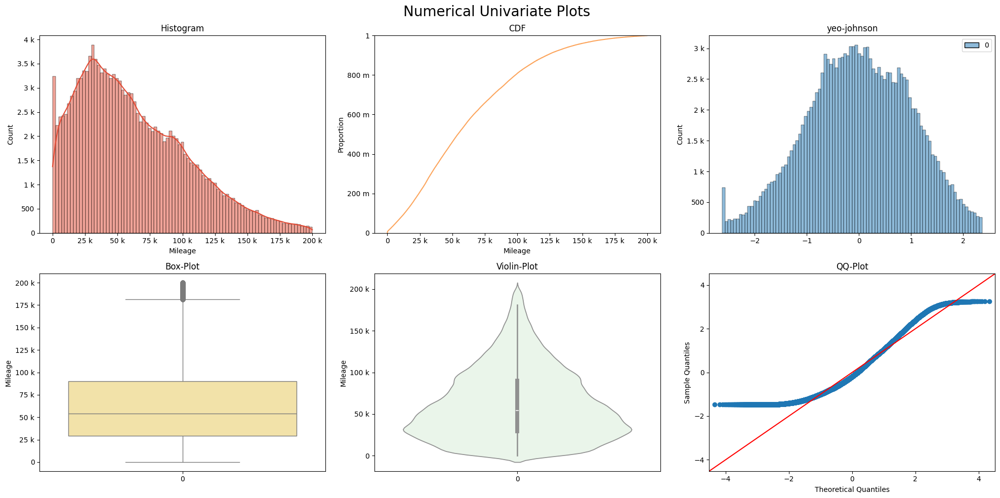

In [ ]:
eda_helper.numerical_univariate_plots(used_car_df[used_car_df['Mileage']<200000]['Mileage'])

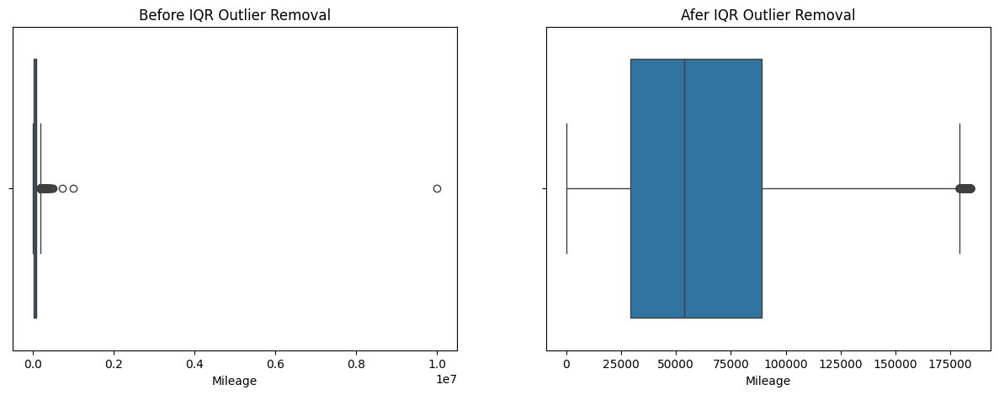

In [ ]:
used_car_outliers = eda_helper.boxplot_outlier(used_car_df,'Mileage')

## *Certified Cars*

In [ ]:
eda_helper.numerical_summary(certified_cars_df['Mileage'])

,Mileage
4,9531.0
8,61646.0
10,13736.0
21,14897.0
37,23937.0
...,...
271212,27549.0
271221,29408.0
271241,17523.0
271242,50498.0


Data Type : float64
Missing Data : 1 (0.01 %)
Available Data : 19761 / 19762


,Mileage
0.01,220.6
0.05,2733.0
0.10,4979.0
0.25,12450.0
0.50,27305.0
0.75,45127.0
0.90,64804.0
0.95,79989.0
0.99,109548.0
1.00,214174.0


,value
Mean,31903.73
Trimmed Mean (5%),29919.94
Trimmed Mean (10%),28953.65
Median,27305.00


,value
Std,"24,700"
Varience,"610,102,450"
IQR,"32,677"


,value
Skewness,1
Kurtosis,2


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


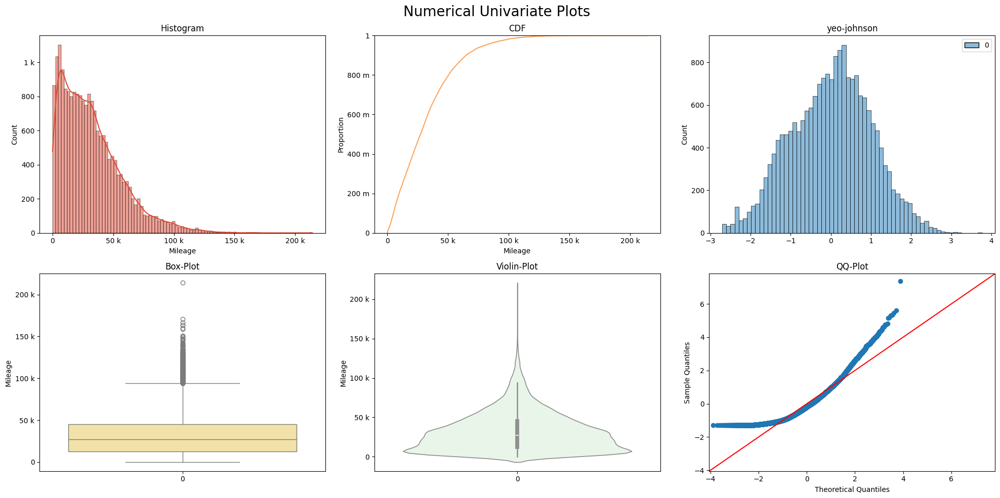

In [ ]:
eda_helper.numerical_univariate_plots(certified_cars_df['Mileage'])

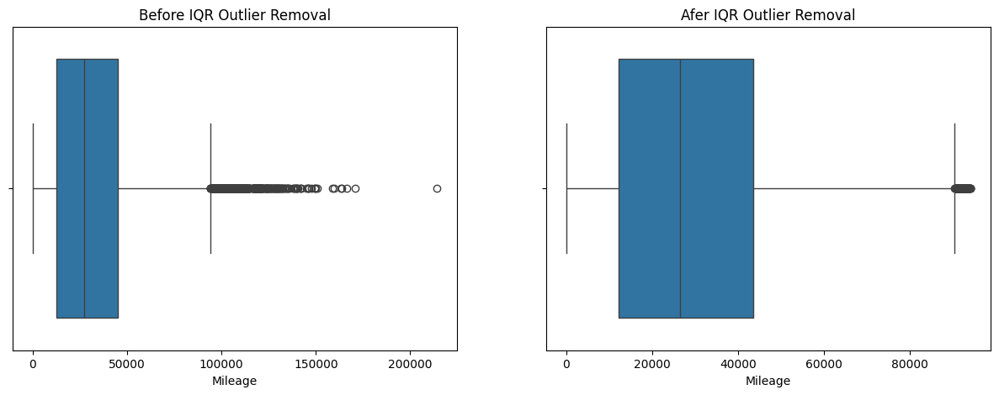

In [ ]:
_ = eda_helper.boxplot_outlier(certified_cars_df,'Mileage')

## *Capping the Not-New car's mileage*

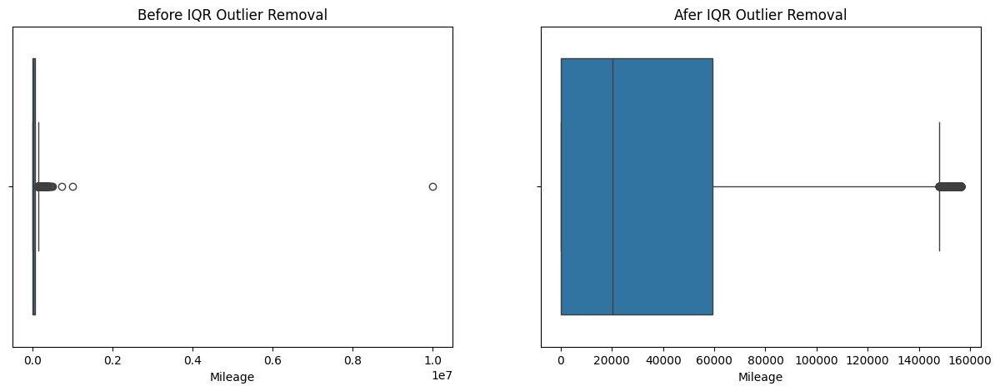

In [ ]:
# impact of outlier can be seen.

_ = eda_helper.boxplot_outlier(df,'Mileage')

In [ ]:
# this dealer is selling the accidental cars only, need to remove all cars of this dealers.

df[df['Seller_Name'] == 'elite auto auctions'].sample()['Image_List'].values

array(["['https://platform.cstatic-images.com/xlarge/in/v2/53ee8247-7478-432f-9600-6c450fbb659b/ed1e8211-8f8a-45e1-a8d8-70fd24409413/9Rk3GPQsdKBS-IGew3ljqzGSkXA.jpg', 'https://platform.cstatic-images.com/small/in/v2/53ee8247-7478-432f-9600-6c450fbb659b/ed1e8211-8f8a-45e1-a8d8-70fd24409413/9Rk3GPQsdKBS-IGew3ljqzGSkXA.jpg', 'https://platform.cstatic-images.com/small/in/v2/53ee8247-7478-432f-9600-6c450fbb659b/ed1e8211-8f8a-45e1-a8d8-70fd24409413/9Rk3GPQsdKBS-IGew3ljqzGSkXA.jpg', 'https://platform.cstatic-images.com/small/in/v2/53ee8247-7478-432f-9600-6c450fbb659b/ed1e8211-8f8a-45e1-a8d8-70fd24409413/LeL2sfj0enTvdHTWgVPEY2FHwOA.jpg', 'https://platform.cstatic-images.com/small/in/v2/53ee8247-7478-432f-9600-6c450fbb659b/ed1e8211-8f8a-45e1-a8d8-70fd24409413/LeL2sfj0enTvdHTWgVPEY2FHwOA.jpg', 'https://platform.cstatic-images.com/small/in/v2/53ee8247-7478-432f-9600-6c450fbb659b/ed1e8211-8f8a-45e1-a8d8-70fd24409413/acLp_tGwDQQ4JByhL0R2-wJKwpw.jpg', 'https://platform.cstatic-images.com/small/in/v2

In [ ]:
# need to write a rule, as it is not possible that cars are decades old but never run for even 10 kms.

df.query('Stock_Type == "Used"').sort_values(by=['Mileage','Price']).head(500)

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
93826,2010,Honda,Fit,['https://platform.cstatic-images.com/xlarge/i...,Used,0.0,1300.0,0,NaN,NaN,NaN,FWD,NaN,Gasoline,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,first marshall auto auction,1.8,197.0,https://firstmarshallautoauction.com/?utm_sour...,4.5,80.0,5,1.5,I4,16,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,398 E 147th St,Harvey,IL,60426.0
242413,2002,Honda,Odyssey EX-L,None,Used,0.0,1595.0,0,NaN,NaN,NaN,FWD,9.0,Gasoline,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,east coast auto source,1.7,241.0,None,4.4,41.0,NaN,3.5,NaN,NaN,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,NaN,NaN,NaN,NaN,4180 Rocky Ford Rd,Bedford,VA,24523.0
109640,2006,Honda,Odyssey EX,None,Used,0.0,3685.0,0,Fair,gray,NaN,FWD,9.0,Gasoline,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,golf mill ford,5.0,629.0,https://www.golfmillford.com/?utm_source=cars....,4.5,126.0,5,3.5,V6,24,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,NaN,NaN,NaN,NaN,9401 N Milwaukee Ave,Niles,IL,60714.0
155707,2016,Ford,Transit Connect XL,['https://platform.cstatic-images.com/xlarge/i...,Used,0.0,3995.0,0,NaN,white,black,FWD,10.0,Gasoline,Automatic,True,False,more,yes,yes,NaN,NaN,NaN,NaN,east coast auto source,1.7,241.0,None,4.8,16.0,NaN,2.5,NaN,NaN,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,4180 Rocky Ford Rd,Bedford,VA,24523.0
17776,2011,Mazda,Mazda3 s Sport,['https://platform.cstatic-images.com/xlarge/i...,Used,0.0,4495.0,0,Great,blue,black,FWD,14.0,Gasoline,Automatic,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,big c motors,0.0,109.0,https://www.bigcmotors.net/?utm_source=cars.co...,4.6,83.0,5,2.0,I4,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,521 W St Georges Ave,Linden,NJ,7036.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

In [ ]:
def used_car_mileage_correction(row):
  if row['Stock_Type'] == 'Used':
    if row['Model_Year'] in [2023,2024,2025,2026]:
      return row['Mileage']
    else:
      if row['Mileage'] < 10:
        return np.nan
      else:
        return row['Mileage']
  else:
    return row['Mileage']

In [ ]:
# capping the data to reduce the impact of most Extreme values

capped_mileage = df.query("Stock_Type != 'New'").assign(
    Mileage = lambda df_ : (
        df_[['Mileage','Stock_Type','Model_Year']]
        .apply(used_car_mileage_correction,axis=1)
        .clip(upper=400000)
        .apply(np.sqrt)
    )
)

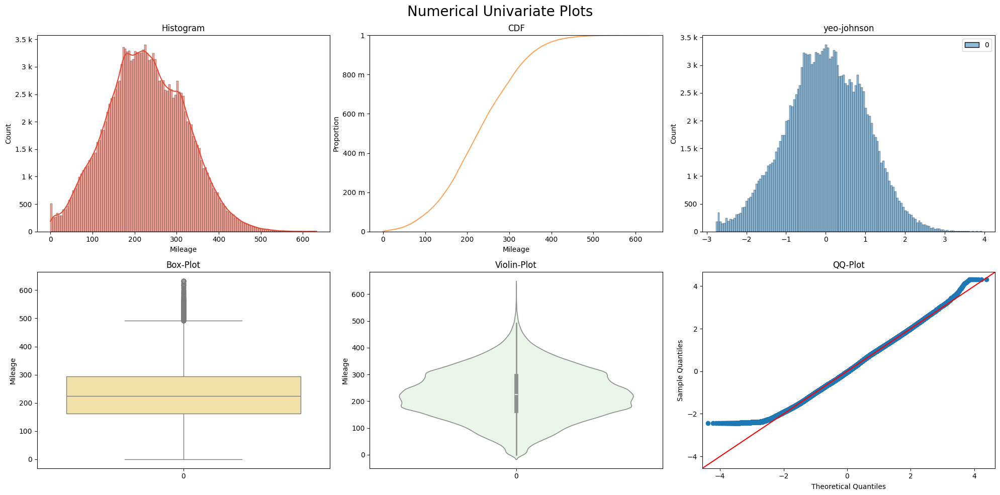

In [ ]:
# impact of capping

eda_helper.numerical_univariate_plots(capped_mileage['Mileage'])

In [ ]:
# Before capping relation with price

eda_helper.numerical_vs_numerical_hypothesis_testing(df.query('Stock_Type != "New"'),'Mileage','Price')

Significance level : 5.0 %
Null Hypothesis : The Samples are not correlated.
Alternate Hypothesis : The Samples are correlated.
Test Statistic : -0.3653953011409414
Pvalue : 0.0
Since Pvalue is less than 0.05, we reject the Null Hypothesis.
CONCLUSION: The Columns Mileage and Price are correlated.


Significance level : 5.0 %
Null Hypothesis : The Samples are not correlated.
Alternate Hypothesis : The Samples are correlated.
Test Statistic : -0.6560171590740997
Pvalue : 0.0
Since Pvalue is less than 0.05, we reject the Null Hypothesis.
CONCLUSION: The Columns Mileage and Price are correlated.


In [ ]:
# After capping relation with price col (No change)

eda_helper.numerical_vs_numerical_hypothesis_testing(pd.concat([capped_mileage['Mileage'],df.query('Stock_Type != "New"')['Price']],axis=1),'Mileage','Price')

Significance level : 5.0 %
Null Hypothesis : The Samples are not correlated.
Alternate Hypothesis : The Samples are correlated.
Test Statistic : -0.46482636915812575
Pvalue : 0.0
Since Pvalue is less than 0.05, we reject the Null Hypothesis.
CONCLUSION: The Columns Mileage and Price are correlated.


Significance level : 5.0 %
Null Hypothesis : The Samples are not correlated.
Alternate Hypothesis : The Samples are correlated.
Test Statistic : -0.6574659995143282
Pvalue : 0.0
Since Pvalue is less than 0.05, we reject the Null Hypothesis.
CONCLUSION: The Columns Mileage and Price are correlated.


----
# **Price: Outlier Detection & Transformations**

`Problem`

- Price is highly positive skewed, there may be some potential outliers.
- Some cars like `2023 Dodge challenger`, and `2016 M4 GTS` last producted car, suddenly got high price, because they are the last car in production (Discontinued).
- Few cars like `Sprinter 2500,Sierra 3500 Denali,Sierra 3500 Denali Ultimate,Sprinter 2500,Sprinter 2500 144 WB,Sprinter 2500 High Roof,Sierra 3500 Base,Camaro 1SS,Mustang Base, Sprinter 2500 Standard Roof, Camaro 1SS` have Data Entry Error.
- Some cars because of `Vintage` tag, have high price example - `Dodge Challenger`, `Bronco`.

`Solution`
> **Cleaning**
- Convert values that are identified as wrong values to `np.nan`, after this action the `Skewness` and `Kurtosis` of data has changed significantly.
  - wrong values (high) idx - [190688,41228,229858,256629,148265]
- Few values are very small like 1$ to few hundred which is also not possible.
  - wrong values (low) idx - [66193, 85055, 89202, 66193, 69280, 202429, 256433, 154997, 93267, 217457, 522]

- After that I have applied Power Transformation on the data, which has attended the skewness and kurtosis very close to `Normal distribution`, also checked that there is no change in correlation with other column after this transformation by the `heatmap`.

- After analysing the rows which are identified by boxplot as `Potential outlier`, I found that those values are `Natural Variations` because of high end `Luxury cars`, or `Modified version` which justified their price.

`Impact`

- Wrong Entries get removed & analyzed the Potential outlier which are found to be natural variation of data, after which I applied transformation which result in `normal like distribution`, which can help Linear model to `fit better`, but there is no impact of this transformation on the `Tree based algo`.

- Values after the transformation will loose `interpretability`, but is not a major problem as `inverse transformation` of Power Transformation is possible.


In [ ]:
eda_helper.numerical_summary(df['Price'])

,Price
0,48500.0
1,35285.0
2,16998.0
3,54495.0
4,40204.0
...,...
271248,41530.0
271249,24366.0
271250,70995.0
271251,56260.0


Data Type : float64
Missing Data : 2895 (1.07 %)
Available Data : 268358 / 271253


,Price
0.01,5997.00
0.05,10999.00
0.10,15641.70
0.25,23788.00
0.50,35577.00
0.75,50310.75
0.90,66994.30
0.95,80325.00
0.99,104048.29
1.00,11986400.00


,value
Mean,39693.23
Trimmed Mean (5%),38206.19
Trimmed Mean (10%),37367.73
Median,35577.00


,value
Std,"35,931"
Varience,"1,291,011,505"
IQR,"26,523"


,value
Skewness,147
Kurtosis,"46,480"


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


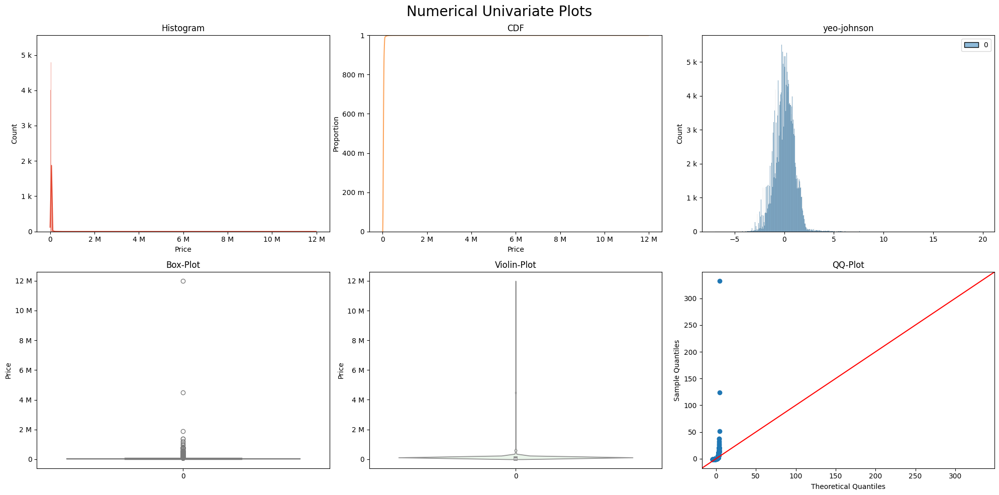

In [ ]:
eda_helper.numerical_univariate_plots(df['Price'])

## *Checking the most extreme values*

In [ ]:
# most of cars are porche, but some cars price are not justified.

df[df['Price'] > 204048]['Model_Name'].value_counts()

,count
Model_Name,
911 Turbo S,120
911 GT3,118
911 GT3 RS,82
911,41
911 Turbo,38
911 Carrera GTS,29
911 Targa 4 GTS,27
911 Carrera 4 GTS,19
911 Targa 4S,17


In [ ]:
df.query('Model_Name == "Challenger SRT Demon" & Price > 200000')

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
155244,2018,Dodge,Challenger SRT Demon,['https://platform.cstatic-images.com/xlarge/i...,Used,9.0,300666.0,0,NaN,black,black,RWD,22.0,Gasoline,Automatic,False,True,one,yes,yes,NaN,NaN,NaN,NaN,prestige annapolis llc,0.0,3.0,https://www.prestige25.com/inventory?utm_sourc...,4.8,216.0,8,6.2,V8,NaN,<NA>,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,25 Ritchie Hwy,Pasadena,MD,21122.0
238867,2018,Dodge,Challenger SRT Demon,['https://platform.cstatic-images.com/xlarge/i...,New,62.0,339312.0,4135,Good,black,black,RWD,17.5,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,lake elsinore chrysler dodge jeep ram,5.0,32.0,https://www.lakecdjr.com/?utm_source=cars.com&...,4.8,216.0,8,6.2,V8,16,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,31400 Auto Center Dr,Lake Elsinore,CA,92530.0
269458,2023,Dodge,Challenger SRT Demon,['https://platform.cstatic-images.com/xlarge/i...,New,16.0,232641.0,382,NaN,black,black,RWD,17.5,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,deland chrysler dodge jeep ram,5.0,49.0,https://www.delandcjdr.com/?utm_source=cars.co...,5.0,13.0,8,6.2,I6,NaN,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,2173 South Woodland Blvd,DeLand,FL,32720.0


In [ ]:
df.query('Model_Name == "Challenger SRT Hellcat" & Price > 200000')

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
59565,2023,Dodge,Challenger SRT Hellcat,['https://platform.cstatic-images.com/xlarge/i...,Used,665.0,333580.0,0,Good,red,black,RWD,17.0,Gasoline,Automatic,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,southtowne mitsubishi,5.0,130.0,https://www.utahmitsubishi.com/?utm_source=car...,5.0,13.0,8,6.2,V8,16,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,10736 State St,Sandy,UT,84070.0
87270,2023,Dodge,Challenger SRT Hellcat,['https://platform.cstatic-images.com/xlarge/i...,New,0.0,250000.0,0,NaN,black,black,RWD,17.5,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,van nuys chrysler dodge jeep ram,3.2,20.0,https://www.russellwestbrookcdjrofvannuys.com/...,5.0,13.0,8,6.2,I6,NaN,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,6110 Van Nuys Blvd,Los Angeles,CA,91401.0
121411,2023,Dodge,Challenger SRT Hellcat,['https://platform.cstatic-images.com/xlarge/i...,New,17.0,279999.0,0,NaN,white,black,RWD,17.5,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,bob johnson chrysler dodge jeep,0.0,0.0,https://www.bobjohnsoncdjr.com/?utm_source=car...,5.0,13.0,NaN,6.2,I6,NaN,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1695 Interstate Dr,Avon,NY,14414.0
185377,2023,Dodge,Challenger SRT Hellcat,['https://platform.cstatic-images.com/xlarge/i...,New,10.0,222646.0,10750,NaN,red,black,RWD,17.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,chrysler dodge jeep ram of paramus,2.0,22.0,https://www.chryslerdodgejeepofparamus.com?utm...,5.0,13.0,8,6.2,V8,16,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,315 Route 4 West,Paramus,NJ,7652.0
226370,2023,Dodge,Challenger SRT Hellcat,['https://platform.cstatic-images.com/xlarge/i...,New,5.0,250000.0,0,NaN,orange,black,RWD,17.5,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,van nuys chrysler dodge jeep ram,3.2,20.0,https://www.russellwestbrookcdjrofvannuys.com/...,5.0,13.0,8,6.2,I6,NaN,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>

In [ ]:
# price are justified because this cars are first generation car of bronco, which is sold in auctions

df.query('Model_Name == "Bronco" & Price > 200000')

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
34749,1972,Ford,Bronco,['https://platform.cstatic-images.com/xlarge/i...,Used,673.0,254700.0,0,Good,green,brown,4WD,0.0,NaN,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,platinum motor cars,0.0,63.0,http://www.PMC-Detroit.com?utm_source=cars.com...,NaN,NaN,10,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1090 S Adams Rd,Birmingham,MI,48009.0
131584,1972,Ford,Bronco,['https://platform.cstatic-images.com/xlarge/i...,Used,86408.0,259995.0,0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,lou fusz buick gmc,4.6,999.0,https://www.loufuszbuickgmc.com/?utm_source=ca...,NaN,NaN,NaN,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,10950 Page Ave,St. Louis,MO,63132.0
181100,1969,Ford,Bronco,['https://platform.cstatic-images.com/xlarge/i...,Used,1023.0,269901.0,0,Good,black,yellow,RWD,0.0,Gasoline,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,101 motors,0.0,40.0,http://www.101motors.com?utm_source=cars.com&u...,3.5,2.0,NaN,NaN,V8,NaN,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1901 E 5th St,Tempe,AZ,85281.0


In [ ]:
# justified because of vintage tag.

df[df['Model_Name'] == 'Corvette Base'].sort_values(by='Price',ascending=False).head(5)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
190221,1963,Chevrolet,Corvette Base,['https://platform.cstatic-images.com/xlarge/i...,Used,50.0,289999.0,9000,NaN,NaN,NaN,NaN,0.0,NaN,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,luxury auto collection,3.5,40.0,https://www.luxuryautocollection.com/?utm_sour...,5.0,1.0,NaN,6.2,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,9160 E Del Camino Dr DR # B4,Scottsdale,AZ,85258.0
24767,1966,Chevrolet,Corvette Base,['https://platform.cstatic-images.com/xlarge/i...,Used,350.0,219995.0,3000,Fair,silver,red,RWD,0.0,Gasoline,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,presidential auto sales & service,4.7,288.0,https://www.prezauto1.com?utm_source=cars.com&...,5.0,2.0,6,6.2,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,3201 South Federal Hwy.,Delray Beach,FL,33483.0
43953,1958,Chevrolet,Corvette Base,['https://platform.cstatic-images.com/xlarge/i...,Used,9974.0,179000.0,0,Fair,white,white,NaN,0.0,NaN,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,gateway classic cars,2.6,325.0,https://gatewayclassiccars.com/?utm_source=car...,5.0,1.0,4,NaN,V8,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,1237 Central Park Dr,O Fallon,IL,62269.0
248416,1963,Chevrolet,Corvette Base,['https://platform.cstatic-images.com/xlarge/i...,Used,31757.0,174900.0,2000,Good,silver,blue,RWD,0.0,Gasoline,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,gr auto gallery,3.8,285.0,http://www.grautogallery.com?utm_source=cars.c...,5.0,1.0,NaN,NaN,V8,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,4722 50th St SE,Grand Rapids,MI,49512.0
133429,1956,Chevrolet,Corvette Base,['https://platform.cstatic-images.com/xlarge/i...,Used,8906.0,157000.0,0,NaN,white,red,NaN,0.0,NaN,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,gateway classic cars,2.6,325.0,https://gatewayclassiccars.com/?utm_source=car...,5.0,1.0,5,NaN,V8,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,1237 Central Park Dr,O Fallon,IL,62269.0

In [ ]:
# again vintage

df[df['Model_Name'] == 'F-250 1972 Ford F250 Velocity Heritage Series']

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
26624,1972,Ford,F-250 1972 Ford F250 Velocity Heritage Series,['https://platform.cstatic-images.com/xlarge/i...,Used,835.0,339900.0,0,NaN,white,black,FWD,0.0,NaN,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,platinum motor cars,0.0,63.0,http://www.PMC-Detroit.com?utm_source=cars.com...,NaN,NaN,NaN,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1090 S Adams Rd,Birmingham,MI,48009.0


In [ ]:
# wrong price

df[df['Model_Name'] == 'Sprinter 2500'].sort_values(by='Price',ascending=False).head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
66193,2024,Mercedes-Benz,Sprinter 2500,['https://platform.cstatic-images.com/xlarge/i...,Used,41.0,209550.0,1000,Good,blue,NaN,NaN,0.0,Diesel,Automatic,False,True,one,no,NaN,NaN,NaN,NaN,NaN,southtowne mitsubishi,5.0,130.0,https://www.utahmitsubishi.com/?utm_source=car...,NaN,NaN,9,2.0,I4,16,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,10736 State St,Sandy,UT,84070.0


In [ ]:
# vintage justified

df[df['Model_Name'] == 'Mustang'].sort_values(by='Price',ascending=False).head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
72780,1967,Ford,Mustang,['https://platform.cstatic-images.com/xlarge/i...,Used,366.0,349950.0,0,NaN,gray,NaN,NaN,0.0,NaN,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fusion luxury motors,0.0,11.0,https://www.fusionmotorco.com/?utm_source=cars...,5.0,1.0,5,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,20837 Nordhoff St,Los Angeles,CA,91311.0


In [ ]:
# wrong entry

df[df["Model_Name"] == 'Sierra 3500 Denali'].sort_values(by="Price",ascending=False).head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
85055,2026,GMC,Sierra 3500 Denali,['https://platform.cstatic-images.com/xlarge/i...,New,1.0,931240.0,0,NaN,white,gray,4WD,0.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,davis motors,5.0,26.0,http://www.davismotorsgm.com/?utm_source=cars....,NaN,NaN,10,6.6,V8,NaN,<NA>,<NA>,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,True,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,1005 North Sibley,Litchfield,MN,55355.0


In [ ]:
# wrong entry

df[df['Model_Name'] == 'Sierra 3500 Denali Ultimate'].sort_values(by='Price',ascending=False).head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
89202,2025,GMC,Sierra 3500 Denali Ultimate,['https://platform.cstatic-images.com/xlarge/i...,New,4.0,11986400.0,0,Good,white,white,4WD,0.0,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,freeman buick gmc,3.4,182.0,http://www.freemangrapevine.com?utm_source=car...,NaN,NaN,10,6.6,V8,32,True,<NA>,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,True,True,<NA>,True,<NA>,True,True,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,501 W State Hwy 114,Grapevine,TX,76051.0


In [ ]:
# vintage

df[df['Model_Name'] == 'F-250 Velocity Heritage Series!']

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
104142,1967,Ford,F-250 Velocity Heritage Series!,['https://platform.cstatic-images.com/xlarge/i...,Used,749.0,349900.0,0,NaN,blue,blue,NaN,0.0,Gasoline,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,chicago motor cars,4.9,20.0,https://chicagomotorcars.com?utm_source=cars.c...,NaN,NaN,10,5.0,V8,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,27w110 North Ave,West Chicago,IL,60185.0


In [ ]:
# wrong entry

df[df['Model_Name'] == 'Sprinter 2500'].sort_values(by='Price',ascending=False).head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
66193,2024,Mercedes-Benz,Sprinter 2500,['https://platform.cstatic-images.com/xlarge/i...,Used,41.0,209550.0,1000,Good,blue,NaN,NaN,0.0,Diesel,Automatic,False,True,one,no,NaN,NaN,NaN,NaN,NaN,southtowne mitsubishi,5.0,130.0,https://www.utahmitsubishi.com/?utm_source=car...,NaN,NaN,9,2.0,I4,16,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,10736 State St,Sandy,UT,84070.0


In [ ]:
# wrong entry

df[df['Model_Name'] == 'Sprinter 2500 144 WB'].head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
522,2022,Mercedes-Benz,Sprinter 2500 144 WB,['https://platform.cstatic-images.com/xlarge/i...,Used,28220.0,99555.0,0,Good,gray,black,RWD,0.0,Diesel,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,bmw of beaumont,4.7,147.0,https://www.bmwofbeaumont.com/?utm_source=cars...,NaN,NaN,7,3.0,V6,24,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1855 Interstate 10,Beaumont,TX,77701.0


In [ ]:
# justified because of last edition of car, it got this much price

df[df['Model_Name'] == 'M4 GTS'].head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
8458,2016,BMW,M4 GTS,['https://platform.cstatic-images.com/xlarge/i...,Used,305.0,1000803.0,0,Fair,black,black,RWD,19.5,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,exotic knights,0.0,10.0,https://www.falconmotorgroup.com/?utm_source=c...,4.7,18.0,7,3,I6,NaN,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,True,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,NaN,NaN,NaN,NaN,3478 Maggie Boulevard,Orlando,FL,32811.0


In [ ]:
# wrong price

df[df['Model_Name'] == 'Sprinter 2500 High Roof'].sort_values(by="Price",ascending=False).head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
69280,2021,Mercedes-Benz,Sprinter 2500 High Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,35500.0,269989.0,0,NaN,blue,black,4WD,0.0,Diesel,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,exotic car trader,4.2,10.0,https://www.exoticcartrader.com/?utm_source=ca...,NaN,NaN,NaN,3,V6,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1205 NE 9th Ave,Fort Lauderdale,FL,33304.0


In [ ]:
# justified

df[df['Model_Name'] == 'RS 6 Avant 4.0T'].sort_values(by='Price',ascending=False).head(2)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
179789,2025,Audi,RS 6 Avant 4.0T,['https://platform.cstatic-images.com/xlarge/i...,Used,181.0,217911.0,0,NaN,white,black,AWD,17.5,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,audi mckinney,0.0,9.0,https://www.audimckinney.com?utm_source=cars.c...,4.5,2.0,NaN,4,V8,NaN,<NA>,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,6650 TX-121,Allen,TX,75013.0
269151,2025,Audi,RS 6 Avant 4.0T,['https://platform.cstatic-images.com/xlarge/i...,New,22.0,201750.0,0,NaN,white,NaN,AWD,17.5,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,audi pittsburgh,4.8,630.0,https://www.audipittsburgh.com/en/?utm_source=...,4.5,2.0,8,4,V8,NaN,<NA>,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,2050 Liberty Ave,Pittsburgh,PA,15222.0


In [ ]:
# wrong entry

df[df['Model_Name'] == 'Sierra 3500 Base'].sort_values(by='Price',ascending=False).head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
202429,2025,GMC,Sierra 3500 Base,['https://platform.cstatic-images.com/xlarge/i...,New,5.0,4478000.0,500,NaN,black,black,4WD,0.0,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,"thompson buick, gmc, cadillac",4.8,833.0,https://www.thompsonsales.com/?utm_source=cars...,NaN,NaN,10,6.6,V8,NaN,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,True,True,True,True,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,1555 E. Independence,Springfield,MO,65804.0


In [ ]:
# wrong entry

df[df['Model_Name'] == 'Sprinter 2500 Standard Roof'].sort_values(by='Price',ascending=False).head(1)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
217457,2018,Mercedes-Benz,Sprinter 2500 Standard Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,55136.0,1900000.0,0,NaN,white,black,RWD,0.0,Diesel,Automatic,False,True,one,no,NaN,NaN,NaN,NaN,NaN,t & a elite auto sales llc,0.0,3.0,https://www.taeliteauto.com/?utm_source=cars.c...,4.2,6.0,NaN,3,V6,NaN,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,25B Route 23,Hamburg,NJ,7419.0


In [ ]:
# will set index of rows where price is wrong (very high price) to np.nan, and will do imputation later

cleaned_price = df.copy()
idx = [66193,85055,89202,66193,69280,202429,256433,154997,93267,217457,522]
cleaned_price.loc[idx,'Price'] = np.nan

cleaned_price.loc[idx,:]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
66193,2024,Mercedes-Benz,Sprinter 2500,['https://platform.cstatic-images.com/xlarge/i...,Used,41.0,NaN,1000,Good,blue,NaN,NaN,NaN,Diesel,Automatic,False,True,one,no,NaN,NaN,NaN,NaN,NaN,southtowne mitsubishi,5.0,130.0,https://www.utahmitsubishi.com/?utm_source=car...,NaN,NaN,9,2.0,I4,16,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,10736 State St,Sandy,UT,84070.0
85055,2026,GMC,Sierra 3500 Denali,['https://platform.cstatic-images.com/xlarge/i...,New,1.0,NaN,0,NaN,white,gray,4WD,NaN,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,davis motors,5.0,26.0,http://www.davismotorsgm.com/?utm_source=cars....,NaN,NaN,10,6.6,V8,NaN,<NA>,<NA>,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,True,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,1005 North Sibley,Litchfield,MN,55355.0
89202,2025,GMC,Sierra 3500 Denali Ultimate,['https://platform.cstatic-images.com/xlarge/i...,New,4.0,NaN,0,Good,white,white,4WD,NaN,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,freeman buick gmc,3.4,182.0,http://www.freemangrapevine.com?utm_source=car...,NaN,NaN,10,6.6,V8,32,True,<NA>,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,True,True,<NA>,True,<NA>,True,True,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,501 W State Hwy 114,Grapevine,TX,76051.0
66193,2024,Mercedes-Benz,Sprinter 2500,['https://platform.cstatic-images.com/xlarge/i...,Used,41.0,NaN,1000,Good,blue,NaN,NaN,NaN,Diesel,Automatic,False,True,one,no,NaN,NaN,NaN,NaN,NaN,southtowne mitsubishi,5.0,130.0,https://www.utahmitsubishi.com/?utm_source=car...,NaN,NaN,9,2.0,I4,16,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,10736 State St,Sandy,UT,84070.0
69280,2021,Mercedes-Benz,Sprinter 2500 High Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,35500.0,NaN,0,NaN,blue,black,4WD,NaN,Diesel,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,exotic car trader,4.2,10.0,https://www.exoticcartrader.com/?utm_source=ca...,NaN,NaN,NaN,3,V6,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1205 NE 9th Ave,Fort Lauderdale,FL,33304.0
2

### *Changes after removal of wrong entries*

In [ ]:
# compare the changes in descriptive stats with df['Price'] col

eda_helper.numerical_summary(cleaned_price['Price'])

,Price
0,48500.0
1,35285.0
2,16998.0
3,54495.0
4,40204.0
...,...
271248,41530.0
271249,24366.0
271250,70995.0
271251,56260.0


Data Type : float64
Missing Data : 2905 (1.07 %)
Available Data : 268348 / 271253


,Price
0.01,5997.00
0.05,10999.00
0.10,15641.00
0.25,23788.00
0.50,35575.00
0.75,50306.25
0.90,66991.00
0.95,80313.25
0.99,104000.00
1.00,1399995.00


,value
Mean,39618.65
Trimmed Mean (5%),38206.19
Trimmed Mean (10%),37367.73
Median,35575.00


,value
Std,"25,870"
Varience,"669,279,072"
IQR,"26,518"


,value
Skewness,7
Kurtosis,160


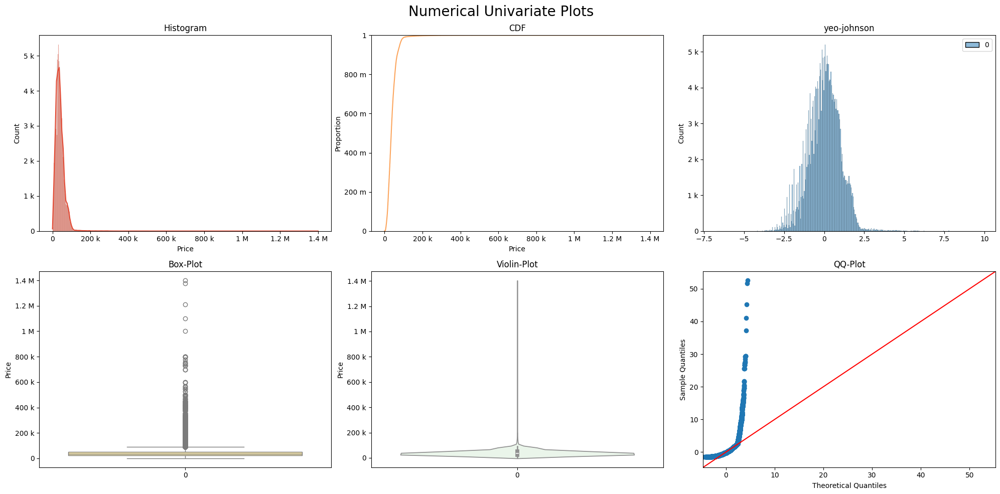

In [ ]:
# analysing changes via visualization

eda_helper.numerical_univariate_plots(cleaned_price['Price'])

In [ ]:
# checking the smaller values
# wrong price entries index -> 190688,41228,229858,256629,148265

cleaned_price.loc[[190688,41228,229858,256629,148265],'Price'] = np.nan

cleaned_price.loc[[190688,41228,229858,256629,148265],:]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
190688,2024,Ford,Edge SE,['https://platform.cstatic-images.com/xlarge/i...,Used,7455.0,NaN,0,NaN,white,black,AWD,10.0,Gasoline,Automatic,False,True,one,no,NaN,NaN,NaN,NaN,NaN,taylor ford,5.0,26.0,https://www.shoptaylorford.net/?utm_source=car...,3.7,6.0,8,2.0,I4,16,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,13500 Telegraph Rd,Taylor,MI,48180.0
41228,2025,Honda,Odyssey Touring,None,New,0.0,NaN,250,NaN,NaN,blue,FWD,10.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,steve padgett's honda of lake murray,5.0,5.0,https://www.hondaoflakemurray.com?utm_source=c...,5.0,2.0,NaN,3.5,V6,NaN,True,<NA>,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,<NA>,<NA>,True,True,True,True,True,True,True,True,<NA>,True,True,True,NaN,NaN,NaN,NaN,750 Western Lane,Irmo,SC,29063.0
229858,2014,Mercedes-Benz,E-Class 4dr Sedan E350 4MATIC,['https://platform.cstatic-images.com/xlarge/i...,Used,160632.0,NaN,0,Good,gray,NaN,AWD,10.0,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,woodbridge public auto auction,2.3,102.0,https://www.wpaa.net/?utm_source=cars.com&utm_...,4.8,181.0,NaN,3.5,V6,NaN,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,NaN,NaN,NaN,NaN,1108 Horner Rd,Woodbridge,VA,22191.0
256629,2025,Ford,Bronco Outer Banks,['https://platform.cstatic-images.com/xlarge/i...,New,63.0,NaN,0,NaN,yellow,brown,4WD,9.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,fox ford mazda,4.9,2728.0,https://www.foxfordusa.com?utm_source=cars.com...,5.0,1.0,10,2.7,V6,24,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,3560 28th Street SE,Grand Rapids,MI,49512.0
148265,2014,Mercedes-Benz,E-Class E 350 4MATIC,['https://platform.cstatic-images.com/xlarge/i...,Used,195000.0,NaN,0,NaN,black,black,AWD,NaN,Gasoline,NaN,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,None,4.8,181.0,None,4.8,181.0,NaN,3.5,V6,NaN,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,NaN,NaN,NaN,NaN,None,None,NaN,NaN


In [ ]:
cleaned_price.sort_values(by='Price',ascending=False)

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
205959,1991,Porsche,911 REIMAGINED BY SINGER,['https://platform.cstatic-images.com/xlarge/i...,Used,256.0,1399995.0,0,Fair,gray,NaN,RWD,NaN,Gasoline,Automatic,True,True,more,no,NaN,NaN,NaN,NaN,NaN,mclaren philadelphia,0.0,13.0,http://mclarenphl.com?utm_source=cars.com&utm_...,4.6,7.0,NaN,3.6,H6,24,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1631 W Chester Pike,West Chester,PA,19382.0
23396,1995,Porsche,911 Carrera,['https://platform.cstatic-images.com/xlarge/i...,Used,4085.0,1375000.0,0,NaN,blue,blue,AWD,3.0,Gasoline,Automatic,False,True,more,yes,yes,NaN,NaN,NaN,NaN,zweck,0.0,4.0,https://www.zweck.com?utm_source=cars.com&utm_...,4.9,16.0,NaN,3.6,H6,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,12910 SW 89th Ct,MIAMI,FL,33176.0
40974,1990,Porsche,911 Carrera,['https://platform.cstatic-images.com/xlarge/i...,Used,1.0,1210000.0,4000,Great,silver,NaN,RWD,NaN,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,porsche colorado springs,4.8,82.0,https://www.porschecoloradosprings.com/?utm_so...,4.8,5.0,5,3.6,H6,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,911 Motor City Dr,Colorado Springs,CO,80905.0
172882,1993,Porsche,911 Turbo S,['https://platform.cstatic-images.com/xlarge/i...,Used,29183.0,1100000.0,0,NaN,gray,black,RWD,NaN,Gasoline,Automatic,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,zweck,0.0,4.0,https://www.zweck.com?utm_source=cars.com&utm_...,4.3,3.0,5,3.3,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,12910 SW 89th Ct,MIAMI,FL,33176.0
8458,2016,BMW,M4 GTS,['https://platform.cstatic-images.com/xlarge/i...,Used,305.0,1000803.0,0,Fair,black,black,RWD,8.0,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,exotic knights,0.0,10.0,https://www.falconmotorgroup.com/?utm_source=c...,4.7,18.0,7,3,I6,NaN,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,True,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,NaN,NaN,NaN,NaN,3478 Maggie Boulevard,Orlando,FL,32811.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

## *PowerTransformation of Cleaned Price*

In [ ]:
# applying PowerTransformation on cleaned price column

price_power_transformed = pd.Series(PowerTransformer().fit_transform(X=cleaned_price["Price"].to_frame()).ravel())
eda_helper.numerical_summary(price_power_transformed)

,0
0,0.585748
1,0.021336
2,-1.132131
3,0.802799
4,0.248047
...,...
271248,0.305451
271249,-0.586973
271250,1.316913
271251,0.863154


Data Type : float64
Missing Data : 2910 (1.07 %)
Available Data : 268343 / 271253


,0
0.01,-2.482881
0.05,-1.735088
0.10,-1.251216
0.25,-0.624702
0.50,0.035409
0.75,0.653266
0.90,1.201457
0.95,1.567256
0.99,2.114761
1.00,9.804320


,value
Mean,-0.000000
Trimmed Mean (5%),0.030000
Trimmed Mean (10%),0.030000
Median,0.035409


,value
Std,1
Varience,1
IQR,1


,value
Skewness,0
Kurtosis,1


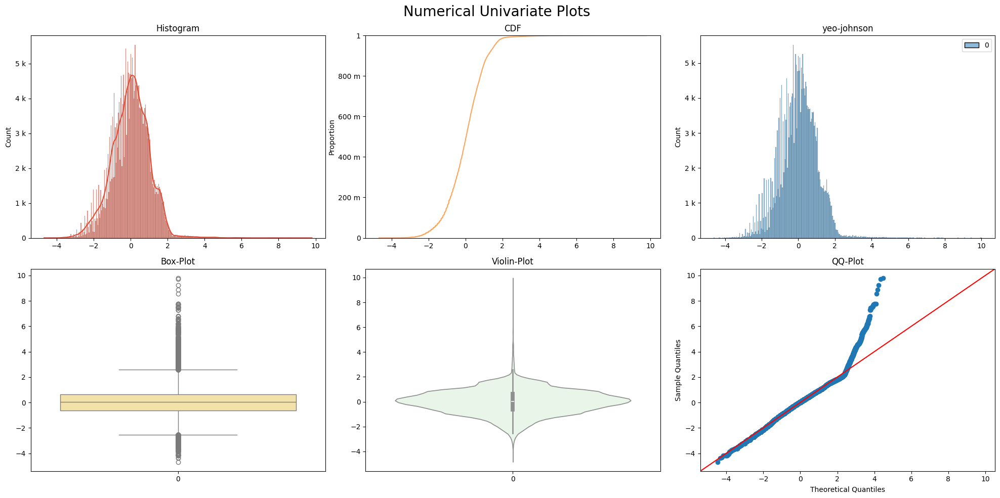

In [ ]:
# transformerd data univariate plots

eda_helper.numerical_univariate_plots(price_power_transformed)

## *Checking Whether the relation got affected*

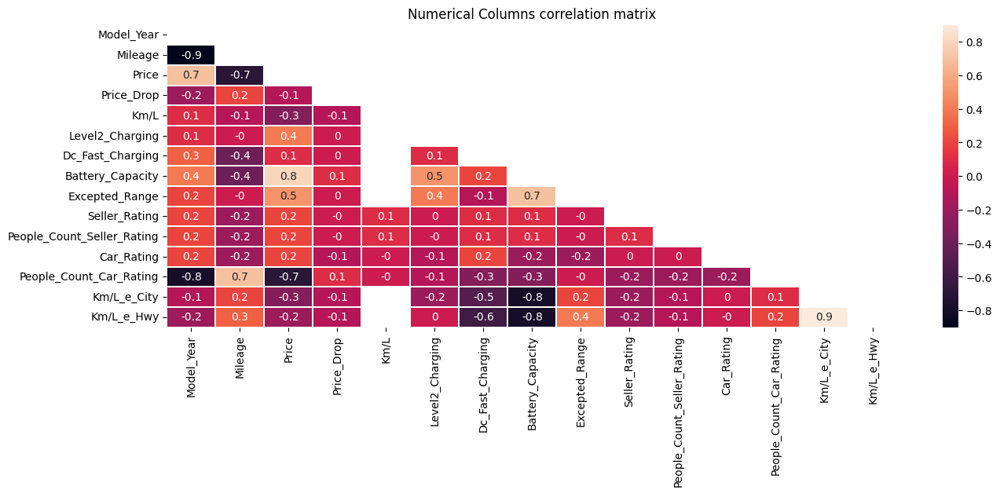

In [ ]:
eda_helper.correlation_heatmap_numerical(df,exclude=['ZIP_Code'])

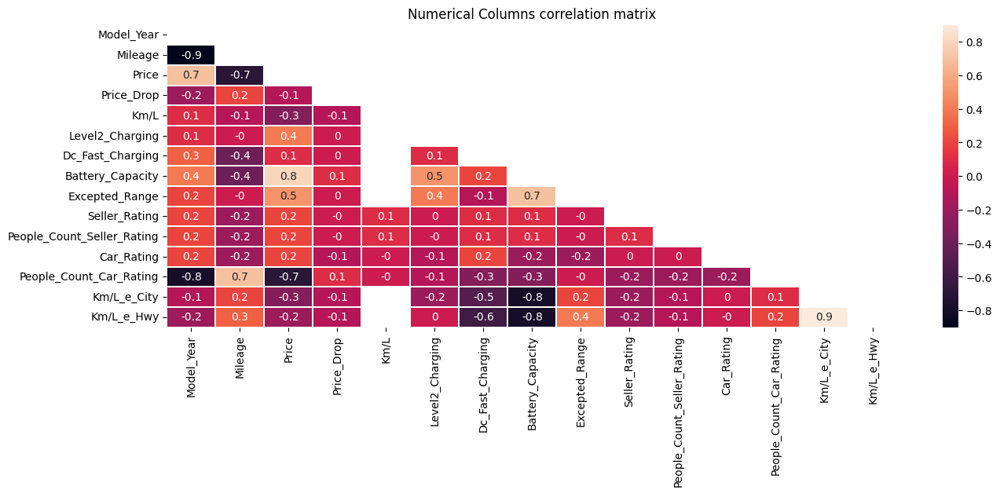

In [ ]:
eda_helper.correlation_heatmap_numerical(cleaned_price.assign(
    Price = PowerTransformer().fit_transform(X=cleaned_price['Price'].values.reshape(-1,1))
),exclude=['ZIP_Code'])

## *Box-Plot Potential Outliers*

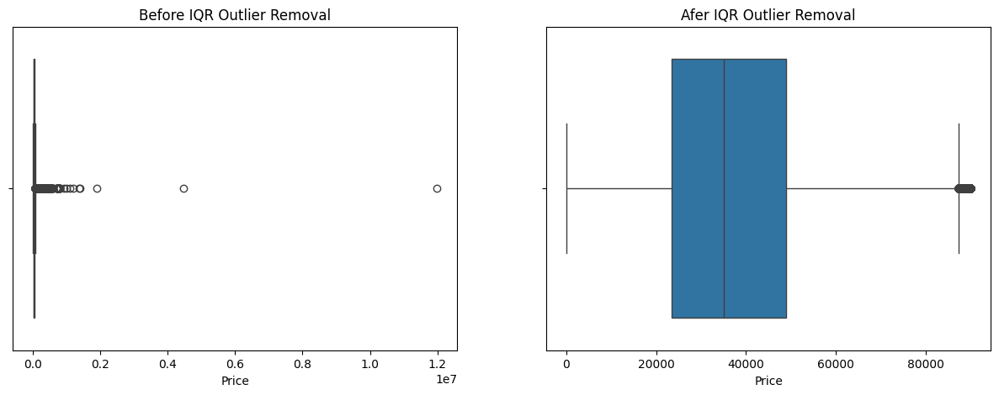

In [ ]:
# box plot outlier analysis, if there is any potential wrong entry or outlier

price_outlier = eda_helper.boxplot_outlier(df,'Price')

In [ ]:
price_outlier['Brand_Name'].value_counts()

,count
Brand_Name,
Porsche,1972
Ford,1811
GMC,1047
Chevrolet,637
BMW,271
Jeep,177
Dodge,129
Mercedes-Benz,128
Audi,56


In [ ]:
# justified

price_outlier[price_outlier['Brand_Name'] == 'Honda']

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
126800,2025,Honda,Odyssey Touring,['https://platform.cstatic-images.com/xlarge/i...,Used,4.0,90917.0,0,NaN,gray,gray,FWD,23.5,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,koons ford of annapolis,5.0,81.0,http://www.koonsford.com?utm_source=cars.com&u...,5.0,2.0,10,3.5,V6,24,True,<NA>,True,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,<NA>,True,<NA>,True,True,True,NaN,NaN,NaN,NaN,2540 Riva Rd,Annapolis,MD,21401.0
127390,2025,Honda,Odyssey Elite,['https://platform.cstatic-images.com/xlarge/i...,Used,34.0,93500.0,0,NaN,white,black,FWD,23.5,Gasoline,Automatic,False,True,one,no,NaN,NaN,NaN,NaN,NaN,team toyota of glen mills,4.5,1308.0,https://www.teamtoyotaglenmills.com/?utm_sourc...,5.0,2.0,NaN,3.5,V6,NaN,True,<NA>,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,True,True,True,True,NaN,NaN,NaN,NaN,1050 Baltimore Pike,Glen Mills,PA,19342.0


In [ ]:
# justified

price_outlier[price_outlier['Brand_Name'] == 'Toyota']

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
14877,2025,Toyota,Sienna XLE,['https://platform.cstatic-images.com/xlarge/i...,Used,6.0,92500.0,0,NaN,silver,gray,FWD,36.0,Hybrid,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,team toyota of glen mills,4.5,1308.0,https://www.teamtoyotaglenmills.com/?utm_sourc...,5.0,1.0,NaN,2.5,I4,NaN,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,NaN,NaN,NaN,NaN,1050 Baltimore Pike,Glen Mills,PA,19342.0
27822,2025,Toyota,Sienna Platinum 7 Passenger,['https://platform.cstatic-images.com/xlarge/i...,Used,4.0,107705.0,0,NaN,black,beige,FWD,36.0,Hybrid,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,koons ford of annapolis,5.0,81.0,http://www.koonsford.com?utm_source=cars.com&u...,5.0,1.0,NaN,2.5,I4,16,True,<NA>,True,True,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,True,True,True,True,True,NaN,NaN,NaN,NaN,2540 Riva Rd,Annapolis,MD,21401.0
73473,2025,Toyota,Sienna XSE,['https://platform.cstatic-images.com/xlarge/i...,Used,19.0,96175.0,0,NaN,gray,black,FWD,36.0,Hybrid,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,team toyota of glen mills,4.5,1308.0,https://www.teamtoyotaglenmills.com/?utm_sourc...,5.0,1.0,NaN,2.5,I4,NaN,True,<NA>,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,True,NaN,NaN,NaN,NaN,1050 Baltimore Pike,Glen Mills,PA,19342.0
74133,2024,Toyota,Sienna XLE,['https://platform.cstatic-images.com/xlarge/i...,Used,4.0,92857.0,0,NaN,gray,gray,FWD,36.0,Hybrid,Automatic,False,True,one,no,NaN,NaN,NaN,NaN,NaN,koons ford of annapolis,5.0,81.0,http://www.koonsford.com?utm_source=cars.com&u...,5.0,2.0,NaN,2.5,I4,16,True,<NA>,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,True,True,<NA>,True,<NA>,True,NaN,NaN,NaN,NaN,2540 Riva Rd,Annapolis,MD,21401.0
89924,2025,Toyota,Sienna XLE,['https://platform.cstatic-images.com/xlarge/i...,Used,6.0,92500.0,0,NaN,black,gray,FWD,36.0,Hybrid,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,team toyota of glen mills,4.5,1308.0,https://www.teamtoyotaglenmills.com/?utm_sourc...,5.0,1.0,NaN,2.5,I4,NaN,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,NaN,NaN,NaN,NaN,1050 Baltimore Pike,Glen Mills,PA,19342.0
117478,2025,Toyota,Sienna XSE,['https://pla

In [ ]:
# jutified

price_outlier[price_outlier['Brand_Name'] == 'Nissan']

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
34266,2015,Nissan,GT-R Premium,['https://platform.cstatic-images.com/xlarge/i...,Used,40651.0,105991.0,0,Good,silver,red,AWD,19.5,Gasoline,Automatic,True,True,more,no,NaN,NaN,NaN,NaN,NaN,auto boom llc,4.0,11.0,https://www.autoboom.com/?utm_source=cars.com&...,5.0,11.0,NaN,3.8,V6,NaN,<NA>,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,8355 East Raintree Drive,Scottsdale,AZ,85260.0
44094,2018,Nissan,GT-R Premium,['https://platform.cstatic-images.com/xlarge/i...,Used,18460.0,122999.0,0,Fair,black,red,AWD,19.0,Gasoline,Automatic,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,brooklyn auto sales,0.0,49.0,https://brooklynautoonline.com/?utm_source=car...,4.7,3.0,NaN,3.8,V6,24,<NA>,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,161 Marion Street,Staten Island,NY,10310.0
44867,2020,Nissan,GT-R Premium Dual-clutch 6-Speed Transmission,['https://platform.cstatic-images.com/xlarge/i...,Used,30718.0,147999.0,0,Good,white,black,AWD,19.0,Gasoline,Automatic,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,luxury auto collection,3.5,40.0,https://www.luxuryautocollection.com/?utm_sour...,3.3,3.0,NaN,3.8,V6,NaN,<NA>,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,9160 E Del Camino Dr DR # B4,Scottsdale,AZ,85258.0
53602,2017,Nissan,GT-R Premium,['https://platform.cstatic-images.com/xlarge/i...,Used,36802.0,101133.0,0,Good,white,brown,AWD,19.0,Gasoline,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,tx auto group,3.6,148.0,http://www.txautogroup.com/?utm_source=cars.co...,4.7,16.0,6,3.8,V6,24,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,5803 Richmond Ave,Houston,TX,77057.0
61417,2015,Nissan,GT-R Premium,['https://platform.cstatic-images.com/xlarge/i...,Used,4796.0,107995.0,2000,Great,red,white,AWD,19.5,Gasoline,NaN,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,motor cars of chicago,3.6,87.0,https://www.mcofchicago.com/?utm_source=cars.c...,5.0,11.0,6,3.8,V6,NaN,<NA>,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,True,True,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,3301 Essington Road,Joliet,IL,60435

In [ ]:
# justified

price_outlier[price_outlier['Brand_Name'] == 'Audi']

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
1143,2025,Audi,RS 6 Avant 4.0T,['https://platform.cstatic-images.com/xlarge/i...,Used,7012.0,148900.0,5600,Fair,gray,black,AWD,17.5,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,bmw of barrington,5.0,47.0,https://www.bmwofbarrington.com/?utm_source=ca...,4.5,2.0,NaN,4,V8,NaN,<NA>,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,1475 South Barrington Road,Barrington,IL,60010.0
2213,2026,Audi,RS 6 Avant 4.0T,['https://platform.cstatic-images.com/xlarge/i...,New,10.0,154090.0,0,NaN,white,black,AWD,17.5,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,audi bellevue,4.7,1932.0,https://www.audibellevue.com/?utm_campaign=car...,NaN,NaN,NaN,4,V8,NaN,True,True,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,1533 120th Ave NE,Bellevue,WA,98005.0
3298,2024,Audi,RS 6 Avant 4.0T,['https://platform.cstatic-images.com/xlarge/i...,Used,6858.0,136990.0,0,Fair,black,brown,AWD,18.0,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,earth motorcars / lotus of dallas,5.0,104.0,http://www.earthmotorcars.com?utm_source=cars....,NaN,NaN,NaN,4,V8,NaN,<NA>,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,3216 Kellway Dr Suite 132,Carrollton,TX,75006.0
12246,2025,Audi,RS 6 Avant 4.0T,['https://platform.cstatic-images.com/xlarge/i...,New,10.0,144215.0,0,NaN,gray,black,AWD,17.5,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,audi new orleans,0.0,11.0,https://www.audineworleans.com/?utm_source=car...,4.5,2.0,NaN,4.0,V8,NaN,<NA>,True,True,True,True,True,True,<NA>,True,<NA>,True,<NA>,<NA>,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,3400 North Causeway Boulevard,Metairie,LA,70002.0
17401,2025,Audi,RS 6 Avant 4.0T,['https://platform.cstatic-images.com/xlarge/i...,New,18.0,144365.0,0,NaN,black,NaN,AWD,17.5,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,audi morton grove,5.0,233.0,https://www.audimortongrove.com/?utm_source=ca...,4.5,2.0,NaN,4,V8,NaN,<NA>,True,True,True,True,True,True,<NA>,True,<NA>,True,<NA>,<NA>,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,True,True,

In [ ]:
price_outlier[price_outlier['Brand_Name'] == 'Mercedes-Benz'].groupby('Model_Name').agg({
    'Brand_Name' : 'count',
    'Price' : 'mean'
})

,Brand_Name,Price
Model_Name,,
S-Class,7,104779.428571
S-Class 4MATIC,1,99995.000000
S-Class 560 SL,1,94900.000000
S-Class Base,2,122973.500000
S-Class S 580 4MATIC,71,112440.887324
SL-Class 2dr Roadster 6.0L AMG,1,97950.000000
SL-Class AMG,1,109951.000000
Sprinter 2500,1,209550.000000
Sprinter 2500 144 WB,3,143168.000000


In [ ]:
# according to data online, these cars are modified according to need, hence price is justified

price_outlier[price_outlier['Model_Name'].str.contains('Sprinter')]

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
522,2022,Mercedes-Benz,Sprinter 2500 144 WB,['https://platform.cstatic-images.com/xlarge/i...,Used,28220.0,99555.0,0,Good,gray,black,RWD,0.0,Diesel,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,bmw of beaumont,4.7,147.0,https://www.bmwofbeaumont.com/?utm_source=cars...,NaN,NaN,7,3.0,V6,24,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1855 Interstate 10,Beaumont,TX,77701.0
9233,2023,Mercedes-Benz,Sprinter 2500 Standard Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,9529.0,117000.0,0,NaN,silver,NaN,RWD,0.0,Diesel,Automatic,False,True,one,no,NaN,NaN,NaN,NaN,NaN,mercedes-benz of valencia,4.1,1133.0,http://www.mbzvalencia.com/index.htm?utm_sourc...,NaN,NaN,NaN,2,I4,NaN,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,23355 Valencia Blvd,Santa Clarita,CA,91355.0
16150,2023,Mercedes-Benz,Sprinter 2500 High Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,3508.0,94991.0,5000,NaN,white,black,RWD,0.0,Diesel,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,nfi empire,2.5,31.0,https://www.nfiempire.com/?utm_source=cars.com...,NaN,NaN,NaN,2,I4,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,10120 W Main St,North East,PA,16428.0
19928,2024,Mercedes-Benz,Sprinter 2500 Standard Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,124.0,129001.0,154,NaN,black,black,RWD,0.0,Diesel,Automatic,False,True,NaN,yes,NaN,NaN,NaN,NaN,NaN,mercedes-benz of edison,5.0,470.0,http://www.raycatenaedison.com?utm_source=cars...,NaN,NaN,NaN,2,I4,NaN,<NA>,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,910 US-1,Edison,NJ,8817.0
30375,2022,Mercedes-Benz,Sprinter 2500 Standard Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,13820.0,119800.0,0,NaN,gray,white,4WD,0.0,Diesel,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,certified benz & beemer,5.0,1821.0,https://www.buycbb.com?utm_source=cars.com&utm...,NaN,NaN,7,3,V6,NaN,True,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,6725 E McDowell R

In [ ]:
price_outlier[price_outlier['Brand_Name'] == 'Dodge']

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
1986,2023,Dodge,Challenger SRT Hellcat Redeye Widebody Jailbreak,['https://platform.cstatic-images.com/xlarge/i...,Used,845.0,123704.0,1291,Fair,black,black,RWD,17.0,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,mclaren philadelphia,0.0,13.0,http://mclarenphl.com?utm_source=cars.com&utm_...,5.0,13.0,8,6.2,V8,16,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1631 W Chester Pike,West Chester,PA,19382.0
4875,2023,Dodge,Challenger SRT Hellcat,['https://platform.cstatic-images.com/xlarge/i...,Used,800.0,130000.0,0,Fair,green,NaN,RWD,17.0,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,huffines cdjr of lewisville,4.8,2183.0,https://www.huffineschryslerjeepdodgeramlewisv...,5.0,13.0,8,6.2,V8,16,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1024 South Stemmons Freeway,Lewisville,TX,75067.0
5263,2018,Dodge,Challenger SRT Hellcat,['https://platform.cstatic-images.com/xlarge/i...,Used,12632.0,92000.0,0,Fair,black,black,RWD,17.5,Gasoline,Automatic,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,gateway classic cars,2.6,325.0,https://gatewayclassiccars.com/?utm_source=car...,4.8,216.0,6,6.2,I6,NaN,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,1237 Central Park Dr,O Fallon,IL,62269.0
6964,2018,Dodge,Challenger SRT Demon,['https://platform.cstatic-images.com/xlarge/i...,Certified,8776.0,98000.0,10000,Good,orange,black,RWD,17.5,Gasoline,Automatic,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,sunrise ford of fontana,4.4,13.0,https://www.sunrisefordfontana.com/?utm_source...,4.8,216.0,8,6.2,V8,16,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,16005 Valley Blvd,Fontana,CA,92335.0
7959,2023,Dodge,Challenger SRT Hellcat,['https://platform.cstatic-images.com/xlarge/i...,New,0.0,103427.0,0,Good,green,black,RWD,17.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,rochester hills chrysler dodge jeep ram,0.0,110.0,https://www.rochesterhillschryslerjeep.net?utm...,5.0,13.0,8,6.2,V8,16,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,Tr

In [ ]:
# there cars are modified(images), hence price is justified

price_outlier[price_outlier['Brand_Name'] == 'Jeep'].sort_values(by='Price',ascending=False)

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
190227,2023,Jeep,Gladiator Mojave 4x4,['https://platform.cstatic-images.com/xlarge/i...,Used,649.0,189901.0,0,Good,gray,black,4WD,19.5,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,101 motors,0.0,40.0,http://www.101motors.com?utm_source=cars.com&u...,4.9,8.0,NaN,3.6,V6,NaN,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,True,<NA>,True,True,<NA>,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,1901 E 5th St,Tempe,AZ,85281.0
90392,2021,Jeep,Gladiator Overland,['https://platform.cstatic-images.com/xlarge/i...,Used,2357.0,185800.0,0,Fair,black,brown,4WD,19.5,Gasoline,Automatic,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,chicago motor cars,4.9,20.0,https://chicagomotorcars.com?utm_source=cars.c...,4.9,62.0,8,3.6,V6,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,27w110 North Ave,West Chicago,IL,60185.0
33358,2025,Jeep,Gladiator Nighthawk,['https://platform.cstatic-images.com/xlarge/i...,Used,166.0,184999.0,0,NaN,black,black,4WD,8.5,Gasoline,Automatic,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,exotic car trader,4.2,10.0,https://www.exoticcartrader.com/?utm_source=ca...,NaN,NaN,NaN,3.6,V6,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1205 NE 9th Ave,Fort Lauderdale,FL,33304.0
49261,2020,Jeep,Gladiator Rubicon,['https://platform.cstatic-images.com/xlarge/i...,Used,47999.0,174905.0,0,Fair,black,black,4WD,19.5,Gasoline,Automatic,True,True,more,no,yes,NaN,NaN,NaN,NaN,ryan auto sales,0.0,25.0,https://www.ryanautosale.com/?utm_source=cars....,4.7,160.0,NaN,3.6,V6,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,4203 East 8 Mile Road,Warren,MI,48091.0
229720,2020,Jeep,Wrangler Unlimited Sport,['https://platform.cstatic-images.com/xlarge/i...,Used,2413.0,169991.0,20000,Fair,black,black,4WD,20.0,Gasoline,Automatic,False,True,more,yes,yes,NaN,NaN,NaN,NaN,mike ward maserati,0.0,16.0,https://www.mikewardmaserati.com/mclaren-maser...,4.8,81.0,8,3.6,V6,24,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1850 Lucent Court,Highlands Ranch,CO,80129.0
...,...,...,...,...,..

In [ ]:
# justified

price_outlier[price_outlier['Brand_Name'] == 'BMW'].groupby('Model_Name').agg({'Price' : 'mean'})

,Price
Model_Name,
M4,129999.000000
M4 Base,123911.800000
M4 CS,119995.000000
M4 Competition xDrive,98826.062500
M4 GTS,552651.500000
X5,91995.000000
X5 M60i,103758.948837
X5 sDrive40i,94025.000000
X5 xDrive40i,91221.875000


In [ ]:
# justified

price_outlier[price_outlier['Brand_Name'] == 'Chevrolet'].groupby('Model_Name').agg({'Price' : 'mean'})

,Price
Model_Name,
Camaro,121949.500000
Camaro *1LE Track Package* *6-Speed Manual* *Only 28 Miles*,99900.000000
Camaro 1SS,178631.666667
Camaro Base,143046.777778
Camaro COPO 427,94900.000000
Camaro RS,117969.400000
Camaro SS,123189.800000
Camaro Z/28,105000.000000
Camaro Z28,129725.000000


In [ ]:
# justified

price_outlier[price_outlier['Brand_Name'] == 'GMC']

11986400.0

In [ ]:
# justified

price_outlier[price_outlier['Brand_Name'] == 'Ford']

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
162,2025,Ford,F-250 Lariat,['https://platform.cstatic-images.com/xlarge/i...,New,28.0,133776.0,0,NaN,gray,black,4WD,0.0,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,ford of clermont,4.7,477.0,https://www.fordofclermont.com/?utm_source=car...,5.0,1.0,10,6.7,V8,NaN,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,True,True,True,True,True,<NA>,<NA>,True,<NA>,NaN,NaN,NaN,NaN,1101 East Highway 50,Clermont,FL,34771.0
263,2025,Ford,F-350 Lariat,['https://platform.cstatic-images.com/xlarge/i...,New,487.0,93455.0,0,NaN,NaN,NaN,4WD,0.0,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,richmond ford lincoln,4.3,1275.0,https://www.richmondfordlincoln.com/?utm_sourc...,NaN,NaN,NaN,6.7,V8,NaN,<NA>,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,True,True,True,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,NaN,NaN,NaN,NaN,4600 W Broad St,Richmond,VA,23230.0
290,2025,Ford,F-250 Platinum,['https://platform.cstatic-images.com/xlarge/i...,New,33.0,111775.0,0,NaN,white,black,4WD,0.0,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,future ford of sacramento,3.8,1631.0,https://www.futurefordofsacramento.com?utm_sou...,5.0,1.0,NaN,6.7,V8,NaN,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,True,True,True,True,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,4625 Madison Ave,Sacramento,CA,95841.0
686,2025,Ford,F-250 Lariat,['https://platform.cstatic-images.com/xlarge/i...,New,17.0,103515.0,0,NaN,red,black,4WD,0.0,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,woody folsom ford,4.6,92.0,https://www.woodyfolsomford.net/?utm_source=ca...,5.0,1.0,10,6.7,V8,NaN,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,True,True,True,True,True,<NA>,True,True,True,<NA>,True,<NA>,NaN,NaN,NaN,NaN,1633 Golden Isles Pkwy,Baxley,GA,31513.0
704,2025,Ford,F-250 Platinum,['https://platform.cstatic-images.com/xlarge/i...,New,7.0,94855.0,0,NaN,white,NaN,4WD,0.0,Diesel,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,red river toyota,0.0,102.0,https://www.redrivertoyota.com/?utm_source=car...,5.0,1.0,10,6.7,V8,32,True,<NA>,True,True,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,True,True,True,True,

----
# **Price_Drop: Outlier Detection & Transformation**

`Problem`:
- To check the Potential outliers, that can effect the analysis

`Solution`:
- By observing the most extreme outlier it is found  that those cars are either `vintage porche 911, BMW last edition cars or some other vintage` car that increased their price, hence the price drop is also different from most of the car which justify their `price drop`.

- `No transformation` needed as this column will not be used during prediction.

`Impact`:
- No Transformation needed

In [ ]:
eda_helper.numerical_summary(df['Price_Drop'])

,Price_Drop
0,0
1,0
2,0
3,0
4,124
...,...
271248,459
271249,0
271250,500
271251,0


Data Type : int64
Missing Data : 0 (0.0 %)
Available Data : 271253 / 271253


,Price_Drop
0.01,0.0
0.05,0.0
0.10,0.0
0.25,0.0
0.50,0.0
0.75,500.0
0.90,1200.0
0.95,2000.0
0.99,4500.0
1.00,100000.0


,value
Mean,439.02
Trimmed Mean (5%),286.10
Trimmed Mean (10%),220.06
Median,0.00


,value
Std,"1,020"
Varience,"1,039,625"
IQR,500


,value
Skewness,11
Kurtosis,489


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


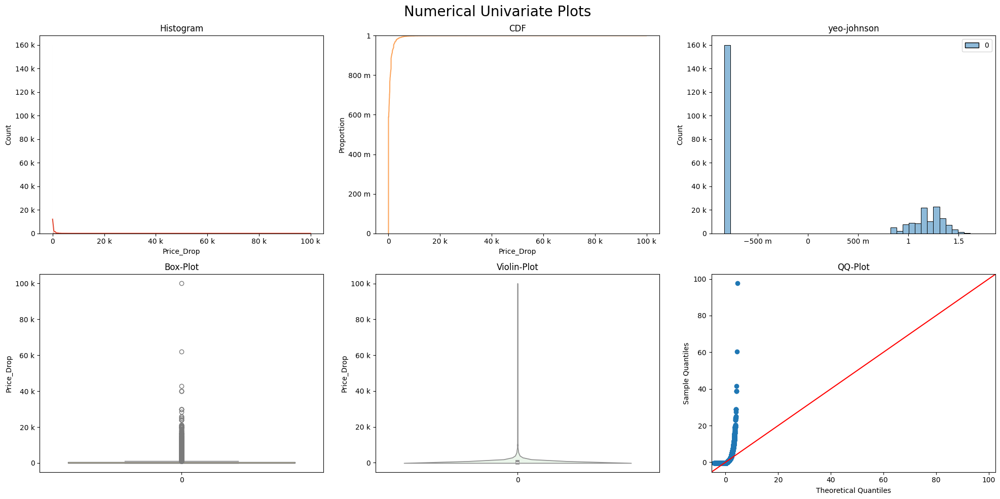

In [ ]:
eda_helper.numerical_univariate_plots(df['Price_Drop'])

In [ ]:
# justified,
# car at 41228 idx has wrong mileage and price entry which got corrected previously

df[df['Price'] < df['Price_Drop']]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
6686,2010,Toyota,Camry LE,['https://platform.cstatic-images.com/xlarge/i...,Used,217958.0,3800.0,5000,Great,black,gray,FWD,10.0,Gasoline,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,downer auto,5.0,8.0,https://www.downerauto.com/?utm_source=cars.co...,4.6,152.0,NaN,3.5,V6,NaN,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,14952 90th Avenue South,Barnesville,MN,56514.0
19505,2006,Chrysler,Town & Country Touring,['https://platform.cstatic-images.com/xlarge/i...,Used,137000.0,500.0,2495,Good,white,gray,FWD,9.0,Gasoline,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,drive hubler certified pre-owned,4.5,236.0,http://www.drivehublerpreowned.com?utm_source=...,4.3,59.0,NaN,3.8,V6,NaN,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,NaN,NaN,NaN,NaN,880 US-31,Greenwood,IN,46143.0
41228,2025,Honda,Odyssey Touring,None,New,0.0,1.0,250,NaN,NaN,blue,FWD,10.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,steve padgett's honda of lake murray,5.0,5.0,https://www.hondaoflakemurray.com?utm_source=c...,5.0,2.0,NaN,3.5,V6,NaN,True,<NA>,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,<NA>,<NA>,True,True,True,True,True,True,True,True,<NA>,True,True,True,NaN,NaN,NaN,NaN,750 Western Lane,Irmo,SC,29063.0
59045,2011,Dodge,Grand Caravan Mainstreet,['https://platform.cstatic-images.com/xlarge/i...,Used,218594.0,1100.0,1884,NaN,white,black,FWD,9.0,Flex Fuel,Automatic,True,True,more,no,NaN,NaN,NaN,NaN,NaN,belle glade chevrolet,3.4,178.0,https://www.bellegladechevybuick.com/?utm_sour...,4.4,46.0,NaN,3.6,V6,24,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,NaN,NaN,NaN,NaN,1700 E Palm Beach Rd,Belle Glade,FL,33430.0
149312,2009,Chrysler,Town & Country LX,['https://platform.cstatic-images.com/xlarge/i...,Used,163500.0,3988.0,4000,Great,silver,gray,FWD,9.0,Flex Fuel,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,landmark dodge chrysler jeep ram,2.6,143.0,https://www.landmarkdodgechryslerjeepmissouri....,4.2,35.0,4,3.3,V6,12,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,NaN,NaN,NaN,NaN,1857 S Noland Rd,Independe

## *Outlier Analysis*

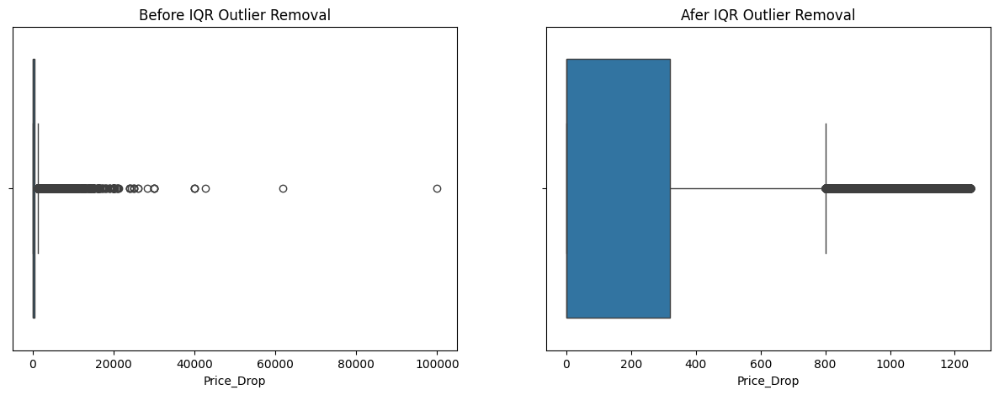

In [ ]:
price_drop_outlier = eda_helper.boxplot_outlier(df,'Price_Drop')

----
# **Deal_Type**

- This column have just missing value related issue, which do not required to be solved as this column will not be used in prediction, This feature is developed by source website just to label the cars so that user can get instant summary about car, not for prediction.

----
# **Interior & Exterior color**

`Problem`
- This two columns contain `missing values` which need to be filled.

- During cleaning phase I have maintained a long dict to categorize each `messy color` name to a perticular most common name like red,green, black etc, but that approch is `not working fine`, as I found few cars that have `different color` in image but is labelled some wrong category in `Interior` & `Exterior` color column.

- Categorize infrequent categories to others.

`Solution`

- Imputation of this column require a machine learing model or non-ML (classical image processing) approches like histograms in HSV/RGB space, before that I have to extract the image from the link, which will take time, hence will be done after transformation and other column imputation.

- Same approch can be applied for the cars where the colors are misclassified (by that dictionary way of cleaning) as well as for the infrequent categories handling.

`Impact`
- No action taken yet.

----

# **Km/L: Descritization & Potential Outliers**

`Problem`:

- Can we descritize the data, will it be helpful.
- Remove outliers.

`Solution`
> Cleaning
- car at idx `224055,41157` have wrong entry, which will be set to np.nan.

- I found that unlike India, car companies in USA are not focusing more on `fuel efficiency`, I found the top 2 reason on Internet -
  - `Car culture`: The U.S. has historically preferred bigger cars — trucks, SUVs, and muscle cars — which trade efficiency for power, space, and comfort.

  - `Fuel prices`: Gasoline has been much cheaper in the U.S. compared to Europe or Asia, so manufacturers didn’t need to optimize aggressively for km/l.

- `Descritization` will not help, as cars mileage can attend any value in between.

`Impact`
- Reducing the wrong entry can help reduce the `skewness` and `kurtosis`

- Dropping the idea of `Descritizing` the values,as it can impact the `extreme values`, which can hamper the predictive power.

- Example - First bin according to our data will start from 5 to 5+x value (as 5 is the least value in our data) but what if user enter even lesser value, in that case it will either give np.nan or error which is not desired.




In [ ]:
eda_helper.numerical_summary(df['Km/L'].drop(index=[224055,41157]))

,Km/L
0,NaN
1,11.0
2,5.0
3,7.0
4,11.0
...,...
271248,9.0
271249,10.0
271250,11.0
271251,13.0


Data Type : float64
Missing Data : 58150 (21.44 %)
Available Data : 213101 / 271251


,Km/L
0.01,5.0
0.05,7.0
0.10,8.0
0.25,9.0
0.50,10.0
0.75,13.0
0.90,16.0
0.95,17.0
0.99,21.0
1.00,47.0


,value
Mean,10.94
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,10.00


,value
Std,3
Varience,11
IQR,4


,value
Skewness,1
Kurtosis,1


In [ ]:
# wrong entries -> 224055,41157

df[df['Km/L'] > 25].sort_values(by='Km/L',ascending=False)

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
224055,2025,Porsche,Panamera,['https://platform.cstatic-images.com/xlarge/i...,Certified,3880.0,118900.0,0,Fair,white,black,RWD,92235.0,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,champion porsche,5.0,184.0,http://www.champion-porsche.com/?utm_source=ca...,NaN,NaN,NaN,2.9,V6,NaN,<NA>,<NA>,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,<NA>,True,True,<NA>,NaN,NaN,NaN,NaN,500 W Copans Rd,Pompano Beach,FL,33064.0
41157,2013,Volkswagen,Jetta SportWagen TDI,['https://platform.cstatic-images.com/xlarge/i...,Used,93829.0,11480.0,0,Great,white,beige,FWD,60.0,Diesel,Automatic,False,True,more,yes,NaN,NaN,NaN,NaN,NaN,definitive motors,3.5,44.0,https://www.definitivemotors.com/?utm_campaign...,4.4,45.0,NaN,2,I4,NaN,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,True,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,NaN,NaN,NaN,NaN,203 116th Avenue Northeast,Bellevue,WA,98004.0
780,2018,Honda,Clarity Plug-In Hybrid Base,['https://platform.cstatic-images.com/xlarge/i...,Used,64397.0,17888.0,111,Great,gray,black,FWD,47.0,Hybrid,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,rose motorcars,0.0,14.0,https://www.driverose.com?utm_source=cars.com&...,4.6,114.0,NaN,1.5,I4,NaN,True,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,2806 Castro Valley Boulevard,Castro Valley,CA,94546.0
182024,2019,Honda,Clarity Plug-In Hybrid Touring,['https://platform.cstatic-images.com/xlarge/i...,Used,50562.0,19999.0,111,Good,white,beige,FWD,47.0,Hybrid,Automatic,True,True,more,no,NaN,NaN,NaN,NaN,NaN,rose motorcars,0.0,14.0,https://www.driverose.com?utm_source=cars.com&...,4.9,11.0,NaN,1.5,I4,NaN,True,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,True,<NA>,True,True,<NA>,NaN,NaN,NaN,NaN,2806 Castro Valley Boulevard,Castro Valley,CA,94546.0
167645,2023,Volkswagen,ID.4 Pro S Plus,['https://platform.cstatic-images.com/xlarge/i...,Used,36128.0,23999.0,0,Great,black,black,RWD,45.0,NaN,Automatic,False,True,one,yes,yes,NaN,NaN,NaN,NaN,clay cooley mitsubishi,4.6,11.0,https://www.claycooleymitsubishiofarlington.co...,4.5,13.0,1,0.0,NaN,NaN,True,<NA>,True,True,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,True,True,True,True,<NA>,NaN,NaN,Na

/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


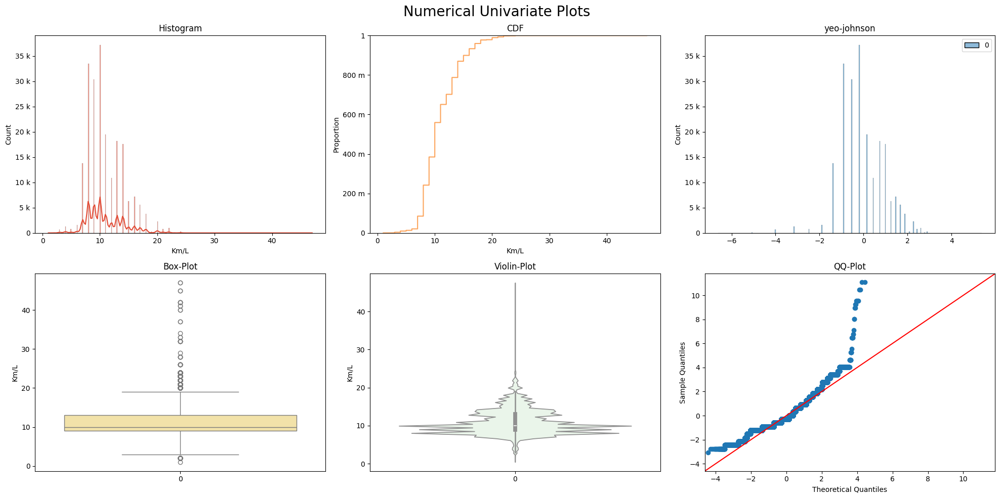

In [ ]:
eda_helper.numerical_univariate_plots(df['Km/L'].drop(index=[224055,41157]))

----
# **Fuel_Type: Handling Small Categories**

`Problem`:
- will try to combine the cars with `Plugin-Hybrid`, `Othes` & `CNG/LPG` into one categories, if possible.
- `Hybrid` categories sometimes contain `Plugin-Hybrid`, which need to be handled.

`Solution`:
- With help of dict and function, I have seperated the `Hybrid` & `Plug-in Hybrid` cars, in that process I also found that few cars does not come in either of two category, hence assigned them `Gasoline` category there in the function itself.

- We Can't merge the `LPG/CNG` & `Other` fuel type columns, as they didn't passed the `hypotheses test`.

`Impact`:
- Corrected the Category so that any algorithm can avoid learning rubbish pattern.

In [ ]:
eda_helper.cat_summary(df['Fuel_Type'])

,Fuel_Type
0,Electric
1,Gasoline
2,Flex Fuel
3,Gasoline
4,Gasoline
...,...
271248,Gasoline
271249,Gasoline
271250,Gasoline
271251,Gasoline


Data Type : category
No. of unique value : 8
Missing Rows : 5029 (1.85 %)
Available Data : 266224 / 271253 rows


,Fuel_Type
count,266224
unique,8
top,Gasoline
freq,213560


,count,proportion
Fuel_Type,,
Gasoline,213560,80.218
Hybrid,25507,9.581
Diesel,18601,6.987
Flex Fuel,4368,1.641
Electric,3982,1.496
Plug-in Hybrid,90,0.034
Other,64,0.024
CNG/LPG,52,0.020


None

## *Whether we can combine LPG/CNG & Others category*

----------------
Significance level : 5.0 %
Null Hypothesis : All Groups have equal variances.
Alternate Hypothesis : At least one group has different variance.
Test Statistic : 107.87678735887746
Pvalue : 1.5110029873489593e-158
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Variances between groups are not equal.


/content/eda_helper.py:459: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups_dict = {name:group[numeric_col].values for name,group in test_df.groupby(category_col)}


---------------------
Significance level : 5.0%
Null Hypothesis : All Group means are equal.
Alternate Hypothesis : One or more Group mean is different
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Atleast one group mean is different


/content/eda_helper.py:502: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups_dict = {name:group[numeric_col].values for name,group in test_df.groupby(category_col)}


--------------------------------------

           Multiple Comparison of Means - Tukey HSD, FWER=0.05            
  group1      group2       meandiff  p-adj     lower       upper    reject
--------------------------------------------------------------------------
  CNG/LPG         Diesel  51887.1322    0.0  37275.8964  66498.3681   True
  CNG/LPG       Electric   7362.3385 0.7973  -7324.5143  22049.1913  False
  CNG/LPG      Flex Fuel  16647.3295 0.0137   1968.7633  31325.8957   True
  CNG/LPG       Gasoline  17093.3962 0.0092   2500.9126  31685.8798   True
  CNG/LPG         Hybrid  22327.5382 0.0001   7721.6962  36933.3802   True
  CNG/LPG          Other  16656.5248  0.174  -3128.3093  36441.3589  False
  CNG/LPG Plug-in Hybrid  10836.5872 0.6255  -7490.7238  29163.8982  False
   Diesel       Electric -44524.7938    0.0 -46372.8703 -42676.7173   True
   Diesel      Flex Fuel -35239.8028    0.0  -37020.827 -33458.7785   True
   Diesel       Gasoline -34793.7361    0.0 -35601.3986 -339

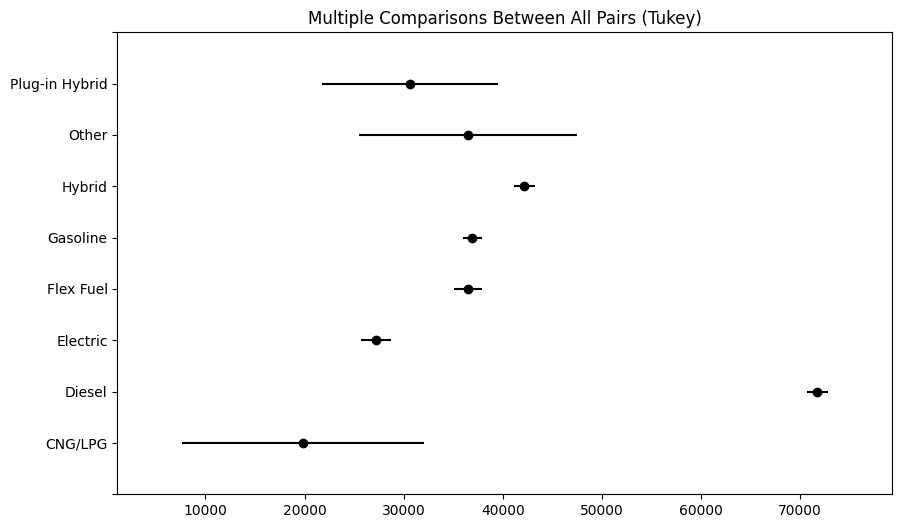

In [ ]:
# can't combine the others and LPG/CNG in one category

eda_helper.numerical_vs_categorical_hypothesis_test(df,'Price','Fuel_Type')

## *Assigning right Fuel_Type to Hybrid cars*

In [139]:
# hybrid column have plugin hybrid cars too, correcting those entry with a dict

hybrid_correction_dict = {'rav4 hybrid xle': 'Hybrid',
 'cr-v hybrid sport-l': 'Hybrid',
 'accord hybrid ex-l': 'Hybrid',
 'rav4 hybrid se': 'Hybrid',
 'accord hybrid sport': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus dark theme 7-seater': 'Plug-in Hybrid',
 'cr-v hybrid sport': 'Hybrid',
 'sienna xse 7 passenger': 'Hybrid',
 'rav4 hybrid le': 'Hybrid',
 'pacifica hybrid limited': 'Plug-in Hybrid',
 '330e xdrive': 'Plug-in Hybrid',
 'cr-v hybrid trailsport': 'Hybrid',
 'accord hybrid base': 'Hybrid',
 'cr-v hybrid sport touring': 'Hybrid',
 'highlander hybrid limited': 'Hybrid',
 'highlander hybrid xle': 'Hybrid',
 'accord hybrid touring': 'Hybrid',
 'sienna xse 25th anniversary': 'Hybrid',
 'fusion hybrid s': 'Hybrid',
 'camry hybrid': 'Hybrid',
 'prius four': 'Hybrid',
 'clarity plug-in hybrid base': 'Plug-in Hybrid',
 'accord hybrid sport-l': 'Hybrid',
 'sienna xle': 'Hybrid',
 'camry hybrid xle': 'Hybrid',
 'sienna platinum 7 passenger': 'Hybrid',
 'sienna xse': 'Hybrid',
 'sienna xle 8 passenger': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus 6 passenger': 'Plug-in Hybrid',
 'rav4 hybrid xle premium': 'Hybrid',
 'rav4 hybrid limited': 'Hybrid',
 'sienna limited': 'Hybrid',
 'highlander hybrid platinum': 'Hybrid',
 'accord hybrid base (cvt)': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus bright theme 7-seater': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid ultimate bright theme': 'Plug-in Hybrid',
 'prius i': 'Hybrid',
 'prius limited': 'Hybrid',
 'highlander hybrid le': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus 6-seater': 'Plug-in Hybrid',
 'rav4 prime se': 'Plug-in Hybrid',
 'corolla hybrid le': 'Hybrid',
 'q5 55 s line premium plus': 'Plug-in Hybrid',
 'camry hybrid le': 'Hybrid',
 'fusion hybrid se': 'Hybrid',
 'camry hybrid base': 'Hybrid',
 'camry hybrid xse': 'Hybrid',
 'rav4 hybrid woodland edition': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus bright theme 7 passenger': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 ultimate dark theme 7-seater': 'Plug-in Hybrid',
 'escape phev': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription 6 passenger': 'Plug-in Hybrid',
 '330e 330e': 'Plug-in Hybrid',
 'clarity plug-in hybrid touring': 'Plug-in Hybrid',
 'fusion hybrid sel': 'Hybrid',
 'prius three': 'Hybrid',
 'sequoia capstone': 'Hybrid',
 'prius xle': 'Hybrid',
 'prius le': 'Hybrid',
 'sequoia sr5': 'Hybrid',
 'pacifica hybrid s appearance pkg': 'Plug-in Hybrid',
 'fusion hybrid titanium': 'Hybrid',
 'cr-v hybrid ex': 'Hybrid',
 'i8 base': 'Plug-in Hybrid',
 'pacifica hybrid touring l': 'Plug-in Hybrid',
 'rav4 prime xse': 'Plug-in Hybrid',
 'camry hybrid se': 'Hybrid',
 'accord hybrid ex': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription extended range 7p': 'Plug-in Hybrid',
 'rav4 hybrid xse': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 ultimate 6-seater': 'Plug-in Hybrid',
 'prius v five': 'Hybrid',
 'prius ii': 'Hybrid',
 'c-max energi se': 'Plug-in Hybrid',
 'prius base': 'Hybrid',
 'cr-v hybrid touring': 'Hybrid',
 'escape titanium hybrid': 'Hybrid',
 'pacifica hybrid select': 'Plug-in Hybrid',
 'wrangler sahara 4xe': 'Plug-in Hybrid',
 'c-max energi sel': 'Plug-in Hybrid',
 'prius iv': 'Hybrid',
 'volt premier': 'Plug-in Hybrid',
 'highlander hybrid bronze edition': 'Hybrid',
 'prius five': 'Hybrid',
 'sequoia trd pro': 'Hybrid',
 'sienna le': 'Hybrid',
 'prius two': 'Hybrid',
 'tundra limited hybrid': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 ultimate bright theme 7-seater': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 core bright theme': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 r-design extended range 7p': 'Plug-in Hybrid',
 'tundra trd pro hybrid': 'Hybrid',
 'cayenne platinum edition hybrid': 'Plug-in Hybrid',
 'sequoia platinum': 'Hybrid',
 '330e 330e xdrive': 'Plug-in Hybrid',
 'f-150 xl hybrid': 'Hybrid',
 'cr-v hybrid ex-l': 'Hybrid',
 'tundra platinum hybrid': 'Hybrid',
 'pacifica hybrid premium s appearance pkg': 'Plug-in Hybrid',
 's-class s 400 hybrid sedan 4d': 'Hybrid',
 'maverick xlt hybrid   - warranty  - no hidden fees': 'Hybrid',
 'sienna woodland edition': 'Hybrid',
 'panamera 4 e-hybrid': 'Plug-in Hybrid',
 'sequoia limited': 'Hybrid',
 'q5 55 s line quattro premium': 'Plug-in Hybrid',
 'prius': 'Hybrid',
 'highlander hybrid': 'Hybrid',
 'rav4 hybrid': 'Hybrid',
 'volt lt': 'Plug-in Hybrid',
 'prius three touring': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription expression 6 passenger': 'Plug-in Hybrid',
 'prius nightshade': 'Hybrid',
 'escape se sport hybrid': 'Hybrid',
 'cayenne e-hybrid': 'Plug-in Hybrid',
 'pacifica hybrid red s edition': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid inscription expression': 'Plug-in Hybrid',
 'civic hybrid sedan 4d': 'Hybrid',
 'sequoia 1794 edition': 'Hybrid',
 'rav4 hybrid hybrid xse': 'Hybrid',
 'prius l': 'Hybrid',
 'camry hybrid nightshade': 'Hybrid',
 'prius v three': 'Hybrid',
 'pacifica hybrid touring': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid ultimate': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid plus bright theme': 'Plug-in Hybrid',
 'highlander hybrid base': 'Hybrid',
 'pacifica hybrid platinum': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 plus dark theme 7 passenger': 'Plug-in Hybrid',
 'prius touring': 'Hybrid',
 's-class s 550e plug-in hybrid loaded low miles ice cold ac runs great': 'Plug-in Hybrid',
 'sienna xle woodland edition': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 ultimate bright 7-seater': 'Plug-in Hybrid',
 'prius v two': 'Hybrid',
 'cr-v hybrid': 'Hybrid',
 'prius two eco': 'Hybrid',
 'cayenne e-hybrid $112k msrp premium pkg assistance pkg': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription 7 passenger': 'Plug-in Hybrid',
 'rav4 hybrid woodland': 'Hybrid',
 'x5 xdrive50e': 'Plug-in Hybrid',
 'cayenne e-hybrid w/ premium package': 'Plug-in Hybrid',
 'highlander hybrid limited platinum': 'Hybrid',
 'prius v': 'Hybrid',
 'c-max energi titanium': 'Plug-in Hybrid',
 'cayenne s hybrid': 'Plug-in Hybrid',
 'prius three se': 'Hybrid',
 'fusion hybrid base': 'Hybrid',
 'prius four touring': 'Hybrid',
 'camry nightshade edition hybrid': 'Hybrid',
 'sienna': 'Hybrid',
 'prius one': 'Hybrid',
 'pacifica hybrid pinnacle': 'Plug-in Hybrid',
 'sequoia': 'Hybrid',
 'pacifica hybrid touring plus': 'Plug-in Hybrid',
 'rav4 hybrid le plus': 'Hybrid',
 'escape se hybrid': 'Hybrid',
 'prius iii': 'Hybrid',
 '330e iperformance': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid inscription': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 eawd phev core bright theme 7p': 'Plug-in Hybrid',
 'rav4 hybrid hybrid xle premium': 'Hybrid',
 'camry hybrid base (retail orders only) (cvt)': 'Hybrid',
 'camry hybrid se night shade': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 r-design 7 passenger': 'Plug-in Hybrid',
 'escape phev phev': 'Plug-in Hybrid',
 'grand cherokee 4xe': 'Plug-in Hybrid',
 'fusion hybrid': 'Hybrid',
 'prius standard': 'Hybrid',
 'rav4 hybrid hybrid xle': 'Hybrid',
 'sienna le 8 passenger': 'Hybrid',
 '330e': 'Plug-in Hybrid',
 '330e base': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid plus': 'Plug-in Hybrid',
 'c-class c 350e plug-in hybrid sedan 4d': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription expression extended range 6p': 'Plug-in Hybrid',
 'accord hybrid': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription expression 7 passenger': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription expression extended range 7p': 'Plug-in Hybrid',
 'fusion hybrid titanium/platin': 'Hybrid',
 'highlander hybrid xle bronze': 'Hybrid',
 'sienna limited 7-passenger': 'Hybrid',
 'sienna platinum': 'Hybrid',
 'rav4 hybrid hybrid limited': 'Hybrid',
 'sienna xle 7 passenger': 'Hybrid',
 'panamera 4 e-hybrid platinum edition awd': 'Plug-in Hybrid',
 'prius four/power&heated seats/power mirrors windows&lock': 'Hybrid',
 'q5 55 s line premium': 'Plug-in Hybrid',
 'prius v four': 'Hybrid',
 'camry hybrid base (cvt)': 'Hybrid',
 'cr-v hybrid lx': 'Hybrid',
 'rav4 hybrid hybrid se': 'Hybrid',
 'xc90 recharge plug-in hybrid eawd inscription 7 seater': 'Plug-in Hybrid',
 'volt base': 'Plug-in Hybrid',
 'prius base (ecvt)': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 eawd phev plus dark theme 7p': 'Plug-in Hybrid',
 'x3 xdrive30e': 'Plug-in Hybrid',
 'fusion hybrid platinum': 'Hybrid',
 'cayenne e-hybrid coupe awd': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 eawd phev plus bright theme 7p': 'Plug-in Hybrid',
 's-class s 550e plug-in hybrid sedan 4d': 'Plug-in Hybrid',
 'tundra capstone hybrid': 'Hybrid',
 'prius 20th anniversary edition': 'Hybrid',
 'camry hybrid hybrid': 'Hybrid',
 'xc90 recharge plug-in hybrid plus dark theme': 'Plug-in Hybrid',
 'forester premium hybrid': 'Hybrid',
 'tundra trd pro hv': 'Hybrid',
 'sienna l': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription extended range 6p': 'Plug-in Hybrid',
 'grand highlander hybrid nightshade edition': 'Hybrid',
 'volt': 'Plug-in Hybrid',
 'civic hybrid': 'Hybrid',
 'malibu eco': 'Hybrid',
 'e-class amg e 53': 'Hybrid',
 'corvette e-ray': 'Hybrid',
 'pacifica hybrid premium': 'Plug-in Hybrid',
 "tundra trd pro hybrid crewmax 5.5' bed (natl)": 'Hybrid',
 'camry hybrid base (e-cvt)': 'Hybrid',
 'xc90 recharge plug-in hybrid ultimate bright 7-seater': 'Plug-in Hybrid',
 'cayenne e-hybrid awd': 'Plug-in Hybrid',
 'mdx sport hybrid w/advance pkg': 'Hybrid',
 'cayenne e-hybrid coupe': 'Plug-in Hybrid',
 'camry hybrid se limited edition': 'Hybrid',
 'prius persona series': 'Hybrid',
 'i3 base w/range extender': 'Plug-in Hybrid',



 'rav4 hybrid xle': 'Hybrid',
 'cr-v hybrid sport-l': 'Hybrid',
 'accord hybrid ex-l': 'Hybrid',
 'rav4 hybrid se': 'Hybrid',
 'accord hybrid sport': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus dark theme 7-seater': 'Plug-in Hybrid',
 'cr-v hybrid sport': 'Hybrid',
 'sienna xse 7 passenger': 'Hybrid',
 'rav4 hybrid le': 'Hybrid',
 'pacifica hybrid limited': 'Plug-in Hybrid',
 '330e xdrive': 'Plug-in Hybrid',
 'cr-v hybrid trailsport': 'Hybrid',
 'accord hybrid base': 'Hybrid',
 'cr-v hybrid sport touring': 'Hybrid',
 'highlander hybrid limited': 'Hybrid',
 'highlander hybrid xle': 'Hybrid',
 'accord hybrid touring': 'Hybrid',
 'sienna xse 25th anniversary': 'Hybrid',
 'fusion hybrid s': 'Hybrid',
 'camry hybrid': 'Hybrid',
 'prius four': 'Hybrid',
 'clarity plug-in hybrid base': 'Plug-in Hybrid',
 'accord hybrid sport-l': 'Hybrid',
 'sienna xle': 'Hybrid',
 'camry hybrid xle': 'Hybrid',
 'sienna platinum 7 passenger': 'Hybrid',
 'sienna xse': 'Hybrid',
 'sienna xle 8 passenger': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus 6 passenger': 'Plug-in Hybrid',
 'rav4 hybrid xle premium': 'Hybrid',
 'rav4 hybrid limited': 'Hybrid',
 'sienna limited': 'Hybrid',
 'highlander hybrid platinum': 'Hybrid',
 'accord hybrid base (cvt)': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus bright theme 7-seater': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid ultimate bright theme': 'Plug-in Hybrid',
 'prius i': 'Hybrid',
 'prius limited': 'Hybrid',
 'highlander hybrid le': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus 6-seater': 'Plug-in Hybrid',
 'rav4 prime se': 'Plug-in Hybrid',
 'corolla hybrid le': 'Hybrid',
 'q5 55 s line premium plus': 'Plug-in Hybrid',
 'camry hybrid le': 'Hybrid',
 'fusion hybrid se': 'Hybrid',
 'camry hybrid base': 'Hybrid',
 'camry hybrid xse': 'Hybrid',
 'rav4 hybrid woodland edition': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 plus bright theme 7 passenger': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 ultimate dark theme 7-seater': 'Plug-in Hybrid',
 'escape phev': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription 6 passenger': 'Plug-in Hybrid',
 'clarity plug-in hybrid touring': 'Plug-in Hybrid',
 'fusion hybrid sel': 'Hybrid',
 'prius three': 'Hybrid',
 'sequoia capstone': 'Hybrid',
 'prius xle': 'Hybrid',
 'prius le': 'Hybrid',
 'sequoia sr5': 'Hybrid',
 'pacifica hybrid s appearance pkg': 'Plug-in Hybrid',
 'fusion hybrid titanium': 'Hybrid',
 'cr-v hybrid ex': 'Hybrid',
 'i8 base': 'Plug-in Hybrid',
 'pacifica hybrid touring l': 'Plug-in Hybrid',
 'rav4 prime xse': 'Plug-in Hybrid',
 'camry hybrid se': 'Hybrid',
 'accord hybrid ex': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription extended range 7p': 'Plug-in Hybrid',
 'rav4 hybrid xse': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 ultimate 6-seater': 'Plug-in Hybrid',
 'prius v five': 'Hybrid',
 'prius ii': 'Hybrid',
 'c-max energi se': 'Plug-in Hybrid',
 'prius base': 'Hybrid',
 'cr-v hybrid touring': 'Hybrid',
 'escape titanium hybrid': 'Hybrid',
 'pacifica hybrid select': 'Plug-in Hybrid',
 'wrangler sahara 4xe': 'Plug-in Hybrid',
 'c-max energi sel': 'Plug-in Hybrid',
 'prius iv': 'Hybrid',
 'volt premier': 'Plug-in Hybrid',
 'highlander hybrid bronze edition': 'Hybrid',
 'prius five': 'Hybrid',
 'sequoia trd pro': 'Hybrid',
 'sienna le': 'Hybrid',
 'prius two': 'Hybrid',
 'tundra limited hybrid': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 ultimate bright theme 7-seater': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 core bright theme': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 r-design extended range 7p': 'Plug-in Hybrid',
 'tundra trd pro hybrid': 'Hybrid',
 'cayenne platinum edition hybrid': 'Plug-in Hybrid',
 'sequoia platinum': 'Hybrid',
 '330e 330e xdrive': 'Plug-in Hybrid',
 'f-150 xl hybrid': 'Hybrid',
 'cr-v hybrid ex-l': 'Hybrid',
 'tundra platinum hybrid': 'Hybrid',
 'pacifica hybrid premium s appearance pkg': 'Plug-in Hybrid',
 's-class s 400 hybrid sedan 4d': 'Hybrid',
 'maverick xlt hybrid   - warranty  - no hidden fees': 'Hybrid',
 'sienna woodland edition': 'Hybrid',
 'panamera 4 e-hybrid': 'Plug-in Hybrid',
 'sequoia limited': 'Hybrid',
 'q5 55 s line quattro premium': 'Plug-in Hybrid',
 'prius': 'Hybrid',
 'highlander hybrid': 'Hybrid',
 'rav4 hybrid': 'Hybrid',
 'volt lt': 'Plug-in Hybrid',
 'prius three touring': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription expression 6 passenger': 'Plug-in Hybrid',
 'prius nightshade': 'Hybrid',
 'escape se sport hybrid': 'Hybrid',
 'cayenne e-hybrid': 'Plug-in Hybrid',
 'pacifica hybrid red s edition': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid inscription expression': 'Plug-in Hybrid',
 'civic hybrid sedan 4d': 'Hybrid',
 'sequoia 1794 edition': 'Hybrid',
 'rav4 hybrid hybrid xse': 'Hybrid',
 'prius l': 'Hybrid',
 'camry hybrid nightshade': 'Hybrid',
 'prius v three': 'Hybrid',
 'pacifica hybrid touring': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid ultimate': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid plus bright theme': 'Plug-in Hybrid',
 'highlander hybrid base': 'Hybrid',
 'pacifica hybrid platinum': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 plus dark theme 7 passenger': 'Plug-in Hybrid',
 'prius touring': 'Hybrid',
 's-class s 550e plug-in hybrid loaded low miles ice cold ac runs great': 'Plug-in Hybrid',
 'sienna xle woodland edition': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 ultimate bright 7-seater': 'Plug-in Hybrid',
 'prius v two': 'Hybrid',
 'cr-v hybrid': 'Hybrid',
 'prius two eco': 'Hybrid',
 'cayenne e-hybrid $112k msrp premium pkg assistance pkg': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription 7 passenger': 'Plug-in Hybrid',
 'rav4 hybrid woodland': 'Hybrid',
 'x5 xdrive50e': 'Plug-in Hybrid',
 'cayenne e-hybrid w/ premium package': 'Plug-in Hybrid',
 'highlander hybrid limited platinum': 'Hybrid',
 'prius v': 'Hybrid',
 'c-max energi titanium': 'Plug-in Hybrid',
 'cayenne s hybrid': 'Plug-in Hybrid',
 'prius three se': 'Hybrid',
 'fusion hybrid base': 'Hybrid',
 'prius four touring': 'Hybrid',
 'camry nightshade edition hybrid': 'Hybrid',
 'sienna': 'Hybrid',
 'prius one': 'Hybrid',
 'pacifica hybrid pinnacle': 'Plug-in Hybrid',
 'sequoia': 'Hybrid',
 'pacifica hybrid touring plus': 'Plug-in Hybrid',
 'rav4 hybrid le plus': 'Hybrid',
 'escape se hybrid': 'Hybrid',
 'prius iii': 'Hybrid',
 '330e iperformance': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid inscription': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 eawd phev core bright theme 7p': 'Plug-in Hybrid',
 'rav4 hybrid hybrid xle premium': 'Hybrid',
 'camry hybrid base (retail orders only) (cvt)': 'Hybrid',
 'camry hybrid se night shade': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 r-design 7 passenger': 'Plug-in Hybrid',
 'escape phev phev': 'Plug-in Hybrid',
 'grand cherokee 4xe': 'Plug-in Hybrid',
 'fusion hybrid': 'Hybrid',
 'prius standard': 'Hybrid',
 'rav4 hybrid hybrid xle': 'Hybrid',
 'sienna le 8 passenger': 'Hybrid',
 '330e base': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid plus': 'Plug-in Hybrid',
 'c-class c 350e plug-in hybrid sedan 4d': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription expression extended range 6p': 'Plug-in Hybrid',
 'accord hybrid': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription expression 7 passenger': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 inscription expression extended range 7p': 'Plug-in Hybrid',
 'fusion hybrid titanium/platin': 'Hybrid',
 'highlander hybrid xle bronze': 'Hybrid',
 'sienna limited 7-passenger': 'Hybrid',
 'sienna platinum': 'Hybrid',
 'rav4 hybrid hybrid limited': 'Hybrid',
 'sienna xle 7 passenger': 'Hybrid',
 'panamera 4 e-hybrid platinum edition awd': 'Plug-in Hybrid',
 'prius four/power&heated seats/power mirrors windows&lock': 'Hybrid',
 'q5 55 s line premium': 'Plug-in Hybrid',
 'prius v four': 'Hybrid',
 'camry hybrid base (cvt)': 'Hybrid',
 'cr-v hybrid lx': 'Hybrid',
 'rav4 hybrid hybrid se': 'Hybrid',
 'xc90 recharge plug-in hybrid eawd inscription 7 seater': 'Plug-in Hybrid',
 'volt base': 'Plug-in Hybrid',
 'prius base (ecvt)': 'Hybrid',
 'xc90 recharge plug-in hybrid t8 eawd phev plus dark theme 7p': 'Plug-in Hybrid',
 'x3 xdrive30e': 'Plug-in Hybrid',
 'fusion hybrid platinum': 'Hybrid',
 'cayenne e-hybrid coupe awd': 'Plug-in Hybrid',
 'xc90 recharge plug-in hybrid t8 eawd phev plus bright theme 7p': 'Plug-in Hybrid',
 's-class s 550e plug-in hybrid sedan 4d': 'Plug-in Hybrid',
 'tundra capstone hybrid': 'Hybrid',
 'prius 20th anniversary edition': 'Hybrid',
 'camry hybrid hybrid': 'Hybrid',
 'xc90 recharge plug-in hybrid plus dark theme': 'Plug-in Hybrid',
 'forester premium hybrid': 'Hybrid',
 'tundra trd pro hv': 'Hybrid',
 'sienna l': 'Hybrid',
 'grand highlander hybrid nightshade edition': 'Hybrid',
 'volt': 'Plug-in Hybrid',
 'civic hybrid': 'Hybrid',
 'malibu eco': 'Hybrid',
 'e-class amg e 53': 'Hybrid',
 'corvette e-ray': 'Hybrid',
 'pacifica hybrid premium': 'Plug-in Hybrid',
 "tundra trd pro hybrid crewmax 5.5' bed (natl)": 'Hybrid',
 'camry hybrid base (e-cvt)': 'Hybrid',
 'sequoia 1794 edition': 'Hybrid',
 'highlander hybrid bronze edition': 'Hybrid',
 'xc90 recharge plug-in hybrid ultimate bright 7-seater': 'Plug-in Hybrid',
 'cayenne e-hybrid awd': 'Plug-in Hybrid',
 'mdx sport hybrid w/advance pkg': 'Hybrid',
 'cayenne e-hybrid coupe': 'Plug-in Hybrid',
 'camry hybrid se limited edition': 'Hybrid',
 'prius persona series': 'Hybrid',
 'i3 base w/range extender': 'Plug-in Hybrid',


 'maverick xl': 'Hybrid',
 'f-150 lariat': 'Hybrid',
 'f-150 xlt': 'Hybrid',
 'maverick xlt': 'Hybrid',
 'tacoma trd pro': 'Hybrid',
 '4runner limited': 'Hybrid',
 'e-class e 350': 'Plug-in Hybrid',
 'wrangler unlimited rubicon': 'Plug-in Hybrid',
 'explorer limited': 'Hybrid',
 'c-class': 'Plug-in Hybrid',
 'panamera 4': 'Plug-in Hybrid',
 'e-class': 'Plug-in Hybrid',
 'f-150 platinum': 'Hybrid',
 'tacoma limited': 'Hybrid',
 '4runner trd pro': 'Hybrid',
 'maverick lariat': 'Hybrid',
 '4runner trd off road premium': 'Hybrid',
 'escape sel': 'Plug-in Hybrid',
 'escape st-line': 'Plug-in Hybrid',
 'escape st-line select': 'Plug-in Hybrid',
 'cayenne platinum edition': 'Plug-in Hybrid',
 'escape se': 'Plug-in Hybrid',
 '4runner trd off road': 'Hybrid',
 'f-150 king ranch': 'Hybrid',
 'tacoma trd off road': 'Hybrid',
 'cayenne s': 'Plug-in Hybrid',
 'x3 xdrive30i': 'Plug-in Hybrid',
 'f-150 lariat': 'Hybrid',
 'wrangler unlimited rubicon 4x4': 'Plug-in Hybrid',
 'wrangler unlimited sport s': 'Plug-in Hybrid',
 'wrangler 4-door willys sport 4x4': 'Plug-in Hybrid',
 'e-class e 450 4matic': 'Plug-in Hybrid',
 'escape st-line elite': 'Plug-in Hybrid',
 's-class s 580 4matic': 'Plug-in Hybrid',
 'wrangler unlimited sahara': 'Plug-in Hybrid',
 'f-150 xl': 'Hybrid',
 'tacoma trd sport': 'Hybrid',
 'x3 30 xdrive': 'Plug-in Hybrid',
 'cayenne turbo s': 'Plug-in Hybrid',
 'x5 xdrive40i': 'Plug-in Hybrid',
 's-class': 'Plug-in Hybrid',
 'x3 m50 xdrive': 'Plug-in Hybrid',
 'wrangler sahara': 'Plug-in Hybrid',
 'cayenne': 'Plug-in Hybrid',
 'c-class c 300 4matic': 'Plug-in Hybrid',
 'panamera 4s': 'Plug-in Hybrid',
 'tundra platinum': 'Hybrid',
 'pacifica l': 'Plug-in Hybrid',
 'cayenne turbo': 'Plug-in Hybrid',
 'escape titanium': 'Plug-in Hybrid',
 'tundra trd pro': 'Hybrid',
 'x5 sdrive40i': 'Plug-in Hybrid',
 'cayenne awd': 'Plug-in Hybrid',
 's-class s 500 4matic': 'Plug-in Hybrid',
 'c-class c 300': 'Plug-in Hybrid',
 'wrangler willys': 'Plug-in Hybrid',
 'e-class e 350 4matic': 'Plug-in Hybrid',
 'panamera 4 platinum edition': 'Plug-in Hybrid',
 'wrangler unlimited sport': 'Plug-in Hybrid',
 'wrangler rubicon': 'Plug-in Hybrid',
 'wrangler unlimited sahara 4x4': 'Plug-in Hybrid',
 'wrangler high tide': 'Plug-in Hybrid',
 'f-150 limited': 'Hybrid',
 'escape platinum': 'Plug-in Hybrid',
 'wrangler unlimited sahara 4x4': 'Plug-in Hybrid',
 'cayenne base': 'Plug-in Hybrid',
 'wrangler unlimited willys sport': 'Plug-in Hybrid',
 'e-class e 450': 'Plug-in Hybrid',
 'maverick lariat': 'Hybrid',
 'f-150': 'Hybrid',
 'wrangler unlimited sahara altitude 4x4': 'Plug-in Hybrid',
 's-class s 580': 'Plug-in Hybrid',
 'cayenne 3.0t': 'Plug-in Hybrid',
 '4runner trail': 'Hybrid',
 's-class base': 'Plug-in Hybrid',
 's-class s 550': 'Plug-in Hybrid',
 'explorer platinum': 'Hybrid',
 'panamera s': 'Plug-in Hybrid',
 'panamera turbo': 'Plug-in Hybrid',
 'tundra 1794 edition': 'Hybrid',
 'escape active': 'Plug-in Hybrid',
 'wrangler unlimited willys': 'Plug-in Hybrid',
 'grand cherokee overland': 'Plug-in Hybrid',
 'wrangler sport s': 'Plug-in Hybrid',
 'x5 m60i': 'Plug-in Hybrid',
 'maverick xlt fwd supercrew': 'Hybrid',
 'cr-v touring': 'Hybrid',
 'tundra limited': 'Hybrid',
 'highlander xle': 'Hybrid',
 'wrangler unlimited sport s 4x4': 'Plug-in Hybrid',
 'cr-v sport': 'Hybrid',
 'highlander platinum awd (natl)': 'Hybrid',
 'wrangler rubicon 20th anniversary': 'Plug-in Hybrid',
 'highlander bronze edition': 'Hybrid',
 'wrangler 4-door sport s 4x4': 'Plug-in Hybrid',
 'panamera 4 executive': 'Plug-in Hybrid',
 'panamera 4 10 years edition': 'Plug-in Hybrid',
 'wrangler unlimited 80th anniversary 4x4': 'Plug-in Hybrid',
 'wrangler unlimited 80th anniversary': 'Plug-in Hybrid',
 'wrangler unlimited sport altitude 4x4': 'Plug-in Hybrid',
 'wrangler 4-door sport altitude 4x4': 'Plug-in Hybrid',
 'tundra 1794': 'Hybrid',
 'wrangler unlimited islander 4x4': 'Plug-in Hybrid',
 'panamera 4 , 4 platinum edition': 'Plug-in Hybrid',


 'camry se': 'Hybrid',
 'camry le': 'Hybrid',
 'camry xle': 'Hybrid',
 'corolla se': 'Hybrid',
 'camry xse': 'Hybrid',
 'q5 s line premium': 'Plug-in Hybrid',
 'q5 s line premium plus': 'Plug-in Hybrid',
 'q5 premium plus': 'Plug-in Hybrid',
 'c-class c300 4matic': 'Plug-in Hybrid',
 'corolla le': 'Hybrid',
 'tacoma base': 'Hybrid',
 'x5 xdrive40i sports activity vehicle': 'Plug-in Hybrid',
 'accord sport se 1.5t': 'Hybrid',
 'q5 premium': 'Plug-in Hybrid',
 'q5 45 s line premium plus': 'Plug-in Hybrid',
 'x3 m40i': 'Plug-in Hybrid',
 'accord touring 2.0t': 'Hybrid',
 'c-class c 300 4matic sedan': 'Plug-in Hybrid',
 'q5 prestige': 'Plug-in Hybrid',
 'q5 s line prestige': 'Plug-in Hybrid',
 'camry': 'Hybrid',
 'camry nightshade': 'Hybrid',
 'f-150 sherrod and tech package': 'Hybrid',
 'corolla': 'Hybrid',
 'accord sport': 'Hybrid',
 'q5 45 prestige': 'Plug-in Hybrid',
 'carnival ex': 'Hybrid',
 'rs 6 avant performance' : 'Hybrid',
  '911 carrera gts' : 'Hybrid',
  'altima 2.5': "Hybrid",


  'cx-5 sport' : 'Gasoline',
  'rs 6 avant 4.0t' : 'Gasoline',
  'silverado 1500 1lt' : 'Gasoline',
  'express 2500 work van' : 'Gasoline',
  'tahoe lt' : 'Gasoline'

 }

In [ ]:
def hybrid_correction(row):
  if row['Fuel_Type'] == 'Hybrid':
    return hybrid_correction_dict[row['Model_Name'].lower()]
  else:
    return row['Fuel_Type']

df[['Fuel_Type','Model_Name']].apply(hybrid_correction,axis=1)

,count
Gasoline,213593
Hybrid,23284
Diesel,18601
Flex Fuel,4368
Electric,3982
Plug-in Hybrid,2280
Other,64
CNG/LPG,52


----
# **Transmission: Whether to drop or keep this column**

`Problem`:
- More than 99% of data have automatic Transmission, so we will check whether we can keep or drop this column.

`Solution`:
- As per the hypotheses test result, both `levene` and `anova` target toward dropping this column.

`Impact`:
- Dropping a column with almost zero `varience`, which will reduce the the `data size` and `algo training time`.

In [ ]:
eda_helper.cat_summary(df['Transmission'])

,Transmission
0,Automatic
1,Automatic
2,Automatic
3,Automatic
4,Automatic
...,...
271248,Automatic
271249,Automatic
271250,Automatic
271251,Automatic


Data Type : category
No. of unique value : 2
Missing Rows : 16595 (6.12 %)
Available Data : 254658 / 271253 rows


,Transmission
count,254658
unique,2
top,Automatic
freq,254586


,count,proportion
Transmission,,
Automatic,254586,99.972
Manual,72,0.028


None

----------------
Significance level : 5.0 %
Null Hypothesis : All Groups have equal variances.
Alternate Hypothesis : At least one group has different variance.
Test Statistic : 1.753356804347758
Pvalue : 0.1854564926896833
Since Pvalue is greater than 0.05, we Failed to reject Null Hypothesis
CONCLUSION : Variances between groups are equal.


/content/eda_helper.py:459: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups_dict = {name:group[numeric_col].values for name,group in test_df.groupby(category_col)}


---------------------
Significance level : 5.0%
Null Hypothesis : All Group means are equal.
Alternate Hypothesis : One or more Group mean is different
Since Pvalue is more than 0.05, we Failed to reject Null Hypothesis
CONCLUSION : All group means are Equal


/content/eda_helper.py:502: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  groups_dict = {name:group[numeric_col].values for name,group in test_df.groupby(category_col)}


--------------------------------------

    Multiple Comparison of Means - Tukey HSD, FWER=0.05     
  group1  group2 meandiff p-adj    lower      upper   reject
------------------------------------------------------------
Automatic Manual -56.7566 0.9896 -8588.5519 8475.0387  False
------------------------------------------------------------




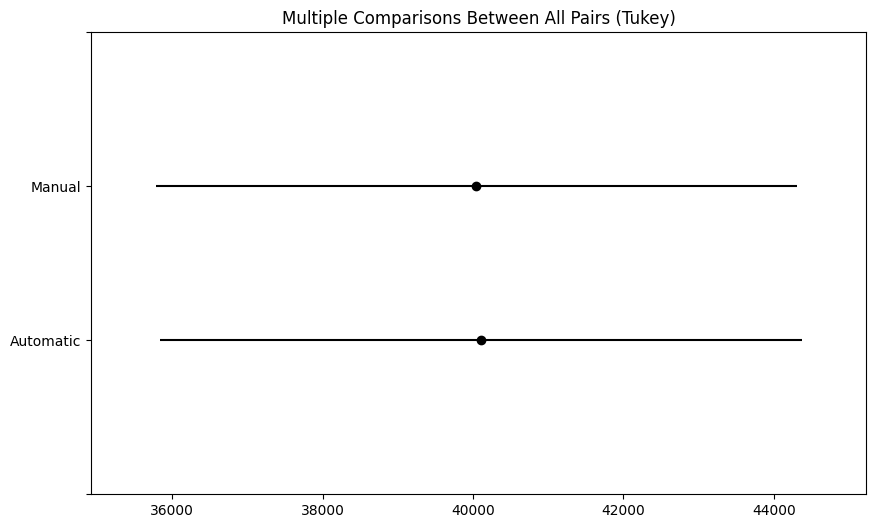

In [ ]:
eda_helper.numerical_vs_categorical_hypothesis_test(df,'Price','Transmission')

----
# **Clean_Title : Whether to keep or not**

`Problem`:
- Data is highly imbalanced with more than 99% of car have clean_title, hence will try to see whether it is useful or not.

`Solution`:
- We can't drop this column, as this column have `good relation with price column`.
- I was thinking that `Clean Title` and `Accidents_Or_Damage` will have very strong inverse relation, but I was wrong, because this two there are around 50k cars which do not have `Clean Title` but also never get `accidents or damage`, Few Possible reason can be -

  - `Stolen/recovered` : branded salvage.

  - `Odometer issues` : not actual mileage.

  - `Flood/hail/fire risk` : branded even if no visible damage.

  - `Commercial use` (rental, taxi, police) : branded title.
Hence we can't say that both column convey same information (to drop Clean_Title column).


`Impact`:
- No changes are made, as all `evidence` are against dropping the column.

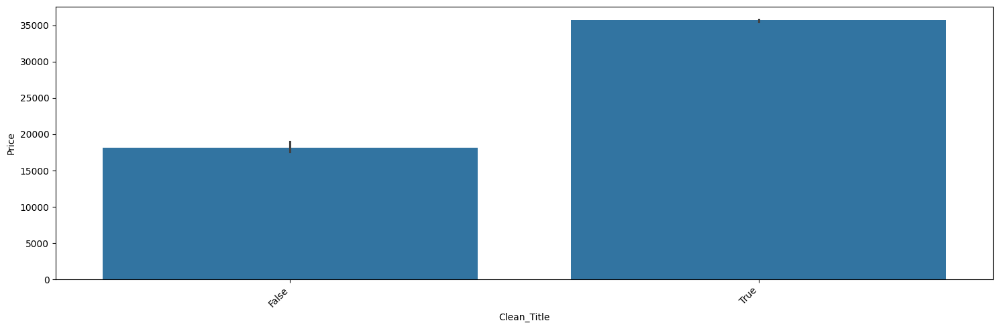

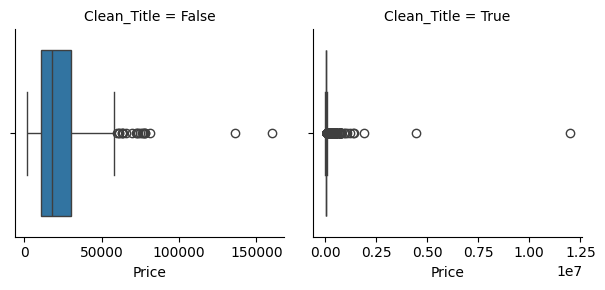

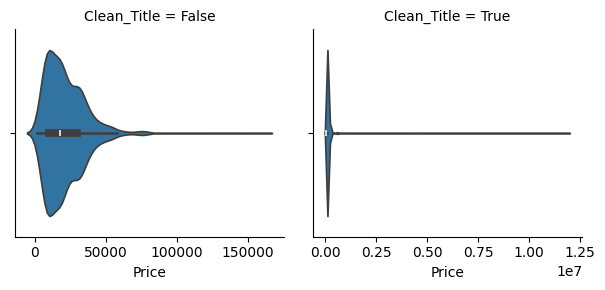

In [ ]:
eda_helper.num_cat_bivariate_plots(df,'Clean_Title','Price',bar_estimator=np.median)

In [ ]:
# price justified because of brand

df[(df['Clean_Title'] == False) & (df['Price'] > 100000)]

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,Postal_Code
221967,1987,Porsche,911 Cabriolet Turbo,['https://platform.cstatic-images.com/xlarge/i...,Used,32000.0,160000.0,0,Fair,gray,blue,RWD,0.0,Gasoline,Automatic,False,False,one,yes,NaN,NaN,NaN,NaN,NaN,classic auto sales,3.9,141.0,http://classicautosales.com/?utm_source=cars.c...,5.0,1.0,5,3.2,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,10848 Blondo St,Omaha,NE,68164.0
260291,2023,Porsche,911 Targa 4S,['https://platform.cstatic-images.com/xlarge/i...,Used,3638.0,135990.0,6000,Good,gray,NaN,AWD,20.0,Gasoline,Automatic,False,False,more,yes,NaN,NaN,NaN,NaN,NaN,sport cars lux,3.5,81.0,https://www.sportcarslux.com/?utm_source=cars....,5.0,1.0,NaN,3.0,NaN,NaN,<NA>,<NA>,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,<NA>,<NA>,True,True,True,<NA>,<NA>,NaN,NaN,NaN,NaN,2650 Northeast 189th Street,Miami,FL,33180.0


----------------
Significance level : 5.0 %
Null Hypothesis : All Groups have equal variances.
Alternate Hypothesis : At least one group has different variance.
Test Statistic : 44.69280666626926
Pvalue : 2.309509253506969e-11
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Variances between groups are not equal.


---------------------
Significance level : 5.0%
Null Hypothesis : All Group means are equal.
Alternate Hypothesis : One or more Group mean is different
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Atleast one group mean is different


--------------------------------------

    Multiple Comparison of Means - Tukey HSD, FWER=0.05    
group1 group2  meandiff  p-adj   lower      upper    reject
-----------------------------------------------------------
 False   True 18349.9164   0.0 16294.7408 20405.0921   True
-----------------------------------------------------------




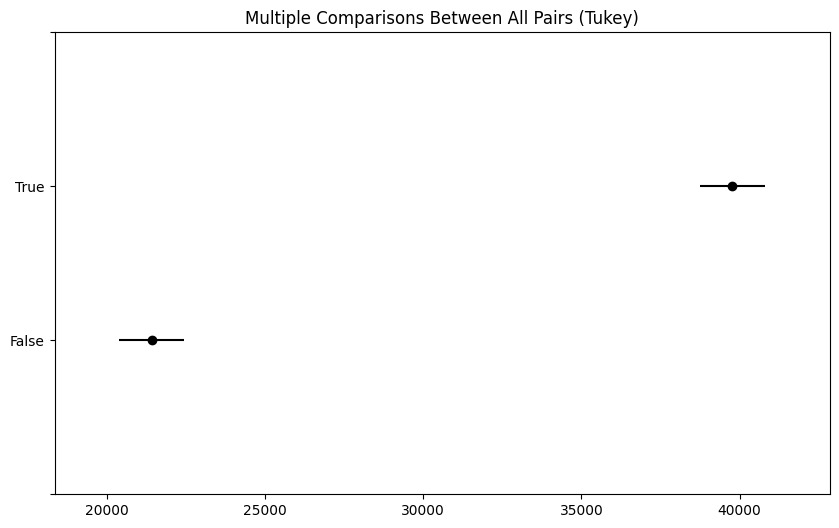

In [ ]:
eda_helper.numerical_vs_categorical_hypothesis_test(df,'Price','Clean_Title')

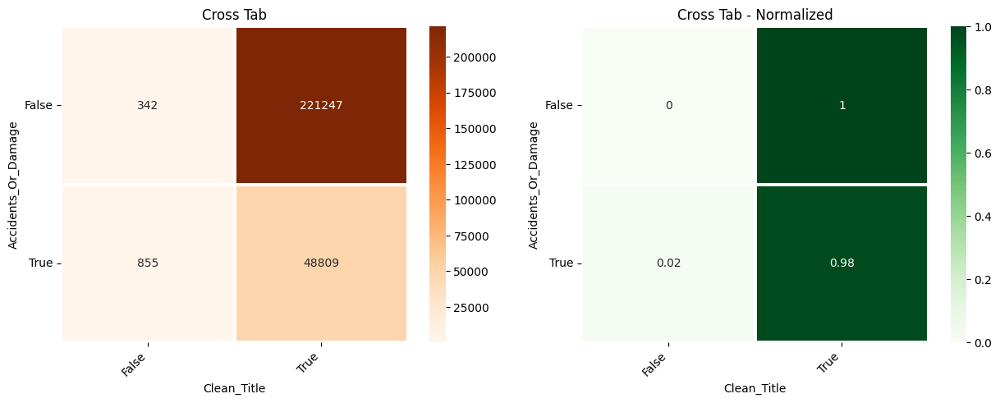

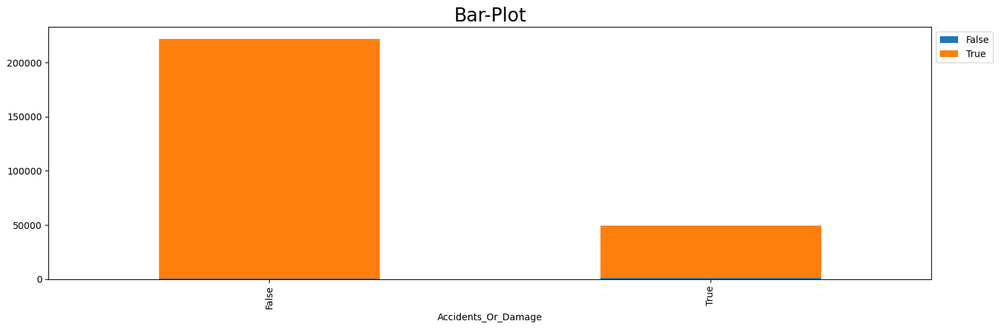

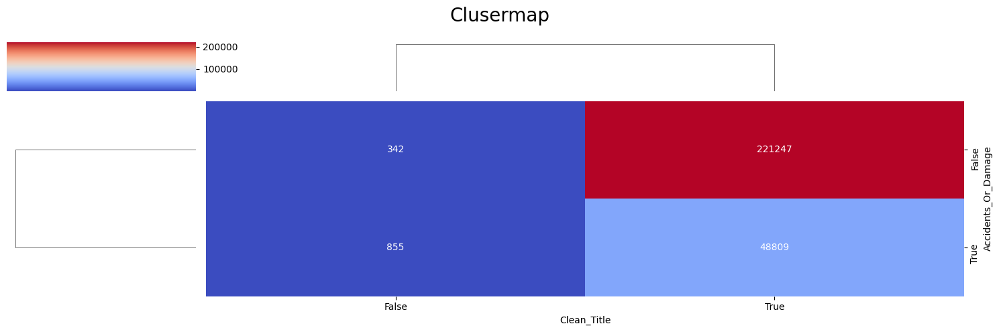

In [ ]:
# am I getting the same info with the Accidents_Or_Damage col, if yes we can still consider dropping this column

eda_helper.categorical_bivariate_plots(df,'Accidents_Or_Damage','Clean_Title')

----
# **Level2_Charging, Dc_Fast_Charging & Battery_Capacity: Outlier Check**

`Problem`:
- Just to check the Potential Outliers.

`Solution`:
- Both column contains some extreme values which are natural variation, few cars take very less time to charge and few take very long because either they are getting older or they have huge battery.

`Impact`:
- No transformation needed.

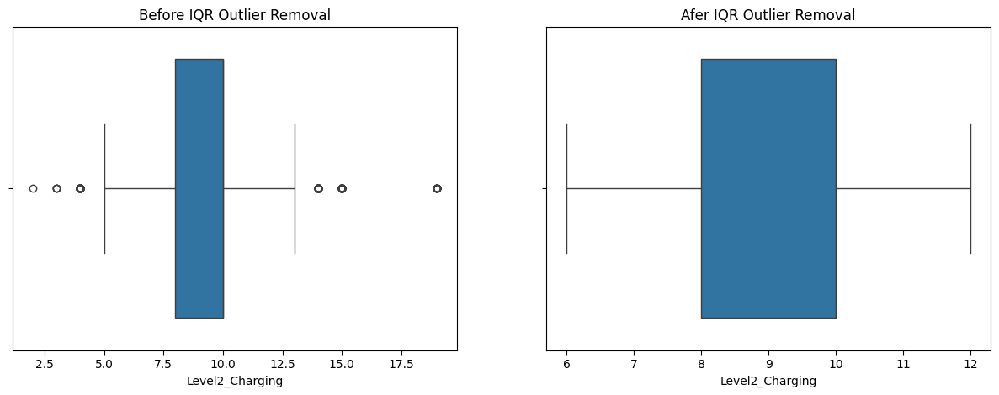

Model_Name Level2_Charging       
                                        count            mean median
Model_Name                                                          
330e iPerformance                           1        2.000000    2.0
F-150 Lightning Flash                      33       13.878788   14.0
F-150 Lightning LARIAT                     55       15.400000   14.0
F-150 Lightning Platinum                   14       16.142857   16.5
F-150 Lightning Pro                         8       14.625000   14.0
F-150 Lightning XLT                        16       14.625000   14.0
Focus S                                     1        4.000000    4.0
Focus SE                                    5        3.400000    3.0
Leaf 4dr HB S                               1        4.000000    4.0
Leaf S                                      4        4.000000    4.0
Leaf SL                                     7        4.428571    4.0
Leaf SV                                     9        4.333333    4.0
Model S Base                               17       15.000000   15.0
Model S Dual Motor All-Wheel Drive          2       15.000000   15.0
Model S Long Range                         11       15.000000   15.0
Model S Long Range Plus                     2       15.000000   15.0
Model S Plaid                              36       15.000000   15.0
Model S Standard Range                      5       15.000000   15.0
Volt Base                                  32        4.000000    4.0
i3 94 Ah                                   10        4.000000    4.0
i3 94 Ah w/Range Extender                   7        4.000000    4.0
i3 94Ah s                                   1        4.000000    4.0
i3 94Ah s w/Range Extender                  3        4.000000    4.0
i3 Base                                    10        4.000000    4.0
i3 Base w/Range Extender                   15        4.000000    4.0

In [ ]:
# justified either by huge battery or older version take more time.

level2_outliers = eda_helper.boxplot_outlier(df,'Level2_Charging')

level2_outliers.groupby('Model_Name').agg(
    {
        'Model_Name' : 'count',
        'Level2_Charging' : ['mean','median']
    }
)

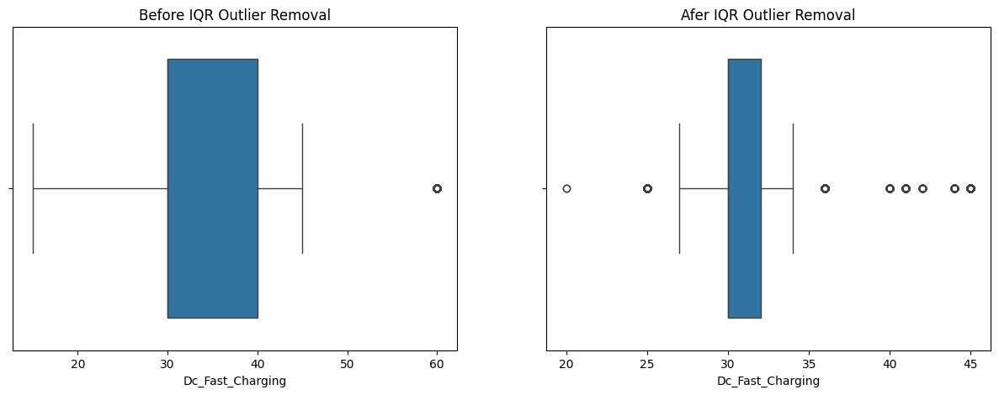

In [ ]:
dc_charging_outlier = eda_helper.boxplot_outlier(df,'Dc_Fast_Charging')

In [ ]:
# justified values

dc_charging_outlier.groupby('Model_Name').agg(
    {
        'Model_Name' : 'count',
        'Dc_Fast_Charging' : ['mean','median']
    }
)

Model_Name Dc_Fast_Charging       
                         count             mean median
Model_Name                                            
Bolt EV 1LT                 17             60.0   60.0
Bolt EV 2LT                  3             60.0   60.0
Bolt EV FWD 1LT             88             60.0   60.0
Bolt EV FWD 2LT             13             60.0   60.0
Bolt EV FWD LT              45             60.0   60.0
Bolt EV FWD Premier         14             60.0   60.0
Bolt EV LT                  52             60.0   60.0
Bolt EV Premier             38             60.0   60.0
Transit-350 Base             4             15.0   15.0

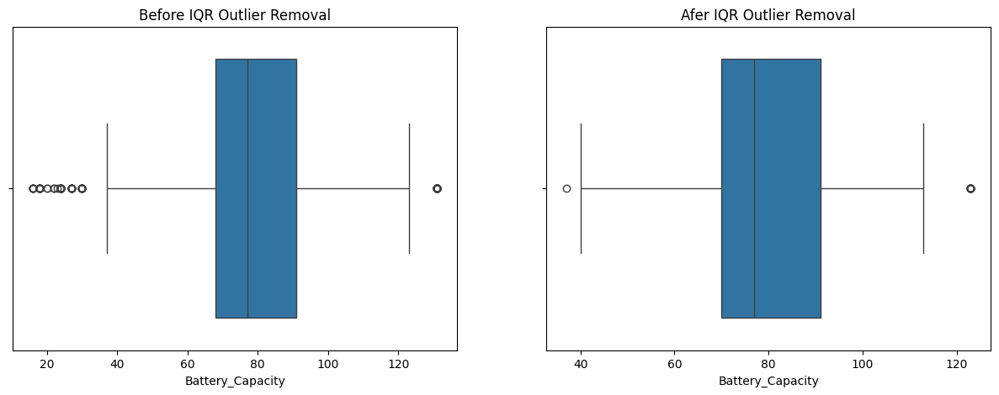

In [ ]:
battery_capacity_outliers = eda_helper.boxplot_outlier(df,'Battery_Capacity')

In [ ]:
# justified

battery_capacity_outliers.groupby('Model_Name').agg(
    {
        'Model_Name' : 'count',
        'Battery_Capacity' : ['mean','median']
    }
)

Model_Name Battery_Capacity       
                                count             mean median
Model_Name                                                   
F-150 Lightning Flash               4       131.000000  131.0
F-150 Lightning LARIAT             37       131.000000  131.0
F-150 Lightning Platinum           14       131.000000  131.0
F-150 Lightning Pro                 3       131.000000  131.0
F-150 Lightning XLT                 2       131.000000  131.0
Focus S                             1        23.000000   23.0
Leaf 4dr HB S                       1        24.000000   24.0
Leaf 4dr HB S *Ltd Avail*           1        24.000000   24.0
Leaf S                             23        25.565217   24.0
Leaf SL                            16        25.125000   24.0
Leaf SV                            23        26.608696   24.0
Volt Base                           8        16.000000   16.0
i3 94 Ah                           10        27.000000   27.0
i3 94 Ah w/Range Extender           7        27.857143   27.0
i3 94Ah s                           1        30.000000   30.0
i3 94Ah s w/Range Extender          3        27.000000   27.0
i3 Base                            10        18.000000   18.0
i3 Base w/Range Extender           15        19.066667   18.0

----
# **Expected_Range: Transformation & Outlier Detection**

`Problem`:
- This column have most of the values for electric vehicles only, and very less value for non-electric vehicles (why?).

`Solution`:

> Cleaning

- All those car which do not have `Fuel_Type` information but have `expected range` value (except `volt` models and `i3 Base w/Range Extender` which are `plugin hybrid`) are `electric cars`.

- Flow Chart will be
  - **Electric Car?**
    - **Yes** → Keep as Electric
    - **No**
      - **Has Expected Range info?**
        - **Yes** → Mark as Electric  
          - **Model = Volt Base OR i3 Base w/Range Extender?**
            - **Yes** → Keep as Hybrid (PHEV)  
            - **No** → Electric
        - **No** → Keep original Fuel Type

- After this correction, in `Non-Electric` cars we are left with neglible amount of `Expected Range` info, hence we can set those value to `np.nan`.

- For `Electric-cars`, I have analyzed the `extreme values`, and found that those values are `natural variation` of data, either the car have huge battery size that's why they have large range, or car got years older which reduced their range.

- No `Transformation` is applied as data is close to normal, I tried to apply np.square and power transformation to make it more symatric, but no changes get reflected.

`Impact`:
- Assigned corrected `Fuel_Type` to few null values, so that model can learn better.

- Because of either Volt Base OR i3 Base w/Range Extender, I got some values in columns like `Expected_Range`, `Dc_Fast_Charging` and `Level2_Charging` for *Non-Electric* cars, which is almost close to zero as this columns are not defined for any other Non-Electric car, hence we can consider converting this value to np.nan, (decided in experiment tracking phase).

- Convert values from `Mileage` to `KM` for better understanding.

In [ ]:
electric_df = df.query('Fuel_Type == "Electric"').copy()
non_electric_df = df.query('Fuel_Type != "Electric"').copy()

In [ ]:
eda_helper.numerical_summary(electric_df['Expected_Range'])

,Expected_Range
0,290.0
260,239.5
322,262.0
339,318.5
341,225.0
...,...
270609,NaN
270623,NaN
270746,267.5
270898,NaN


Data Type : float64
Missing Data : 717 (18.01 %)
Available Data : 3265 / 3982


,Expected_Range
0.01,61.0
0.05,155.5
0.10,214.5
0.25,239.0
0.50,262.0
0.75,286.5
0.90,316.5
0.95,329.5
0.99,371.5
1.00,389.0


,value
Mean,258.54
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,262.00


,value
Std,51
Varience,"2,550"
IQR,48


,value
Skewness,-1
Kurtosis,4


In [ ]:
eda_helper.numerical_summary(non_electric_df['Expected_Range'])

,Expected_Range
1,NaN
2,NaN
3,NaN
4,NaN
5,NaN
...,...
271248,NaN
271249,NaN
271250,NaN
271251,NaN


Data Type : float64
Missing Data : 266110 (99.57 %)
Available Data : 1161 / 267271


,Expected_Range
0.01,68.2
0.05,152.5
0.10,207.0
0.25,225.0
0.50,254.0
0.75,274.5
0.90,308.0
0.95,339.5
0.99,371.5
1.00,376.0


,value
Mean,251.61
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,254.00


,value
Std,53
Varience,"2,837"
IQR,50


,value
Skewness,-1
Kurtosis,2


## *Correcting Fuel_Type information Based on Expected_Range.*

In [ ]:
# except volt models and i3 Base w/Range Extender which are plugin hybrid, all other are electric cars

non_electric_df.dropna(subset=['Expected_Range'])['Model_Name'].value_counts().index

Index(['Model 3 Long Range', 'Mustang Mach-E GT',
       'Model Y Long Range Dual Motor All-Wheel Drive',
       'Mustang Mach-E Premium', 'ID.4 Pro S', 'Mustang Mach-E Select',
       'Model 3 Standard Range', 'Model 3 Standard Range Plus',
       'Model Y Long Range', 'Leaf S',
       'Model Y Performance Dual Motor All-Wheel Drive', 'Leaf SV PLUS',
       'ID.4 Pro', 'Model 3 Performance', 'ID.4 AWD Pro S', 'ID.4 S',
       'Leaf S 40 kWh', 'Model S Plaid', 'Bolt EV Premier',
       'Model Y Performance', 'Leaf SV', 'Model 3 Mid Range', 'Model 3 Base',
       'Model S Long Range', 'Volt Base', 'Bolt EV LT',
       'Mustang Mach-E California Route 1', 'Bolt EV FWD 1LT', 'Model S 100D',
       'Bolt EV FWD Premier', 'Leaf SL', 'Bolt EV FWD LT', 'Model S 90D',
       'Model S Performance', 'Model S 75', 'Model S 75D',
       'F-150 Lightning XLT', 'ID.4 Standard', 'F-150 Lightning Platinum',
       'Model 3', 'ID.4 AWD Pro', 'Model S Long Range Plus', 'Bolt EV FWD 2LT',
       'F-150 L

In [ ]:
# plug-in hybrid.

df[df['Model_Name'].str.contains('Volt')].shape

(181, 83)

In [ ]:
# is also plugin hybrid

df[df['Model_Name'] == 'i3 Base w/Range Extender'].shape

(18, 83)

In [ ]:
expected_range_corrected_df = df.assign(
    Fuel_Type = lambda df_ : (
        np.where(
                (df_['Model_Name'].str.contains('Volt') | df_['Model_Name'] == "i3 Base w/Range Extender"),
                'Plug-in Hybrid',
                 np.where(df_['Expected_Range'].notna(),
                             'Electric',
                             df_['Fuel_Type']))
                              ),
    Expected_Range = lambda df_ : (
        df_
        .Expected_Range
        .mul(1.609)
        .round(1)
    )
    )

In [ ]:
electric_cleaned_expected_range_df = expected_range_corrected_df[expected_range_corrected_df['Fuel_Type'] == 'Electric']
eda_helper.numerical_summary(electric_cleaned_expected_range_df['Expected_Range'])

,Expected_Range
0,466.6
122,567.2
260,385.4
278,360.4
322,421.6
...,...
270746,430.4
270831,597.7
270898,NaN
271061,360.4


Data Type : float64
Missing Data : 717 (13.94 %)
Available Data : 4426 / 5143


,Expected_Range
0.01,99.0
0.05,247.2
0.10,336.7
0.25,380.5
0.50,420.8
0.75,458.6
0.90,502.4
0.95,531.8
0.99,597.7
1.00,625.9


,value
Mean,413.07
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,420.80


,value
Std,83
Varience,"6,820"
IQR,78


,value
Skewness,-1
Kurtosis,3


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


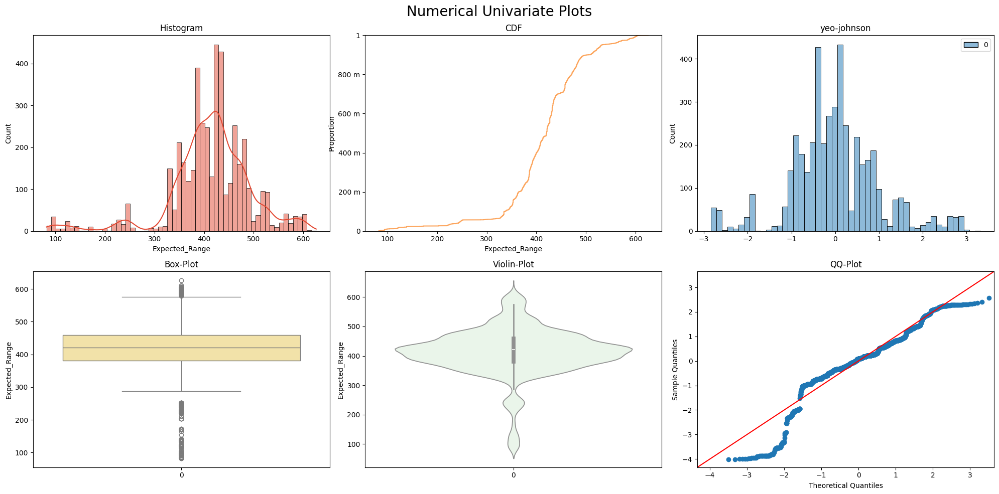

In [ ]:
eda_helper.numerical_univariate_plots(electric_cleaned_expected_range_df['Expected_Range'])

## *Checking for Potential Outliers.*

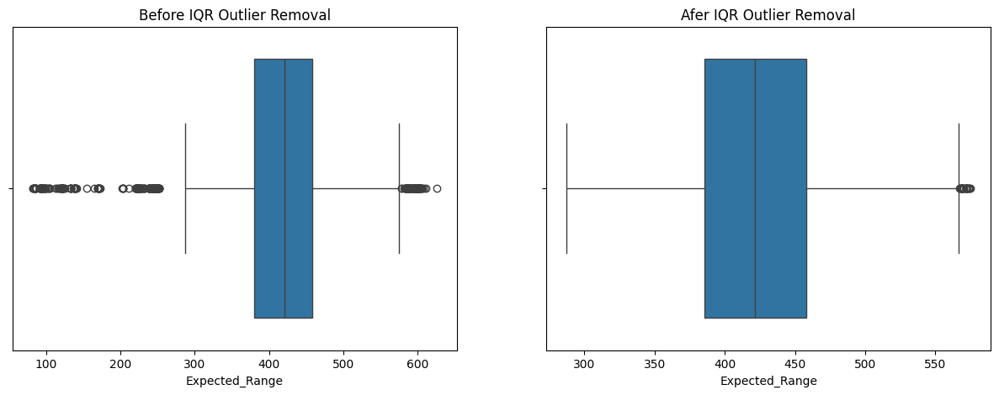

In [ ]:
expected_range_outliers = eda_helper.boxplot_outlier(electric_cleaned_expected_range_df,'Expected_Range')

In [ ]:
# justifed numbers.

expected_range_outliers.groupby(['Model_Name']).agg(
    {
        'Expected_Range' : ['count','mean']
    }
)

Expected_Range            
                                            count        mean
Model_Name                                                   
Leaf 4dr HB S                                   1  120.700000
Leaf 4dr HB S *Ltd Avail*                       1  123.900000
Leaf S                                         82  191.096341
Leaf S 40 kWh                                  34  244.488235
Leaf S Hatchback                                1  245.400000
Leaf S Hatchback 4D                             1  242.200000
Leaf SL                                        29  130.165517
Leaf SL 4dr Hatchback                           1  121.500000
Leaf SV                                        56  170.512500
Leaf SV 40 kWh                                  8  239.950000
Leaf SV 4dr Hatchback                           1  233.300000
Leaf SV Hatchback 4D                            1  230.100000
Model S Base                                   18  594.255556
Model S Dual Motor All-Wheel Drive              2  597.750000
Model S Long Range                             20  591.235000
Model S Long Range Plus                        14  587.128571
Model S Plaid                                   9  582.300000
Model S Standard Range                          5  599.180000
Transit-350 Base                                4  233.325000
Volt Base                                      46  600.215217
i3 94 Ah                                       11  170.200000
i3 Base                                        14   99.114286
i3 Base w/Range Extender                        8  179.887500

In [ ]:
df['Model_Name'].value_counts()

,count
Model_Name,
F-150 XLT,4829
Transit-250 Base,3974
X5 xDrive40i,2595
Corolla LE,2593
Edge SEL,2578
...,...
S-Class 4dr Sdn 5.5L V8 RWD With Brabus Kit,1
Traverse LS W/1LS,1
Prius PERSONA SERIES,1


----
# **Engine_Size : Outlier Detection & Binning**

`Problem`:
- Few `Electric` cars have Not null Engine_Size values which is not possible, because `Electric` car can't have ICE (Internal Combution Engine)

- Contains Potential Outliers.

- Binning or rounding of the value, if changes in decimal values does not cause any difference.

`Solution`:
- Electric cars which have `Engine_Size` values are wrong entries, either they are purly electric in that case I will remove `Engine_Size` value to np.nan, or they are `Plugin Hybrid` Vehicles, in that case I will change `Fuel_Type` to `Plugin Hybrid`.

- Some values are huge, more than `60L engine`, which is not possible, (again gathering domain knowledge), hence will convert those value to np.nan.

- After applying anova, I found that `values with small variation` in decimal places do no have huge difference in price, but I also come to know that I can create some other feature with `Engine_Size` column, like `CC` &  `per cylinder volume`, hence I am not rounding off the value so that I can make new feature with precision.

`Impact`:
- Cleaned the values and outlier values, which can prevent the model from learning unuseful pattern.

- Dropping the idea of binning as this column can in creation of other columns.



  

In [ ]:
eda_helper.cat_summary(df['Engine_Size'])

,Engine_Size
0,NaN
1,2
2,5.0
3,6.2
4,2.0
...,...
271248,2.4
271249,3.6
271250,3
271251,2


Data Type : object
No. of unique value : 74
Missing Rows : 13668 (5.04 %)
Available Data : 257585 / 271253 rows


,Engine_Size
count,257585
unique,74
top,3.5
freq,34604


,count,proportion
Engine_Size,,
3.5,34604,13.434
2.5,33904,13.162
3.6,28240,10.963
2,27969,10.858
1.5,18990,7.372
6.6,16178,6.281
2.0,15602,6.057
5.3,8033,3.119
2.3,7088,2.752


None

## *Cleaning Engine_Size*

In [ ]:
# 330e iPerformance is Plugin Hybrid vehicle not a electric vehicle.
# all car (other than 330e iperformance) do not have ICE (engine_size)

electric_df[electric_df['Engine_Size'].notna()]['Model_Name'].value_counts()

,count
Model_Name,
Volt Base,13
ID.4 Pro S,10
F-150 Lightning XLT,5
i3 Base w/Range Extender,5
F-150 Lightning LARIAT,4
ID.4 1st Edition,3
Model 3 Standard Range,3
Model 3 Standard Range Plus,2
ID.4 Pro,2


In [ ]:
# wrong entries

df[df['Engine_Size'] > 20][['Model_Year','Fuel_Type','Brand_Name','Model_Name','Engine_Size','Valves','Cylinder_Config']]

,Model_Year,Fuel_Type,Brand_Name,Model_Name,Engine_Size,Valves,Cylinder_Config
15680,1970,NaN,Chevrolet,Camaro Base,350.0,NaN,V8
50209,2024,Electric,Volkswagen,ID.4 S,62.0,NaN,NaN
180041,1966,NaN,Ford,Mustang Base,289.0,NaN,NaN
193424,1965,NaN,Chevrolet,Malibu SS,327.0,NaN,V8
250382,2024,NaN,Volkswagen,ID.4 Standard,62.0,NaN,NaN


In [ ]:
# Q5 55 S line quattro Premium are plugin Hybrid,2L

zero_liter_engines = df[df['Engine_Size'] == 0]

zero_liter_engines

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
5902,2023,Subaru,Forester 2.5i Limited,['https://platform.cstatic-images.com/xlarge/i...,Certified,22552.0,30476.0,0,Good,black,black,AWD,13.0,NaN,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,haldeman subaru,4.2,1504.0,https://www.haldemansubaru.com/?utm_source=car...,4.9,20.0,NaN,0.0,NaN,NaN,True,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,1207 US-130,Robbinsville,NJ,8691.0
7755,2023,Volkswagen,ID.4 Pro S,['https://platform.cstatic-images.com/xlarge/i...,Used,25695.0,25591.0,0,Fair,gray,black,RWD,NaN,Electric,Automatic,True,True,one,yes,NaN,7.0,30.0,77.0,268.0,spitzer volkswagen amherst,5.0,235.0,https://www.spitzervw.com/?utm_source=cars.com...,4.5,13.0,1,0.0,NaN,NaN,True,<NA>,True,True,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,True,True,True,True,<NA>,49.0,42.0,NaN,NaN,160 N Leavitt Rd,Amherst,OH,44001.0
13157,2024,Dodge,Charger R/T,['https://platform.cstatic-images.com/xlarge/i...,New,1754.0,45750.0,0,NaN,white,black,AWD,NaN,Electric,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,10.0,32.0,93.0,NaN,coughlin marysville chrysler jeep dodge ram,2.8,149.0,https://www.coughlinchrysler.com?utm_source=ca...,NaN,NaN,NaN,0.0,NaN,NaN,True,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,True,True,True,True,True,True,<NA>,True,True,<NA>,39.0,34.0,NaN,NaN,15777 Watkins Rd,Marysville,OH,43040.0
14235,2022,Ford,Mustang Mach-E GT,['https://platform.cstatic-images.com/xlarge/i...,Used,59383.0,29600.0,0,Fair,black,gray,AWD,NaN,Electric,Automatic,False,True,one,yes,yes,10.0,45.0,91.0,261.0,coughlin ford of pataskala,0.0,237.0,https://www.coughlinpataskalaford.com/?utm_sou...,5.0,6.0,NaN,0.0,NaN,NaN,True,<NA>,True,True,True,True,True,<NA>,True,<NA>,True,<NA>,<NA>,True,True,True,True,True,True,True,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,True,True,True,<NA>,True,<NA>,37.0,32.0,103,Outstanding,9800 WORTHINGTON Rd.,PATASKALA,OH,43062.0
16758,2022,Subaru,Forester Wilderness,['https://platform.cstatic-images.com/xlarge/i...,Used,34838.0,29534.0,612,Fair,gray,gray,AWD,11.0,NaN,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,team nissan,5.0,129.0,https://www.teamnissannh.com/?utm_source=cars....,4.9,14.0,NaN,0.0,NaN,NaN,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<N

In [ ]:
# all of this are 2.5L engine cars, (Gasoline)

zero_liter_engines[zero_liter_engines['Model_Name'].str.contains('Forester')]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
5902,2023,Subaru,Forester 2.5i Limited,['https://platform.cstatic-images.com/xlarge/i...,Certified,22552.0,30476.0,0,Good,black,black,AWD,13.0,NaN,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,haldeman subaru,4.2,1504.0,https://www.haldemansubaru.com/?utm_source=car...,4.9,20.0,NaN,0.0,NaN,NaN,True,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,1207 US-130,Robbinsville,NJ,8691.0
16758,2022,Subaru,Forester Wilderness,['https://platform.cstatic-images.com/xlarge/i...,Used,34838.0,29534.0,612,Fair,gray,gray,AWD,11.0,NaN,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,team nissan,5.0,129.0,https://www.teamnissannh.com/?utm_source=cars....,4.9,14.0,NaN,0.0,NaN,NaN,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,70 Keller St,Manchester,NH,3103.0
32958,2023,Subaru,Forester 2.5i Sport,['https://platform.cstatic-images.com/xlarge/i...,Used,87329.0,22517.0,732,Fair,white,gray,AWD,13.0,NaN,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,subaru of pembroke pines,5.0,29.0,https://www.subaruofpembrokepines.com/?utm_sou...,4.9,20.0,NaN,0.0,NaN,NaN,True,<NA>,True,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,16100 Pines Blvd,Pembroke Pines,FL,33027.0
34804,2023,Subaru,Forester Wilderness,['https://platform.cstatic-images.com/xlarge/i...,Certified,3657.0,34950.0,0,Good,white,gray,AWD,11.0,NaN,Automatic,True,True,one,no,NaN,NaN,NaN,NaN,NaN,wayne subaru,4.9,1701.0,https://waynesubaru.com?utm_source=cars.com&ut...,4.9,20.0,NaN,0.0,NaN,NaN,True,<NA>,True,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,600 Route 23 North,Pequannock Township,NJ,7444.0
37114,2023,Subaru,Forester Wilderness,['https://platform.cstatic-images.com/xlarge/i...,Used,58864.0,27916.0,886,Great,white,gray,AWD,11.0,NaN,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,darrell waltrip subaru,0.0,140.0,https://www.darrellwaltripsubaru.com?utm_sourc...,4.9,20.0,NaN,0.0,NaN,NaN,True,<NA>,True,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,True,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,<NA>,True,<NA>,True,<NA>,<NA>,NaN,NaN,NaN,NaN,1450 Murfreesboro Rd,Franklin,TN,37067.0
39486

## *Can We apply binning ?*

----------------
Significance level : 5.0 %
Null Hypothesis : All Groups have equal variances.
Alternate Hypothesis : At least one group has different variance.
Test Statistic : 192.213004662434
Pvalue : 0.0
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Variances between groups are not equal.


---------------------
Significance level : 5.0%
Null Hypothesis : All Group means are equal.
Alternate Hypothesis : One or more Group mean is different
Since Pvalue is more than 0.05, we Failed to reject Null Hypothesis
CONCLUSION : All group means are Equal


/usr/local/lib/python3.12/dist-packages/numpy/_core/fromnumeric.py:4008: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.12/dist-packages/numpy/_core/_methods.py:210: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.12/dist-packages/scipy/stats/_stats_py.py:4026: RuntimeWarning: divide by zero encountered in divide
  np_vecdot(1 / (n_t - 1), (1 - w_t / s_w_t)**2, axis=0)
/usr/local/lib/python3.12/dist-packages/scipy/stats/_stats_py.py:4038: RuntimeWarning: divide by zero encountered in divide
  (3 * np_vecdot(1 / (n_t - 1), (1 - w_t / s_w_t)**2, axis=0))


--------------------------------------

      Multiple Comparison of Means - Tukey HSD, FWER=0.05       
group1 group2   meandiff  p-adj     lower        upper    reject
----------------------------------------------------------------
   0.0   0.65 -17566.4621    1.0  -64484.7417  29351.8175  False
   0.0    1.0 -19719.7035 0.8288  -47678.1665   8238.7594  False
   0.0    1.3 -22520.3621    1.0 -160722.1394 115681.4153  False
   0.0    1.4 -21919.0021 0.9127  -54702.6037  10864.5996  False
   0.0    1.5  -5557.2817    1.0  -23577.3741  12462.8106  False
   0.0    1.6 -19622.2946 0.0264  -38474.0055   -770.5838   True
   0.0    1.7 -23687.6594 0.4206  -52517.9196   5142.6009  False
   0.0    1.8  -16320.732 0.1912  -34457.3901   1815.9262  False
   0.0    2.0   3986.9386    1.0  -14017.4881  21991.3654  False
   0.0    2.1 -14792.2192    1.0  -69619.3199  40034.8815  False
   0.0    2.2  -9624.1803    1.0  -43934.2243  24685.8638  False
   0.0    2.3   5573.4258    1.0  -12492.5536  236

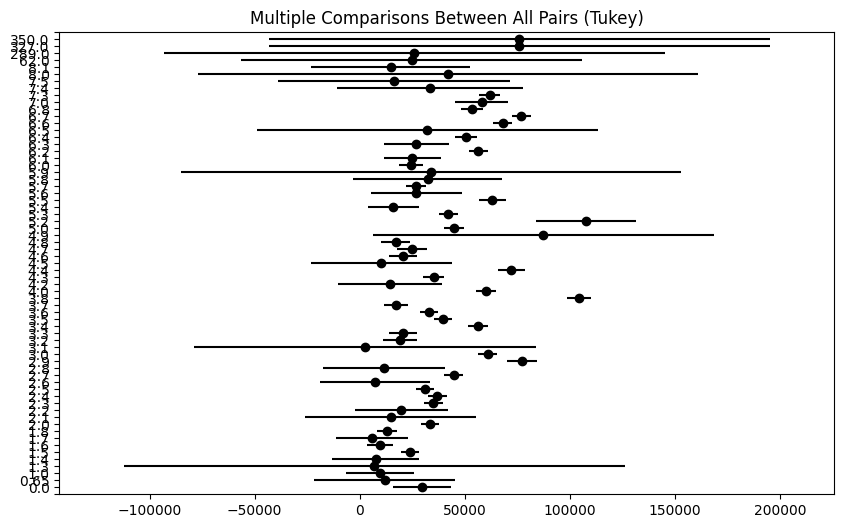

In [ ]:
eda_helper.numerical_vs_categorical_hypothesis_test(df,'Price','Engine_Size')

In [ ]:
df.assign(
    Fuel_Type = lambda df_ : (
        np.where(
            ((df_['Model_Name'] == '330e iPerformance') | (df_['Model_Name'] == 'Q5 55 S line quattro Premium')),
            "Plugin Hybrid",
            df_['Fuel_Type']
            )
        ),

    Engine_Size = lambda df_ : (
       np.where(
           (df_['Engine_Size'] > 60),
           np.nan,
           np.where(
               ((df_['Engine_Size'] == 0) & (df_['Model_Name'].str.contains('Forester'))),
               2.5,
               np.where(
                   ((df_['Engine_Size'] == 0) & (df_['Model_Name'] == 'Q5 55 S line quattro Premium')),
                   2.0,
                   np.where(
                       (df_['Engine_Size'] == 0),
                       np.nan,
                       np.where(
                           ((df_['Fuel_Type'] == "Electric") & (df_['Engine_Size'].notna())),
                           np.nan,
                           df_['Engine_Size']
                       )
                   )
               )
           )
       )
    )
)

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
0,2022,Ford,F-150 Lightning Platinum,['https://platform.cstatic-images.com/xlarge/i...,Used,27565.0,48500.0,0,Great,gray,gray,AWD,NaN,Electric,Automatic,False,True,one,no,NaN,19.0,41.0,131.0,290.0,dennis sneed ford,5.0,16.0,http://www.sneedford.com/?utm_source=cars.com&...,4.2,18.0,NaN,NaN,NaN,NaN,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,True,True,True,True,True,<NA>,True,True,<NA>,31.0,26.0,NaN,NaN,1046 SW US Highway 169,Gower,MO,64454.0
1,2025,Ford,Maverick XLT,['https://platform.cstatic-images.com/xlarge/i...,New,3.0,35285.0,0,NaN,gray,gray,AWD,11.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,bening ford of perryville,5.0,17.0,http://beningford.com/?utm_source=cars.com&utm...,4.7,3.0,NaN,2.0,I4,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,909 S Perryville Blvd,Perryville,MO,63775.0
2,2014,Ford,F-150 STX,['https://platform.cstatic-images.com/xlarge/i...,Used,117487.0,16998.0,0,Good,black,black,4WD,5.0,Flex Fuel,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,patriot motors,0.0,17.0,http://www.patriotmotorsrt5.com?utm_source=car...,4.7,304.0,6,5.0,V8,NaN,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,3306 State Rte 5,Cortland,OH,44410.0
3,2023,Chevrolet,Tahoe 4WD Z71,['https://platform.cstatic-images.com/xlarge/i...,Used,63052.0,54495.0,0,Good,black,black,4WD,7.0,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,granbury nissan,4.1,104.0,http://www.granburynissan.com/?utm_source=cars...,3.8,5.0,10,6.2,V8,NaN,True,<NA>,True,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,True,True,<NA>,True,True,True,True,True,True,True,True,True,True,True,<NA>,True,True,True,True,True,NaN,NaN,NaN,NaN,4601 E Hwy 377,Granbury,TX,76049.0
4,2024,Audi,Q5 45 S line quattro Premium,['https://platform.cstatic-images.com/xlarge/i...,Certified,9531.0,40204.0,124,Good,gray,black,AWD,11.0,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,harper audi,4.9,466.0,https://www.audiknoxville.com?utm_source=cars....,3.5,4.0,7,2.0,I4,16,True,<NA>,True,True,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,9735 Kingston Pike,Knoxville,TN,37922.0
...,...,...,..

----
# **Cylinder_Config: Cleaning Impossible Engine Configs**

`Problem`:
- Few cars have very unusual cylinder config, checking whether it is possible or not, example - V48.

`Solution`:
- Engine size like I16,V48 etc are not possible engine like this are used to run trains and ships, hence I am dropping those values.

- `Electric Cars` can't have cylinders, hence mapping those to np.nan.

In [ ]:
eda_helper.cat_summary(df['Cylinder_Config'])

,Cylinder_Config
0,NaN
1,I4
2,V8
3,V8
4,I4
...,...
271248,I4
271249,V6
271250,I6
271251,I4


Data Type : object
No. of unique value : 22
Missing Rows : 17876 (6.59 %)
Available Data : 253377 / 271253 rows


,Cylinder_Config
count,253377
unique,22
top,I4
freq,103298


,count,proportion
Cylinder_Config,,
I4,103298,40.768
V6,80413,31.737
V8,49450,19.516
I6,7828,3.089
I3,5340,2.108
H4,4273,1.686
H6,1760,0.695
I5,773,0.305
V2,92,0.036


None

In [ ]:
# electric car with cylinder config

df.query('Fuel_Type == "Electric"').info()

<class 'pandas.core.frame.DataFrame'>
Index: 3982 entries, 0 to 271095
Data columns (total 83 columns):
 #   Column                        Non-Null Count  Dtype   
---  ------                        --------------  -----   
 0   Model_Year                    3982 non-null   int64   
 1   Brand_Name                    3982 non-null   category
 2   Model_Name                    3982 non-null   object  
 3   Image_List                    3849 non-null   object  
 4   Stock_Type                    3982 non-null   category
 5   Mileage                       3982 non-null   float64 
 6   Price                         3932 non-null   float64 
 7   Price_Drop                    3982 non-null   int64   
 8   Deal_Type                     3374 non-null   category
 9   Exterior_Color                3884 non-null   category
 10  Interior_Color                3654 non-null   category
 11  Drivetrain                    3893 non-null   category
 12  Km/L                          0 non-null      float

In [ ]:
# H1 -> V8
# car at idx 7012 -> V6

df.assign(
    Cylinder_Config = lambda d : (
        np.select(
            [
                d['Cylinder_Config'].isin(['V32','V48','V45','I32','I24','I38','V21','I16']),
                d['Cylinder_Config'] == 'H1',
                (d['Model_Year'] == 2011) & (d['Model_Name'] == 'Wrangler Unlimited Sahara'), #idx 7012
                (d['Fuel_Type'] == 'Electric') #electric car can't have cylinder config
            ],
            [
                np.nan,
                'V8',
                'V6',
                np.nan
            ],
            default=d['Cylinder_Config']
        )
    )
)

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
0,2022,Ford,F-150 Lightning Platinum,['https://platform.cstatic-images.com/xlarge/i...,Used,27565.0,48500.0,0,Great,gray,gray,AWD,NaN,Electric,Automatic,False,True,one,no,NaN,19.0,41.0,131.0,290.0,dennis sneed ford,5.0,16.0,http://www.sneedford.com/?utm_source=cars.com&...,4.2,18.0,NaN,NaN,NaN,NaN,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,True,True,True,True,True,<NA>,True,True,<NA>,31.0,26.0,NaN,NaN,1046 SW US Highway 169,Gower,MO,64454.0
1,2025,Ford,Maverick XLT,['https://platform.cstatic-images.com/xlarge/i...,New,3.0,35285.0,0,NaN,gray,gray,AWD,11.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,bening ford of perryville,5.0,17.0,http://beningford.com/?utm_source=cars.com&utm...,4.7,3.0,NaN,2.0,I4,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,909 S Perryville Blvd,Perryville,MO,63775.0
2,2014,Ford,F-150 STX,['https://platform.cstatic-images.com/xlarge/i...,Used,117487.0,16998.0,0,Good,black,black,4WD,5.0,Flex Fuel,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,patriot motors,0.0,17.0,http://www.patriotmotorsrt5.com?utm_source=car...,4.7,304.0,6,5.0,V8,NaN,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,3306 State Rte 5,Cortland,OH,44410.0
3,2023,Chevrolet,Tahoe 4WD Z71,['https://platform.cstatic-images.com/xlarge/i...,Used,63052.0,54495.0,0,Good,black,black,4WD,7.0,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,granbury nissan,4.1,104.0,http://www.granburynissan.com/?utm_source=cars...,3.8,5.0,10,6.2,V8,NaN,True,<NA>,True,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,True,True,<NA>,True,True,True,True,True,True,True,True,True,True,True,<NA>,True,True,True,True,True,NaN,NaN,NaN,NaN,4601 E Hwy 377,Granbury,TX,76049.0
4,2024,Audi,Q5 45 S line quattro Premium,['https://platform.cstatic-images.com/xlarge/i...,Certified,9531.0,40204.0,124,Good,gray,black,AWD,11.0,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,harper audi,4.9,466.0,https://www.audiknoxville.com?utm_source=cars....,3.5,4.0,7,2.0,I4,16,True,<NA>,True,True,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,9735 Kingston Pike,Knoxville,TN,37922.0
...,...,...,..

----
# **Valves: Correction using Domain Knowledge**

`Problem`:
- Check whether information in this column is correct or not.

`Solution`:
- Few values like **2,4 valves** are not `Total Valves`, they are `Valve Per Cylinder` (VPC), hence converted them into total number of valves using this formula
  ```
  Total Valves = Cylinder Count X Valve Per Cylinder
  ```
- setting all Electric cars which have valve values to np.nan.


In [ ]:
df['Valves'].value_counts()

,count
Valves,
16,40680
24,28860
32,7392
12,2894
20,12
18,11
36,8
4,8
2,6


In [ ]:
# 36 -> 48
# 4 -> 32
# 2 -> 16
# 14134 idx -> np.nan

df[df['Valves'].isin(['8'])]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
81416,1985,Ford,Mustang SVO,['https://platform.cstatic-images.com/xlarge/i...,Used,59607.0,21387.0,2535,Fair,NaN,NaN,RWD,NaN,Gasoline,NaN,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,parks ford of wesley chapel,5.0,7.0,http://www.fordofwesleychapel.com?utm_source=c...,5.0,2.0,5,2.3,I4,8,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,28739 State Road 54,Wesley Chapel,FL,33543.0
177560,1984,Ford,Mustang SVO,['https://platform.cstatic-images.com/xlarge/i...,Used,62800.0,13999.0,0,Good,white,red,RWD,9.0,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,exotic car trader,4.2,10.0,https://www.exoticcartrader.com/?utm_source=ca...,4.0,2.0,5,2.3,I4,8,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1205 NE 9th Ave,Fort Lauderdale,FL,33304.0


In [ ]:
electric_df[electric_df['Valves'].notna()]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
874,2013,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,84633.0,6495.0,0,Great,silver,black,FWD,NaN,Electric,Automatic,True,True,one,no,NaN,4.0,NaN,NaN,370.5,showcase auto sales llc,2.2,17.0,http://www.showcaseautosalesllc.com?utm_source...,4.7,116.0,NaN,1.4,NaN,16,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,43.0,40.0,NaN,NaN,12750 Brady Rd,Chesaning,MI,48616.0
3100,2015,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,68111.0,11989.0,0,Fair,black,black,FWD,NaN,Electric,Automatic,False,True,one,yes,NaN,4.0,NaN,NaN,374.5,drum hill autos,4.2,40.0,https://drumhillautos.com/?utm_source=cars.com...,4.9,23.0,NaN,1.4,NaN,16,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,1184 Westford St,Lowell,MA,1851.0
68275,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,82089.0,8600.0,0,Good,white,beige,FWD,NaN,Electric,Automatic,False,True,more,yes,NaN,4.0,NaN,16.0,376.0,international auto,0.0,6.0,https://www.internationalautowholesale.com/?ut...,4.6,98.0,NaN,1.4,NaN,16,<NA>,<NA>,True,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,15.0,17.0,NaN,NaN,4960 Virginia Beach Blvd,Virginia Beach,VA,23462.0
137806,2015,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,200155.0,4995.0,0,Fair,silver,black,FWD,NaN,Electric,Automatic,True,True,more,yes,NaN,4.0,NaN,NaN,374.5,showcase auto sales llc,2.2,17.0,http://www.showcaseautosalesllc.com?utm_source...,4.9,23.0,NaN,1.4,NaN,16,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,12750 Brady Rd,Chesaning,MI,48616.0
175156,2017,BMW,330e iPerformance,['https://platform.cstatic-images.com/xlarge/i...,Used,140314.0,9995.0,0,Great,white,white,RWD,NaN,Electric,Automatic,True,True,more,yes,NaN,2.0,NaN,NaN,NaN,auto locators,0.0,9.0,http://www.autolocators1.net?utm_source=cars.c...,4.4,11.0,NaN,2.0,NaN,16,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,NaN,NaN,NaN,NaN,4116 Airport Hwy,Louisville,TN,37777.0
197423,2012,Chevrolet,Vol

In [ ]:
df.assign(
    Valves = lambda d : (
        np.select(
            [
                d['Valves'] == '36',
                d['Valves'] == '4',
                d['Valves'] == '2',
                d.index == 14134,
                d['Fuel_Type'] == 'Electric'
            ],

            [
                '48',
                '32',
                '16',
                np.nan,
                np.nan
            ],
            default=d['Valves']
        )
    )
)

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
0,2022,Ford,F-150 Lightning Platinum,['https://platform.cstatic-images.com/xlarge/i...,Used,27565.0,48500.0,0,Great,gray,gray,AWD,NaN,Electric,Automatic,False,True,one,no,NaN,19.0,41.0,131.0,290.0,dennis sneed ford,5.0,16.0,http://www.sneedford.com/?utm_source=cars.com&...,4.2,18.0,NaN,NaN,NaN,NaN,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,True,True,True,True,True,<NA>,True,True,<NA>,31.0,26.0,NaN,NaN,1046 SW US Highway 169,Gower,MO,64454.0
1,2025,Ford,Maverick XLT,['https://platform.cstatic-images.com/xlarge/i...,New,3.0,35285.0,0,NaN,gray,gray,AWD,11.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,bening ford of perryville,5.0,17.0,http://beningford.com/?utm_source=cars.com&utm...,4.7,3.0,NaN,2.0,I4,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,909 S Perryville Blvd,Perryville,MO,63775.0
2,2014,Ford,F-150 STX,['https://platform.cstatic-images.com/xlarge/i...,Used,117487.0,16998.0,0,Good,black,black,4WD,5.0,Flex Fuel,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,patriot motors,0.0,17.0,http://www.patriotmotorsrt5.com?utm_source=car...,4.7,304.0,6,5.0,V8,NaN,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,3306 State Rte 5,Cortland,OH,44410.0
3,2023,Chevrolet,Tahoe 4WD Z71,['https://platform.cstatic-images.com/xlarge/i...,Used,63052.0,54495.0,0,Good,black,black,4WD,7.0,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,granbury nissan,4.1,104.0,http://www.granburynissan.com/?utm_source=cars...,3.8,5.0,10,6.2,V8,NaN,True,<NA>,True,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,True,True,<NA>,True,True,True,True,True,True,True,True,True,True,True,<NA>,True,True,True,True,True,NaN,NaN,NaN,NaN,4601 E Hwy 377,Granbury,TX,76049.0
4,2024,Audi,Q5 45 S line quattro Premium,['https://platform.cstatic-images.com/xlarge/i...,Certified,9531.0,40204.0,124,Good,gray,black,AWD,11.0,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,harper audi,4.9,466.0,https://www.audiknoxville.com?utm_source=cars....,3.5,4.0,7,2.0,I4,16,True,<NA>,True,True,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,True,True,True,<NA>,NaN,NaN,NaN,NaN,9735 Kingston Pike,Knoxville,TN,37922.0
...,...,...,..

----
# **Km/L_e_City & Km/L_e_Hwy: Merging, Outlier Detection and Transformation**

`Problem`:
- Check whether we can merge this two columns.
- Outlier detection and removal if value is not justified.
- Transformation if needed (after outlier removal).

`Solution`:


*Whether Merging of this two column feasible?*

- `City Efficiency (km/L city)`: Is heavily influenced by regeneration (regenerative braking). EVs recover a significant amount of energy when slowing down in stop-and-go traffic.

- `Highway Efficiency (km/L hwy)`: Is primarily determined by aerodynamics and rolling resistance at constant, high speeds, with minimal opportunity for regeneration.

- `Conclusion`: The underlying mechanisms driving the energy consumption are different, meaning they measure two fundamentally different aspects of the vehicle's performance, hence we are not merging this two columns.

*OUTLIERS*
- All the outlier cars are volt base ev, because they are old, their range get reduced.

*Transformation*
- As Data is left skewed, hence I applied `Square` Tranformation and `Power Transformation` (box-cox & yeo-johnson) too, and found that Square Transformation is working almost comparable to Power transformation, hence I will apply square transformation here.


`Impact`:
- Still there is chance that merging of this two column have no impact on model performance, hence we will decide in `Experiment Tracking`.

- Outliers are natural variation of data, which can adversly impact the linear models.

- Used square transformation to reduce kurtosis and skewness (linear model can have possible impact)



## *Is Merging Possible?*

In [ ]:
# highly correlated

eda_helper.numerical_vs_numerical_hypothesis_testing(df.dropna(subset=['Km/L_e_City','Km/L_e_Hwy']),'Km/L_e_City','Km/L_e_Hwy')

Significance level : 5.0 %
Null Hypothesis : The Samples are not correlated.
Alternate Hypothesis : The Samples are correlated.
Test Statistic : 0.943177331798609
Pvalue : 0.0
Since Pvalue is less than 0.05, we reject the Null Hypothesis.
CONCLUSION: The Columns Km/L_e_City and Km/L_e_Hwy are correlated.


Significance level : 5.0 %
Null Hypothesis : The Samples are not correlated.
Alternate Hypothesis : The Samples are correlated.
Test Statistic : 0.9316947369987326
Pvalue : 0.0
Since Pvalue is less than 0.05, we reject the Null Hypothesis.
CONCLUSION: The Columns Km/L_e_City and Km/L_e_Hwy are correlated.


In [ ]:
eda_helper.numerical_summary(df['Km/L_e_City'])

,Km/L_e_City
0,31.0
1,NaN
2,NaN
3,NaN
4,NaN
...,...
271248,NaN
271249,NaN
271250,NaN
271251,NaN


Data Type : float64
Missing Data : 267661 (98.68 %)
Available Data : 3592 / 271253


,Km/L_e_City
0.01,31.0
0.05,37.0
0.10,39.0
0.25,44.0
0.50,51.0
0.75,56.0
0.90,59.0
0.95,60.0
0.99,64.0
1.00,64.0


,value
Mean,49.86
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,51.00


,value
Std,8
Varience,63
IQR,12


,value
Skewness,-1
Kurtosis,0


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


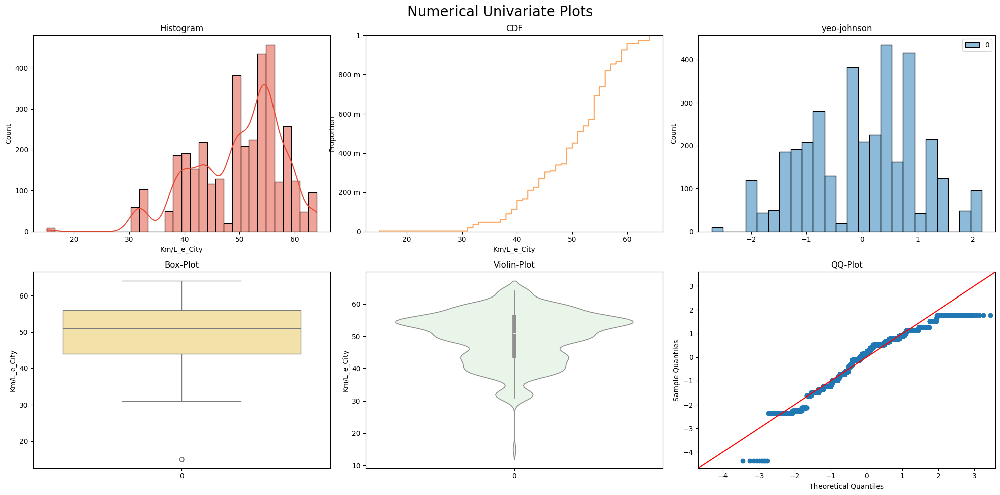

In [ ]:
eda_helper.numerical_univariate_plots(df['Km/L_e_City'])

In [ ]:
eda_helper.numerical_summary(df['Km/L_e_Hwy'])

,Km/L_e_Hwy
0,26.0
1,NaN
2,NaN
3,NaN
4,NaN
...,...
271248,NaN
271249,NaN
271250,NaN
271251,NaN


Data Type : float64
Missing Data : 267661 (98.68 %)
Available Data : 3592 / 271253


,Km/L_e_Hwy
0.01,26.0
0.05,32.0
0.10,36.0
0.25,40.0
0.50,45.0
0.75,50.0
0.90,54.0
0.95,54.0
0.99,57.0
1.00,57.0


,value
Mean,44.64
Trimmed Mean (5%),NaN
Trimmed Mean (10%),NaN
Median,45.00


,value
Std,7
Varience,53
IQR,10


,value
Skewness,-1
Kurtosis,0


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


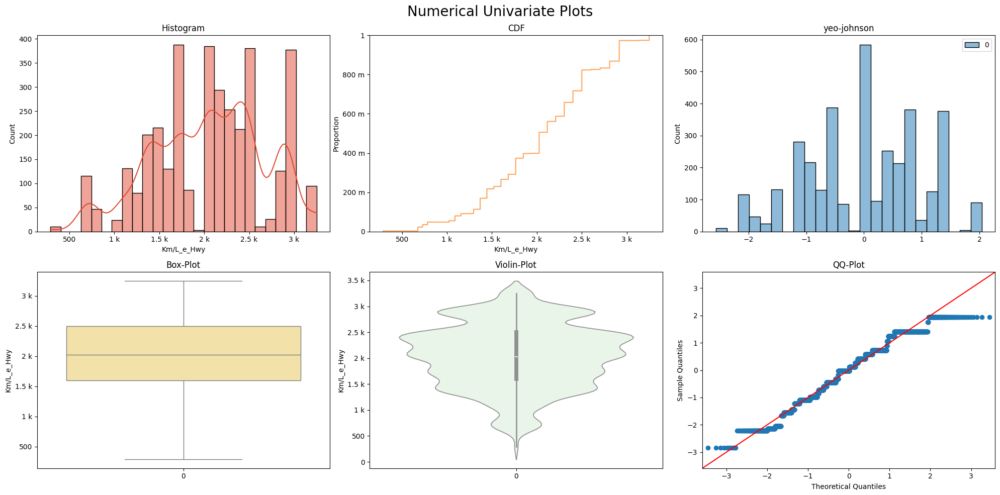

In [ ]:
eda_helper.numerical_univariate_plots(df['Km/L_e_Hwy'])

## *Outlier Analysis*

In [ ]:
# justified because of age
df[df['Km/L_e_City'] < 20]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
31814,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,137700.0,NaN,0,Good,gray,black,FWD,NaN,Electric,Automatic,False,True,one,no,NaN,4.0,NaN,NaN,373.5,green wave electric vehicles,5.0,6.0,https://www.greenwaveev.com?utm_source=cars.co...,4.6,98.0,NaN,1.4,I4,NaN,<NA>,<NA>,True,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,15.0,17.0,NaN,NaN,25 Lafayette Road,North Hampton,NH,3862.0
34775,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,92440.0,7500.0,342,Great,white,black,FWD,NaN,Electric,Automatic,False,True,more,no,NaN,4.0,NaN,NaN,373.5,mullinax ford of kissimmee,5.0,29.0,http://www.mullinaxfordkiss.com/?utm_source=ca...,4.6,98.0,1,NaN,NaN,NaN,<NA>,<NA>,True,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,15.0,17.0,NaN,NaN,1810 East Irlo Bronson Memorial Hwy,Kissimmee,FL,34744.0
44197,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,131903.0,5791.0,0,Great,gray,black,FWD,NaN,Electric,Automatic,True,True,more,no,NaN,4.0,NaN,NaN,372.5,ideal cars,4.4,480.0,https://www.idealcarsaz.com/?utm_source=cars.c...,4.6,98.0,NaN,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,15.0,17.0,NaN,NaN,837 W Main St,Mesa,AZ,85201.0
68275,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,82089.0,8600.0,0,Good,white,beige,FWD,NaN,Electric,Automatic,False,True,more,yes,NaN,4.0,NaN,16.0,376.0,international auto,0.0,6.0,https://www.internationalautowholesale.com/?ut...,4.6,98.0,NaN,1.4,NaN,16,<NA>,<NA>,True,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,15.0,17.0,NaN,NaN,4960 Virginia Beach Blvd,Virginia Beach,VA,23462.0
85244,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,142009.0,5995.0,0,Great,white,black,FWD,NaN,Electric,Automatic,False,True,more,yes,NaN,4.0,NaN,NaN,372.5,autospeed inc,3.3,12.0,https://www.autospeedla.com/?utm_source=cars.c...,4.6,98.0,NaN,1.4,NaN,NaN,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,15.0,17.0,NaN,NaN,3343 Foothill Blvd,Glendale,CA,91

In [ ]:
# justified.

df[df['Km/L_e_Hwy'] < 20]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Km/L_e_City,Km/L_e_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,City,State,ZIP_Code
31814,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,137700.0,NaN,0,Good,gray,black,FWD,NaN,Electric,Automatic,False,True,one,no,NaN,4.0,NaN,NaN,373.5,green wave electric vehicles,5.0,6.0,https://www.greenwaveev.com?utm_source=cars.co...,4.6,98.0,NaN,1.4,I4,NaN,<NA>,<NA>,True,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,True,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,15.0,17.0,NaN,NaN,25 Lafayette Road,North Hampton,NH,3862.0
34775,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,92440.0,7500.0,342,Great,white,black,FWD,NaN,Electric,Automatic,False,True,more,no,NaN,4.0,NaN,NaN,373.5,mullinax ford of kissimmee,5.0,29.0,http://www.mullinaxfordkiss.com/?utm_source=ca...,4.6,98.0,1,NaN,NaN,NaN,<NA>,<NA>,True,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,True,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,15.0,17.0,NaN,NaN,1810 East Irlo Bronson Memorial Hwy,Kissimmee,FL,34744.0
44197,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,131903.0,5791.0,0,Great,gray,black,FWD,NaN,Electric,Automatic,True,True,more,no,NaN,4.0,NaN,NaN,372.5,ideal cars,4.4,480.0,https://www.idealcarsaz.com/?utm_source=cars.c...,4.6,98.0,NaN,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,15.0,17.0,NaN,NaN,837 W Main St,Mesa,AZ,85201.0
68275,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,82089.0,8600.0,0,Good,white,beige,FWD,NaN,Electric,Automatic,False,True,more,yes,NaN,4.0,NaN,16.0,376.0,international auto,0.0,6.0,https://www.internationalautowholesale.com/?ut...,4.6,98.0,NaN,1.4,NaN,16,<NA>,<NA>,True,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,15.0,17.0,NaN,NaN,4960 Virginia Beach Blvd,Virginia Beach,VA,23462.0
85244,2014,Chevrolet,Volt Base,['https://platform.cstatic-images.com/xlarge/i...,Used,142009.0,5995.0,0,Great,white,black,FWD,NaN,Electric,Automatic,False,True,more,yes,NaN,4.0,NaN,NaN,372.5,autospeed inc,3.3,12.0,https://www.autospeedla.com/?utm_source=cars.c...,4.6,98.0,NaN,1.4,NaN,NaN,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,15.0,17.0,NaN,NaN,3343 Foothill Blvd,Glendale,CA,91

## *Transformation*

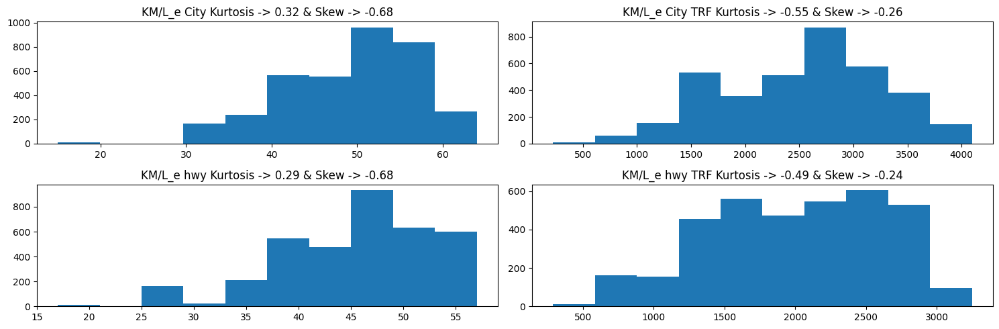

In [ ]:
fig,ax = plt.subplots(nrows=2,ncols=2,figsize=(15,5))

ax[0][0].hist(df['Km/L_e_City'])
kurtosis = df['Km/L_e_City'].kurtosis()
skewness = df['Km/L_e_City'].skew()
ax[0][0].set_title(f'KM/L_e City Kurtosis -> {round(kurtosis,2)} & Skew -> {round(skewness,2)}')


transformed_city = df['Km/L_e_City'].apply(np.square)

ax[0][1].hist(transformed_city)
kurtosis = transformed_city.kurtosis()
skewness = transformed_city.skew()
ax[0][1].set_title(f'KM/L_e City TRF Kurtosis -> {round(kurtosis,2)} & Skew -> {round(skewness,2)}')


ax[1][0].hist(df['Km/L_e_Hwy'])
kurtosis = df['Km/L_e_Hwy'].kurtosis()
skewness = df['Km/L_e_Hwy'].skew()
ax[1][0].set_title(f'KM/L_e hwy Kurtosis -> {round(kurtosis,2)} & Skew -> {round(skewness,2)}')

transformed_hwy = df['Km/L_e_Hwy'].apply(np.square)
ax[1][1].hist(transformed_hwy)
kurtosis = transformed_hwy.kurtosis()
skewness = transformed_hwy.skew()
ax[1][1].set_title(f'KM/L_e hwy TRF Kurtosis -> {round(kurtosis,2)} & Skew -> {round(skewness,2)}')

fig.tight_layout()
fig.show()

-0.10953760587185289
-0.6368013987765448


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


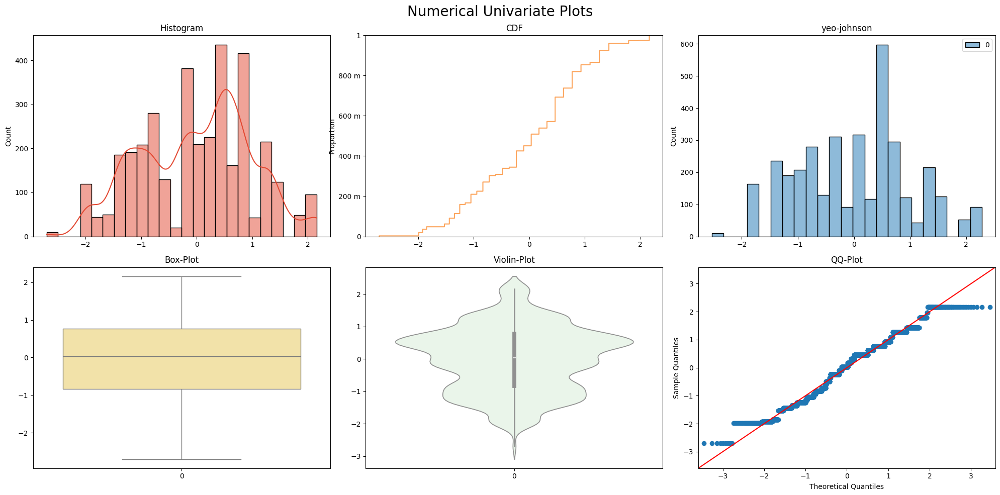

In [ ]:
# power transform city

pwrtrf_city = PowerTransformer(method='box-cox').fit_transform(df['Km/L_e_City'].dropna().values.reshape(-1,1))

pwrtrf_city = pd.Series(pwrtrf_city.ravel())

print(pwrtrf_city.skew())
print(pwrtrf_city.kurtosis())

eda_helper.numerical_univariate_plots(pwrtrf_city)

-0.0976809316250141
-0.6104407358124884


/usr/local/lib/python3.12/dist-packages/statsmodels/graphics/gofplots.py:1041: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


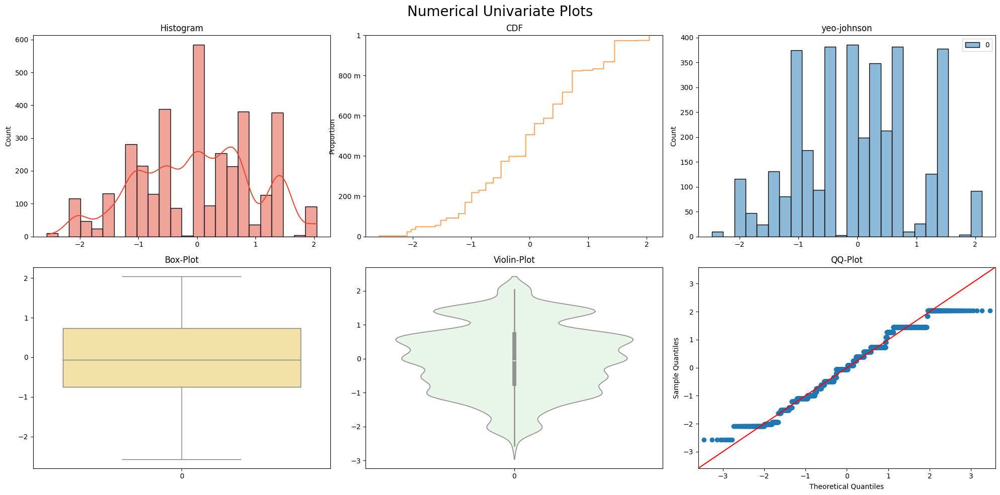

In [ ]:
pwrtrf_hwy = PowerTransformer(method='box-cox').fit_transform(df['Km/L_e_Hwy'].dropna().values.reshape(-1,1))

pwrtrf_hwy = pd.Series(pwrtrf_hwy.ravel())

print(pwrtrf_hwy.skew())
print(pwrtrf_hwy.kurtosis())

eda_helper.numerical_univariate_plots(pwrtrf_hwy)

----
# **Battery_Range_Score_Cleaned & Battery_Range_Score_Category: Remove or not?**

`Problem`:
- Huge amount of data is missing for both columns.
- Category column, have only one category.

`Solution`:
- Only solution is to `drop these columns`, as I am not getting information how they are giving score to cars, also if I try to use any algo based imputation there is high possibility that it can develop some kind of bias in data, which can adversely impact the predictive power of main algorithm that will be used to predict the price.

----
# **City, State & ZIP Code : Cleaning & Decision for unseen data**

`Problem`:
- I have three columns—ZIP, City, and State, but the city names in my dataset may be inconsistent and not familiar to me, (need to check the city name)
- After checking and making it authentic, in final website I want to let users provide data for prediction on my website, and I'm deciding between two approaches to handle city and state information reliably (Approch 1 & 2).

`Solution`:
- For cleaning the data, I have `downloaded an external file` which have information about city, zip, lat, long and state, and use city and state name from that file after merging with my dataframe.
  - File_Link - https://download.geonames.org/export/zip/allCountries.zip

- In addition, I got two more columns, `latitude and longitude` from that external file, which enriched the data.

- **Approach 1**: Use the ZIP column to `automatically fetch city and state` information. If the ZIP exists in my dataset, use the available data; if not, refer to a downloaded authentic `ZIP-to-city/state file`. Any unseen city can be encoded as `Others` for the model. This approach is `user-friendly`, `professional-looking`, and handles any ZIP code gracefully, but it requires storing the external file on the server. To eliminate that external file also, I will make use of an `API`, that will give response to me directly. Reducing the additional server cost.
  - API LINK - `https://api.zippopotam.us/us/<zip_code>`

- **Approach 2**: Let users select the `state first`, then `filter` available cities from your dataset. This avoids storing extra data, but `many cities may be missing`, making the website look incomplete and slower due to `sequential filtering`.


Hence, I will make use of `first approch` (cleaned city,state and zip info with API for unseen cities).


In [141]:
# after downloading https://download.geonames.org/export/zip/allCountries.zip and unzipping

zip_df = pd.read_csv('allCountries.txt', sep='\t', header=None,
                 names=['country','postal_code','place_name','admin1','admin2','admin3','admin4','lat','lon','accuracy'])

/tmp/ipython-input-3394024563.py:3: DtypeWarning: Columns (1,3,4,5,6,7,8) have mixed types. Specify dtype option on import or set low_memory=False.
  zip_df = pd.read_csv('allCountries.txt', sep='\t', header=None,


In [142]:
# using only the USA data

usa = zip_df.reset_index().query('level_0 == "US"').drop(columns=['admin1','admin2','admin3','admin4']).set_axis(['Country','ZIP','City','STATE','ST','lat','LONG','ACCURACY'],axis=1)

In [143]:
def convert_zip_to_string(x):
  # to add zero explicitly for the zip with 0 in starting
  # ex - 6540 to 06540

  if pd.isna(x):
    return x
  else:
    return str(int(x)) if len(str(int(x))) == 5 else '0'+str(int(x))

In [ ]:
merged_df = df.assign(
    Postal_Code = df['Postal_Code'].apply(lambda x : convert_zip_to_string(x))
).merge(usa.assign(ZIP = usa['ZIP']),left_on=['Postal_Code'],right_on=['ZIP'])

In [144]:
def normalize_text(s):
  # encoding was different, need to change it to suitable encoding so that we can do operations.

    if pd.isna(s):
        return s
    return (unicodedata.normalize("NFKC", str(s))
            .strip()
            .lower())

In [145]:
# converting to correct encoding

usa = usa.map(normalize_text)

In [ ]:
#exporting data for future use

usa.to_csv('usa.csv')

In [ ]:
# dropping the columns, that may contain wrong info

merged_df.drop(columns=['City_x','Postal_Code','Country','ACCURACY','State']).rename({'City_y' :'City'})

,Model_Year,Brand_Name,Model_Name,Image_List,New_Used,Mileage,Price,Price_Drop,Deal_Type,Exterior_Color,Interior_Color,Drivetrain,Mpg,Fuel_Type,Transmission,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Open_Recall,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Excepted_Range,Seller_Name,Seller_Rating,People_Count_Seller_Rating,Seller_Site,Car_Rating,People_Count_Car_Rating,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Adaptive_Cruise_Control,Cooled_Seats,Heated_Seats,Heated_Steering_Wheels,Keyless_Entry,Keyless_Start,Navigation_System,Remote_Start,Power_Liftgate,Automatic_Parking,Power_Folding_Mirror,Wheel_Chair_Accessible,Autopilot,Android_Auto,Apple_Carplay,Bluetooth,Premium_Sound_System,Usb_Port,Wifi_Hotspot,Satellite_Radio,Cd_Player,Homelink,Rear_Seat_Entertainment,Dvd_Player,Alloy_Wheels,Sunroof_Moonroof,Tow_Hitch,Tow_Hooks,Roof_Rack,Automatic_Emergency_Braking,Backup_Camera,Blind_Spot_Monitor,Brake_Assist,Led_Headlights,Lane_Departure_Warning,Rear_Cross_Traffic_Alert,Stability_Control,Rain_Sensing_Wipers,Leather_Seats,Memory_Seat,Third_Row_Seating,Mpge_City,Mpge_Hwy,Battery_Range_Score_Cleaned,Battery_Range_Score_Category,Street_Address,ZIP,City_y,STATE,ST,lat,LONG
0,2022,Ford,F-150 Lightning Platinum,['https://platform.cstatic-images.com/xlarge/i...,Used,27565.0,48500.0,0,Great,gray,gray,AWD,0.0,Electric,Automatic,False,True,one,no,NaN,19.0,41.0,131.0,290.0,dennis sneed ford,5.0,16.0,http://www.sneedford.com/?utm_source=cars.com&...,4.2,18.0,NaN,NaN,NaN,NaN,True,True,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,True,<NA>,True,True,True,True,True,True,True,True,<NA>,True,True,<NA>,73.0,60.0,NaN,NaN,1046 SW US Highway 169,64454,Gower,Missouri,MO,39.6020,-94.5965
1,2025,Ford,Maverick XLT,['https://platform.cstatic-images.com/xlarge/i...,New,3.0,35285.0,0,NaN,gray,gray,AWD,26.0,Gasoline,Automatic,False,True,not_owned_yet,not_in_use_yet,not_in_use_yet,NaN,NaN,NaN,NaN,bening ford of perryville,5.0,17.0,http://beningford.com/?utm_source=cars.com&utm...,4.7,3.0,NaN,2,I4,NaN,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,True,<NA>,True,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,True,<NA>,<NA>,True,True,<NA>,True,True,True,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,909 S Perryville Blvd,63775,Perryville,Missouri,MO,37.7174,-89.8737
2,2014,Ford,F-150 STX,['https://platform.cstatic-images.com/xlarge/i...,Used,117487.0,16998.0,0,Good,black,black,4WD,12.0,Flex Fuel,Automatic,True,True,more,yes,NaN,NaN,NaN,NaN,NaN,patriot motors,0.0,17.0,http://www.patriotmotorsrt5.com?utm_source=car...,4.7,304.0,6,5.0,V8,NaN,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,True,<NA>,<NA>,<NA>,<NA>,NaN,NaN,NaN,NaN,3306 State Rte 5,44410,Cortland,Ohio,OH,41.3251,-80.7327
3,2023,Chevrolet,Tahoe 4WD Z71,['https://platform.cstatic-images.com/xlarge/i...,Used,63052.0,54495.0,0,Good,black,black,4WD,17.5,Gasoline,Automatic,False,True,one,yes,NaN,NaN,NaN,NaN,NaN,granbury nissan,4.1,104.0,http://www.granburynissan.com/?utm_source=cars...,3.8,5.0,10,6.2,V8,NaN,True,<NA>,True,<NA>,True,True,True,True,True,<NA>,<NA>,<NA>,<NA>,True,True,True,True,True,True,<NA>,<NA>,True,True,<NA>,True,True,True,True,True,True,True,True,True,True,True,<NA>,True,True,True,True,True,NaN,NaN,NaN,NaN,4601 E Hwy 377,76049,Granbury,Texas,TX,32.4488,-97.7285
4,2024,Audi,Q5 45 S line quattro Premium,['https://platform.cstatic-images.com/xlarge/i...,Certified,9531.0,40204.0,124,Good,gray,black,AWD,25.0,Gasoline,Automatic,False,True,more,no,NaN,NaN,NaN,NaN,NaN,harper audi,4.9,466.0,https://www.audiknoxville.com?utm_source=cars....,3.5,4.0,7,2.0,I4,16,True,<NA>,True,True,True,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,True,True,<NA>,<NA>,<NA>,<NA>,True,<NA>,<NA>,True,True,<NA>,<NA>,True,<NA>,True,<NA>,True,<NA>,<NA>,<NA>,True

# **Cleaning Actions II**

In [146]:
df_cleaned_v2 = df.assign(
    # those car whose mileage is greater than 1k will be consider as used (not new)
    One_Owner_Vehicle = lambda d : (
        np.where(
            ((d['Stock_Type'] == 'New') & (d['Mileage'] > 1000)),
            'one',
            d['One_Owner_Vehicle']
        )),

    Personal_Use_Only = lambda d : (
        np.where(
            ((d['Stock_Type'] == 'New') & (d['Mileage'] > 1000)),
            'yes',
            d['Personal_Use_Only']
        )),

    Stock_Type = lambda d :
                (np.where(
                        ((d['Stock_Type'] == 'New') & (d['Mileage'] > 1000)),
                        'Used',
                        d['Stock_Type']
        )),

    # those car which are manufactured before 2023 and didn't even travel 10kms are assigned to np.nan
    Mileage = lambda d :
              (np.where(
                  ((d['Stock_Type'] == 'Used') & (d['Model_Year'] < 2023) & (d['Mileage'] < 10)),
                  np.nan,
                  d['Mileage']
              )),

    # correcting fuel type, it a car is labelled as hyrid it can be hybrid or plugin hybrid, so labelling them to correct type by dict
    # all volt and i3 Base extender are plugin hybrid
    # all those car which have expected range info are electric cars.
    Fuel_Type = lambda d : np.select(
        [
            (d['Fuel_Type'] == 'Hybrid'),
            ((d['Model_Name'].str.contains('Volt')) | (d['Model_Name'] == "i3 Base w/Range Extender") | (d['Model_Name'] == '330e iPerformance') | (d['Model_Name'] == 'Q5 55 S line quattro Premium')),
            d['Expected_Range'].notna()
        ],
        [
            d['Model_Name'].str.lower().map(hybrid_correction_dict),
            'Plug-in Hybrid',
            'Electric',
        ],
        default = d['Fuel_Type']
    ),

    # those car which are non electric and have expected_range value setting those to np.nan
    Expected_Range = lambda d : (
        d
        .Expected_Range
        .mul(1.609)
        .round(1)
    ),

    # correcting engine size, based on domain knowledge
    Engine_Size = lambda d : np.select(
        [
            ((d['Engine_Size'] == 0) & (d['Model_Name'].str.contains('Forester'))),
            ((d['Engine_Size'] == 0) & (d['Model_Name'] == 'Q5 55 S line quattro Premium')),
            ((d['Engine_Size'] > 60) | (d['Engine_Size'] == 0)),
            ((d['Fuel_Type'] == "Electric") & (d['Engine_Size'].notna())),
            ((d['Model_Name'].str.contains('F-150 Lightning')))
        ],
        [
            2.5,
            2.0,
            np.nan,
            np.nan,
            np.nan
        ],
        default= d['Engine_Size']
    ),

    # correcting the wrong cylinder config
    Cylinder_Config = lambda d : (
        np.select(
            [
                d['Cylinder_Config'].isin(['V32','V48','V45','I32','I24','I38','V21','I16']),
                d['Cylinder_Config'] == 'H1',
                (d['Model_Year'] == 2011) & (d['Model_Name'] == 'Wrangler Unlimited Sahara'), #idx 7012
                (d['Fuel_Type'] == 'Electric'), # electric car can't have cylinder config,
                ((d['Model_Name'].str.contains('F-150 Lightning')))
            ],
            [
                np.nan,
                'V8',
                'V6',
                np.nan,
                np.nan
            ],
            default=d['Cylinder_Config']
        )
    ),

    Valves = lambda d : (
        np.select(
            [
                d['Valves'] == '36',
                d['Valves'] == '4',
                d['Valves'] == '2',
                d.index == 14134,
                d['Fuel_Type'] == 'Electric'
            ],

            [
                '48',
                '32',
                '16',
                np.nan,
                np.nan
            ],
            default=d['Valves']
        )
    ),

    # converting all this value to object, so that i can use 0 at starting of zip code (to convert all 5 digit zip to 6 digit)
    ZIP_Code = lambda d : (
      d['ZIP_Code'].apply(lambda x : convert_zip_to_string(x))
    )
)

# heavily accidents car seller
seller_idx = df_cleaned_v2[df_cleaned_v2['Seller_Name'] == 'elite auto auctions'].index

# those cars which are not electric but have electric car related info (only 2 such cars), will set those cars's level2,dc_charging and battery capacity info to np.nan
condition = (df_cleaned_v2['Fuel_Type'] != 'Electric') & ((df_cleaned_v2['Expected_Range'].notna()) | (df_cleaned_v2['Level2_Charging'].notna()) | (df_cleaned_v2['Dc_Fast_Charging'].notna()) | (df_cleaned_v2['Battery_Capacity'].notna()))
df_cleaned_v2.loc[condition,['Expected_Range','Level2_Charging','Dc_Fast_Charging','Battery_Capacity']] = np.nan

# wrong price either very large or very small price which do not justify (according to model)
price_idx = [190688,41228,229858,256629,148265,66193, 85055, 89202, 66193, 69280, 202429, 256433, 154997, 93267, 217457, 522]

# km/l wrong entry index
kml = [224055,41157]

# concate
idx = np.concat((seller_idx,price_idx,kml))

# dropping the columns, that will not be used for ml and even website
df_cleaned_v2 = df_cleaned_v2.drop(index=idx,columns=['Price_Drop','Deal_Type','Transmission','Battery_Range_Score_Cleaned','Battery_Range_Score_Category'])

# merging data from usa dataframe, and dropping unnecessary columns
df_cleaned_v2 = df_cleaned_v2.merge(usa,left_on='ZIP_Code',right_on='ZIP',how='left').drop(columns=['City_x','ZIP_Code','Country','ACCURACY','State']).rename(columns={'City_y' : 'City'})

In [ ]:
df_cleaned_v2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 269083 entries, 0 to 269082
Data columns (total 81 columns):
 #   Column                       Non-Null Count   Dtype   
---  ------                       --------------   -----   
 0   Model_Year                   269083 non-null  int64   
 1   Brand_Name                   269083 non-null  category
 2   Model_Name                   269083 non-null  object  
 3   Image_List                   264514 non-null  object  
 4   Stock_Type                   269083 non-null  object  
 5   Mileage                      265559 non-null  float64 
 6   Price                        266192 non-null  float64 
 7   Exterior_Color               264387 non-null  category
 8   Interior_Color               254332 non-null  category
 9   Drivetrain                   265006 non-null  category
 10  Km/L                         213003 non-null  float64 
 11  Fuel_Type                    265270 non-null  object  
 12  Accidents_Or_Damage          269083 non-null

# Domain/Logic Based Imputation

## **Mileage Imputation**

I found that this column is showing two kind of missingness.

   - MAR - Cars that belongs to >2022 and are new cars, have NaN mileage, this can be because the car has run almost close to 0. for safer side I will be imputing this with the median of new car mileage, after this imputation the distrubution of New car Mileage remain intact. (imputed via median).

   - MNAR or MCAR - Mileage of all other cars are depending on those cars itself, which can't be justified by any other or Mileage column itself. (will impute it later).

In [ ]:
df_cleaned_v2[df_cleaned_v2['Mileage'].isna()]['Model_Year'].value_counts()

,count
Model_Year,
2025,2634
2026,540
2024,99
2023,16
2019,14
2022,14
2021,11
2017,10
1968,10


In [ ]:
df_cleaned_v2[df_cleaned_v2['Mileage'].isna()]['Stock_Type'].value_counts()

,count
Stock_Type,
New,3280
Used,243
Certified,1


In [ ]:
df_cleaned_v2[(df_cleaned_v2['Mileage'].isna()) & (df_cleaned_v2['Model_Year'] == 2023)]['Stock_Type'].value_counts()

,count
Stock_Type,
New,16


In [ ]:
temp = df_cleaned_v2[df_cleaned_v2['Mileage'].isna()]

temp.groupby(['Model_Year','Stock_Type'])['Brand_Name'].count().tail(20)

,,Brand_Name
Model_Year,Stock_Type,
2012,Used,6
2013,Used,1
2014,Used,6
2015,Used,10
2016,Used,9
2017,Used,10
2018,Used,8
2019,Used,14
2020,Used,6


In [ ]:
df_cleaned_v2[(df_cleaned_v2['Model_Year'] == 2023) & (df_cleaned_v2['Stock_Type'] == 'New')]['Mileage'].median()

11.0

In [ ]:
df_cleaned_v2.query('Stock_Type == "New"')['Mileage'].median()

5.0

In [ ]:
test = df_cleaned_v2.assign(
    Mileage = lambda d : np.where(
        ((d['Stock_Type'] == 'New') & (d['Mileage'].isna())),
        (d[d['Stock_Type'] == "New"]['Mileage'].median()),
        d['Mileage']
    )
)

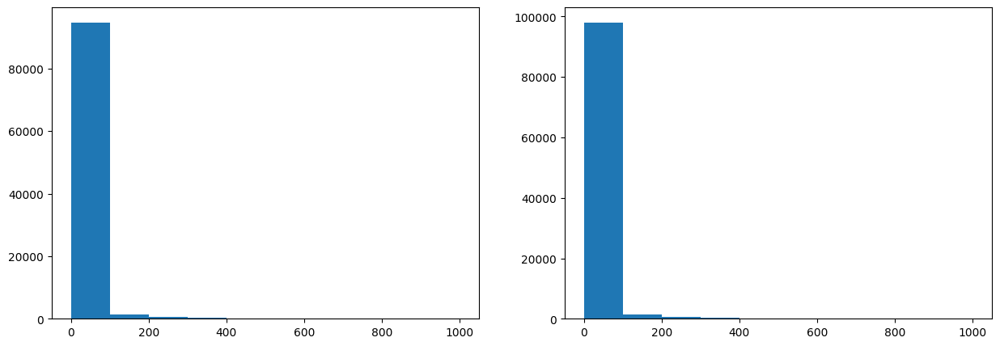

In [ ]:
# no change in distrubution of column

fig,ax = plt.subplots(nrows=1,ncols=2,figsize=(15,5))

ax[0].hist(df_cleaned_v2.query('Stock_Type == "New"')['Mileage'])
ax[1].hist(test.query('Stock_Type == "New"')['Mileage'])

fig.show()

## **Price Imputation**

Price can be `imputed` with help of `other columns` hence it is `MAR` kind of data but we can't use the `model based imputation, because` :

- Suppose a row has missing price.

- You impute it with a **regression or ML model** using features like Mileage, Year, Brand, Stock Type.

- Now that missing price is no longer **real** — it’s partly predicted from the same features.

- If you then train a model to predict Price using those same features, the model will **look good** because it is indirectly learning from a price that was already derived from those features.

- That's leakage: the model is judged against something that contains hints of the answer.

Hence I will try to fill this value in **hierarchical way**. by below sequence -

- Brand x Model x Year x Stock Type x State

- If still missing → Brand x Model x Stock Type

- else np.nan (will found out some other technique for remaining NaN values)

I have also varified that this method is not changing distribution of data.





In [ ]:
test = df_cleaned_v2.copy()

test['imputed_price'] = (
    test.groupby(['Model_Name', 'Model_Year', 'Stock_Type', 'ST'])['Price']
      .transform('median')
)

test['imputed_price'] = test['imputed_price'].fillna(
    test.groupby(['Model_Name', 'Model_Year', 'Stock_Type'])['Price']
      .transform('median')
)

test['Price'] = test['Price'].fillna(test['imputed_price'])

test.drop(columns=['imputed_price']).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 269083 entries, 0 to 269082
Data columns (total 81 columns):
 #   Column                       Non-Null Count   Dtype   
---  ------                       --------------   -----   
 0   Model_Year                   269083 non-null  int64   
 1   Brand_Name                   269083 non-null  category
 2   Model_Name                   269083 non-null  object  
 3   Image_List                   264514 non-null  object  
 4   Stock_Type                   269083 non-null  object  
 5   Mileage                      265559 non-null  float64 
 6   Price                        268989 non-null  float64 
 7   Exterior_Color               264387 non-null  category
 8   Interior_Color               254332 non-null  category
 9   Drivetrain                   265006 non-null  category
 10  Km/L                         213003 non-null  float64 
 11  Fuel_Type                    265270 non-null  object  
 12  Accidents_Or_Damage          269083 non-null

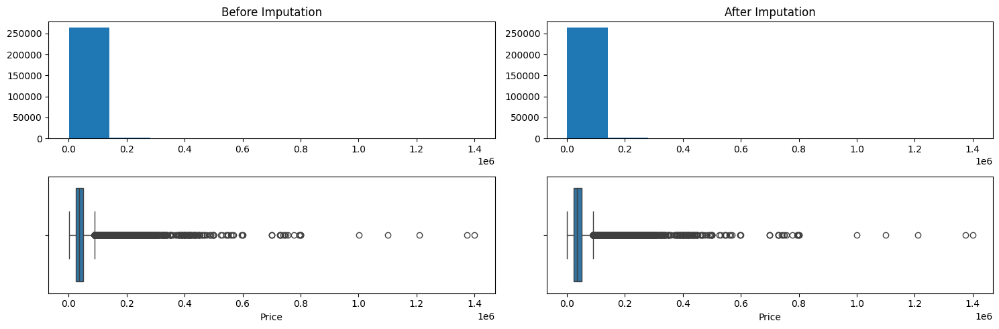

In [ ]:
# no change in distrubution

fig,ax = plt.subplots(nrows=2,ncols=2,figsize=(15,5))

axes = np.ravel(ax)

axes[0].hist(df_cleaned_v2['Price'])
axes[1].hist(test['Price'])

sns.boxplot(x=df_cleaned_v2['Price'],ax=axes[2])
sns.boxplot(x=test['Price'],ax=axes[3])

axes[0].set_title('Before Imputation')
axes[1].set_title('After Imputation')

fig.tight_layout()
fig.show()

## Drivetrain Imputation

This column have `MAR` kind of missing values, that can be imputed with this simple logic - Cars of same name (model_name) and year will have same drivetrain, thus we will use mode of year model_name with year and fill the respective missing value.

This technique does not change the distribution of column.

In [ ]:
test = df_cleaned_v2.copy()

test['imputed_drivetrain'] = test.groupby(['Model_Year','Model_Name'])['Drivetrain'].transform(lambda x : x.mode().values[0] if x.mode().values else np.nan)

In [ ]:
test['Drivetrain'] = test['Drivetrain'].fillna(test['imputed_drivetrain'])

In [ ]:
test['Drivetrain'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 269083 entries, 0 to 269082
Series name: Drivetrain
Non-Null Count   Dtype   
--------------   -----   
267292 non-null  category
dtypes: category(1)
memory usage: 263.1 KB


In [ ]:
# no huge change in distrubtion
test['Drivetrain'].value_counts()

,count
Drivetrain,
4WD,86896
AWD,70729
FWD,68644
RWD,41023


In [ ]:
df_cleaned_v2['Drivetrain'].value_counts()

,count
Drivetrain,
4WD,86355
AWD,69926
FWD,68377
RWD,40348


## **Fuel Type Imputation**

This column also shows the property of MAR missinginess, hence I will impute it with help of Model_Year and Model_Name group's mode value.
Distribution remain intact.

In [ ]:
test = df_cleaned_v2.copy()

test['imputed_fueltype'] = test.groupby(['Model_Year','Model_Name'])['Fuel_Type'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)
test['Fuel_Type'] = test['Fuel_Type'].fillna(test['imputed_fueltype'])

test['Fuel_Type'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 269083 entries, 0 to 269082
Series name: Fuel_Type
Non-Null Count   Dtype 
--------------   ----- 
267698 non-null  object
dtypes: object(1)
memory usage: 2.1+ MB


In [ ]:
test['Fuel_Type'].value_counts()

,count
Fuel_Type,
Gasoline,213797
Hybrid,23305
Diesel,18577
Electric,5219
Flex Fuel,4283
Plug-in Hybrid,2401
Other,64
CNG/LPG,52


In [ ]:
df_cleaned_v2['Fuel_Type'].value_counts()

,count
Fuel_Type,
Gasoline,211819
Hybrid,23199
Diesel,18527
Electric,4963
Flex Fuel,4258
Plug-in Hybrid,2388
Other,64
CNG/LPG,52


## **Open Recall Imputation**

Column contains more than 50% of values as missing, even if I fill the 17k certified car which have NaN values, with `no_open recall` category (because certification only get if there is no open recall).

Missingness is also of MAR category, so I can't even fill this values with any other column.

Hence, I am left with only option to drop this column.


In [ ]:
df_cleaned_v2['Open_Recall'].value_counts()

,count
Open_Recall,
not_in_use_yet,102781
yes,27252


In [ ]:
df_cleaned_v2[df_cleaned_v2['Open_Recall'].isna()]['Stock_Type'].value_counts()

,count
Stock_Type,
Used,121542
Certified,17508


----------------
Significance level : 5.0 %
Null Hypothesis : All Groups have equal variances.
Alternate Hypothesis : At least one group has different variance.
Test Statistic : 20.987616034101425
Pvalue : 7.689759325823504e-10
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Variances between groups are not equal.


---------------------
Significance level : 5.0%
Null Hypothesis : All Group means are equal.
Alternate Hypothesis : One or more Group mean is different
Since Pvalue is less than 0.05, we reject Null Hypothesis
CONCLUSION : Atleast one group mean is different


--------------------------------------

             Multiple Comparison of Means - Tukey HSD, FWER=0.05              
    group1         group2       meandiff  p-adj    lower       upper    reject
------------------------------------------------------------------------------
            no not_in_use_yet  20830.1312   0.0  20599.7442  21060.5182   True
            no            yes   -950.3605   0.0  -1320.0546   -580.6663   True
not_in_use_yet            yes -21780.4916   0.0 -22161.1516 -21399.8317   True
------------------------------------------------------------------------------




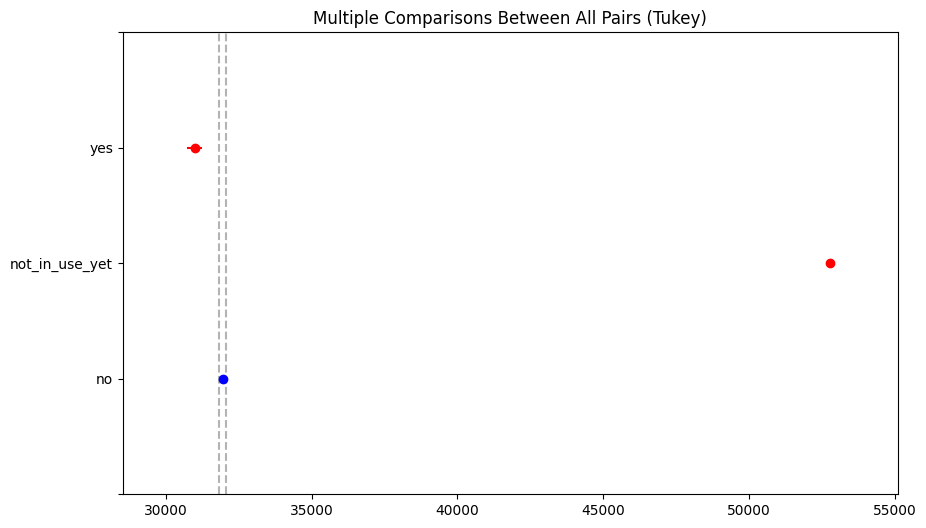

In [ ]:
eda_helper.numerical_vs_categorical_hypothesis_test(df_cleaned_v2.assign(Open_Recall = df_cleaned_v2['Open_Recall'].astype('O').fillna('no')),'Price','Open_Recall',comparison_name='no')

## **Gear_Spec**

Using the combination of model_year and model_name to fill this value with mode.

Missingness belongs to MAR.

In [ ]:
test = df_cleaned_v2.copy()

test['gear_spec_imputed'] = test.groupby(['Model_Year','Model_Name'])['Gear_Spec'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)

test['Gear_Spec'] = test['Gear_Spec'].fillna(test['gear_spec_imputed'])

test['Gear_Spec'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 269083 entries, 0 to 269082
Series name: Gear_Spec
Non-Null Count   Dtype   
--------------   -----   
230093 non-null  category
dtypes: category(1)
memory usage: 263.3 KB


## **Engine_Size Imputation**

In [ ]:
test = df_cleaned_v2.copy()

test['engine_size_imputed'] = test.groupby(['Model_Year','Model_Name'])['Engine_Size'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)

test['Engine_Size'] = test['Engine_Size'].fillna(test['engine_size_imputed'])

test['Engine_Size'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 269083 entries, 0 to 269082
Series name: Engine_Size
Non-Null Count   Dtype  
--------------   -----  
261719 non-null  float64
dtypes: float64(1)
memory usage: 2.1 MB


## **Cylinder_Config Imputation**

In [ ]:
test = df_cleaned_v2.copy()

test['cylinder_imputed'] = test.groupby(['Model_Year','Model_Name'])['Cylinder_Config'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)

test['Cylinder_Config'] = test['Cylinder_Config'].fillna(test['cylinder_imputed'])

test['Cylinder_Config'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 269083 entries, 0 to 269082
Series name: Cylinder_Config
Non-Null Count   Dtype 
--------------   ----- 
261546 non-null  object
dtypes: object(1)
memory usage: 2.1+ MB


## **Valves Imputation**

In [ ]:
test = df_cleaned_v2.copy()

test['valves_imputed'] = test.groupby(['Model_Year','Model_Name'])['Valves'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)

test['Valves'] = test['Valves'].fillna(test['valves_imputed'])

test['Valves'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 269083 entries, 0 to 269082
Series name: Valves
Non-Null Count   Dtype 
--------------   ----- 
236565 non-null  object
dtypes: object(1)
memory usage: 2.1+ MB


## **LOCATION RELATED COLUMNS : IMPUTATION**

All columns, `city, state, lat, long and dealer name` all are missing together, so neither it is MAR, nor it is MCAR, it is MNAR. and we can't impute it with any other column, so I will impute it with N/A.

## **BOOLEAN COLUMNS**

### 1. Nature of your columns

- These are boolean / feature flags: either the car has it (`True`) or it’s missing (`NaN`).

- Even for the same Model + Year, some cars have the feature, some don’t.

- That means the missingness is not predictable from the other columns — it’s essentially MNAR (depends on the actual feature configuration, which you don’t observe).

---

### 2. Why typical imputation won’t work

- **Median / mean**: Only one category (`True`) exists — median of boolean column with mostly `NaN`s is meaningless.
- **Group-based imputation (Model + Year)**: Won’t work because within the same group, both `True` and `NaN` exist naturally. Filling `NaN`s would misrepresent the actual variability.
- **ML-based prediction**: Also risky — features are extremely sparse, and the model will mostly guess `False` or `True` incorrectly. This can bias your predictions.

---

### 3. Recommended approach

- **For ML / predictive modeling**: drop these columns.  
  - They add no reliable signal.  
  - Trying to impute could harm model accuracy.

- **For web/dev / display purposes**: keep them as-is.  
  - `NaN` = the feature is absent, or you can display “Not available” for that car.


# **Domain Based Imputation Applied**

In [147]:
imputed_df = df_cleaned_v2.assign(

# <------------------ MILEAGE ----------------------------->
    Mileage = lambda d : np.where(
        ((d['Stock_Type'] == 'New') & (d['Mileage'].isna())),
        (d[d['Stock_Type'] == "New"]['Mileage'].median()),
        d['Mileage']
    )
)

# <--------------------------------------------- PRICE ----------------------------------------->
# level-1
imputed_df['imputed_price'] = (
    imputed_df.groupby(['Model_Name', 'Model_Year', 'Stock_Type', 'ST'])['Price']
      .transform('median')
)

# level-2
imputed_df['imputed_price'] = imputed_df['imputed_price'].fillna(
    imputed_df.groupby(['Model_Name', 'Model_Year', 'Stock_Type'])['Price']
      .transform('median')
)

imputed_df['Price'] = imputed_df['Price'].fillna(imputed_df['imputed_price'])



# <-------------------------------------------- Drivetrain ------------------------------------------------->
imputed_df['imputed_drivetrain'] = imputed_df.groupby(['Model_Year','Model_Name'])['Drivetrain'].transform(lambda x : x.mode().values[0] if x.mode().values else np.nan)

imputed_df['Drivetrain'] = imputed_df['Drivetrain'].fillna(imputed_df['imputed_drivetrain'])


# <-------------------------------------------- Fuel Type ------------------------------------------------->
imputed_df['imputed_fueltype'] = imputed_df.groupby(['Model_Year','Model_Name'])['Fuel_Type'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)

imputed_df['Fuel_Type'] = imputed_df['Fuel_Type'].fillna(imputed_df['imputed_fueltype'])

# <-------------------------------------------- Gear Spec ------------------------------------------------->
imputed_df['gear_spec_imputed'] = imputed_df.groupby(['Model_Year','Model_Name'])['Gear_Spec'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)

imputed_df['Gear_Spec'] = imputed_df['Gear_Spec'].fillna(imputed_df['gear_spec_imputed'])


# <-------------------------------------------- Engine_Size ------------------------------------------------->
imputed_df['engine_size_imputed'] = imputed_df.groupby(['Model_Year','Model_Name'])['Engine_Size'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)

imputed_df['Engine_Size'] = imputed_df['Engine_Size'].fillna(imputed_df['engine_size_imputed'])

# <-------------------------------------------- Cylinder_config ------------------------------------------------->
imputed_df['cylinder_imputed'] = imputed_df.groupby(['Model_Year','Model_Name'])['Cylinder_Config'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)

imputed_df['Cylinder_Config'] = imputed_df['Cylinder_Config'].fillna(imputed_df['cylinder_imputed'])

# <-------------------------------------------- Valves ------------------------------------------------->
imputed_df['valves_imputed'] = imputed_df.groupby(['Model_Year','Model_Name'])['Valves'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)
imputed_df['Valves'] = imputed_df['Valves'].fillna(imputed_df['valves_imputed'])

# <-------------------------------------------- LOCATION RELATED COLUMNS ------------------------------------------------->
imputed_df['City'] = imputed_df['City'].fillna('Unknown_City')
imputed_df['STATE'] = imputed_df['STATE'].astype('O').fillna('Unknown_State').astype('category')
imputed_df['ST'] = imputed_df['ST'].astype('O').fillna('Unknown_State').astype('category')
imputed_df['ZIP'] = imputed_df['ZIP'].fillna(99999)
imputed_df['lat'] = imputed_df['lat'].fillna(0)
imputed_df['LONG'] = imputed_df['LONG'].fillna(0)
imputed_df['Seller_Name'] = imputed_df['Seller_Name'].fillna('Unknown_Seller')

# <------------------------------------------  removing wrong imputation ----------------------------------------------->
condition = (imputed_df['Fuel_Type'] == "Electric")

imputed_df.loc[condition,['Engine_Size','Cylinder_Config','Valves']] = np.nan

# <-------------------------------------------- Dropping utility columns ------------------------------------------------->
imputed_df.drop(columns=['imputed_price','imputed_drivetrain','imputed_fueltype',
                         'gear_spec_imputed','engine_size_imputed','cylinder_imputed','valves_imputed'],inplace=True)

In [ ]:
imputed_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 271189 entries, 0 to 271188
Data columns (total 81 columns):
 #   Column                       Non-Null Count   Dtype   
---  ------                       --------------   -----   
 0   Model_Year                   271189 non-null  int64   
 1   Brand_Name                   271189 non-null  category
 2   Model_Name                   271189 non-null  object  
 3   Image_List                   266616 non-null  object  
 4   Stock_Type                   271189 non-null  object  
 5   Mileage                      270941 non-null  float64 
 6   Price                        271095 non-null  float64 
 7   Exterior_Color               266483 non-null  category
 8   Interior_Color               256380 non-null  category
 9   Drivetrain                   269484 non-null  category
 10  Km/L                         213057 non-null  float64 
 11  Fuel_Type                    269793 non-null  object  
 12  Accidents_Or_Damage          271189 non-null

# MULTIVARIATE IMPUTATION

Before starting multivariate imputation, its time to split the data, one for web dev purpose, which will need each and every row, and second is only those rows (not new cars) and columns which will be used for model building purpose only.

filtering out new cars before multivariate imputation is a valid and industry-aligned strategy because my predictive objective is focused on used/certified pricing.

> Entire Workflow will look like this

```
Workflow Tree
Start with Dataset (after univariate imputation)
│
├── Full Dataset (All Rows + All Columns)
│   └── Purpose: Web / Reporting
│       └── Strategy: Minimal cleaning → Replace NaN with “N/A” for display
│
└── ML Dataset (Only Useful Columns)
    ├── Step: Drop irrelevant / unreliable columns (e.g., sparse booleans)
    │
    ├── Split by Stock_Type
    │   │
    │   ├── New Cars (Stock_Type = "New")
    │   │   └── No further imputation or transformation
    │   │       └── Used for simple EDA
    │   │
    │   └── Not New Cars (Used + Certified)
    │       ├── Apply Multivariate Imputation (MICE / KNN / IterativeImputer)
    │       └── Apply Transformations (scaling / binning / encoding)
    │
    ├── EDA Phase
    │   ├── New Cars → Descriptive stats / inventory view
    │   ├── Not New Cars → Full distribution & correlation analysis & Feature Engineering
    │   └── (Optional) Join temporarily for comparison charts (New vs Used)
    │
    └── Modeling Phase
        └── Train model ONLY on Not New Cars
            └── Reason: I am building model for used car prediction only
```


In [148]:
# data for webdev

webdev_df = imputed_df.copy()

webdev_df.to_csv('webdev.parquet')

In [149]:
# ml & EDA df

mldf = imputed_df.drop(columns=[
    'Open_Recall','Seller_Name', 'Seller_Rating',
       'People_Count_Seller_Rating', 'Seller_Site', 'Car_Rating',
       'People_Count_Car_Rating', 'Adaptive_Cruise_Control', 'Cooled_Seats',
       'Heated_Seats', 'Heated_Steering_Wheels', 'Keyless_Entry',
       'Keyless_Start', 'Navigation_System', 'Remote_Start', 'Power_Liftgate',
       'Automatic_Parking', 'Power_Folding_Mirror', 'Wheel_Chair_Accessible',
       'Autopilot', 'Android_Auto', 'Apple_Carplay', 'Bluetooth',
       'Premium_Sound_System', 'Usb_Port', 'Wifi_Hotspot', 'Satellite_Radio',
       'Cd_Player', 'Homelink', 'Rear_Seat_Entertainment', 'Dvd_Player',
       'Alloy_Wheels', 'Sunroof_Moonroof', 'Tow_Hitch', 'Tow_Hooks',
       'Roof_Rack', 'Automatic_Emergency_Braking', 'Backup_Camera',
       'Blind_Spot_Monitor', 'Brake_Assist', 'Led_Headlights',
       'Lane_Departure_Warning', 'Rear_Cross_Traffic_Alert',
       'Stability_Control', 'Rain_Sensing_Wipers', 'Leather_Seats',
       'Memory_Seat', 'Third_Row_Seating', 'Street_Address',
       'ST', 'lat', 'LONG','ZIP'
])

In [151]:
# creating two df, new and used cars

new_cars = mldf.query('Stock_Type == "New"').copy()
new_cars.to_parquet('newcars.parquet')

notnew_cars = mldf.query('Stock_Type != "New"').copy()

In [ ]:
notnew_cars.info()

<class 'pandas.core.frame.DataFrame'>
Index: 170334 entries, 0 to 271187
Data columns (total 27 columns):
 #   Column               Non-Null Count   Dtype   
---  ------               --------------   -----   
 0   Model_Year           170334 non-null  int64   
 1   Brand_Name           170334 non-null  category
 2   Model_Name           170334 non-null  object  
 3   Stock_Type           170334 non-null  object  
 4   Mileage              170086 non-null  float64 
 5   Price                170273 non-null  float64 
 6   Exterior_Color       167728 non-null  category
 7   Interior_Color       160474 non-null  category
 8   Drivetrain           168648 non-null  category
 9   Km/L                 142893 non-null  float64 
 10  Fuel_Type            168959 non-null  object  
 11  Accidents_Or_Damage  170334 non-null  bool    
 12  Clean_Title          170334 non-null  bool    
 13  One_Owner_Vehicle    168464 non-null  category
 14  Personal_Use_Only    169405 non-null  category
 15  Level

## Applying littles test to check MCAR

In [ ]:
mcar_tester = MCARTest(method="little")

# dropping those column which we know that they are not MAR
p_value = mcar_tester.little_mcar_test(notnew_cars.drop(columns=['Valves','Cylinder_Config','Engine_Size','Level2_Charging','Dc_Fast_Charging','Battery_Capacity','Expected_Range','Km/L_e_City','Km/L_e_Hwy']).select_dtypes(include=np.number))

alpha = 0.05
print(f"Little's MCAR Test p-value: {p_value:.4f}")

if p_value > alpha:
    print("Conclusion: Do not reject the null hypothesis. The data is likely Missing Completely At Random (MCAR).")
else:
    print("Conclusion: Reject the null hypothesis. The data is NOT Missing Completely At Random (MCAR).")
    print("Missingness is likely MAR (Missing At Random) or MNAR (Missing Not At Random).")

Little's MCAR Test p-value: 0.0000
Conclusion: Reject the null hypothesis. The data is NOT Missing Completely At Random (MCAR).
Missingness is likely MAR (Missing At Random) or MNAR (Missing Not At Random).


## **FUEL TYPE IMPUTATION**

In [ ]:
# filling remaining fuel type with dict

fuel_type_dict = {
    'X5': 'Gasoline',
    'Civic': 'Gasoline',
    'Escape ACTIVE': 'Gasoline',
    'Mustang ECOBOOST PREMIUM': 'Gasoline',
    'Malibu LT W/1LT': 'Gasoline',
    'Explorer ST-LINE': 'Gasoline',
    'Bronco BADLANDS': 'Gasoline',
    'X5 XDRIVE40I': 'Gasoline',
    'Accord': 'Gasoline',
    'Fit': 'Gasoline',
    'Mustang Mach-E SELECT': 'Electric',
    'Soul LX TECHNOLOGY': 'Electric',
    'Corvette': 'Gasoline',
    'Explorer ACTIVE': 'Gasoline',
    'Explorer LIMITED': 'Gasoline',
    'Pacifica TOURING L': 'Gasoline',
    'Mustang GT PREMIUM': 'Gasoline',
    'Traverse LT W/1LT': 'Gasoline',
    'Malibu': 'Gasoline',
    'Mustang ECOBOOST': 'Gasoline',
    'Forester 2.5i Limited': 'Gasoline',
    'Escape ST-LINE': 'Gasoline',
    'Silverado 1500 CUSTOM': 'Gasoline',
    'Mustang BULLITT': 'Gasoline',
    'Challenger R/T SCAT PACK': 'Gasoline',
    'Transit-250 148 WB Medium Roof Cargo': 'Gasoline',
    'Accord Hybrid': 'Hybrid',
    'Grand Cherokee LAREDO': 'Gasoline',
    'Sierra 1500 ELEVATION': 'Gasoline',
    'Escape PLATINUM': 'Gasoline',
    'F-250 LARIAT': 'Diesel',
    '911': 'Gasoline',
    'F-350 PLATINUM': 'Diesel',
    'Transit-350 BASE': 'Gasoline',
    'CX-5 2.5 S PREMIUM': 'Gasoline',
    'Highlander Hybrid Hybrid Limited': 'Hybrid',
    'Challenger SRT-8': 'Gasoline',
    'Malibu UNKNOWN': 'Other',
    'Wrangler Unlimited SPORT': 'Gasoline',
    'Wrangler Unlimited RUBICON': 'Gasoline',
    'F-150 RAPTOR': 'Gasoline',
    'Forester 2.5i Sport': 'Gasoline',
    'Malibu LS W/1LS': 'Gasoline',
    'F-150 PLATINUM': 'Gasoline',
    'Silverado 2500 CUSTOM': 'Diesel',
    'ES 350 BASE': 'Gasoline',
    'CX-5 SPORT': 'Gasoline',
    'F-150 FLASH': 'Electric',
    'Malibu SS': 'Gasoline',
    '4Runner NIGHTSHADE': 'Gasoline',
    'F-150 XLT': 'Gasoline',
    'Tahoe PREMIER': 'Gasoline',
    'Escape SE SPORT': 'Gasoline',
    'X3 SDRIVE30I': 'Gasoline',
    'Mustang Mach-E PREMIUM': 'Electric',
    'Transit-350': 'Gasoline',
    'RAV4 Hybrid Hybrid Woodland': 'Hybrid',
    'Explorer TIMBERLINE': 'Gasoline',
    'Soul LX w/ Tech Pkg, Keyless Entry,': 'Gasoline',
    'Civic TYPE R TOURING': 'Gasoline',
    'Gladiator SPORT': 'Gasoline',
    'Corvette STINGRAY W/3LT': 'Gasoline',
    'Grand Cherokee SUMMIT': 'Gasoline',
    'CR-V TOURING': 'Gasoline',
    'F-150 XLT SuperCab': 'Gasoline',
    'Camaro Z28 Track Car': 'Gasoline',
    'CR-V SPORT TOURING': 'Gasoline',
    '911 SUNROOF': 'Gasoline',
    'Wrangler Unlimited SAHARA': 'Gasoline',
    'Soul LX w/ Tech Pkg, Lane Assist, Collision': 'Gasoline',
    'Escape ST-LINE ELITE': 'Gasoline',
    'Escape TITANIUM': 'Gasoline',
    'Explorer SPORT': 'Gasoline',
    'F-350 LARIAT SUPER DUTY': 'Diesel',
    'Bronco': 'Gasoline',
    'Explorer PLATINUM': 'Gasoline',
    'Odyssey': 'Gasoline',
    'F-250 KING RANCH': 'Diesel',
    'Corvette Collectors Edition': 'Gasoline',
    'F-250 1972 Ford F250 Velocity Heritage Series': 'Gasoline',
    'X5 SDRIVE40I': 'Gasoline',
    '4Runner LIMITED': 'Gasoline',
    'Grand Cherokee LIMITED': 'Gasoline',
    'Soul LX w/ Tech Pkg, Rear Camera, Keyless': 'Gasoline',
    'Soul LX w/ Tech Pkg, Lane Assist, Keyless': 'Gasoline',
    'Q5 40 PREMIUM': 'Gasoline',
    'Civic SPORT': 'Gasoline',
    'Highlander LIMITED PLATINUM': 'Gasoline',
    'F-350 SUPER DUTY': 'Diesel',
    'Mustang GT': 'Gasoline',
    'SL-Class 300SL 2D Roadster': 'Gasoline',
    'Sierra 1500 DENALI ULTIMATE': 'Diesel',
    'Charger SRT HELLCAT WIDEBODY': 'Gasoline',
    'Civic EX W/ HONDA SENSING': 'Gasoline',
    'Forester WILDERNESS': 'Gasoline',
    'Grand Caravan': 'Gasoline',
    'Wrangler RUBICON': 'Gasoline',
    'Pilot ELITE': 'Gasoline',
    'Silverado 1500 LT TRAIL BOSS': 'Gasoline',
    'Highlander LIMITED': 'Gasoline',
    'Silverado 1500 HIGH COUNTRY': 'Gasoline',
    'Tundra PLATINUM': 'Gasoline',
    'Bronco HERITAGE LIMITED EDITION': 'Gasoline',
    'Challenger Base': 'Gasoline',
    'Tacoma LIMITED': 'Gasoline',
    'Mustang': 'Gasoline',
    'F-150 CREWCAB/XLT/LEATHER/NAVIGATION/BLACKPACK': 'Gasoline',
    'Camaro Base': 'Gasoline',
    'Highlander SPORT': 'Gasoline',
    'Sienna LE 8 PASSENGER': 'Gasoline',
    'Grand Cherokee OVERLAND': 'Gasoline',
    'Silverado 1500 LT W/1LT': 'Gasoline',
    'Sierra 3500 WORK SRW': 'Diesel',
    'F-150 KING RANCH': 'Gasoline',
    'MX-5 Miata Base': 'Gasoline',
    'X3': 'Gasoline',
    '4Runner SR5 PREMIUM': 'Gasoline',
    'Camry SE NIGHTSHADE': 'Gasoline',
    'Forester 2.5i Premium': 'Gasoline',
    'Wrangler 4WD': 'Gasoline',
    'Bronco Convertible': 'Gasoline',
    'Silverado 1500 CUSTOM TRAIL BOSS': 'Gasoline',
    'Odyssey TOURING': 'Gasoline',
    'Clarity Plug-In Hybrid': 'Plug-in Hybrid',
    'F-150 LIMITED': 'Gasoline',
    'Corvette STINGRAY W/2LT': 'Gasoline',
    'Corvette T-TOP': 'Gasoline',
    'Savana 2500 WORK VAN': 'Gasoline',
    'Escape ST-LINE SELECT': 'Gasoline',
    'Q5 45 S LINE QUATTRO PREMIUM': 'Gasoline',
    'Transit-250 130 WB LOW ROOF CARGO': 'Gasoline',
    'E-Class 300E': 'Hybrid',
    '4Runner TRD OFF ROAD PREMIUM': 'Gasoline',
    'Wrangler SAHARA': 'Gasoline',
    'Sierra 1500 PRO': 'Diesel',
    'SL-Class 2dr Coupe 560SL Roadster': 'Gasoline',
    'Bronco RAPTOR': 'Gasoline',
    'Grand Cherokee BASE': 'Gasoline',
    'PT Cruiser': 'Gasoline',
    'Express 2500 WORK VAN': 'Gasoline',
    '911 Targa': 'Gasoline',
    'F-150 TREMOR': 'Gasoline',
    '4Runner VENTURE': 'Gasoline',
    '911 T': 'Gasoline',
    'E-Class E420': 'Gasoline',
    'Pacifica LIMITED': 'Gasoline',
    'Transit-350 148 WB Medium Roof Cargo': 'Gasoline',
    'Wrangler SPORT': 'Gasoline',
    'Sienna XSE 7 PASSENGER': 'Gasoline',
    'Mustang Base': 'Gasoline',
    'Pilot': 'Gasoline',
    'Pilot BLACK EDITION': 'Gasoline',
    '911 SC': 'Gasoline',
    'Challenger SRT HELLCAT': 'Gasoline',
    'Malibu LT W/2LT': 'Gasoline',
    'Sierra 1500 DENALI': 'Diesel',
    'Silverado 1500 LS Extended Cab': 'Gasoline',
    'Model Y': 'Electric',
    'Pilot TRAILSPORT': 'Gasoline',
    'Mazda3 PREMIUM': 'Gasoline',
    'Mustang DARK HORSE': 'Gasoline',
    '911 2.7 RS Backdate': 'Gasoline',
    'Bronco EVERGLADES': 'Gasoline',
    'Soul LX w/ Tech Pkg, Lane Assist, Rear': 'Gasoline',
    'MX-5 Miata Eunos Roadster': 'Gasoline',
    'Traverse HIGH COUNTRY': 'Gasoline',
    'Town & Country 1 OWNER LOW MILES 58.406': 'Gasoline',
    'Q5 2.0T QUATTRO TECH PREMIUM PLUS': 'Gasoline',
    'Charger SCAT PACK': 'Gasoline',
    'Camaro COPO 427': 'Gasoline',  # High-performance, race-oriented, old-school big block V8
    'MDX TYPE S W/ADVANCE': 'Gasoline',  # Acura Type S models are Gasoline
    '911 4': 'Gasoline',  # All 911 variants are Gasoline (petrol)
    'F-350 LIMITED': 'Diesel',  # Top-tier trim for a heavy-duty truck, most commonly diesel
    'Edge': 'Gasoline',  # Standard Edge is Gasoline
    'Transit-250 XL': 'Gasoline',  # Standard Transit cargo van uses Gasoline
    'Forester PREMIUM': 'Gasoline',  # Standard Subaru Boxer engine
    'i3 120Ah w/Range Extender': 'Plug-in Hybrid',  # The "Range Extender" (REx) is a small gasoline engine, making it a PHEV
    'F-250 PLATINUM': 'Diesel',  # Top-tier heavy-duty truck, almost exclusively diesel for Platinum trim
    'Pilot SPECIAL EDITION': 'Gasoline',  # Standard Honda V6
    'Edge SPORT': 'Gasoline',  # V6 EcoBoost is a Gasoline engine
    'Model 3 PERFORMANCE/AWD/450HP/FULL SELF DRIVING INCLUDED/P': 'Electric',  # Tesla Model 3 is Electric
    'Camaro': 'Gasoline',  # Base model is Gasoline
    'Charger': 'Gasoline',  # Base Charger is Gasoline
    'SL-Class 500SL 2D Roadster': 'Gasoline',  # Classic V8 (M119 or M113)
    'Gladiator RUBICON': 'Gasoline',  # Standard Jeep engine is Gasoline V6
    'Traverse PREMIER': 'Gasoline',  # Standard large GM SUV engine is Gasoline
    'Accord SPORT 1.5T': 'Gasoline',  # "T" means Turbocharged Gasoline
    'Civic TOURING': 'Gasoline',  # Top-tier non-hybrid Civic is Gasoline
    'Soul Turbo DCT': 'Gasoline',  # Turbo indicates Gasoline
    'F-250 XL H/D': 'Flex Fuel',  # The standard engine (6.2L or 7.3L V8) often has Flex Fuel (E85) capability
    'Sierra 2500': 'Diesel',  # Heavy-Duty line often optioned with Diesel, though Gas is available
    'Camaro LT W/1LT': 'Gasoline',
    'Tundra LIMITED': 'Gasoline',  # Tundra i-Force V6 is Gasoline
    'S-Class S 580 4MATIC': 'Gasoline',  # Mercedes V8 is a gasoline engine
    'F-250 LIMITED': 'Diesel',  # Top-tier heavy-duty trim
    '911 S': 'Gasoline',
    'Sierra 2500 SLE': 'Diesel',  # SLE is mid-tier, commonly diesel in HD lineup
    'Focus BASE': 'Gasoline',
    'Mazda3 TOURING 2.5': 'Gasoline',
    'Gladiator MOJAVE': 'Gasoline',
    'Wrangler': 'Gasoline',  # Base Wrangler is Gasoline, though 4xe is PHEV
    'Soul EX***1 OWN CLEAN CF**': 'Gasoline',  # Soul EX is a Gasoline trim
    'Silverado 1500 Base': 'Gasoline',  # Base engine is V6 or small V8 Gasoline
    'Corvette Stingray': 'Gasoline',  # V8 engine
    'Traverse LT CLOTH': 'Gasoline',
    'Tundra 1794 EDITION': 'Gasoline',
    'Camaro LT W/3LT': 'Gasoline',
    'Forester LIMITED': 'Gasoline',
    'Soul LX w/ Tech Pkg, Keyless Entry, Power': 'Gasoline',  # LX trim is Gasoline
    'Malibu LS W/1FL': 'Gasoline',
    'Pilot TOURING': 'Gasoline',
    '911 Carrera RS': 'Gasoline',
    'Express 2500': 'Gasoline',  # Standard full-size cargo van
    'F-250 XLT Lariat SuperCab H/D': 'Diesel',  # High-trim HD, commonly diesel
    'Soul GT-LINE IVT': 'Gasoline',  # IVT is a transmission type for the Gasoline engine
    'Charger Restomod': 'Gasoline',  # Restomods use modern, powerful Gasoline V8s
    'Mustang MACH 1': 'Gasoline',  # V8 performance Mustang
    '911 Carrera 4': 'Gasoline',
    'CX-5 CARBON EDITION': 'Gasoline',
    'RAV4 Hybrid Hybrid LE': 'Hybrid',  # Clearly labeled Hybrid
    'Corvette 212 Mile PaceCar': 'Gasoline',
    '4Runner SR5 V6': 'Gasoline',
    'Accord Sport Sedan AT': 'Gasoline',
    '4Runner': 'Gasoline',
    'CX-5 TOURING': 'Gasoline',
    'Forester SPORT': 'Gasoline',
    'CR-V SPORT-L': 'Hybrid',  # Sport-L is one of the CR-V's hybrid trims
    'Explorer KING RANCH': 'Gasoline',  # V6 EcoBoost Gasoline
    'Soul S IVT': 'Gasoline',
    'Tacoma TRD SPORT': 'Gasoline',
    'Accord SPORT SE': 'Gasoline',
    'Highlander PLATINUM': 'Gasoline',
    'Camaro Z28 IROC': 'Gasoline',
    'Forester BASE': 'Gasoline',
    'CR-V EX-L W/ NAVIGATION': 'Gasoline',
    'Traverse LT LEATHER': 'Gasoline',
    '911 GT3': 'Gasoline',  # High-performance V6 Gasoline
    'Soul EX SOULMATE': 'Gasoline',
    'Tundra CAPSTONE': 'Gasoline',
    'S-Class 560SEL': 'Gasoline',  # Classic V8 (M117)
    'Camaro SS W/1SS': 'Gasoline',  # V8 performance model
    '4Runner TRD PRO': 'Gasoline',
    'F-350 KING RANCH': 'Diesel',
    'X5 M60I': 'Gasoline',  # BMW M-series V8 is Gasoline
    'Grand Cherokee TRAILHAWK': 'Gasoline',  # Standard V6/V8 is Gasoline
    'Transit-250 148 WB MEDIUM ROOF CARGO': 'Gasoline',
    'Maverick XLT ADVANCED': 'Gasoline',  # Maverick is often Hybrid, but this specific trim name is less common; defaulting to standard Gas engine
    'Boxster': 'Gasoline',  # All Boxster models are Gasoline (petrol)
    'Civic SPORT TOURING': 'Gasoline',
    'Charger Base': 'Gasoline',
    'Transit-350 130 WB Low Roof Cargo': 'Gasoline',
    'Corvette STINGRAY Z51': 'Gasoline',
    'Accord EX': 'Gasoline',
    'Model Y Long Range Launch Series': 'Electric',
    'Camaro LS W/1LS': 'Gasoline',
    'Mustang Coupe': 'Gasoline',
    'Forester 2.5i Touring': 'Gasoline',
    'Tacoma TRD OFF ROAD': 'Gasoline',
    'ES 350 ULTRA LUXURY': 'Gasoline',
    'Camaro SS': 'Gasoline',
    'X3 XDRIVE30I': 'Gasoline',
    'Pilot TOURING 7-PASSENGER': 'Gasoline',
    'Silverado 3500 HIGH COUNTRY': 'Diesel',  # Top-tier HD trim, most commonly diesel
    'Soul GT-LINE SUNROOF': 'Gasoline',
    'Mustang I4CP': 'Gasoline',  # I4CP refers to the 4-cylinder Gasoline engine
    'Corvette L82': 'Gasoline',
    'E-Class 300TD': 'Diesel',  # "D" in Mercedes naming historically means Diesel
    'Forester AWD': 'Gasoline',
    'Challenger': 'Gasoline',
    '4Runner TRD OFF ROAD': 'Gasoline',
    'Silverado 3500 DRW LTZ': 'Diesel',
    'Mustang PREMIUM': 'Gasoline',
    'Bronco Kindred Heritage Edition': 'Gasoline',
    'S-Class S500': 'Gasoline',
    'Mazda3 PREFERRED': 'Gasoline',
    'Traverse LS W/1LS': 'Gasoline',
    'F-150 PRO': 'Gasoline'  # Standard work truck base F-150
}

In [ ]:
# def fuel_typeimputation(d):
#   # logic is based on assumption that same specific car will have same kind of fuel type one year before and after model years
#   if pd.isna(d['Fuel_Type']):
#     yr = d['Model_Year']
#     name = d['Model_Name']
#     try:
#       return notnew_cars[(notnew_cars['Model_Name'] == name) & (notnew_cars['Model_Year'].isin([yr-1,yr,yr+1]))]['Fuel_Type'].value_counts().head(1).index[0]
#     except:
#       return np.nan
#   else:
#     return d['Fuel_Type']

# temp = notnew_cars[['Model_Year','Model_Name','Fuel_Type']].apply(fuel_typeimputation,axis=1)
# notnew_cars['Fuel_Type'] = notnew_cars['Fuel_Type'].fillna(temp)

notnew_cars['Fuel_Type'] = notnew_cars[['Fuel_Type','Model_Name']].apply(lambda x : fuel_type_dict[x['Model_Name']] if pd.isna(x['Fuel_Type']) else x['Fuel_Type'],axis=1)

In [ ]:
def drivetrain_imputation(d):
  # logic is based on assumption that same specific car will have same kind of drivetrain one year before and after model years
  if pd.isna(d['Drivetrain']):
    yr = d['Model_Year']
    name = d['Model_Name']
    try:
      return notnew_cars[(notnew_cars['Model_Name'] == name) & (notnew_cars['Model_Year'].isin([yr-1,yr,yr+1]))]['Drivetrain'].value_counts().head(1).index[0]
    except:
      return np.nan
  else:
    return d['Drivetrain']

temp = notnew_cars[['Model_Year','Model_Name','Drivetrain']].apply(drivetrain_imputation,axis=1)
notnew_cars['Drivetrain'] = notnew_cars['Drivetrain'].fillna(temp)

In [ ]:
# filling the columns that are specific to electric and non electric cols as 0 or 'NA'
notnew_cars = notnew_cars.assign(Valves = notnew_cars['Valves'].astype(float))

cond_electric = notnew_cars[notnew_cars['Fuel_Type'] == 'Electric']

notnew_cars.loc[cond_electric.index,['Km/L','Engine_Size','Valves']] = 0
notnew_cars.loc[cond_electric.index,['Cylinder_Config']] = 'NA'

cond_non_electric = notnew_cars[notnew_cars['Fuel_Type'] != 'Electric']

notnew_cars.loc[cond_non_electric.index,['Level2_Charging','Dc_Fast_Charging','Battery_Capacity','Expected_Range','Km/L_e_City','Km/L_e_Hwy']] = 0

In [ ]:
# For Interior and Exterior color, I thinked to use kmeans clustering to detect the most dominant color,
# but In practice (in separate file), when I trained a model, the prediction is going wrong, as it is not possible to diretly extract a name from any dominant color RGB tuple
# thus I will be using the most freq color category, in each group of modelname and year

temp = notnew_cars.groupby(['Model_Year','Model_Name'])['Exterior_Color'].transform(lambda x : x.mode().values[0] if x.mode().values else np.nan)

notnew_cars['Exterior_Color'] = notnew_cars['Exterior_Color'].fillna(temp)


temp = notnew_cars.groupby(['Model_Year','Model_Name'])['Interior_Color'].transform(lambda x : x.mode().values[0] if x.mode().values else np.nan)

notnew_cars['Interior_Color'] = notnew_cars['Interior_Color'].fillna(temp)

In [ ]:
notnew_cars.info()

<class 'pandas.core.frame.DataFrame'>
Index: 170334 entries, 0 to 271187
Data columns (total 28 columns):
 #   Column               Non-Null Count   Dtype   
---  ------               --------------   -----   
 0   Model_Year           170334 non-null  int64   
 1   Brand_Name           170334 non-null  category
 2   Model_Name           170334 non-null  object  
 3   Image_List           167289 non-null  object  
 4   Stock_Type           170334 non-null  object  
 5   Mileage              170086 non-null  float64 
 6   Price                170273 non-null  float64 
 7   Exterior_Color       170221 non-null  category
 8   Interior_Color       169526 non-null  category
 9   Drivetrain           170334 non-null  category
 10  Km/L                 148017 non-null  float64 
 11  Fuel_Type            170334 non-null  object  
 12  Accidents_Or_Damage  170334 non-null  bool    
 13  Clean_Title          170334 non-null  bool    
 14  One_Owner_Vehicle    168464 non-null  object  
 15  Perso

## **Km/L : Whether it is MAR & Can We apply Model Based Imputation**

**Steps Involved**:

- Dropped all null values except those in the `Km/L` column, and removed columns that are specific to electric cars or otherwise not useful for prediction.

- Created a transformer to convert **categorical columns** into numeric form using **Ordinal Encoder** or **Binary Encoder**.

- Built a **Pipeline** to process the transformed data, including scaling and prediction using a **RandomForestClassifier**. A tree-based algorithm was chosen to handle non-linear relationships without needing power transformations, keeping the pipeline simple.

- Trained the model with `class_weight='balanced'` so that misclassification of the less frequent category is penalized more.

- Evaluated the model using a classification report: the **Recall for the missing class was 80%**. KDE plots comparing rows with and without missing `Km/L` further confirmed that the **missingness is MAR**.

- Analyzed **feature importance**, which highlighted `Engine_Size`, `Price`, and `Cylinder_Config` as the top contributors to predicting missingness — these are expected and logical predictors.

- Finally, I trained a **RandomForest Regressor** to impute the missing values in the Km/L column. However, even after prediction, around 4,000 rows still remain missing. This is because those rows were missing values in other columns as well, so the model didn’t have enough input information to make a prediction for them.

- After Imputation I have crosschecked the distrubtion of data remain intact.


In [ ]:
kml_df = notnew_cars.query('Fuel_Type != "Electric"').drop(columns=['Image_List','City','Level2_Charging','Dc_Fast_Charging','Battery_Capacity','Expected_Range','Km/L_e_City','Km/L_e_Hwy']).copy()

In [ ]:
# removing any null values other than kml

sub = list(kml_df.columns)
sub.remove('Km/L')

kml_df = kml_df.dropna(subset=sub)

In [ ]:
kml_df = kml_df.assign(
    One_Owner_Vehicle = (
        np.where(
            kml_df['One_Owner_Vehicle'] == 'one',
            True,
            False
        )),
    Personal_Use_Only = (
        np.where(
            kml_df['Personal_Use_Only'] == 'yes',
            True,
            False
        )),

    Gear_Spec = (
        kml_df['Gear_Spec'].astype(int)
    )
)

Y= kml_df['Km/L'].isna().astype(int)
X = kml_df.drop(columns='Km/L')

xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.2,shuffle=True)

### *Building Transformers & Pipeline*

In [ ]:
trf1 = ColumnTransformer(
    transformers=[
        (
            'binary_encoder',
            BinaryEncoder(cols=['Brand_Name','Model_Name','Exterior_Color','Interior_Color','Drivetrain','Fuel_Type','STATE']),
            ['Brand_Name','Model_Name','Exterior_Color','Interior_Color','Drivetrain','Fuel_Type','STATE']
        ),
        (
            'ordinal_encoder',
            OrdinalEncoder(
                categories=[
                    ['Used','Certified'],
                     ['V2', 'I3', 'V4', 'I4', 'H4', 'I5', 'V6', 'I6', 'H6', 'V8', 'V10', 'V12']
                     ]),
            ['Stock_Type','Cylinder_Config']
        )
    ],
    remainder='passthrough'
)

# trf1.set_output(transform='pandas')

In [ ]:
pipe = Pipeline(
    [
        ('encode', trf1),
        ('scaler',StandardScaler()),
        ('classifier',RandomForestClassifier(class_weight='balanced'))
    ]
)

In [ ]:
pipe.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'Fuel_Type',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'Fuel_Type',
                                                   'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified'],
                                                                             ['V2',
                                                                              'I3',
                                                                              'V4',
                                                                              'I4',
                                                                              'H4',
                                                                              'I5',
                                                                              'V6',
                                                                              'I6',
                                                                              'H6',
                                                                              'V8',
                                                                              'V10',
                                                                              'V12']]),
                                                  ['Stock_Type',
                                                   'Cylinder_Config'])])),
                ('scaler', StandardScaler()),
                ('classifier',
                 RandomForestClassifier(class_weight='balanced'))])

In [ ]:
ypredict = pipe.predict(xtest)

### *Interpreting Results*

In [ ]:
print(classification_report(y_pred=ypredict,y_true=ytest))

              precision    recall  f1-score   support

           0       0.97      1.00      0.98     21435
           1       0.98      0.81      0.89      3242

    accuracy                           0.97     24677
   macro avg       0.98      0.91      0.94     24677
weighted avg       0.97      0.97      0.97     24677



In [ ]:
feature_names = pipe.named_steps['encode'].get_feature_names_out()
importances = pipe.named_steps['classifier'].feature_importances_

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


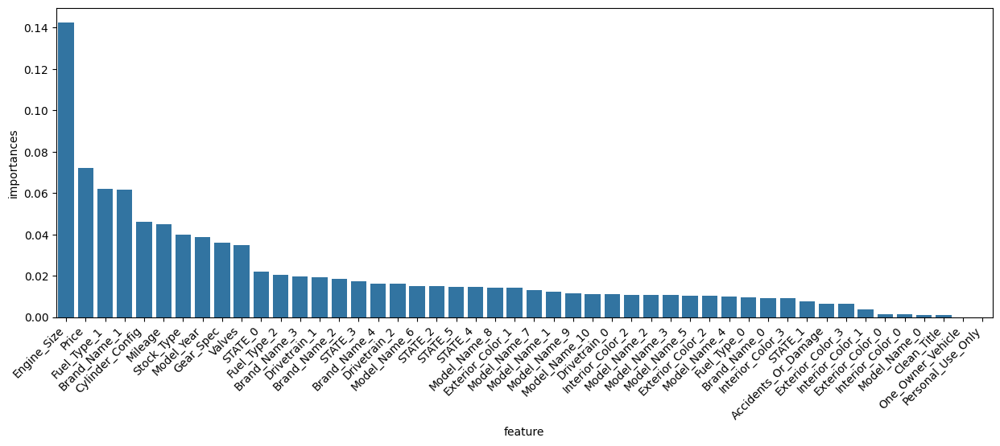

In [ ]:
fig,ax= plt.subplots(figsize=(15,5))

data = pd.DataFrame({
    'feature':feature_names,
    'importances':importances
}).sort_values(by='importances',ascending=False).assign(feature=lambda d : d['feature'].str.split('__').str.get(-1))

sns.barplot(data=data,x='feature',y='importances',ax=ax)
ax = plt.gca()

eda_helper.rotate_xlabels(ax)
plt.show()

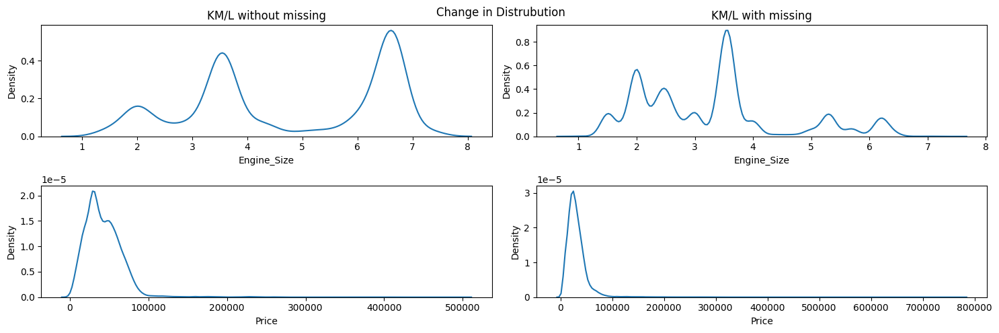

In [ ]:
fig,ax = plt.subplots(ncols=2,nrows=2,figsize=(15,5),sharey=False)
ax = np.ravel(ax)

group_with_missing = kml_df[kml_df['Km/L'].notna()]
group_without_missing = kml_df[kml_df['Km/L'].isna()]

sns.kdeplot(data=group_without_missing,x=group_without_missing['Engine_Size'],ax=ax[0])
sns.kdeplot(data=group_without_missing,x=group_without_missing['Price'],ax=ax[2])
ax[0].set_title('KM/L without missing')

sns.kdeplot(data=group_with_missing,x=group_with_missing['Engine_Size'],ax=ax[1])
sns.kdeplot(data=group_with_missing,x=group_with_missing['Price'],ax=ax[3])
ax[1].set_title('KM/L with missing')

fig.tight_layout()
fig.suptitle('Change in Distrubution')
fig.show()

### *Imputing Values*

In [ ]:
train_data = kml_df[kml_df['Km/L'].notna()]

test_data = kml_df[kml_df['Km/L'].isna()]

xtrain = train_data.drop(columns='Km/L')
ytrain = train_data['Km/L']

xtest = test_data.drop(columns='Km/L')

In [ ]:
impute_pipeline = Pipeline(
    [
        ('encoder',trf1),
        ('scaler',StandardScaler()),
        ('regressor',RandomForestRegressor())
    ]
)

impute_pipeline.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'Fuel_Type',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'Fuel_Type',
                                                   'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified'],
                                                                             ['V2',
                                                                              'I3',
                                                                              'V4',
                                                                              'I4',
                                                                              'H4',
                                                                              'I5',
                                                                              'V6',
                                                                              'I6',
                                                                              'H6',
                                                                              'V8',
                                                                              'V10',
                                                                              'V12']]),
                                                  ['Stock_Type',
                                                   'Cylinder_Config'])])),
                ('scaler', StandardScaler()),
                ('regressor', RandomForestRegressor())])

In [ ]:
kml_imputation = impute_pipeline.predict(xtest)

In [ ]:
temp = notnew_cars.copy()

temp.loc[xtest.index,'Km/L'] = kml_imputation

In [ ]:
# # imputing values
notnew_cars.loc[xtest.index,'Km/L'] = kml_imputation

# rounding off the values
notnew_cars['Km/L'] = notnew_cars['Km/L'].round()

Text(0.5, 1.0, 'After Imputation')

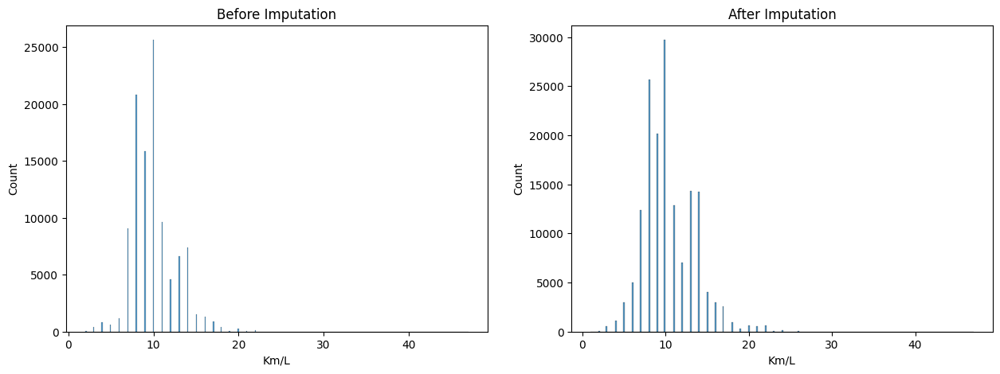

In [ ]:
fig,ax = plt.subplots(figsize=(15,5),ncols=2)

sns.histplot(data=kml_df,x='Km/L',ax=ax[0])
ax[0].set_title('Before Imputation')

sns.histplot(data = notnew_cars.query('Fuel_Type != "Electric"'),x='Km/L',ax=ax[1])
ax[1].set_title('After Imputation')


In [ ]:
notnew_cars.info()

<class 'pandas.core.frame.DataFrame'>
Index: 170334 entries, 0 to 271187
Data columns (total 28 columns):
 #   Column               Non-Null Count   Dtype   
---  ------               --------------   -----   
 0   Model_Year           170334 non-null  int64   
 1   Brand_Name           170334 non-null  category
 2   Model_Name           170334 non-null  object  
 3   Image_List           167289 non-null  object  
 4   Stock_Type           170334 non-null  object  
 5   Mileage              170086 non-null  float64 
 6   Price                170273 non-null  float64 
 7   Exterior_Color       170221 non-null  category
 8   Interior_Color       169526 non-null  category
 9   Drivetrain           170334 non-null  category
 10  Km/L                 164034 non-null  float64 
 11  Fuel_Type            170334 non-null  object  
 12  Accidents_Or_Damage  170334 non-null  bool    
 13  Clean_Title          170334 non-null  bool    
 14  One_Owner_Vehicle    168464 non-null  object  
 15  Perso

## Gear_Spec Missingness Detection and Imputation (MAR Justification)

**Steps Involved:**

- Dropped all null values except those in the `Gear_Spec` column, and removed columns that were either irrelevant for prediction or specific to electric cars.

- Converted all categorical features into numeric form using a combination of **Ordinal Encoder** and **Binary Encoder**.

- Built a **Pipeline** that included preprocessing, optional scaling, and a **RandomForestClassifier** for predicting the missing category. I chose a tree-based classifier to handle non-linear patterns without requiring power transformations.

- Trained the model with `class_weight='balanced'` so that the minority (missing) class received higher penalty during misclassification.

- The **classification report showed Recall above 90%** for the missing class, which indicates that the model was highly effective in detecting missingness using available features.  

- KDE plots of **`Km/L`** and **`Engine_Size`**, split by presence vs absence of `Gear_Spec`, showed clear distributional differences, further supporting that the missingness is **MAR** rather than MCAR.

- **Feature importance analysis** confirmed that the top predictors of missingness were `Km/L`, `Engine_Size`, `Cylinder_Config`, and `Model_Year`, which aligns with domain intuition — cars with certain mechanical configurations tend to lack properly reported gear specifications.

- A **RandomForestClassifier** was trained to impute the missing values in `Gear_Spec`. However, approximately **10,000 rows still remained unfilled** because they had missing values in multiple predictor columns simultaneously, leaving the model without sufficient input features to make a prediction.

- After completing the imputation, I verified that the **distribution of the `Gear_Spec` column remained consistent with the original distribution** observed before imputation, ensuring that no artificial skew or bias was introduced.


In [ ]:
gear_df = notnew_cars.drop(columns=['Image_List','City']).copy()

In [ ]:
# removing any null values other than gear_spec

sub = list(gear_df.columns)
sub.remove('Gear_Spec')

gear_df = gear_df.dropna(subset=sub)

gear_df = gear_df.assign(
    One_Owner_Vehicle = (
        np.where(
            gear_df['One_Owner_Vehicle'] == 'one',
            True,
            False
        )),

    Personal_Use_Only = (
        np.where(
            gear_df['Personal_Use_Only'] == 'yes',
            True,
            False
        )),

    Gear_Spec = (
        gear_df['Gear_Spec'].astype(float)
    )
)

Y= gear_df['Gear_Spec'].isna().astype(int)
X = gear_df.drop(columns='Gear_Spec')

xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.2,shuffle=True)

### *Builing Transformers & Pipeline*

In [ ]:
trf_gear = ColumnTransformer(
    transformers=[
        (
            'binary_encoder',
            BinaryEncoder(cols=['Brand_Name','Model_Name','Exterior_Color','Interior_Color','Drivetrain','Fuel_Type','STATE']),
            ['Brand_Name','Model_Name','Exterior_Color','Interior_Color','Drivetrain','Fuel_Type','STATE']
        ),
        (
            'ordinal_encoder',
            OrdinalEncoder(
                categories=[
                    ['Used','Certified'],
                     ['NA','V2', 'I3', 'V4', 'I4', 'H4', 'I5', 'V6', 'I6', 'H6', 'V8', 'V10', 'V12']
                     ]),
            ['Stock_Type','Cylinder_Config']
        )
    ],
    remainder='passthrough'
)

trf1.set_output(transform='pandas')

ColumnTransformer(remainder='passthrough',
                  transformers=[('binary_encoder',
                                 BinaryEncoder(cols=['Brand_Name', 'Model_Name',
                                                     'Exterior_Color',
                                                     'Interior_Color',
                                                     'Drivetrain', 'Fuel_Type',
                                                     'STATE']),
                                 ['Brand_Name', 'Model_Name', 'Exterior_Color',
                                  'Interior_Color', 'Drivetrain', 'Fuel_Type',
                                  'STATE']),
                                ('ordinal_encoder',
                                 OrdinalEncoder(categories=[['Used',
                                                             'Certified'],
                                                            ['V2', 'I3', 'V4',
                                                             'I4', 'H4', 'I5',
                                                             'V6', 'I6', 'H6',
                                                             'V8', 'V10',
                                                             'V12']]),
                                 ['Stock_Type', 'Cylinder_Config'])])

In [ ]:
pipe = Pipeline(
    [
        ('encode',trf_gear),
        ('scaler',StandardScaler()),
        ('model',RandomForestClassifier(class_weight='balanced'))
    ]
)

In [ ]:
pipe.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'Fuel_Type',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'Fuel_Type',
                                                   'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified'],
                                                                             ['NA',
                                                                              'V2',
                                                                              'I3',
                                                                              'V4',
                                                                              'I4',
                                                                              'H4',
                                                                              'I5',
                                                                              'V6',
                                                                              'I6',
                                                                              'H6',
                                                                              'V8',
                                                                              'V10',
                                                                              'V12']]),
                                                  ['Stock_Type',
                                                   'Cylinder_Config'])])),
                ('scaler', StandardScaler()),
                ('model', RandomForestClassifier(class_weight='balanced'))])

In [ ]:
ypred = pipe.predict(xtest)

### *Interpreting Results: To determine MAR or Not*

In [ ]:
print(classification_report(ytest,ypred))

              precision    recall  f1-score   support

           0       0.99      1.00      0.99     24807
           1       0.98      0.95      0.96      3602

    accuracy                           0.99     28409
   macro avg       0.98      0.97      0.98     28409
weighted avg       0.99      0.99      0.99     28409



In [ ]:
feature_names = pipe.named_steps['encode'].get_feature_names_out()
importances = pipe.named_steps['model'].feature_importances_

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


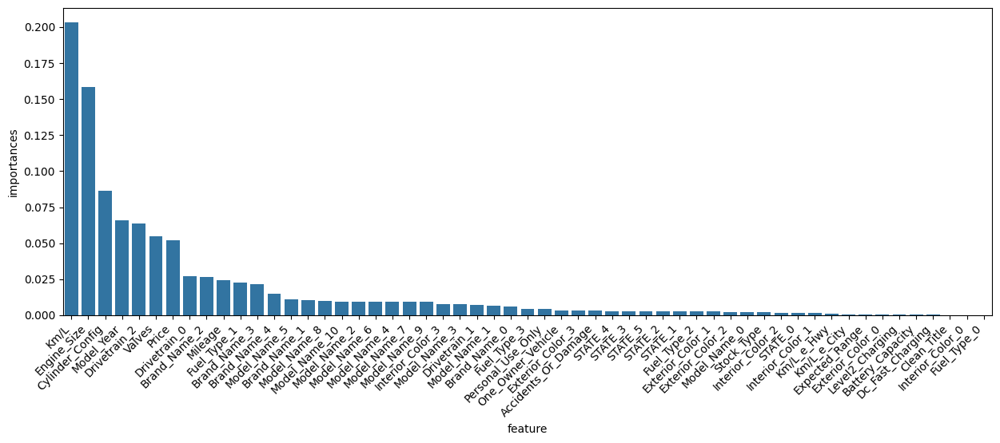

In [ ]:
fig,ax= plt.subplots(figsize=(15,5))

data = pd.DataFrame({
    'feature':feature_names,
    'importances':importances
}).sort_values(by='importances',ascending=False).assign(feature=lambda d : d['feature'].str.split('__').str.get(-1))

sns.barplot(data=data,x='feature',y='importances',ax=ax)
ax = plt.gca()

eda_helper.rotate_xlabels(ax)
plt.show()

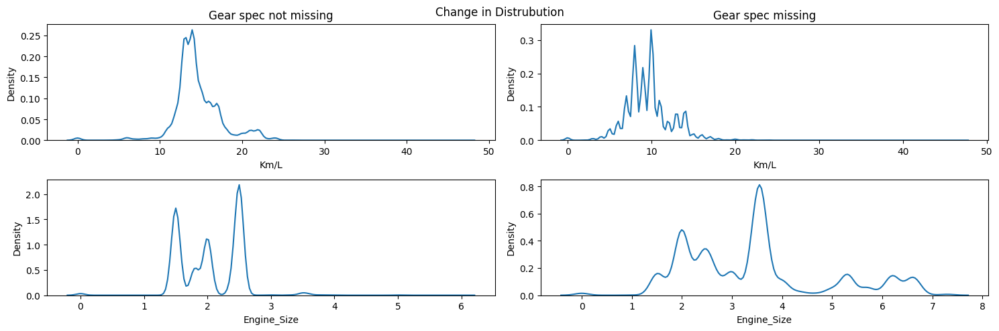

In [ ]:
fig,ax = plt.subplots(ncols=2,nrows=2,figsize=(15,5),sharey=False)
ax = np.ravel(ax)

group_with_missing = gear_df[gear_df['Gear_Spec'].notna()]
group_without_missing = gear_df[gear_df['Gear_Spec'].isna()]

sns.kdeplot(data=group_without_missing,x=group_without_missing['Km/L'],ax=ax[0])
sns.kdeplot(data=group_without_missing,x=group_without_missing['Engine_Size'],ax=ax[2])
ax[0].set_title('Gear spec not missing')

sns.kdeplot(data=group_with_missing,x=group_with_missing['Km/L'],ax=ax[1])
sns.kdeplot(data=group_with_missing,x=group_with_missing['Engine_Size'],ax=ax[3])
ax[1].set_title('Gear spec missing')

fig.tight_layout()
fig.suptitle('Change in Distrubution')
fig.show()

### *Imputing Values by Same pipeline*

In [ ]:
train_data = gear_df[gear_df['Gear_Spec'].notna()]

test_data = gear_df[gear_df['Gear_Spec'].isna()]

xtrain = train_data.drop(columns='Gear_Spec')
ytrain = train_data['Gear_Spec']

xtest = test_data.drop(columns='Gear_Spec')

In [ ]:
pipe.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'Fuel_Type',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'Fuel_Type',
                                                   'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified'],
                                                                             ['NA',
                                                                              'V2',
                                                                              'I3',
                                                                              'V4',
                                                                              'I4',
                                                                              'H4',
                                                                              'I5',
                                                                              'V6',
                                                                              'I6',
                                                                              'H6',
                                                                              'V8',
                                                                              'V10',
                                                                              'V12']]),
                                                  ['Stock_Type',
                                                   'Cylinder_Config'])])),
                ('scaler', StandardScaler()),
                ('model', RandomForestClassifier(class_weight='balanced'))])

In [ ]:
gear_impute_data = pipe.predict(xtest)

In [ ]:
# checking if it changed the distribution fundamently, if yes we will not impute in original df
temp = notnew_cars.assign(Gear_Spec = notnew_cars['Gear_Spec'].astype(float)).copy()

temp.loc[xtest.index,'Gear_Spec'] = gear_impute_data

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


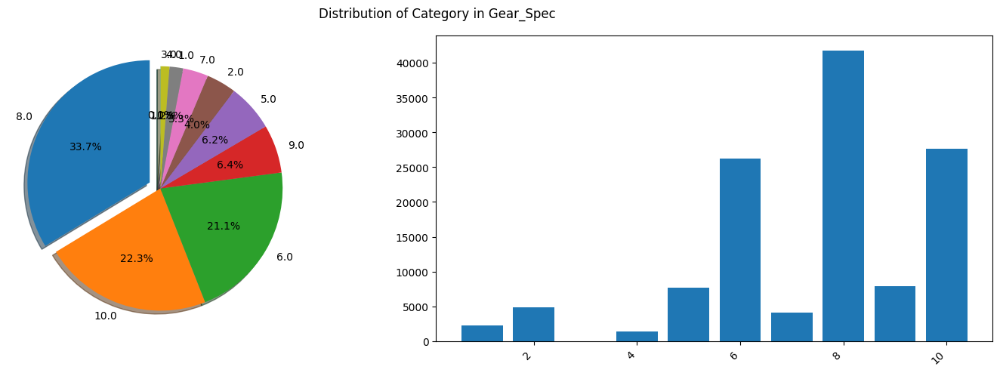

In [ ]:
eda_helper.categorical_univariate_plot(gear_df['Gear_Spec'],wrdcld=False)

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


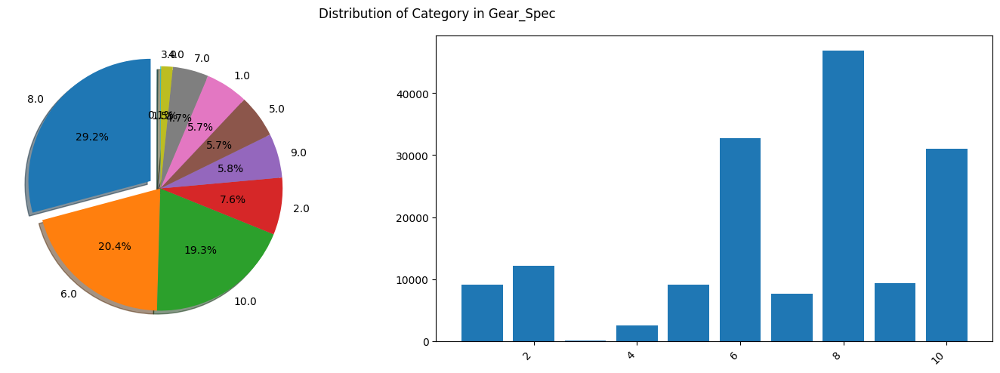

In [ ]:
eda_helper.categorical_univariate_plot(temp['Gear_Spec'],wrdcld=False)

In [ ]:
## imputing values
notnew_cars = notnew_cars.assign(Gear_Spec = notnew_cars['Gear_Spec'].astype(float))
notnew_cars.loc[xtest.index,'Gear_Spec'] = gear_impute_data

In [ ]:
notnew_cars.info()

<class 'pandas.core.frame.DataFrame'>
Index: 170334 entries, 0 to 271187
Data columns (total 28 columns):
 #   Column               Non-Null Count   Dtype   
---  ------               --------------   -----   
 0   Model_Year           170334 non-null  int64   
 1   Brand_Name           170334 non-null  category
 2   Model_Name           170334 non-null  object  
 3   Image_List           167289 non-null  object  
 4   Stock_Type           170334 non-null  object  
 5   Mileage              170086 non-null  float64 
 6   Price                170273 non-null  float64 
 7   Exterior_Color       170221 non-null  category
 8   Interior_Color       169526 non-null  category
 9   Drivetrain           170334 non-null  category
 10  Km/L                 164034 non-null  float64 
 11  Fuel_Type            170334 non-null  object  
 12  Accidents_Or_Damage  170334 non-null  bool    
 13  Clean_Title          170334 non-null  bool    
 14  One_Owner_Vehicle    168464 non-null  object  
 15  Perso

## **Valves: Detecting MAR and Imputation**

Handled missing values in the **Valves** column using a classification-based imputation strategy.  
The same preprocessing pipeline and transformer setup used for the *Km/L* feature were reused here to maintain consistency across numerical and categorical transformations.

A **RandomForestClassifier** was trained to predict the missing valve configurations.  
The model achieved strong results, with a precision of **0.98**, recall of **1.00** for the majority class, and **0.78** recall for the minority class, indicating that the classifier was effective in distinguishing between the two valve categories.

Feature importance analysis revealed that **Model_Year** and **Engine_Size** were the most influential predictors, which aligns with mechanical intuition — newer models and engines of specific capacities tend to have characteristic valve counts.

To validate the imputation quality, the **pre- and post-imputation distributions** of the Valves column were compared.  
The distributions remained nearly identical, confirming that the imputation preserved the original data characteristics and did not introduce any bias or artificial patterns.


In [ ]:
valves_df = notnew_cars.query('Fuel_Type != "Electric"').drop(columns=['Image_List','City','Level2_Charging','Dc_Fast_Charging','Battery_Capacity','Expected_Range','Km/L_e_City','Km/L_e_Hwy']).copy()

In [ ]:
# removing any null values other than kml

sub = list(valves_df.columns)
sub.remove('Valves')

valves_df = valves_df.dropna(subset=sub)

valves_df = valves_df.assign(
    One_Owner_Vehicle = (
        np.where(
            valves_df['One_Owner_Vehicle'] == 'one',
            True,
            False
        )),
    Personal_Use_Only = (
        np.where(
            valves_df['Personal_Use_Only'] == 'yes',
            True,
            False
        )),

    Gear_Spec = (
        valves_df['Gear_Spec'].astype(int)
    )
)

Y= valves_df['Valves'].isna().astype(int)
X = valves_df.drop(columns='Valves')

xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.2,shuffle=True)

### *Using the same Transformer which was used in Km/L Imputation*

In [ ]:
pipe = Pipeline(
    [
        ('encode', trf1),
        ('scaler',StandardScaler()),
        ('classifier',RandomForestClassifier(class_weight='balanced',max_depth=30,n_estimators=50))
    ]
)

In [ ]:
pipe.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'Fuel_Type',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'Fuel_Type',
                                                   'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified'],
                                                                             ['V2',
                                                                              'I3',
                                                                              'V4',
                                                                              'I4',
                                                                              'H4',
                                                                              'I5',
                                                                              'V6',
                                                                              'I6',
                                                                              'H6',
                                                                              'V8',
                                                                              'V10',
                                                                              'V12']]),
                                                  ['Stock_Type',
                                                   'Cylinder_Config'])])),
                ('scaler', StandardScaler()),
                ('classifier',
                 RandomForestClassifier(class_weight='balanced', max_depth=30,
                                        n_estimators=50))])

In [ ]:
ypred = pipe.predict(xtest)

### *Interpreting Results*

In [ ]:
# A Recall of 0.77 (or 77%) for the minority (Missing/True) class, along with a high Precision and F1-score,
# is more than sufficient to confidently conclude that the missingness mechanism is MAR (Missing At Random)
print(classification_report(y_pred=ypred,y_true=ytest))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99     28247
           1       0.98      0.78      0.87      2050

    accuracy                           0.98     30297
   macro avg       0.98      0.89      0.93     30297
weighted avg       0.98      0.98      0.98     30297



In [ ]:
feature_names = pipe.named_steps['encode'].get_feature_names_out()
importances = pipe.named_steps['classifier'].feature_importances_

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


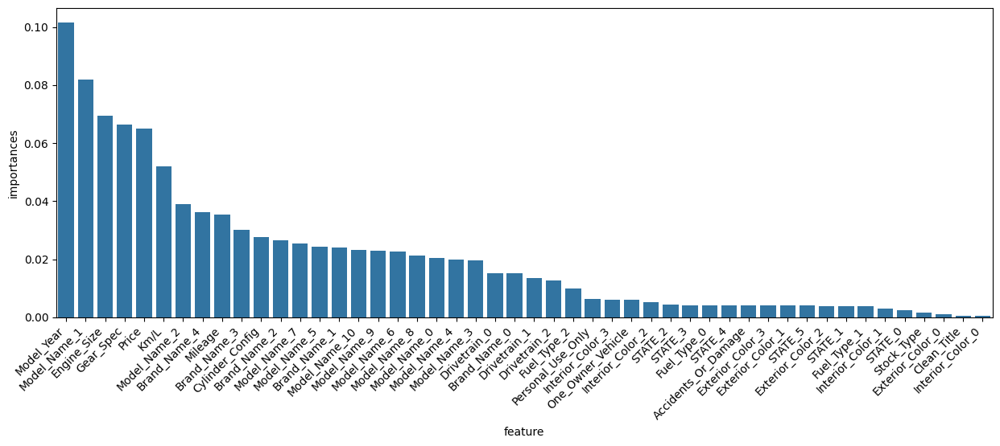

In [ ]:
fig,ax= plt.subplots(figsize=(15,5))

data = pd.DataFrame({
    'feature':feature_names,
    'importances':importances
}).sort_values(by='importances',ascending=False).assign(feature=lambda d : d['feature'].str.split('__').str.get(-1))

sns.barplot(data=data,x='feature',y='importances',ax=ax)
ax = plt.gca()

eda_helper.rotate_xlabels(ax)
plt.show()

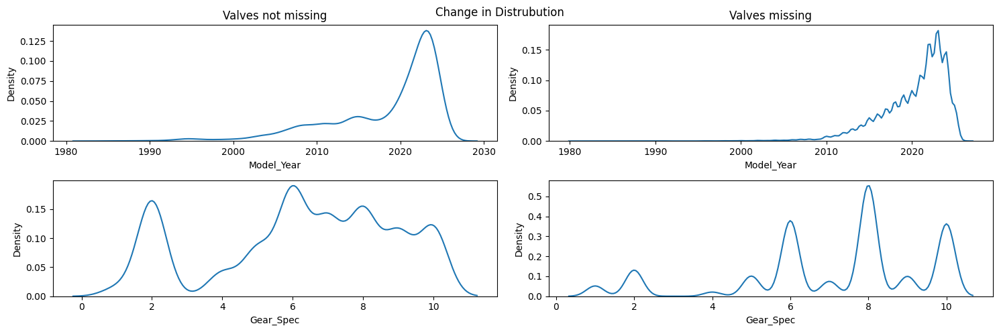

In [ ]:
fig,ax = plt.subplots(ncols=2,nrows=2,figsize=(15,5))
ax = np.ravel(ax)

group_with_missing = valves_df[valves_df['Valves'].notna()]
group_without_missing = valves_df[valves_df['Valves'].isna()]

sns.kdeplot(data=group_without_missing,x=group_without_missing['Model_Year'],ax=ax[0])
sns.kdeplot(data=group_without_missing,x=group_without_missing['Gear_Spec'],ax=ax[2])
ax[0].set_title('Valves not missing')

sns.kdeplot(data=group_with_missing,x=group_with_missing['Model_Year'],ax=ax[1])
sns.kdeplot(data=group_with_missing,x=group_with_missing['Gear_Spec'],ax=ax[3])
ax[1].set_title('Valves missing')

fig.tight_layout()
fig.suptitle('Change in Distrubution')
fig.show()

### *Imputing the values*

In [ ]:
train_data = valves_df[valves_df['Valves'].notna()]
test_data = valves_df[valves_df['Valves'].isna()]

xtrain = train_data.drop(columns='Valves')
ytrain = train_data['Valves']

xtest = test_data.drop(columns='Valves')

In [ ]:
pipe.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'Fuel_Type',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'Fuel_Type',
                                                   'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified'],
                                                                             ['V2',
                                                                              'I3',
                                                                              'V4',
                                                                              'I4',
                                                                              'H4',
                                                                              'I5',
                                                                              'V6',
                                                                              'I6',
                                                                              'H6',
                                                                              'V8',
                                                                              'V10',
                                                                              'V12']]),
                                                  ['Stock_Type',
                                                   'Cylinder_Config'])])),
                ('scaler', StandardScaler()),
                ('classifier',
                 RandomForestClassifier(class_weight='balanced', max_depth=30,
                                        n_estimators=50))])

In [ ]:
valves_impute_data = pipe.predict(xtest)

In [ ]:
# checking if it changed the distribution fundamently, if yes we will not impute in original df
temp = notnew_cars.copy()

temp.loc[xtest.index,'Valves'] = valves_impute_data

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


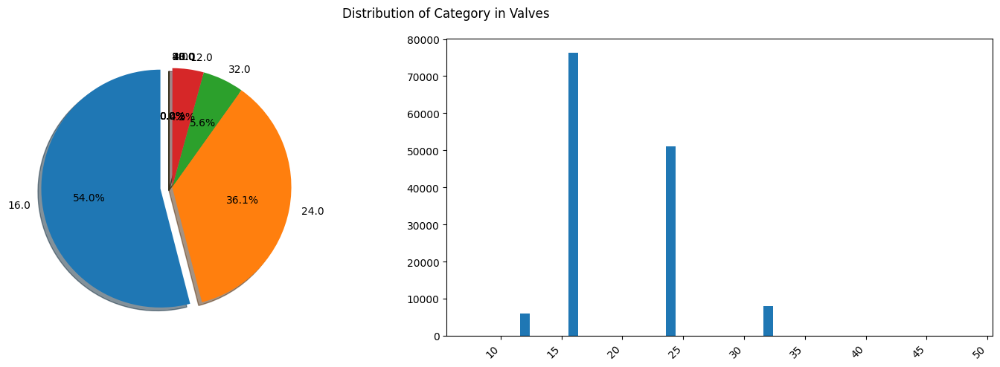

In [ ]:
eda_helper.categorical_univariate_plot(valves_df['Valves'],wrdcld=False)

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


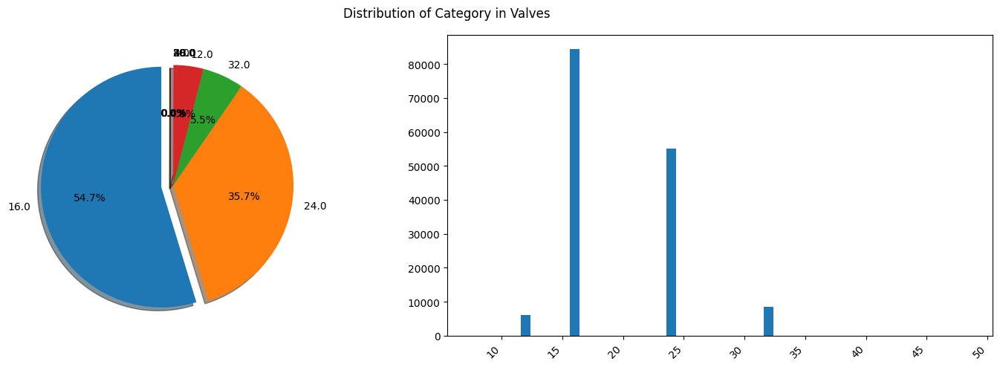

In [ ]:
eda_helper.categorical_univariate_plot(temp.query('Fuel_Type != "Electric"')['Valves'],wrdcld=False)

In [ ]:
## imputing values

notnew_cars.loc[xtest.index,'Valves'] = valves_impute_data

# **IMPUTING COLUMNS RELATED TO ELECTRIC CARS**

## **Battery_Capacity Imputation**

Handled missing values in the **Battery_Capacity** column through a combination of domain-based and model-based imputation techniques.  
Initially, performed **domain-specific imputation** by grouping data using *Model_Year* and *Name* columns, and replacing missing values with the **mode** of Battery Capacity within each group.  
This approach was based on the observation that cars with the same model and manufacturing year typically share identical battery specifications.

After applying the domain-based imputation, a few entries still had missing values.  
To understand the missingness pattern, a **RandomForestClassifier** was trained on a binary target (0 = not missing, 1 = missing).  
The classifier achieved perfect scores across all metrics (precision, recall, and F1 = 1.0), confirming that the missingness mechanism was **MAR (Missing At Random)**.  
Feature importance analysis indicated that **Model_Year**, **Km/L_e_Hwy**, and **Km/L_e_City** were the most influential predictors.

Following this, a **RandomForestRegressor** was trained to predict the remaining missing Battery Capacity values.  
Post-imputation validation showed that the **distribution of Battery_Capacity remained consistent** with the original, confirming that the imputation process did not distort the underlying data characteristics.  
The imputed values were then updated in the original dataset.


### *Domain Based Imputation*

In [ ]:
electric_col = notnew_cars.query('Fuel_Type == "Electric"')[['Model_Year','Brand_Name','Model_Name','Level2_Charging','Dc_Fast_Charging','Expected_Range','Battery_Capacity','Km/L_e_City','Km/L_e_Hwy']]

In [ ]:
# same year model car have same kind of battery capacity in most of the case, hence we will initially try to impute with groupby method
# 0 are those cars , which have nan values in battery
electric_col.groupby(['Model_Year','Model_Name'])['Battery_Capacity'].nunique().value_counts()

,count
Battery_Capacity,
1,172
0,147
2,28
3,3


In [ ]:
temp = notnew_cars.groupby(['Model_Year','Model_Name'])['Battery_Capacity'].transform(lambda x : x.mode().values[0] if not x.mode().empty else np.nan)

notnew_cars['Battery_Capacity'] = notnew_cars['Battery_Capacity'].fillna(temp)

notnew_cars = notnew_cars.assign(
    Battery_Capacity = (np.where(
                          ((notnew_cars['Fuel_Type'] == "Electric") & (notnew_cars['Battery_Capacity'] == 0)),
                          np.nan,
                          notnew_cars['Battery_Capacity']))
                  )

### *Checking Whether the data is MAR*

In [ ]:
# removing not useful cols

battery_df = notnew_cars.query('Fuel_Type == "Electric"').drop(columns=['Fuel_Type','Km/L','Engine_Size','Cylinder_Config','Valves','Image_List','City'])

In [ ]:
# removing any null values other than Battry_Capacity

sub = list(battery_df.columns)
sub.remove('Battery_Capacity')

battery_df = battery_df.dropna(subset=sub)

battery_df = battery_df.assign(
    One_Owner_Vehicle = (
        np.where(
            battery_df['One_Owner_Vehicle'] == 'one',
            True,
            False
        )),
    Personal_Use_Only = (
        np.where(
            battery_df['Personal_Use_Only'] == 'yes',
            True,
            False
        )),

    Gear_Spec = (
        battery_df['Gear_Spec'].astype(int)
    )
)

Y = battery_df['Battery_Capacity'].isna().astype(int)
X = battery_df.drop(columns='Battery_Capacity')

xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.2,shuffle=True)

In [ ]:
trf_battery = ColumnTransformer(
    transformers=[
        (
            'binary_encoder',
            BinaryEncoder(cols=['Brand_Name','Model_Name','Exterior_Color','Interior_Color','Drivetrain','STATE']),
            ['Brand_Name','Model_Name','Exterior_Color','Interior_Color','Drivetrain','STATE']
        ),
        (
            'ordinal_encoder',
            OrdinalEncoder(
                categories=[
                    ['Used','Certified']
                     ]),
            ['Stock_Type']
        )
    ],
    remainder='passthrough'
)

In [ ]:
pipe_battery = Pipeline(
    [
        ('encode',trf_battery),
        ('scaler',StandardScaler()),
        ('model',RandomForestClassifier(class_weight='balanced'))
    ]
)

In [ ]:
pipe_battery.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified']]),
                                                  ['Stock_Type'])])),
                ('scaler', StandardScaler()),
                ('model', RandomForestClassifier(class_weight='balanced'))])

In [ ]:
ypred = pipe_battery.predict(xtest)

### *Interpreting the model's result*

In [ ]:
print(classification_report(y_pred=ypred,y_true=ytest))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       393
           1       1.00      1.00      1.00       129

    accuracy                           1.00       522
   macro avg       1.00      1.00      1.00       522
weighted avg       1.00      1.00      1.00       522



In [ ]:
feature_names = pipe_battery.named_steps['encode'].get_feature_names_out()
importances = pipe_battery.named_steps['model'].feature_importances_

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


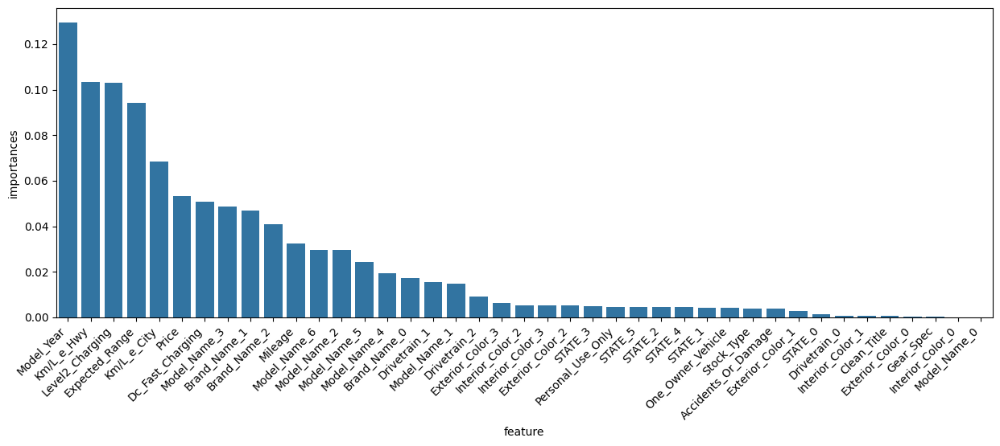

In [ ]:
fig,ax= plt.subplots(figsize=(15,5))

data = pd.DataFrame({
    'feature':feature_names,
    'importances':importances
}).sort_values(by='importances',ascending=False).assign(feature=lambda d : d['feature'].str.split('__').str.get(-1))

sns.barplot(data=data,x='feature',y='importances',ax=ax)
ax = plt.gca()

eda_helper.rotate_xlabels(ax)
plt.show()

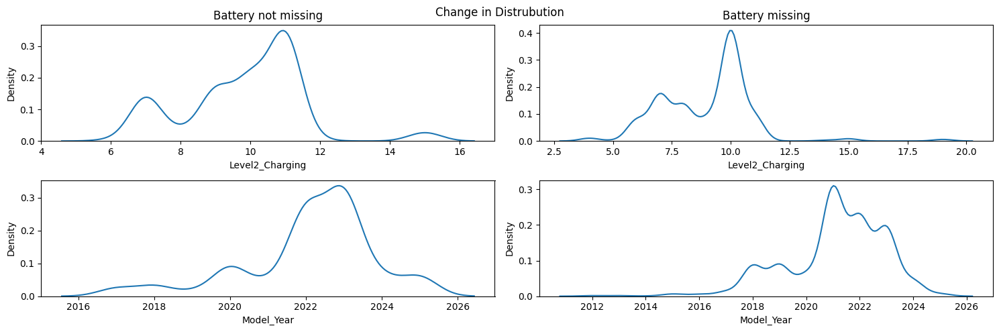

In [ ]:
fig,ax = plt.subplots(ncols=2,nrows=2,figsize=(15,5))
ax = np.ravel(ax)

group_with_missing = battery_df[battery_df['Battery_Capacity'].notna()]
group_without_missing = battery_df[battery_df['Battery_Capacity'].isna()]

sns.kdeplot(data=group_without_missing,x=group_without_missing['Level2_Charging'],ax=ax[0])
sns.kdeplot(data=group_without_missing,x=group_without_missing['Model_Year'],ax=ax[2])
ax[0].set_title('Battery not missing')

sns.kdeplot(data=group_with_missing,x=group_with_missing['Level2_Charging'],ax=ax[1])
sns.kdeplot(data=group_with_missing,x=group_with_missing['Model_Year'],ax=ax[3])
ax[1].set_title('Battery missing')

fig.tight_layout()
fig.suptitle('Change in Distrubution')
fig.show()

### *Imputing Values*

In [ ]:
train_data = battery_df[battery_df['Battery_Capacity'].notna()]
test_data = battery_df[battery_df['Battery_Capacity'].isna()]

xtrain = train_data.drop(columns='Battery_Capacity')
ytrain = train_data['Battery_Capacity']

xtest = test_data.drop(columns='Battery_Capacity')

In [ ]:
pipe_battery_reg = Pipeline(
    [
        ('encode',trf_battery),
        ('scaler',StandardScaler()),
        ('model',RandomForestRegressor())
    ]
)

In [ ]:
pipe_battery_reg.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified']]),
                                                  ['Stock_Type'])])),
                ('scaler', StandardScaler()),
                ('model', RandomForestRegressor())])

In [ ]:
battery_impute_data = pipe_battery_reg.predict(xtest)

In [ ]:
# checking if it changed the distribution fundamently, if yes we will not impute in original df
temp = notnew_cars.copy()

temp.loc[xtest.index,'Battery_Capacity'] = battery_impute_data

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


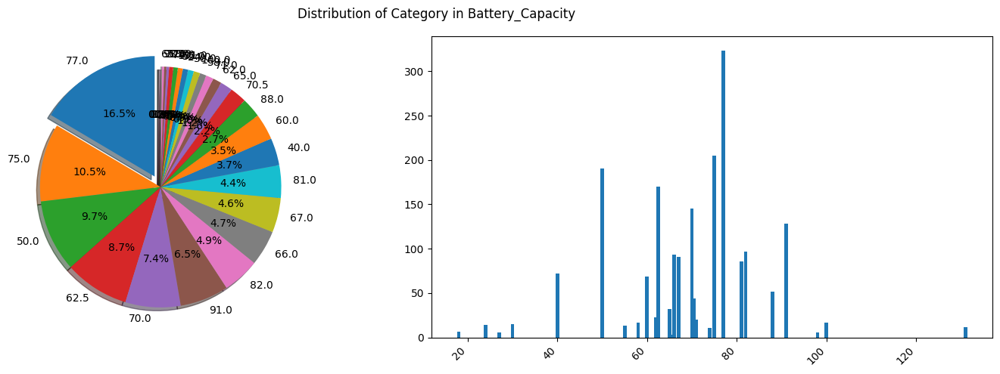

In [ ]:
eda_helper.categorical_univariate_plot(battery_df['Battery_Capacity'],wrdcld=False)

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


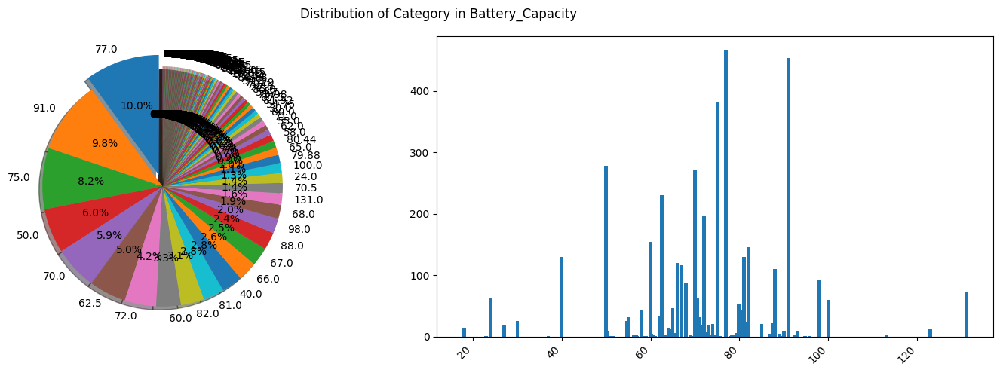

In [ ]:
data = temp.query('Fuel_Type == "Electric"')['Battery_Capacity']
eda_helper.categorical_univariate_plot(data,wrdcld=False)

In [ ]:
# imputing the data

notnew_cars.loc[xtest.index,'Battery_Capacity'] = battery_impute_data

# rounding off the values
notnew_cars['Battery_Capacity'] = notnew_cars['Battery_Capacity'].round()

## **Level2_Charging  Imputation**

Here, I imputed the values with median within group of model_year and model_name.

### *Domain Based Imputation*

In [ ]:
# most of cars with same year and name, have same level2 and dc fast charging values, so we can impute using them first
electric_col.groupby(['Model_Year','Model_Name']).agg(
    {
        'Level2_Charging' : 'nunique',
        'Dc_Fast_Charging' : 'nunique'
    }
)

Level2_Charging  \
Model_Year Model_Name                                                       
2011       Leaf SL                                                      1   
           Leaf SV                                                      1   
2012       Leaf SL                                                      1   
           Leaf SV                                                      1   
           Model S Performance                                          1   
...                                                                   ...   
2025       Mustang Mach-E Select                                        1   
           Transit-350 Base                                             1   
2026       Model Y Long Range                                           1   
           Model Y Long Range Dual Motor All-Wheel Drive                1   
           Model Y Long Range Launch Series                             0   

                                                          Dc_Fast_Charging  
Model_Year Model_Name                                                       
2011       Leaf SL                                                       0  
           Leaf SV                                                       0  
2012       Leaf SL                                                       1  
           Leaf SV                                                       0  
           Model S Performance                                           0  
...                                                                    ...  
2025       Mustang Mach-E Select                                         1  
           Transit-350 Base                                              1  
2026       Model Y Long Range                                            1  
           Model Y Long Range Dual Motor All-Wheel Drive                 1  
           Model Y Long Range Launch Series                              0  

[350 rows x 2 columns]

In [ ]:
temp = notnew_cars.groupby(['Model_Year','Model_Name'])['Level2_Charging'].transform('median')

notnew_cars.loc[temp.index,'Level2_Charging'] = temp

>  no need of model based imputation on Level2_Charging based column, as less than 100 rows are missing only.

## **Dc_Fast_Charging**

Handled missing values in the **DC_Fast_Charging** column using a mix of domain knowledge and model-based imputation.  
Initially, performed **domain-based imputation** by grouping on *Model_Year* and *Name* and filling missing values with the **median** of each group.

Next, assessed the missingness pattern using a **RandomForestClassifier** (reusing the Battery Capacity pipeline).  
The classifier achieved a recall of **93%** for the missing class, confirming the assumption of **MAR (Missing At Random)**.  
Feature importance analysis highlighted **Km/L_e_Hwy** and **Model_Year** as the strongest predictors.

A **RandomForestRegressor** was then trained to impute the remaining missing values.  
Before applying the imputation, I verified that the **distribution remained stable**, ensuring no distortion in data patterns.  
Finally, I manually corrected a few incorrect imputations by cross-verifying with external sources — all of which belonged to the same car model, **2025 Ford Transit 350 Base**.


### *Domain Based Imputation*

In [ ]:
temp = notnew_cars.groupby(['Model_Year','Model_Name'])['Dc_Fast_Charging'].transform('median')

notnew_cars['Dc_Fast_Charging'] = notnew_cars['Dc_Fast_Charging'].fillna(temp)

In [ ]:
# need to remove this wrong imputation

notnew_cars.query('Fuel_Type == "Electric" & Dc_Fast_Charging == 0')

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Km/L_e_City,Km/L_e_Hwy,City,STATE
17787,2013,Ford,Focus S,['https://platform.cstatic-images.com/xlarge/i...,Used,9640.0,7995.0,white,gray,FWD,0.0,Electric,False,True,more,no,0.0,0.0,23.0,NaN,4.0,0.0,NA,0.0,47.0,42.0,henrico,virginia
68018,2014,Ford,Focus SE,['https://platform.cstatic-images.com/xlarge/i...,Used,93599.0,4899.0,white,gray,FWD,0.0,Electric,False,True,more,yes,0.0,0.0,NaN,NaN,6.0,0.0,NA,0.0,47.0,42.0,greenfield,indiana
82762,2014,Ford,Focus SE,['https://platform.cstatic-images.com/xlarge/i...,Used,57070.0,4995.0,white,gray,FWD,0.0,Electric,True,True,more,no,0.0,0.0,NaN,NaN,1.0,0.0,NA,0.0,47.0,42.0,belleville,illinois
107640,2017,Ford,Focus SE,['https://platform.cstatic-images.com/xlarge/i...,Certified,6495.0,15000.0,blue,gray,FWD,0.0,Electric,False,True,more,no,0.0,0.0,NaN,NaN,6.0,0.0,NA,0.0,50.0,41.0,bensenville,illinois
125818,2015,Ford,Focus SE,['https://platform.cstatic-images.com/xlarge/i...,Used,66660.0,7999.0,white,gray,FWD,0.0,Electric,False,True,one,yes,0.0,0.0,NaN,NaN,6.0,0.0,NA,0.0,47.0,42.0,everett,washington
131223,2024,Mercedes-Benz,Sprinter 2500 High Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,2185.0,174999.0,white,black,RWD,0.0,Electric,False,True,NaN,yes,0.0,0.0,113.0,NaN,9.0,0.0,NA,0.0,NaN,NaN,fort lauderdale,florida
229608,2014,Ford,Focus SE,['https://platform.cstatic-images.com/xlarge/i...,Used,13624.0,8910.0,white,gray,FWD,0.0,Electric,False,True,more,no,0.0,0.0,NaN,NaN,1.0,0.0,NA,0.0,47.0,42.0,san luis obispo,california


In [ ]:
# removing zero from this column
notnew_cars = notnew_cars.assign(
    Dc_Fast_Charging = np.where(
        ((notnew_cars['Fuel_Type'] == "Electric") & (notnew_cars['Dc_Fast_Charging'] == 0)),
        np.nan,
        notnew_cars['Dc_Fast_Charging']
    )
)

### *Checking whether Dc_Fast_Charging is MAR or Not*

In [ ]:
# removing not useful cols
dc_df = notnew_cars.query('Fuel_Type == "Electric"').drop(columns=['Fuel_Type','Km/L','Engine_Size','Cylinder_Config','Valves','Image_List','City'])

In [ ]:
# removing any null values other than Battry_Capacity

sub = list(dc_df.columns)
sub.remove('Dc_Fast_Charging')

dc_df = dc_df.dropna(subset=sub)

dc_df = dc_df.assign(
    One_Owner_Vehicle = (
        np.where(
            dc_df['One_Owner_Vehicle'] == 'one',
            True,
            False
        )),
    Personal_Use_Only = (
        np.where(
            dc_df['Personal_Use_Only'] == 'yes',
            True,
            False
        )),

    Gear_Spec = (
        dc_df['Gear_Spec'].astype(int)
    )
)

Y = dc_df['Dc_Fast_Charging'].isna().astype(int)
X = dc_df.drop(columns='Dc_Fast_Charging')

xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.2,shuffle=True)

### *Reusing Battery_Capacity Pipeline*

In [ ]:
pipe_battery.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified']]),
                                                  ['Stock_Type'])])),
                ('scaler', StandardScaler()),
                ('model', RandomForestClassifier(class_weight='balanced'))])

In [ ]:
ypred = pipe_battery.predict(xtest)

### *Results: That Justify MAR*

In [ ]:
print(classification_report(ytest,ypred))

              precision    recall  f1-score   support

           0       0.99      1.00      1.00       539
           1       1.00      0.93      0.97        45

    accuracy                           0.99       584
   macro avg       1.00      0.97      0.98       584
weighted avg       0.99      0.99      0.99       584



/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


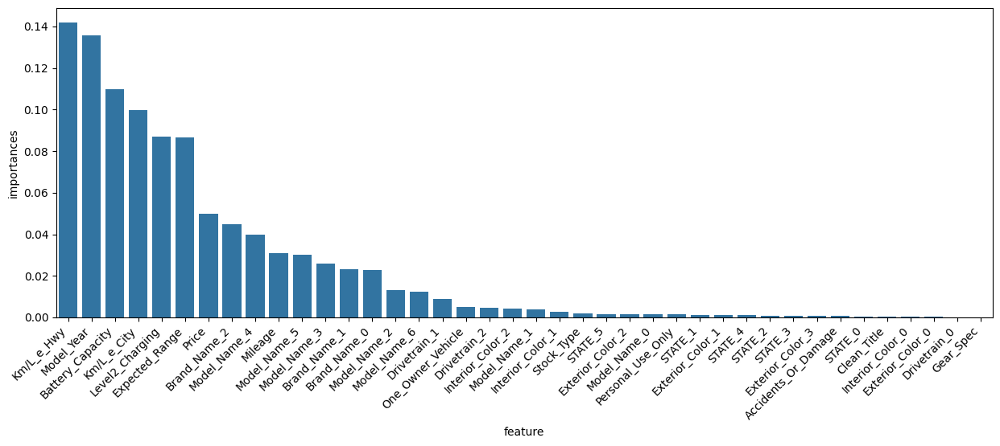

In [ ]:
feature_names = pipe_battery.named_steps['encode'].get_feature_names_out()
importances = pipe_battery.named_steps['model'].feature_importances_

fig,ax= plt.subplots(figsize=(15,5))

data = pd.DataFrame({
    'feature':feature_names,
    'importances':importances
}).sort_values(by='importances',ascending=False).assign(feature=lambda d : d['feature'].str.split('__').str.get(-1))

sns.barplot(data=data,x='feature',y='importances',ax=ax)
ax = plt.gca()

eda_helper.rotate_xlabels(ax)
plt.show()

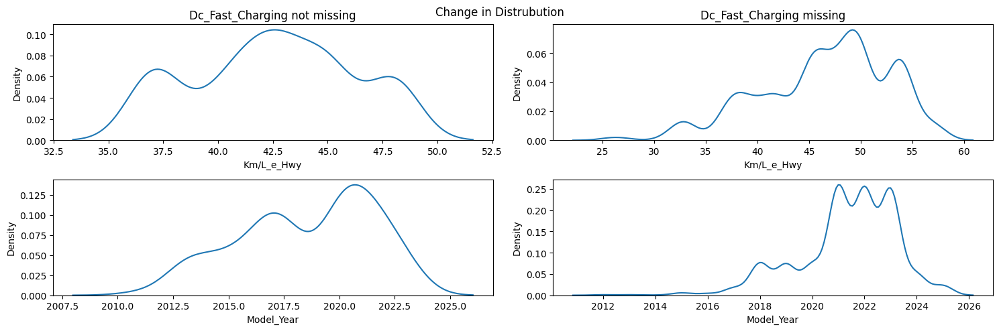

In [ ]:
# not much difference in distrubution

fig,ax = plt.subplots(ncols=2,nrows=2,figsize=(15,5))
ax = np.ravel(ax)

group_with_missing = dc_df[dc_df['Dc_Fast_Charging'].notna()]
group_without_missing = dc_df[dc_df['Dc_Fast_Charging'].isna()]

sns.kdeplot(data=group_without_missing,x=group_without_missing['Km/L_e_Hwy'],ax=ax[0])
sns.kdeplot(data=group_without_missing,x=group_without_missing['Model_Year'],ax=ax[2])
ax[0].set_title('Dc_Fast_Charging not missing')

sns.kdeplot(data=group_with_missing,x=group_with_missing['Km/L_e_Hwy'],ax=ax[1])
sns.kdeplot(data=group_with_missing,x=group_with_missing['Model_Year'],ax=ax[3])
ax[1].set_title('Dc_Fast_Charging missing')

fig.tight_layout()
fig.suptitle('Change in Distrubution')
fig.show()

### *Imputing Values*

In [ ]:
train_data = dc_df[dc_df['Dc_Fast_Charging'].notna()]
test_data = dc_df[dc_df['Dc_Fast_Charging'].isna()]

xtrain = train_data.drop(columns='Dc_Fast_Charging')
ytrain = train_data['Dc_Fast_Charging']

xtest = test_data.drop(columns='Dc_Fast_Charging')

In [ ]:
pipe_battery_reg.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified']]),
                                                  ['Stock_Type'])])),
                ('scaler', StandardScaler()),
                ('model', RandomForestRegressor())])

In [ ]:
dc_impute_data = pipe_battery_reg.predict(xtest)

In [ ]:
# checking if it changed the distribution fundamently, if yes we will not impute in original df
temp = notnew_cars.copy()

temp.loc[xtest.index,'Dc_Fast_Charging'] = dc_impute_data

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


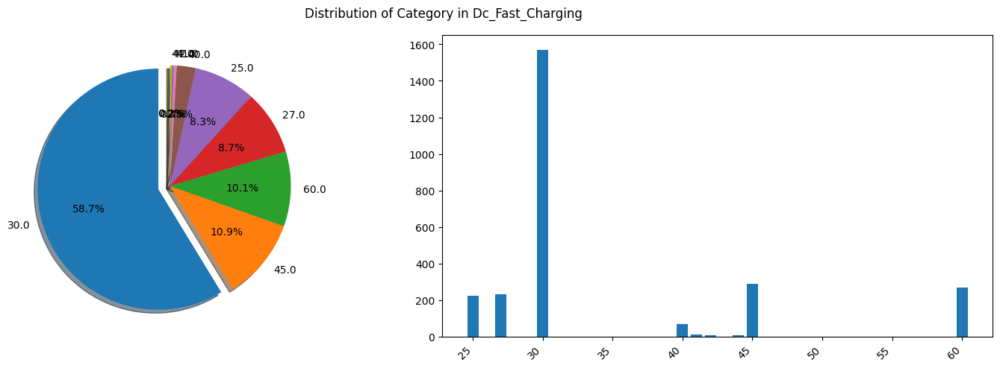

In [ ]:
eda_helper.categorical_univariate_plot(dc_df['Dc_Fast_Charging'],wrdcld=False)

/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


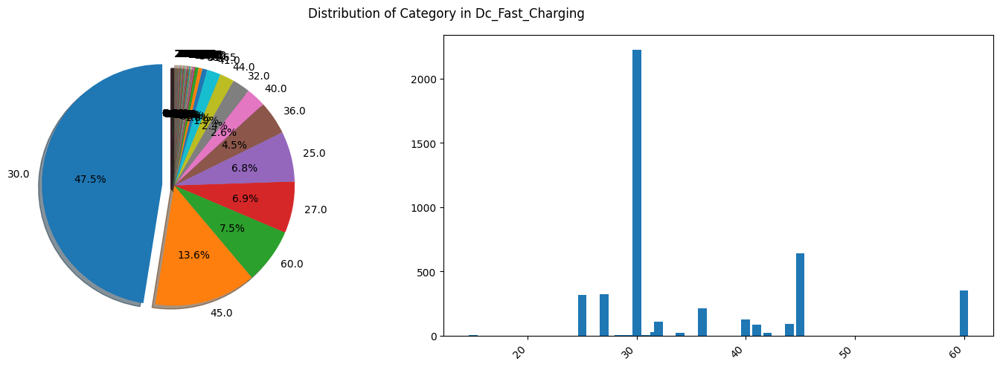

In [ ]:
eda_helper.categorical_univariate_plot(temp.query('Fuel_Type == "Electric"')['Dc_Fast_Charging'],wrdcld=False)

In [ ]:
# this imputation is wrong, so I will manually try to correct this using data present online
temp.query('Fuel_Type == "Electric" & Dc_Fast_Charging < 20')

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Km/L_e_City,Km/L_e_Hwy,City,STATE
177731,2025,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,23.0,36882.0,white,gray,RWD,0.0,Electric,False,True,one,no,6.0,15.0,89.0,227.7,10.0,0.0,NA,0.0,NaN,NaN,middleton,wisconsin
216209,2025,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,37.0,37490.0,white,gray,RWD,0.0,Electric,False,True,one,no,6.0,15.0,89.0,227.7,10.0,0.0,NA,0.0,NaN,NaN,davenport,iowa
223877,2025,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,21.0,37490.0,white,gray,RWD,0.0,Electric,False,True,one,no,6.0,15.0,89.0,227.7,10.0,0.0,NA,0.0,NaN,NaN,davenport,iowa
226111,2025,Ford,Transit-350 Base,None,Used,51.0,36882.0,white,gray,RWD,0.0,Electric,False,True,one,no,6.0,15.0,89.0,250.2,10.0,0.0,NA,0.0,NaN,NaN,middleton,wisconsin


In [ ]:
# imputing the data

notnew_cars.loc[xtest.index,'Dc_Fast_Charging'] = dc_impute_data

In [ ]:
notnew_cars['Dc_Fast_Charging'] = notnew_cars['Dc_Fast_Charging'].round()

In [ ]:
# wrong imputation, correcting all this with 30 (using official website data)
notnew_cars.query('Fuel_Type == "Electric" & Dc_Fast_Charging < 20')

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Km/L_e_City,Km/L_e_Hwy,City,STATE
177731,2025,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,23.0,36882.0,white,gray,RWD,0.0,Electric,False,True,one,no,6.0,15.0,89.0,227.7,10.0,0.0,NA,0.0,NaN,NaN,middleton,wisconsin
216209,2025,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,37.0,37490.0,white,gray,RWD,0.0,Electric,False,True,one,no,6.0,15.0,89.0,227.7,10.0,0.0,NA,0.0,NaN,NaN,davenport,iowa
223877,2025,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,21.0,37490.0,white,gray,RWD,0.0,Electric,False,True,one,no,6.0,15.0,89.0,227.7,10.0,0.0,NA,0.0,NaN,NaN,davenport,iowa
226111,2025,Ford,Transit-350 Base,None,Used,51.0,36882.0,white,gray,RWD,0.0,Electric,False,True,one,no,6.0,15.0,89.0,250.2,10.0,0.0,NA,0.0,NaN,NaN,middleton,wisconsin


In [ ]:
condition = ((notnew_cars['Fuel_Type'] == "Electric") & (notnew_cars['Dc_Fast_Charging'] < 20))
notnew_cars.loc[condition,'Dc_Fast_Charging'] = 30

In [ ]:
notnew_cars.query('Fuel_Type == "Electric"').info()

<class 'pandas.core.frame.DataFrame'>
Index: 5125 entries, 0 to 271031
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   Model_Year           5125 non-null   int64   
 1   Brand_Name           5125 non-null   category
 2   Model_Name           5125 non-null   object  
 3   Image_List           4953 non-null   object  
 4   Stock_Type           5125 non-null   object  
 5   Mileage              5119 non-null   float64 
 6   Price                5120 non-null   float64 
 7   Exterior_Color       5122 non-null   category
 8   Interior_Color       5114 non-null   category
 9   Drivetrain           5125 non-null   category
 10  Km/L                 5125 non-null   float64 
 11  Fuel_Type            5125 non-null   object  
 12  Accidents_Or_Damage  5125 non-null   bool    
 13  Clean_Title          5125 non-null   bool    
 14  One_Owner_Vehicle    5098 non-null   object  
 15  Personal_Use_Only    512

##  **Expected_Range**

Handled missing values in the **Expected_Range** column using a combination of domain-driven and model-based imputation.  
Initially, performed **domain-based imputation** by grouping data on *Model_Year* and *Name*, and filling missing values with the **median** of each group.

Next, evaluated the missingness mechanism using a **RandomForestClassifier**, which achieved metrics above **90%** across precision, recall, and F1-score — confirming the assumption of **MAR (Missing At Random)**.  
Feature importance analysis indicated that **Model_Year** and **Km/L_e_City** were the key predictors for missingness.

A **RandomForestRegressor** was then trained to predict the remaining missing Expected Range values.  
Prior to imputation, distributional checks confirmed that the overall data pattern remained unchanged, validating the reliability of the model-based imputation.  
The final imputed values were then updated in the original dataset.


### *Domain based Imputation*

In [ ]:
# checked for different model and year, that expected range vary in very small range, hence we will try to impute it with median of model year and name
electric_col[(electric_col['Model_Name'] == 'Model 3 Base') & (electric_col['Model_Year'] == 2022)]

,Model_Year,Brand_Name,Model_Name,Level2_Charging,Dc_Fast_Charging,Expected_Range,Battery_Capacity,Km/L_e_City,Km/L_e_Hwy
21061,2022,Tesla,Model 3 Base,8.0,NaN,NaN,50.0,59.0,54.0
33005,2022,Tesla,Model 3 Base,8.0,30.0,399.8,NaN,59.0,54.0
47190,2022,Tesla,Model 3 Base,8.0,30.0,401.4,NaN,59.0,54.0
57413,2022,Tesla,Model 3 Base,8.0,30.0,403.1,NaN,59.0,54.0
59825,2022,Tesla,Model 3 Base,NaN,NaN,404.7,NaN,NaN,NaN
81824,2022,Tesla,Model 3 Base,8.0,30.0,405.5,NaN,59.0,54.0
88886,2022,Tesla,Model 3 Base,8.0,NaN,NaN,50.0,59.0,54.0
103690,2022,Tesla,Model 3 Base,NaN,NaN,406.3,NaN,NaN,NaN
110305,2022,Tesla,Model 3 Base,NaN,NaN,407.9,NaN,NaN,NaN
117725,2022,Tesla,Model 3 Base,8.0,30.0,407.1,NaN,59.0,54.0


In [ ]:
temp = notnew_cars.groupby(['Model_Year','Model_Name'])['Expected_Range'].transform('median')

notnew_cars['Expected_Range'] = notnew_cars['Expected_Range'].fillna(temp)

In [ ]:
# correcting this wrong values
notnew_cars.query('Fuel_Type == "Electric" & Expected_Range == 0')

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Km/L_e_City,Km/L_e_Hwy,City,STATE
17787,2013,Ford,Focus S,['https://platform.cstatic-images.com/xlarge/i...,Used,9640.0,7995.0,white,gray,FWD,0.0,Electric,False,True,more,no,0.0,NaN,23.0,0.0,4.0,0.0,NA,0.0,47.0,42.0,henrico,virginia
25678,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,42426.0,22999.0,white,gray,RWD,0.0,Electric,False,True,one,yes,0.0,34.0,68.0,0.0,10.0,0.0,NA,0.0,NaN,NaN,charlotte,north carolina
29116,2022,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,2530.0,24900.0,white,black,RWD,0.0,Electric,False,True,one,no,0.0,34.0,68.0,0.0,10.0,0.0,NA,0.0,NaN,NaN,mechanicville,new york
36354,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,1290.0,27444.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,68.0,0.0,10.0,0.0,NA,0.0,NaN,NaN,huntley,illinois
51022,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,19854.0,28699.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,68.0,0.0,10.0,0.0,NA,0.0,NaN,NaN,hooksett,new hampshire
58787,2022,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,38712.0,21999.0,white,gray,RWD,0.0,Electric,False,True,more,no,0.0,34.0,68.0,0.0,10.0,0.0,NA,0.0,NaN,NaN,charlotte,north carolina
68018,2014,Ford,Focus SE,['https://platform.cstatic-images.com/xlarge/i...,Used,93599.0,4899.0,white,gray,FWD,0.0,Electric,False,True,more,yes,0.0,NaN,NaN,0.0,6.0,0.0,NA,0.0,47.0,42.0,greenfield,indiana
70253,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,30816.0,23499.0,white,gray,RWD,0.0,Electric,False,True,more,no,0.0,34.0,68.0,0.0,10.0,0.0,NA,0.0,NaN,NaN,charlotte,north carolina
77691,2024,Mercedes-Benz,Sprinter 2500 High Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,11.0,54336.0,silver,black,RWD,0.0,Electric,False,True,one,yes,0.0,42.0,113.0,0.0,9.0,0.0,NA,0.0,NaN,NaN,medford,oregon
82762,2014,Ford,Focus SE,['https://platform.cstatic-images.com/xlarge/i...,Used,57070.0,4995.0,white,gray,FWD,0.0,Electric,True,True,more,no,0.0,NaN,NaN,0.0,1.0,0.0,NA,0.0,47.0,42.0,belleville,illinois


In [ ]:
# correcting those wrong imputation
notnew_cars.loc[notnew_cars.query('Fuel_Type == "Electric" & Expected_Range == 0').index,'Expected_Range'] = np.nan

### *Checking if the Expected_Range is MAR*

In [ ]:
# removing not useful cols

range_df = notnew_cars.query('Fuel_Type == "Electric"').drop(columns=['Fuel_Type','Km/L','Engine_Size','Cylinder_Config','Valves','Image_List','City'])

In [ ]:
# removing any null values other than Battry_Capacity

sub = list(range_df.columns)
sub.remove('Expected_Range')

range_df = range_df.dropna(subset=sub)

range_df = range_df.assign(
    One_Owner_Vehicle = (
        np.where(
            range_df['One_Owner_Vehicle'] == 'one',
            True,
            False
        )),
    Personal_Use_Only = (
        np.where(
            range_df['Personal_Use_Only'] == 'yes',
            True,
            False
        )),

    Gear_Spec = (
        range_df['Gear_Spec'].astype(int)
    )
)

Y = range_df['Expected_Range'].isna().astype(int)
X = range_df.drop(columns='Expected_Range')

xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.2,shuffle=True)

### *Reusing Battery Pipeline*

In [ ]:
pipe_battery.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified']]),
                                                  ['Stock_Type'])])),
                ('scaler', StandardScaler()),
                ('model', RandomForestClassifier(class_weight='balanced'))])

In [ ]:
ypred = pipe_battery.predict(xtest)

### *Justification for MAR*

In [ ]:
print(classification_report(ytest,ypred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       605
           1       0.97      0.97      0.97        36

    accuracy                           1.00       641
   macro avg       0.99      0.99      0.99       641
weighted avg       1.00      1.00      1.00       641



/content/eda_helper.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  return ax.set_xticklabels(


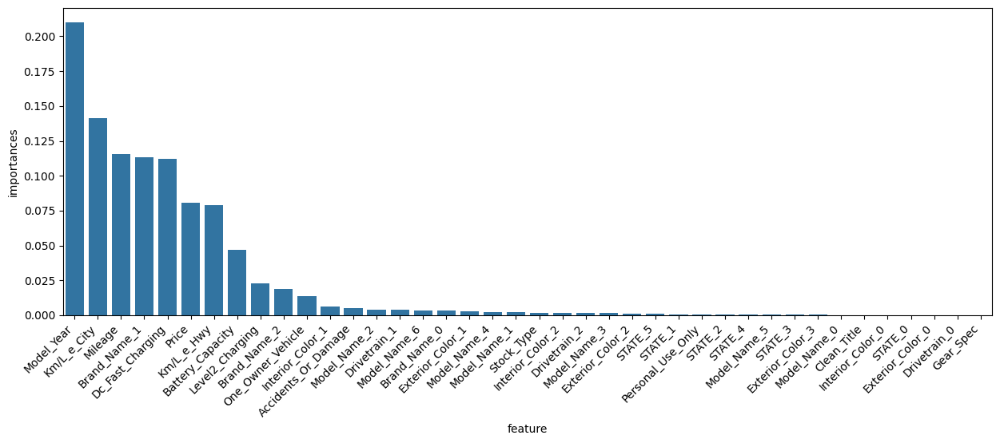

In [ ]:
feature_names = pipe_battery.named_steps['encode'].get_feature_names_out()
importances = pipe_battery.named_steps['model'].feature_importances_

fig,ax= plt.subplots(figsize=(15,5))

data = pd.DataFrame({
    'feature':feature_names,
    'importances':importances
}).sort_values(by='importances',ascending=False).assign(feature=lambda d : d['feature'].str.split('__').str.get(-1))

sns.barplot(data=data,x='feature',y='importances',ax=ax)
ax = plt.gca()

eda_helper.rotate_xlabels(ax)
plt.show()

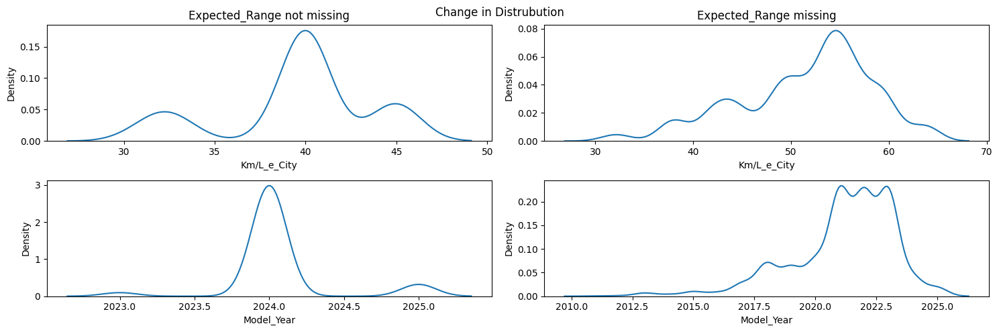

In [ ]:
# not much difference in distrubution

fig,ax = plt.subplots(ncols=2,nrows=2,figsize=(15,5))
ax = np.ravel(ax)

group_with_missing = range_df[range_df['Expected_Range'].notna()]
group_without_missing = range_df[range_df['Expected_Range'].isna()]

sns.kdeplot(data=group_without_missing,x=group_without_missing['Km/L_e_City'],ax=ax[0])
sns.kdeplot(data=group_without_missing,x=group_without_missing['Model_Year'],ax=ax[2])
ax[0].set_title('Expected_Range not missing')

sns.kdeplot(data=group_with_missing,x=group_with_missing['Km/L_e_City'],ax=ax[1])
sns.kdeplot(data=group_with_missing,x=group_with_missing['Model_Year'],ax=ax[3])
ax[1].set_title('Expected_Range missing')

fig.tight_layout()
fig.suptitle('Change in Distrubution')
fig.show()

### *Imputing Values*

In [ ]:
train_data = range_df[range_df['Expected_Range'].notna()]
test_data = range_df[range_df['Expected_Range'].isna()]

xtrain = train_data.drop(columns='Expected_Range')
ytrain = train_data['Expected_Range']

xtest = test_data.drop(columns='Expected_Range')

In [ ]:
range_pipe = Pipeline(
    [
        ('encode',trf_battery),
        ('scaler',StandardScaler()),
        ('model',RandomForestRegressor())
    ]
)

In [ ]:
range_pipe.fit(xtrain,ytrain)

/usr/local/lib/python3.12/dist-packages/sklearn/compose/_column_transformer.py:1667: FutureWarning: 
The format of the columns of the 'remainder' transformer in ColumnTransformer.transformers_ will change in version 1.7 to match the format of the other transformers.
At the moment the remainder columns are stored as indices (of type int). With the same ColumnTransformer configuration, in the future they will be stored as column names (of type str).
To use the new behavior now and suppress this warning, use ColumnTransformer(force_int_remainder_cols=False).

  warnings.warn(


Pipeline(steps=[('encode',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary_encoder',
                                                  BinaryEncoder(cols=['Brand_Name',
                                                                      'Model_Name',
                                                                      'Exterior_Color',
                                                                      'Interior_Color',
                                                                      'Drivetrain',
                                                                      'STATE']),
                                                  ['Brand_Name', 'Model_Name',
                                                   'Exterior_Color',
                                                   'Interior_Color',
                                                   'Drivetrain', 'STATE']),
                                                 ('ordinal_encoder',
                                                  OrdinalEncoder(categories=[['Used',
                                                                              'Certified']]),
                                                  ['Stock_Type'])])),
                ('scaler', StandardScaler()),
                ('model', RandomForestRegressor())])

In [ ]:
expected_range_impute_data = range_pipe.predict(xtest)

In [ ]:
expected_range_impute_data = np.round(expected_range_impute_data,1)

In [ ]:
# checking if it changed the distribution fundamently, if yes we will not impute in original df
temp = notnew_cars.copy()

temp.loc[xtest.index,'Expected_Range'] = expected_range_impute_data

Text(0.5, 1.0, 'After Imputation')

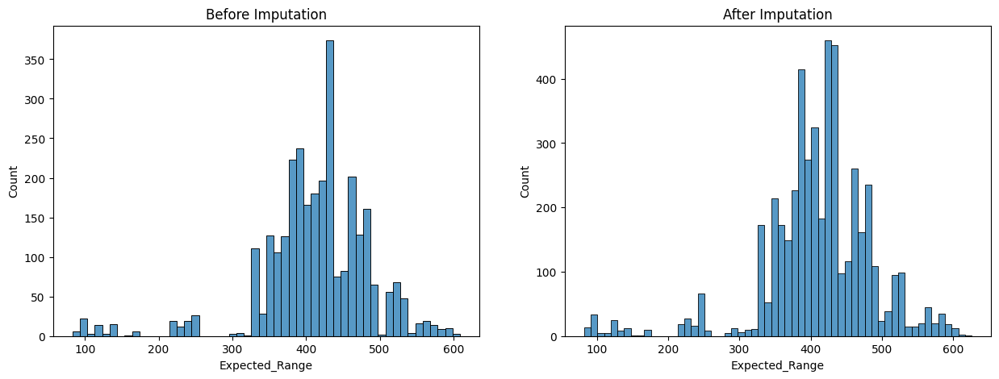

In [ ]:
fig,ax = plt.subplots(figsize=(15,5),ncols=2)

sns.histplot(data=range_df,x='Expected_Range',ax=ax[0])
ax[0].set_title('Before Imputation')

sns.histplot(data = temp.query('Fuel_Type == "Electric"'),x='Expected_Range',ax=ax[1])
ax[1].set_title('After Imputation')

In [ ]:
# imputing values
notnew_cars.loc[xtest.index,'Expected_Range'] = expected_range_impute_data

In [ ]:
notnew_cars.query('Fuel_Type == "Electric"').info()

<class 'pandas.core.frame.DataFrame'>
Index: 5125 entries, 0 to 271031
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   Model_Year           5125 non-null   int64   
 1   Brand_Name           5125 non-null   category
 2   Model_Name           5125 non-null   object  
 3   Image_List           4953 non-null   object  
 4   Stock_Type           5125 non-null   object  
 5   Mileage              5119 non-null   float64 
 6   Price                5120 non-null   float64 
 7   Exterior_Color       5122 non-null   category
 8   Interior_Color       5114 non-null   category
 9   Drivetrain           5125 non-null   category
 10  Km/L                 5125 non-null   float64 
 11  Fuel_Type            5125 non-null   object  
 12  Accidents_Or_Damage  5125 non-null   bool    
 13  Clean_Title          5125 non-null   bool    
 14  One_Owner_Vehicle    5098 non-null   object  
 15  Personal_Use_Only    512

## **Km/L_e_City**

Imputed with median of `Model_Year` & `Model_Name` group

### *Domain Based Imputation*

In [ ]:
electric_col.sample(2)

,Model_Year,Brand_Name,Model_Name,Level2_Charging,Dc_Fast_Charging,Expected_Range,Battery_Capacity,Km/L_e_City,Km/L_e_Hwy
82304,2021,Tesla,Model 3 Performance,10.0,30.0,449.7,NaN,50.0,45.0
68786,2023,Ford,Mustang Mach-E Premium,NaN,NaN,385.4,NaN,NaN,NaN


In [ ]:
electric_col.groupby(['Model_Year','Model_Name']).agg(
    {
        'Km/L_e_City' : 'nunique',
        'Km/L_e_Hwy' : 'nunique'
    }
).value_counts()

Km/L_e_City  Km/L_e_Hwy
1            1             219
0            0              62
2            2              51
             1               6
3            3               6
4            4               2
3            2               2
1            2               1
2            3               1
Name: count, dtype: int64

In [ ]:
temp = notnew_cars.groupby(['Model_Year','Model_Name'])['Km/L_e_City'].transform('median')

notnew_cars['Km/L_e_City'] = notnew_cars['Km/L_e_City'].fillna(temp)

In [ ]:
# wrong imputation

idx = notnew_cars[(notnew_cars['Fuel_Type'] == "Electric") & (notnew_cars['Km/L_e_City'] == 0)]
notnew_cars[(notnew_cars['Fuel_Type'] == "Electric") & (notnew_cars['Km/L_e_City'] == 0)]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Km/L_e_City,Km/L_e_Hwy,City,STATE
25678,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,42426.0,22999.0,white,gray,RWD,0.0,Electric,False,True,one,yes,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,0.0,NaN,charlotte,north carolina
29116,2022,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,2530.0,24900.0,white,black,RWD,0.0,Electric,False,True,one,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,0.0,NaN,mechanicville,new york
36354,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,1290.0,27444.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,0.0,NaN,huntley,illinois
51022,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,19854.0,28699.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,0.0,NaN,hooksett,new hampshire
58787,2022,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,38712.0,21999.0,white,gray,RWD,0.0,Electric,False,True,more,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,0.0,NaN,charlotte,north carolina
70253,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,30816.0,23499.0,white,gray,RWD,0.0,Electric,False,True,more,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,0.0,NaN,charlotte,north carolina
77691,2024,Mercedes-Benz,Sprinter 2500 High Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,11.0,54336.0,silver,black,RWD,0.0,Electric,False,True,one,yes,0.0,42.0,113.0,NaN,9.0,0.0,NA,0.0,0.0,NaN,medford,oregon
90030,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,100.0,33990.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,NaN,NaN,10.0,0.0,NA,0.0,0.0,NaN,marion,ohio
105582,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,15.0,36990.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,NaN,NaN,10.0,0.0,NA,0.0,0.0,NaN,marion,ohio
130582,2023,Ford,Transit-350 Base,None,Used,20.0,36990.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,NaN,NaN,10.0,0.0,NA,0.0,0.0,NaN,marion,ohio


In [ ]:
notnew_cars.loc[idx.index,'Km/L_e_City'] = np.nan

## **Km/L_e_Hwy**

Imputed with median of `Model_Year` & `Model_Name` group

### *Domain Based Imputation*

In [ ]:
temp = notnew_cars.groupby(['Model_Year','Model_Name'])['Km/L_e_Hwy'].transform('median')

notnew_cars['Km/L_e_Hwy'] = notnew_cars['Km/L_e_Hwy'].fillna(temp)

In [ ]:
# wrong imputation

idx = notnew_cars[(notnew_cars['Fuel_Type'] == "Electric") & (notnew_cars['Km/L_e_Hwy'] == 0)]
notnew_cars[(notnew_cars['Fuel_Type'] == "Electric") & (notnew_cars['Km/L_e_Hwy'] == 0)]

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Km/L_e_City,Km/L_e_Hwy,City,STATE
25678,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,42426.0,22999.0,white,gray,RWD,0.0,Electric,False,True,one,yes,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,NaN,0.0,charlotte,north carolina
29116,2022,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,2530.0,24900.0,white,black,RWD,0.0,Electric,False,True,one,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,NaN,0.0,mechanicville,new york
36354,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,1290.0,27444.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,NaN,0.0,huntley,illinois
51022,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,19854.0,28699.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,NaN,0.0,hooksett,new hampshire
58787,2022,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,38712.0,21999.0,white,gray,RWD,0.0,Electric,False,True,more,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,NaN,0.0,charlotte,north carolina
70253,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,30816.0,23499.0,white,gray,RWD,0.0,Electric,False,True,more,no,0.0,34.0,68.0,NaN,10.0,0.0,NA,0.0,NaN,0.0,charlotte,north carolina
77691,2024,Mercedes-Benz,Sprinter 2500 High Roof,['https://platform.cstatic-images.com/xlarge/i...,Used,11.0,54336.0,silver,black,RWD,0.0,Electric,False,True,one,yes,0.0,42.0,113.0,NaN,9.0,0.0,NA,0.0,NaN,0.0,medford,oregon
90030,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,100.0,33990.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,NaN,NaN,10.0,0.0,NA,0.0,NaN,0.0,marion,ohio
105582,2023,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,15.0,36990.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,NaN,NaN,10.0,0.0,NA,0.0,NaN,0.0,marion,ohio
130582,2023,Ford,Transit-350 Base,None,Used,20.0,36990.0,white,gray,RWD,0.0,Electric,False,True,one,no,0.0,34.0,NaN,NaN,10.0,0.0,NA,0.0,NaN,0.0,marion,ohio


In [ ]:
notnew_cars.loc[idx.index,'Km/L_e_Hwy'] = np.nan

# Stretagy to fill the remaining NaN values in Continuous Columns
I attempted to impute missing values all columns. Before training any models, I filtered the dataset to include only relevant rows (for example, excluding electric cars where applicable) and dropped columns that were not useful for prediction. I also removed any rows containing missing values in other predictor columns to ensure that only the target column under imputation was missing during model training.

For each of the columns, I split the data into two subsets: rows where the column was present (to be used as training data) and rows where it was missing (to be used for prediction). I then trained a RandomForest-based model (classifier or regressor depending on the column) and used it to predict the missing values (This is done before the justification of MAR assuption).

Although this approach successfully imputed a large portion of the missing values, there were still several thousand rows across these columns that remained unfilled. The reason was consistent: some rows were missing values in multiple columns simultaneously, so the model could not generate predictions because the necessary input features were absent.

This exposed a real-world limitation of sequential, `one-column-at-a-time imputation`. If I continue imputing each column independently, there is a risk of bias, because later imputations would depend on values that were already imputed earlier rather than originally observed.

To address this, a more robust strategy is needed. Instead of performing strictly sequential imputation, I can follow a hybrid two-stage process:

1. Apply model-based imputation (such as RandomForest Regressor or Classifier) to fill values where there is sufficient data available.
2. For the remaining rows where multiple columns are still missing, apply a multivariate imputation technique such as **MICE (Multiple Imputation by Chained Equations)**, which imputes all remaining missing columns jointly and iteratively.

This approach preserves the accuracy of targeted model-based imputation while reducing bias through multivariate consistency. It ensures that columns where even small amout of data is missing get imputed in a way that accounts for their interdependence rather than treating each column in isolation.


# **Iterative Imputation**

## **Continuous Variable Imputation**

### **Why I didn't Imputed the Mileage and Price values**

The **Mileage** and **Price** columns were treated differently because imputing them could introduce misleading results.  

> Mileage

For **Mileage**, I dropped the few rows with missing values (around 100 rows). This is because Mileage behaves like a **MNAR (Missing Not At Random)** column — its value depends heavily on the car itself, and there isn’t enough reliable information from other features to accurately predict it. Since the missing portion is very small, dropping these rows does not significantly affect the dataset.

> Price

For **Price**, I did not perform any imputation due to the risk of **data leakage**.  

Suppose a row has a missing price and we impute it using a regression or ML model with features like Mileage, Year, Brand, or Stock Type. The imputed price is no longer truly real — it is partly predicted from the same features we use to train the main model.  

If we then train a model to predict Price using those features, it will appear to perform well because it is indirectly learning from values that were already derived from the same features. This creates **leakage**, where the model is evaluated against data that already contains hints of the answer, leading to inflated performance metrics that won’t generalize to real-world predictions.  

Hence, to maintain model reliability, I left the Price column as is and did not impute missing values.


### **Imputation of Numerical Columns with Iterative Imputer with RandomoForest Regressor setting.**

For the remaining continuous columns, I used a **RandomForestRegressor** to impute missing values.  
After training, I verified that the imputation did not alter the overall **distribution** of the data, ensuring that the original patterns were preserved.  

A few incorrect imputations were identified, which I manually corrected by cross-checking with reliable sources.  
Finally, the verified imputed values were updated in the **original columns** to complete the dataset.




In [ ]:
# don't want any imputation in Mileage (MAR) and Price (Output col imputation will lead to artificial inflation on train data) column

notnew_cars = notnew_cars.dropna(subset=['Mileage','Price'])

In [ ]:
notnew_cars.info()

<class 'pandas.core.frame.DataFrame'>
Index: 170033 entries, 0 to 271187
Data columns (total 28 columns):
 #   Column               Non-Null Count   Dtype   
---  ------               --------------   -----   
 0   Model_Year           170033 non-null  int64   
 1   Brand_Name           170033 non-null  category
 2   Model_Name           170033 non-null  object  
 3   Image_List           167048 non-null  object  
 4   Stock_Type           170033 non-null  object  
 5   Mileage              170033 non-null  float64 
 6   Price                170033 non-null  float64 
 7   Exterior_Color       169933 non-null  category
 8   Interior_Color       169286 non-null  category
 9   Drivetrain           170033 non-null  category
 10  Km/L                 170033 non-null  float64 
 11  Fuel_Type            170033 non-null  object  
 12  Accidents_Or_Damage  170033 non-null  bool    
 13  Clean_Title          170033 non-null  bool    
 14  One_Owner_Vehicle    168269 non-null  object  
 15  Perso

<Axes: >

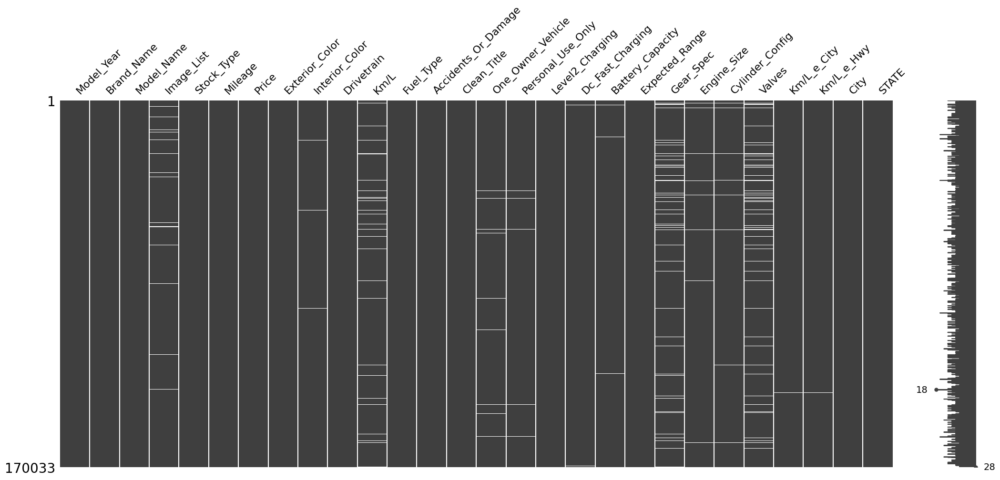

In [ ]:
msno.matrix(notnew_cars)

In [ ]:
cont_df = notnew_cars.drop(columns=['Image_List','Exterior_Color','Interior_Color','One_Owner_Vehicle','Personal_Use_Only','Gear_Spec','Cylinder_Config','Valves'])

In [ ]:
cont_trf = ColumnTransformer(
    transformers=[
        ('nominal',BinaryEncoder(cols=['Brand_Name','Model_Name','Drivetrain','Fuel_Type','City','STATE']),['Brand_Name','Model_Name','Drivetrain','Fuel_Type','City','STATE']),
        ('ordinal',OrdinalEncoder(categories=[['Used','Certified']]),['Stock_Type'])
    ],
    remainder='passthrough'
)

cont_pipe = Pipeline(
    [
        ('encoder',cont_trf),
        ('imputer',IterativeImputer(estimator=RandomForestRegressor(n_estimators=10,n_jobs=-1),initial_strategy='median',max_iter=5))
    ]
)

cont_pipe.set_output(transform='pandas')

cont_df_trf = cont_pipe.fit_transform(cont_df)

In [ ]:
cols = ['Km/L','Level2_Charging','Dc_Fast_Charging','Battery_Capacity','Expected_Range','Engine_Size','Km/L_e_City','Km/L_e_Hwy']

cols_trf = ['remainder__'+col for col in cols]

cont_df_trf[cols_trf]

,remainder__Km/L,remainder__Level2_Charging,remainder__Dc_Fast_Charging,remainder__Battery_Capacity,remainder__Expected_Range,remainder__Engine_Size,remainder__Km/L_e_City,remainder__Km/L_e_Hwy,remainder__Price,remainder__Mileage
0,0.0,19.0,41.0,131.0,466.6,0.0,31.0,26.0,48500.0,27565.0
2,5.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,16998.0,117487.0
3,7.0,0.0,0.0,0.0,0.0,6.2,0.0,0.0,54495.0,63052.0
4,11.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,40204.0,9531.0
5,4.0,0.0,0.0,0.0,0.0,3.5,0.0,0.0,21950.0,84516.0
...,...,...,...,...,...,...,...,...,...,...
271183,10.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,23967.0,26519.0
271184,9.0,0.0,0.0,0.0,0.0,2.4,0.0,0.0,41530.0,12255.0
271185,10.0,0.0,0.0,0.0,0.0,3.6,0.0,0.0,24366.0,18949.0
271186,11.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,70995.0,6406.0


/tmp/ipython-input-3030799590.py:8: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=notnew_cars.loc[non_electric_idx.index,:],x=col,ax=axes)
/tmp/ipython-input-3030799590.py:8: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=notnew_cars.loc[non_electric_idx.index,:],x=col,ax=axes)
/tmp/ipython-input-3030799590.py:9: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=cont_df_trf.loc[non_electric_idx.index,:],x='remainder__'+col,ax=axes)
/tmp/ipython-input-3030799590.py:8: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(data=notnew_cars.loc[non_electric_idx.index,:],x=col,ax=axes)
/tmp/ipython-input-3030799590.py:9: UserWarning: Dataset has 0 variance; s

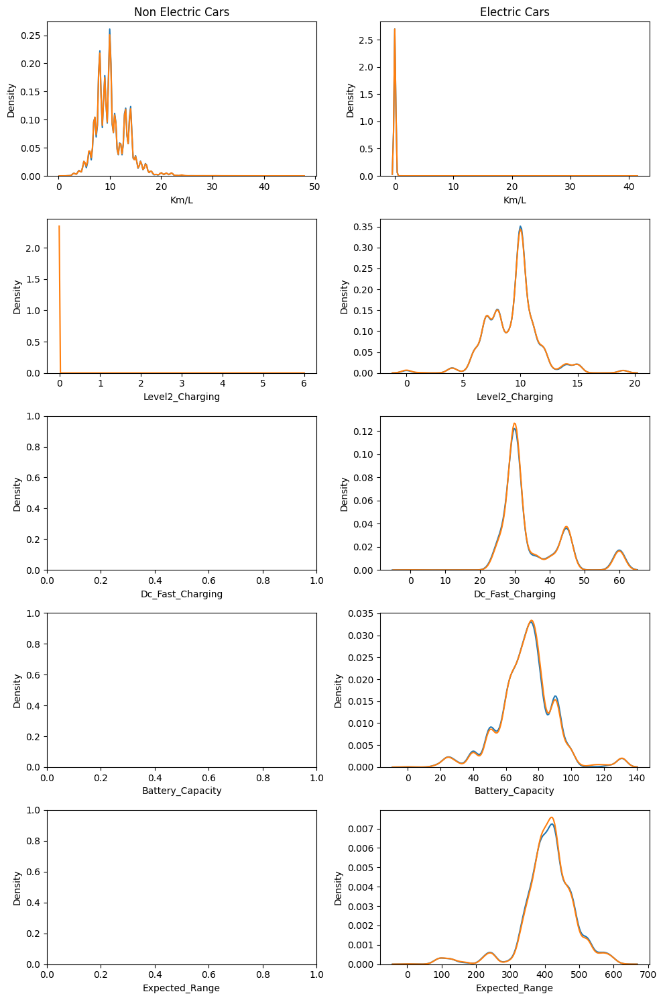

In [ ]:
fig,ax = plt.subplots(figsize=(10,15),nrows=5,ncols=2)
ax = np.ravel(ax)

non_electric_idx = notnew_cars.query('Fuel_Type != "Electric"').copy()
electric_idx = notnew_cars.query('Fuel_Type == "Electric"').copy()

for axes,col in zip(ax[::2],cols):
  sns.kdeplot(data=notnew_cars.loc[non_electric_idx.index,:],x=col,ax=axes)
  sns.kdeplot(data=cont_df_trf.loc[non_electric_idx.index,:],x='remainder__'+col,ax=axes)
ax[0].set_title('Non Electric Cars')

for axes,col in zip(ax[1::2],cols):
  sns.kdeplot(data=notnew_cars.loc[electric_idx.index,:],x=col,ax=axes)
  sns.kdeplot(data=cont_df_trf.loc[electric_idx.index,:],x='remainder__'+col,ax=axes)
ax[1].set_title('Electric Cars')


handles, labels = ax[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper left', ncol=2, fontsize=6)

fig.tight_layout()
fig.show()

In [ ]:
# wrong imputation

notnew_cars.query('Fuel_Type != "Electric" & Level2_Charging > 0')

,Model_Year,Brand_Name,Model_Name,Image_List,Stock_Type,Mileage,Price,Exterior_Color,Interior_Color,Drivetrain,Km/L,Fuel_Type,Accidents_Or_Damage,Clean_Title,One_Owner_Vehicle,Personal_Use_Only,Level2_Charging,Dc_Fast_Charging,Battery_Capacity,Expected_Range,Gear_Spec,Engine_Size,Cylinder_Config,Valves,Km/L_e_City,Km/L_e_Hwy,City,STATE
86272,2025,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,0.0,37490.0,white,gray,AWD,NaN,Gasoline,False,True,None,yes,6.0,0.0,0.0,0.0,10.0,3.5,V6,24.0,0.0,0.0,santa clara,california
121937,2025,Ford,Transit-350 Base,['https://platform.cstatic-images.com/xlarge/i...,Used,7473.0,49998.0,white,gray,RWD,8.0,Gasoline,False,True,one,yes,6.0,0.0,0.0,0.0,10.0,3.5,V6,24.0,0.0,0.0,duluth,georgia
202122,2021,Volkswagen,ID.4 Pro S,['https://platform.cstatic-images.com/xlarge/i...,Used,19781.0,21600.0,black,black,RWD,41.0,Other,False,True,one,yes,7.0,0.0,0.0,0.0,1.0,NaN,None,NaN,0.0,0.0,alexandria,virginia
269112,2021,Volkswagen,ID.4 Pro S,['https://platform.cstatic-images.com/xlarge/i...,Certified,11097.0,22100.0,black,black,RWD,41.0,Other,False,True,one,yes,7.0,0.0,0.0,0.0,1.0,NaN,None,NaN,0.0,0.0,alexandria,virginia


In [ ]:
# this are petrol cars, can't contain level2 charging
notnew_cars.loc[[86272,121937],'Level2_Charging'] = np.nan

# this are electric car, hence we will change the fuel type from others to electric
notnew_cars.loc[[202122,269112],'Fuel_Type'] = "Electric"

# this two cars can't have Km/L values
notnew_cars.loc[[202122,269112],'Km/L'] = np.nan

In [ ]:
# filling continuous values
for col in cols:
  notnew_cars[col] = notnew_cars[col].fillna(cont_df_trf['remainder__'+col])

## **Categorical Columns**

For **categorical columns**, I initially considered using an iterative imputer with a classifier, but this approach proved problematic.  
Binary-encoded columns with missing values scatter `NaN` across multiple encoded columns, which can cause the classifier to impute **incorrect or garbage values**.  

Instead, I analyzed the **distribution of Price** against missing vs. non-missing values for each categorical column using **KDE plots**.  
- For **Gear_Spec, Cylinder_Config, and Valves**, the KDE distributions were nearly identical, indicating that these columns are **MCAR (Missing Completely At Random)**. These were imputed using a **SimpleImputer** with the **most_frequent** strategy.  
- For **Personal_Use_Only, Interior_Color, and One_Owner_Vehicle**, the distributions differed, suggesting potential dependency. I trained a **RandomForestClassifier** (0 = not missing, 1 = missing) to test for MAR, but the model had very low recall, indicating that these columns are **MNAR (Missing Not At Random)**.  

Columns with MNAR missingness were **dropped**, because imputing them would rely on assumptions that could introduce bias.  
Interior and Exterior Color columns were treated separately — their missingness was minimal and they were already imputed using domain-specific rules, so no further imputation was applied.  

Finally, the rows with missing values in the last three MNAR columns were removed, leaving a fully **cleaned dataset of non-used cars**, with no further imputation required.




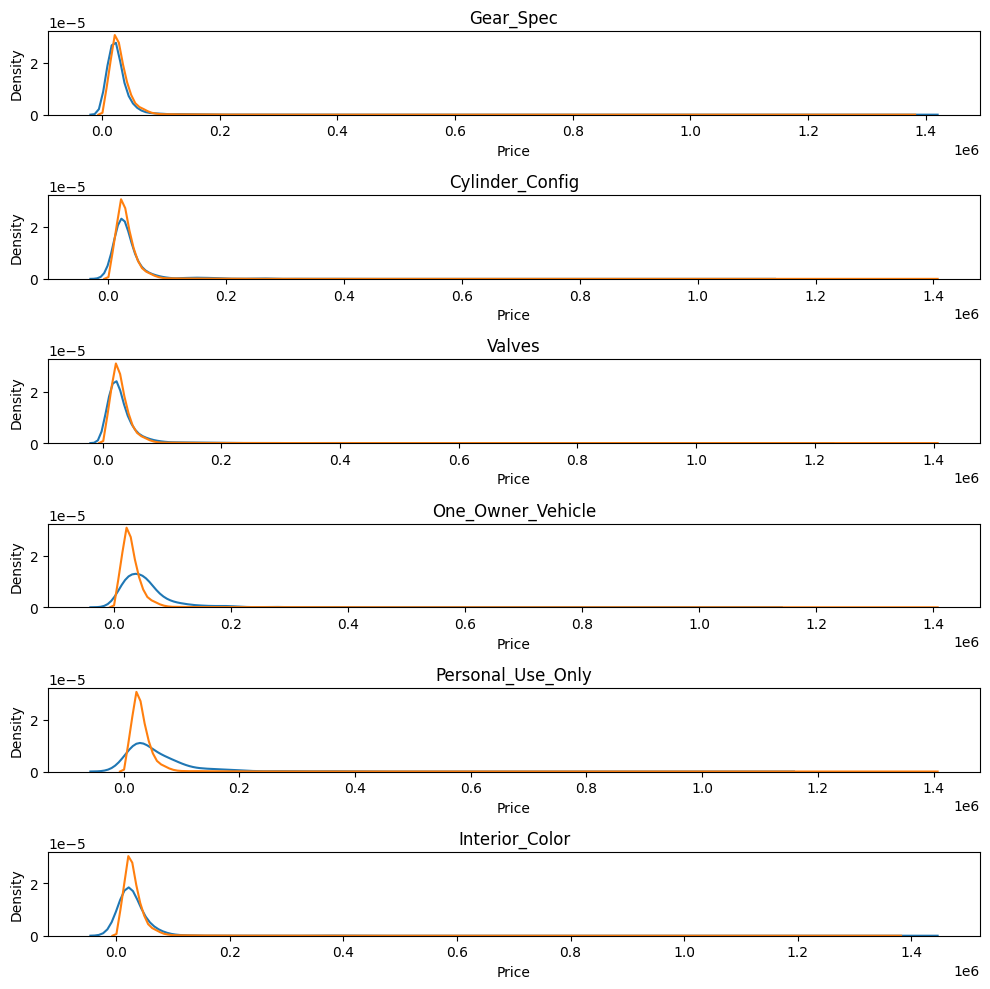

In [ ]:
cat_cols = ['Gear_Spec','Cylinder_Config','Valves','One_Owner_Vehicle','Personal_Use_Only','Interior_Color']


fig,ax = plt.subplots(nrows=6,figsize=(10,10))

ax = np.ravel(ax)

for col,axes in zip(cat_cols,ax):
  sns.kdeplot(data=notnew_cars[notnew_cars[col].isna()],x='Price',ax=axes)
  sns.kdeplot(data=notnew_cars[notnew_cars[col].notna()],x='Price',ax=axes)
  axes.set_title(col)

fig.tight_layout()
fig.show()

In [ ]:
impute_mode = SimpleImputer(missing_values=np.nan, strategy='most_frequent')
impute_mode.set_output(transform='pandas')

cat_imputed = impute_mode.fit_transform(
    notnew_cars[['Gear_Spec','Cylinder_Config','Valves']].replace({None: np.nan})
)

notnew_cars[['Gear_Spec','Cylinder_Config','Valves']] = cat_imputed

### **One_Owner_Vehicle**

In [ ]:
owner_df = notnew_cars.drop(columns=['Image_List'])

# removing any null values other than One_Owner_Vehicle

sub = list(owner_df.columns)
sub.remove('One_Owner_Vehicle')

owner_df = owner_df.dropna(subset=sub)

owner_df = owner_df.assign(
    Personal_Use_Only = (
        np.where(
            owner_df['Personal_Use_Only'] == 'yes',
            True,
            False
        )),

    Gear_Spec = (
        owner_df['Gear_Spec'].astype(int)
    )
)

Y= owner_df['One_Owner_Vehicle'].isna().astype(int)
X = owner_df.drop(columns='One_Owner_Vehicle')

xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.2,shuffle=True)


cat_trf = ColumnTransformer(
    transformers=[
        ('nominal',
         BinaryEncoder(
             cols=['Brand_Name','Model_Name','Drivetrain','Fuel_Type','City','STATE','Exterior_Color','Interior_Color']
         ),
         ['Brand_Name','Model_Name','Drivetrain','Fuel_Type','City','STATE','Exterior_Color','Interior_Color']
        ),
        ('ordinal',
         OrdinalEncoder(
             categories=[
                ['Used','Certified'],
                [1., 2., 3., 4., 5., 6., 7., 8., 9., 10.],
                ['NA','V2', 'I3', 'V4', 'I4', 'H4', 'I5', 'V6', 'I6', 'H6', 'V8', 'V10', 'V12'],
                [0., 8., 12., 16., 18., 20., 24., 30., 32., 48.]
             ]
         ),
         ['Stock_Type','Gear_Spec','Cylinder_Config','Valves']
        )
    ],
    remainder='passthrough'
)

cat_pipe = Pipeline([
    ('encoder', cat_trf),
    ('imputer', RandomForestClassifier(n_jobs=-1))
])

cat_pipe.set_output(transform='pandas')

cat_pipe.fit(xtrain,ytrain)

ypred = cat_pipe.predict(xtest)

print(classification_report(ytest,ypred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     33530
           1       0.95      0.35      0.51       197

    accuracy                           1.00     33727
   macro avg       0.97      0.68      0.75     33727
weighted avg       1.00      1.00      1.00     33727



### **Personal_Use_Only**

In [ ]:
use_df = notnew_cars.drop(columns=['Image_List'])

# removing any null values other than One_Owner_Vehicle

use_df = use_df.assign(
    One_Owner_Vehicle = (
        np.where(
            use_df['One_Owner_Vehicle'] == 'one',
            True,
            False
        )),

    Gear_Spec = (
        use_df['Gear_Spec'].astype(int)
    )
)

Y= use_df['Personal_Use_Only'].isna().astype(int)
X = use_df.drop(columns=['Personal_Use_Only','Interior_Color','Exterior_Color','One_Owner_Vehicle'])

xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.2,shuffle=True,stratify=Y)


cat_trf = ColumnTransformer(
    transformers=[
        ('nominal',
         BinaryEncoder(
             cols=['Brand_Name','Model_Name','Drivetrain','Fuel_Type','City','STATE']
         ),
         ['Brand_Name','Model_Name','Drivetrain','Fuel_Type','City','STATE']
        ),
        ('ordinal',
         OrdinalEncoder(
             categories=[
                ['Used','Certified'],
                [1., 2., 3., 4., 5., 6., 7., 8., 9., 10.],
                ['NA','V2', 'I3', 'V4', 'I4', 'H4', 'I5', 'V6', 'I6', 'H6', 'V8', 'V10', 'V12'],
                [0., 8., 12., 16., 18., 20., 24., 30., 32., 48.]
             ]
         ),
         ['Stock_Type','Gear_Spec','Cylinder_Config','Valves']
        )
    ],
    remainder='passthrough'
)

cat_pipe = Pipeline([
    ('encoder', cat_trf),
    ('imputer', RandomForestClassifier(n_jobs=-1))
])

cat_pipe.set_output(transform='pandas')

cat_pipe.fit(xtrain,ytrain)

ypred = cat_pipe.predict(xtest)

print(classification_report(ytest,ypred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     33881
           1       1.00      0.60      0.75       186

    accuracy                           1.00     34067
   macro avg       1.00      0.80      0.88     34067
weighted avg       1.00      1.00      1.00     34067



In [ ]:
notnew_cars.info()

<class 'pandas.core.frame.DataFrame'>
Index: 170033 entries, 0 to 271187
Data columns (total 28 columns):
 #   Column               Non-Null Count   Dtype   
---  ------               --------------   -----   
 0   Model_Year           170033 non-null  int64   
 1   Brand_Name           170033 non-null  category
 2   Model_Name           170033 non-null  object  
 3   Image_List           167048 non-null  object  
 4   Stock_Type           170033 non-null  object  
 5   Mileage              170033 non-null  float64 
 6   Price                170033 non-null  float64 
 7   Exterior_Color       169933 non-null  category
 8   Interior_Color       169286 non-null  category
 9   Drivetrain           170033 non-null  category
 10  Km/L                 170033 non-null  float64 
 11  Fuel_Type            170033 non-null  object  
 12  Accidents_Or_Damage  170033 non-null  bool    
 13  Clean_Title          170033 non-null  bool    
 14  One_Owner_Vehicle    168269 non-null  object  
 15  Perso

In [ ]:
# dropping remaining nan values, other than Image_List

cols = list(notnew_cars.columns)
cols.remove('Image_List')

final_notnewdf = notnew_cars.dropna(subset=cols)

In [ ]:
final_notnewdf = final_notnewdf.assign(

    One_Owner_Vehicle = np.where(
        final_notnewdf['One_Owner_Vehicle'] == 'one',
        True,
        False
    ),

    Personal_Use_Only = np.where(
        final_notnewdf['Personal_Use_Only'] == 'yes',
        True,
        False
    ),

    Cylinder_Config = final_notnewdf['Cylinder_Config'].astype('category'),

    Stock_Type = final_notnewdf['Stock_Type'].astype('category'),

    Fuel_Type = final_notnewdf['Fuel_Type'].astype('category')

)

In [ ]:
final_notnewdf.to_parquet('final_notnewdf.parquet')

# Binning & Power Transformation: FunctionTransformers, ColumnTransformers and Pipelines

```
final_notnewdf
│
├─> preprocessor1 (ColumnTransformer)
│    ├─> FunctionTransformer: year_decade_binning (on 'Model_Year')
│    └─> FunctionTransformer: clipping_mileage (on 'Mileage')
│
├─> Output: final_df_processed & preprocessor1.pkl
│    ├─> Used for:
│    │    ├─> EDA
│    │    └─> Tree-based algorithms (decision trees, random forest, XGBoost, etc.)
│
└─> preprocessor2 (ColumnTransformer)
     ├─> PowerTransformer / Custom transformations (applied to numeric columns)
     └─> Output: final_df_processed_trf & preprocessor2.pkl
          ├─> Used for:
               └─> Linear models (Linear Regression, Ridge, Lasso, etc.)

```


## **Preprocessing**

1. Transformation on Year and Mileage will be applied

2. This data will be helpful for EDA (as numbers are in their original units) and Tree based algo (which do not require normality based assumption).

In [85]:
def year_decade_binning(model_Year):
  """
  Binning the years into decade for pre 2000 cars.
  """
  return np.where(model_Year < 2000 , (model_Year//10)*10,model_Year)

def clipping_mileage(mileage):
  """
  Clipping mileage to atmost 4M
  """
  return mileage.clip(upper=400000)

# FunctionTransformer 1
decade_transformer = FunctionTransformer(year_decade_binning,validate=False)
mileage_clipping_transformer = FunctionTransformer(clipping_mileage,validate=False)

# transformer 1
preprocessor1 = ColumnTransformer(
    transformers = [
        ('decade',decade_transformer,['Model_Year']),
        ('mileage_clipper',mileage_clipping_transformer,['Mileage'])
    ],
   remainder='passthrough'
)

preprocessor1.set_output(transform='pandas')

final_df_processed = preprocessor1.fit_transform(final_notnewdf).set_axis(final_notnewdf.columns,axis=1).rename(columns={'Brand_Name' : 'Mileage','Model_Name' : 'Brand_Name','Image_List':'Model_Name','Stock_Type':'Image_List','Mileage':'Stock_Type'})

final_df_processed = final_df_processed.convert_dtypes()

/usr/local/lib/python3.12/dist-packages/sklearn/preprocessing/_function_transformer.py:311: UserWarning: When `set_output` is configured to be 'pandas', `func` should return a pandas DataFrame to follow the `set_output` API  or `feature_names_out` should be defined.
  warnings.warn(warn_msg.format("pandas"))


## **Power & Custom Transformations**

1. This data will be required when training a linear model as they have assumption of linearity.

In [92]:
def mileage_sqrt(mileage):
  """
  applying np.sqrt transformation to reduce skewness and kurtosis
  """
  return np.sqrt(mileage)

def city_hwy_square(col):
  """
  applying np.square transformation on Km/L_e_City & Km/L_e_Hwy to make it more symetrical
  """
  return np.square(col)

# FunctionTransformer 2
mileage_sqrt_transformer = FunctionTransformer(mileage_sqrt,validate=True)
kml_city_hwy_transformer = FunctionTransformer(city_hwy_square,validate=True)

# transformer 2
preprocessor2 = ColumnTransformer(
    transformers = [
        ('mileage_trf',mileage_sqrt_transformer,['Mileage']),
        ('price_trf',PowerTransformer(method='yeo-johnson'),['Price']),
        ('Km/L_e_City_trf',kml_city_hwy_transformer,['Km/L_e_City','Km/L_e_Hwy'])
    ],
    remainder='passthrough'
)
preprocessor2.set_output(transform='pandas')
final_df_processed_trf = preprocessor2.fit_transform(final_df_processed).rename(columns=
            {
                0:'Mileage',1:'Price',2:'Km/L_e_City',3:'Km/L_e_Hwy',4:'Model_Year',5:'Brand_Name',6:'Model_Name',7:'Image_List',
                8:'Stock_Type',9:'Exterior_Color',10:'Interior_Color',11:'Drivetrain',12:'Km/L',13:'Fuel_Type',14:'Accidents_Or_Damage',
                15:'Clean_Title',16:'One_Owner_Vehicle',17:'Personal_Use_Only',18:'Level2_Charging',19:'Dc_Fast_Charging',20:'Battery_Capacity',
                21:'Expected_Range',22:'Gear_Spec',23:'Engine_Size',24:'Cylinder_Config',25:'Valves',26:'City',27:'STATE'
             })

final_df_processed_trf = final_df_processed_trf.convert_dtypes()

/usr/local/lib/python3.12/dist-packages/sklearn/preprocessing/_function_transformer.py:311: UserWarning: When `set_output` is configured to be 'pandas', `func` should return a pandas DataFrame to follow the `set_output` API  or `feature_names_out` should be defined.
  warnings.warn(warn_msg.format("pandas"))
/usr/local/lib/python3.12/dist-packages/sklearn/preprocessing/_function_transformer.py:311: UserWarning: When `set_output` is configured to be 'pandas', `func` should return a pandas DataFrame to follow the `set_output` API  or `feature_names_out` should be defined.
  warnings.warn(warn_msg.format("pandas"))


### **Change in Distribution after Transformations**

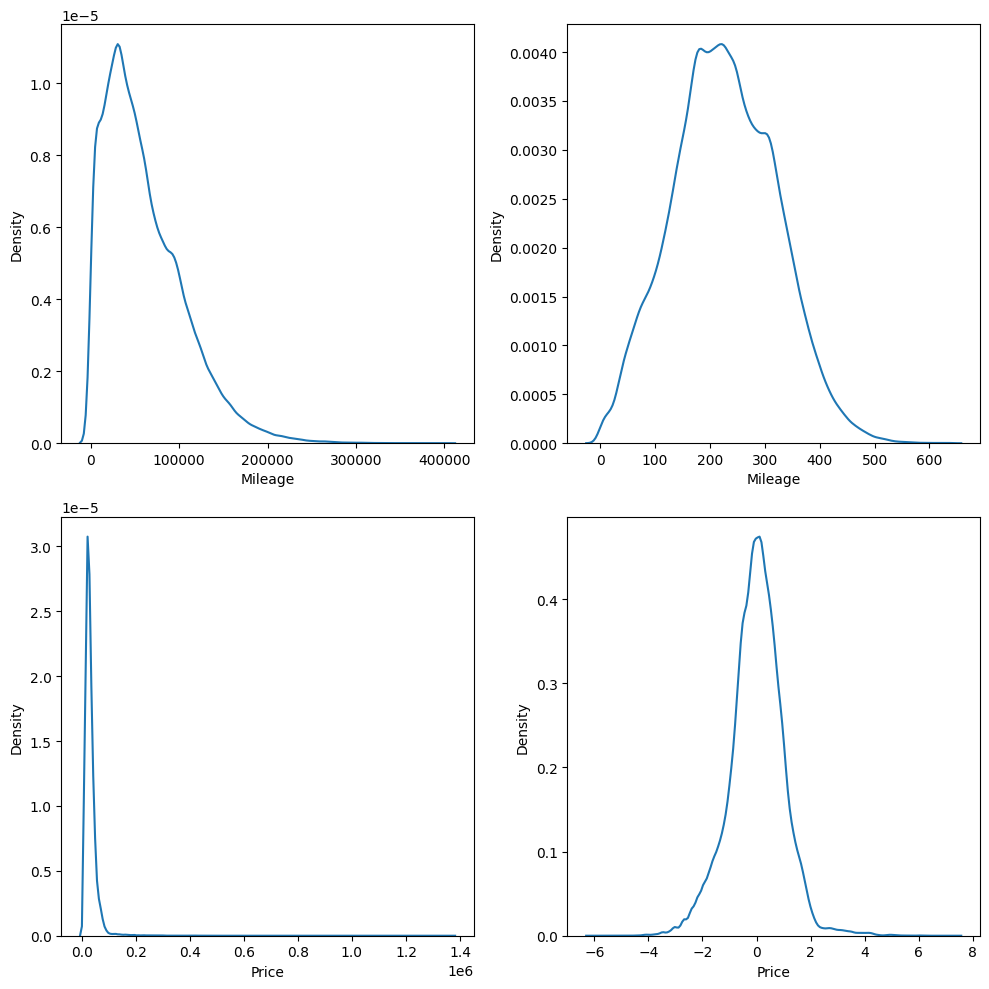

In [120]:
cols = ['Mileage','Price']

fig,ax = plt.subplots(nrows=2,ncols=2,figsize=(10,10))
ax = np.ravel(ax)

for col,axes in zip(cols,ax[::2]):
  sns.kdeplot(data=final_df_processed,x=col,ax=axes)

for col,axes in zip(cols,ax[1::2]):
  sns.kdeplot(data=final_df_processed_trf,x=col,ax=axes)

fig.tight_layout()
fig.show()

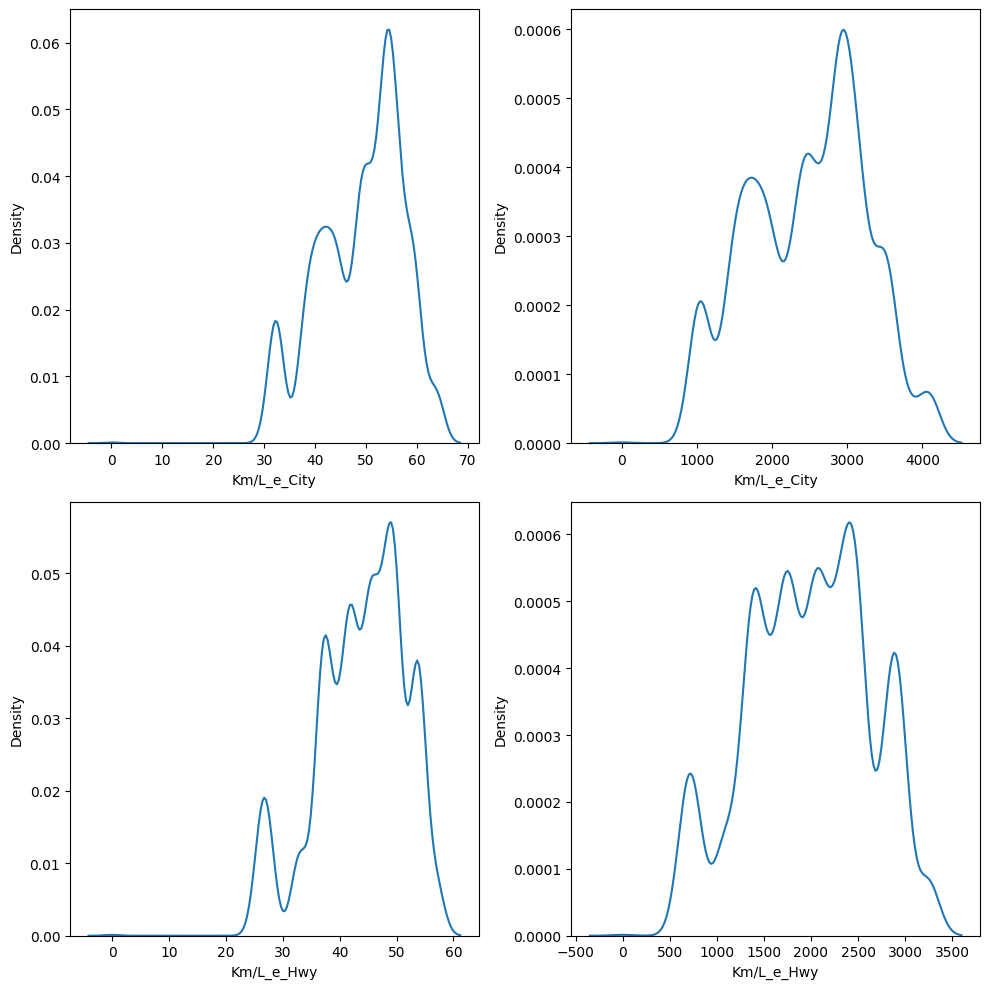

In [117]:
ecols = ['Km/L_e_City','Km/L_e_Hwy']

fig,ax = plt.subplots(nrows=2,ncols=2,figsize=(10,10))
ax = np.ravel(ax)

for col,axes in zip(ecols,ax[::2]):
  sns.kdeplot(data=final_df_processed.query('Fuel_Type == "Electric"'),x=col,ax=axes)

for col,axes in zip(ecols,ax[1::2]):
  sns.kdeplot(data=final_df_processed_trf.query('Fuel_Type == "Electric"'),x=col,ax=axes)

fig.tight_layout()
fig.show()

# Saving Data and Transformer

In [129]:
final_df_processed.to_parquet('CLEANED_IMPUTED_PREPROCESSED.parquet')
final_df_processed_trf.to_parquet('CLEANED_IMPUTED_PREPROCESSED_TRANSFORMED.parquet')

joblib.dump(preprocessor1,'year_binning_mileage_capping.pkl')
joblib.dump(preprocessor2,'power_custom_transformers.pkl')